In [1]:
import itclab
import numpy as np
import time
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import random
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense

import pickle
from tqdm import tqdm # Progress bar
# For LSTM model
from keras.models import load_model

In [2]:
######################################################
# Use this script for evaluating model predictions   #
# and PID controller performance for the TCLab       #
# Adjust only PID and model sections                 #
######################################################

######################################################
# PID Controller                                     #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution
def pid(sp,pv,pv_last,ierr,dt):
    Kc   = 10.0 # K/%Heater
    tauI = 50.0 # sec
    tauD = 1.0  # sec
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0
    # calculate the error
    error = sp-pv
    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [3]:
######################################################
# FOPDT model                                        #
######################################################
Kp = 0.5      # degC/%
tauP = 120.0  # seconds
thetaP = 10   # seconds (integer)
Tss = 23      # degC (ambient temperature)
Qss = 0       # % heater

######################################################
# Energy balance model                               #
######################################################
def heat(x,t,Q):
    # Parameters
    Ta = 23 + 273.15   # K
    U = 10.0           # W/m^2-K
    m = 4.0/1000.0     # kg
    Cp = 0.5 * 1000.0  # J/kg-K    
    A = 12.0 / 100.0**2 # Area in m^2
    alpha = 0.01       # W / % heater
    eps = 0.9          # Emissivity
    sigma = 5.67e-8    # Stefan-Boltzman

    # Temperature State 
    T = x[0]

    # Nonlinear Energy Balance
    dTdt = (1.0/(m*Cp))*(U*A*(Ta-T) \
            + eps * sigma * A * (Ta**4 - T**4) \
            + alpha*Q)
    return dTdt

In [4]:
### Set Up Run ###

# Import model and parameters

model_lstm = load_model('pid_emulate.h5')
model_params = pickle.load(open('model_params.pkl','rb'))

s_x = model_params['Xscale']
s_y = model_params['yscale']
window = model_params['window']

In [5]:
### LSTM Controller ###

def lstm(T1_m, Tsp_m):
    # Calculate error (feature input LSTM)
    err = Tsp_m - T1_m
    
    # Format data for LSTM Input
    X = np.vstack((Tsp_m, err)).T
    Xs = s_x.transform(X)
    Xs = np.reshape(Xs, (1, Xs.shape[0], Xs.shape[1]))
    
    # Predict Q for controller and unscale
    Q1c_s = model_lstm.predict(Xs)
    Q1c = s_y.inverse_transform(Q1c_s)[0][0]
    
    # Ensure Q1c is between 0 and 100
    Q1c = np.clip(Q1c,0.0,100.0)
    
    return Q1c

Opening connection
iTCLab connected via Arduino on port COM4
LED On
Running Main Loop. Ctrl-C to end.
  Time     SP     PV     Q1   =  P   +  I  +   D
   0.0  25.00  26.87   0.00   0.00   0.00   0.00


<Figure size 720x504 with 0 Axes>

   1.0  25.00  26.84   0.00   0.00


<Figure size 432x288 with 0 Axes>

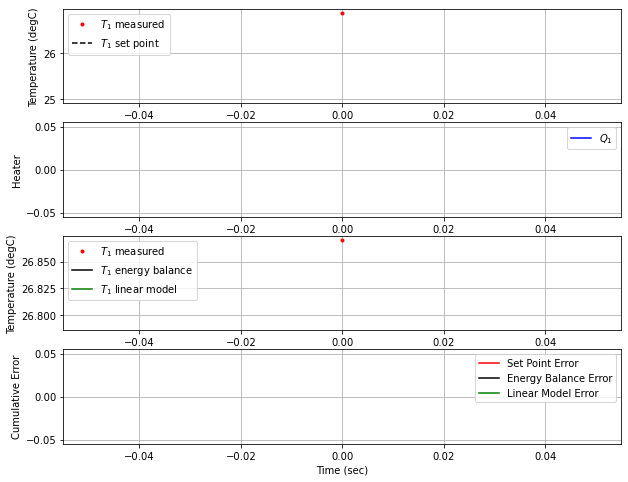

   2.6  25.00  26.82   0.00   0.00


<Figure size 432x288 with 0 Axes>

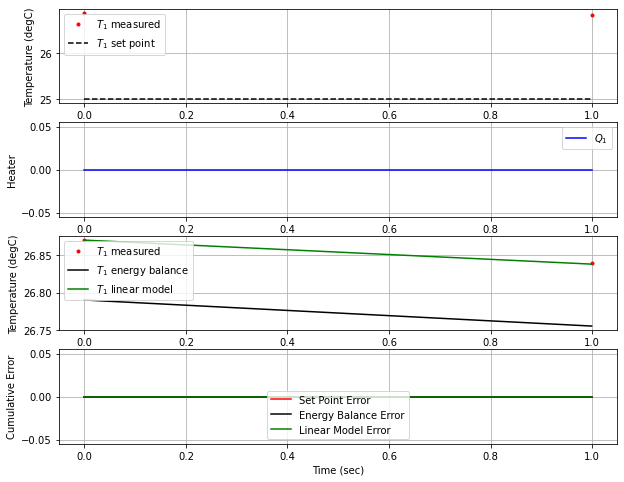

   4.2  25.00  26.69   0.00   0.00


<Figure size 432x288 with 0 Axes>

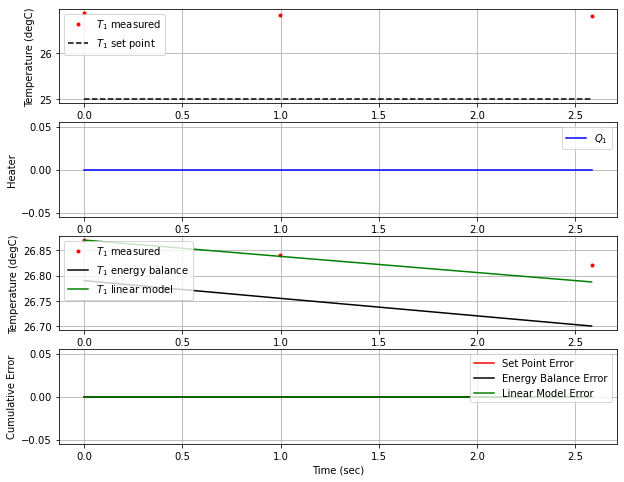

   6.0  25.00  26.90   0.00   0.00


<Figure size 432x288 with 0 Axes>

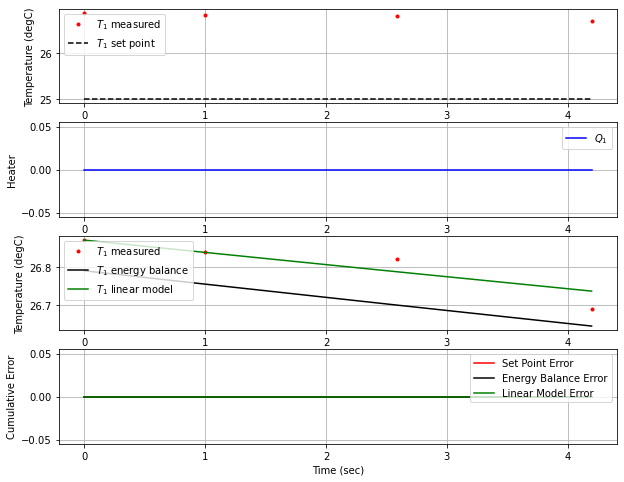

   7.6  25.00  26.84   0.00   0.00


<Figure size 432x288 with 0 Axes>

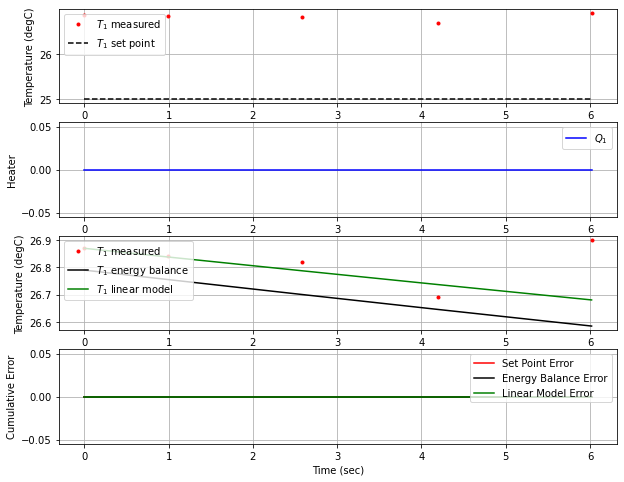

   9.3  25.00  26.85   0.00   0.00


<Figure size 432x288 with 0 Axes>

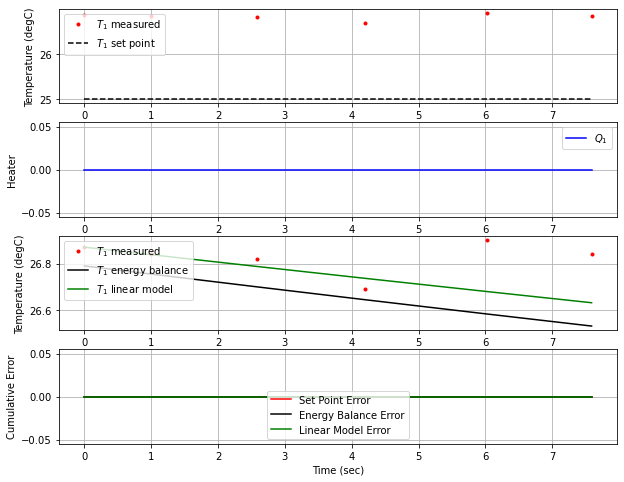

  11.0  25.00  26.70   0.00   0.00


<Figure size 432x288 with 0 Axes>

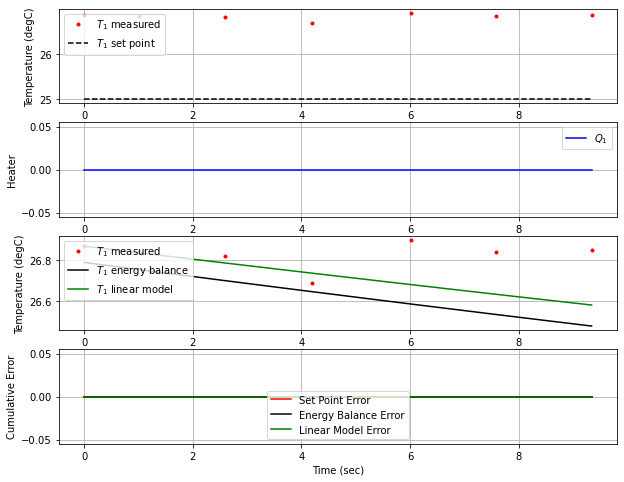

  12.5  25.00  26.80   0.00   0.00


<Figure size 432x288 with 0 Axes>

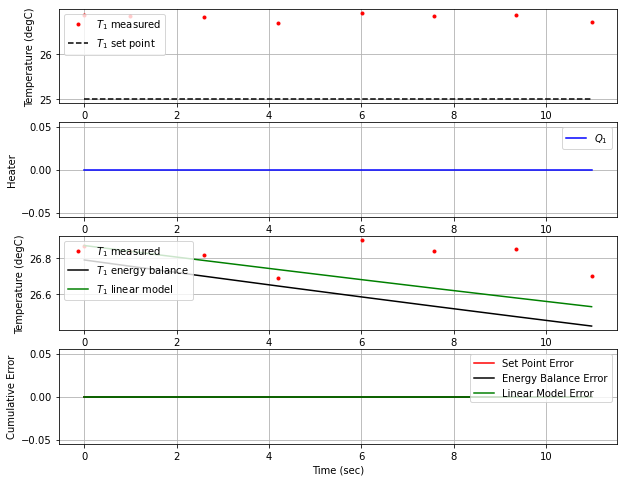

  14.1  25.00  26.96   0.00   0.00


<Figure size 432x288 with 0 Axes>

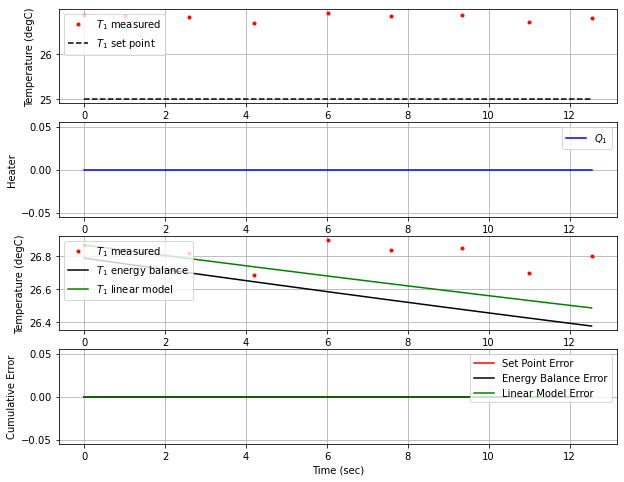

  16.0  25.00  26.78   0.00   0.00


<Figure size 432x288 with 0 Axes>

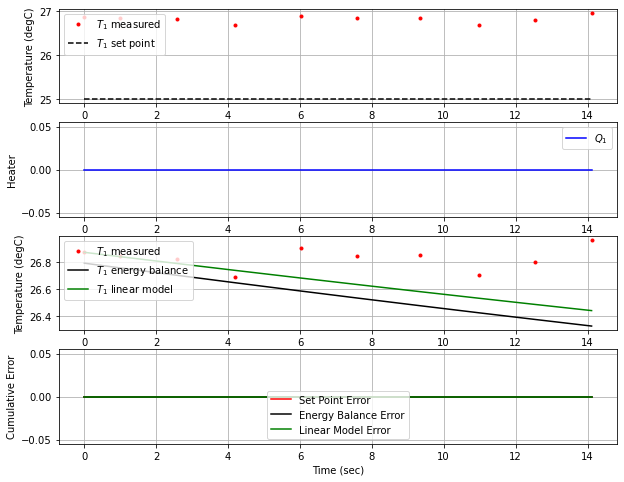

  17.9  25.00  26.76   0.00   0.00


<Figure size 432x288 with 0 Axes>

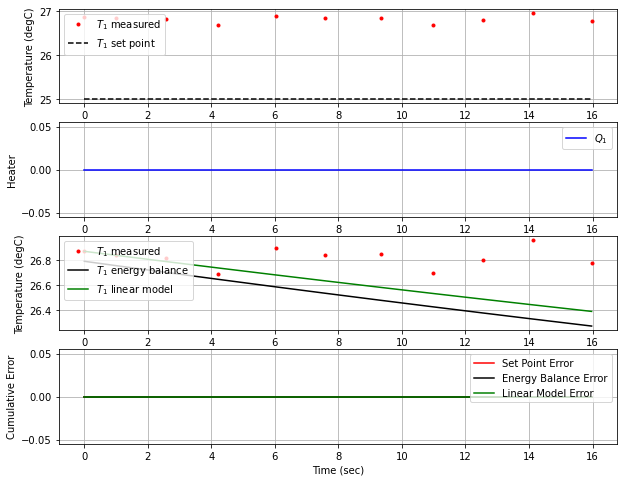

  19.5  25.00  26.78   0.00   0.00


<Figure size 432x288 with 0 Axes>

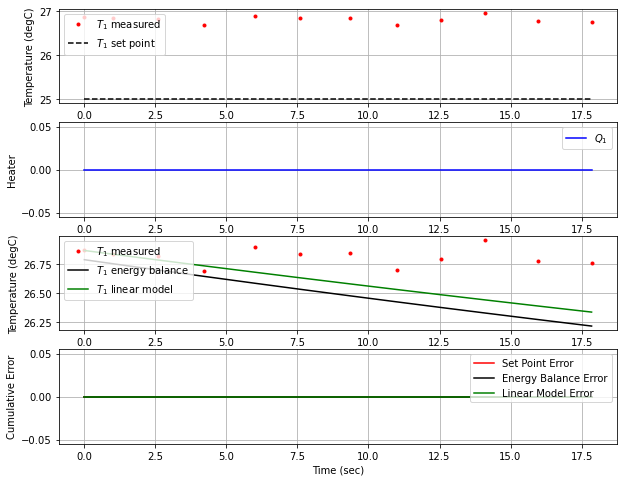

  21.1  25.00  26.84   0.00   0.00


<Figure size 432x288 with 0 Axes>

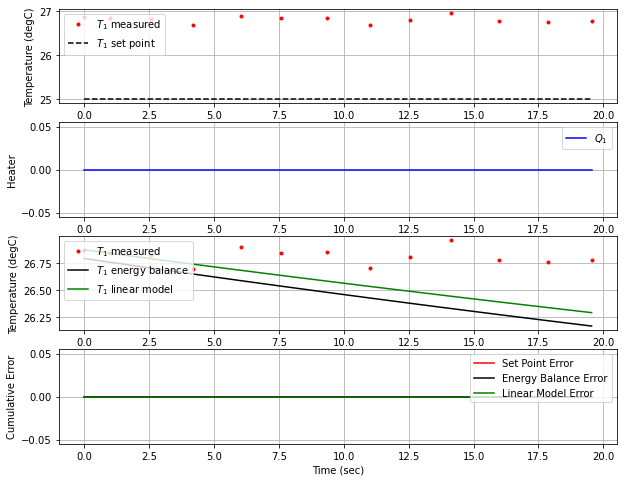

  22.9  25.00  26.71   0.00   0.00


<Figure size 432x288 with 0 Axes>

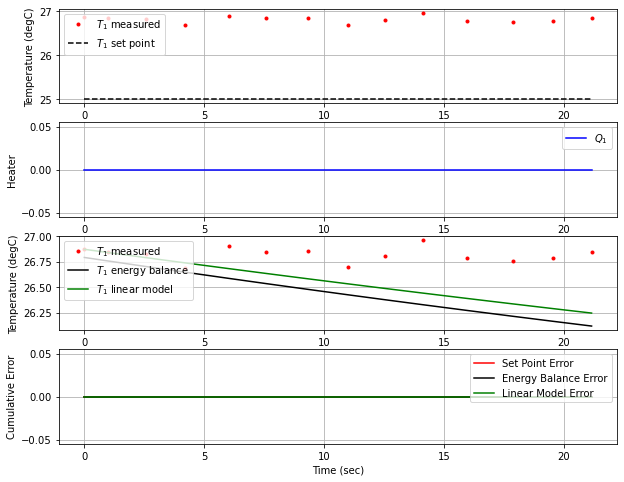

T1 NIH BOS  [26.87 26.84 26.82 26.69 26.9  26.84 26.85 26.7  26.8  26.96 26.78 26.76
 26.78 26.84 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  24.5  25.00  26.53   0.00   0.19


<Figure size 432x288 with 0 Axes>

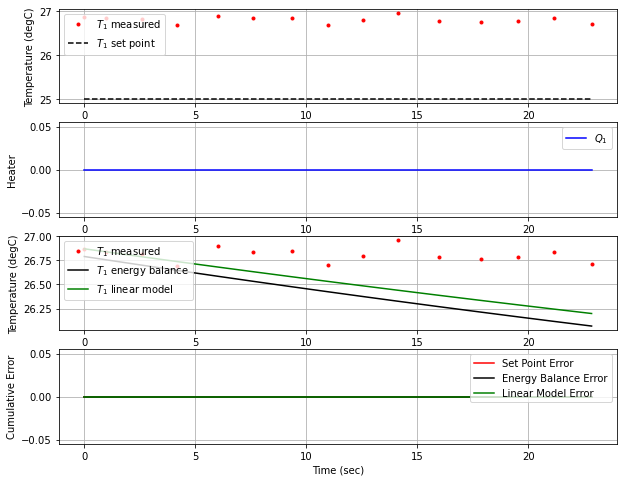

T1 NIH BOS  [26.84 26.82 26.69 26.9  26.84 26.85 26.7  26.8  26.96 26.78 26.76 26.78
 26.84 26.71 26.53]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  26.1  25.00  26.71   0.00   0.48


<Figure size 432x288 with 0 Axes>

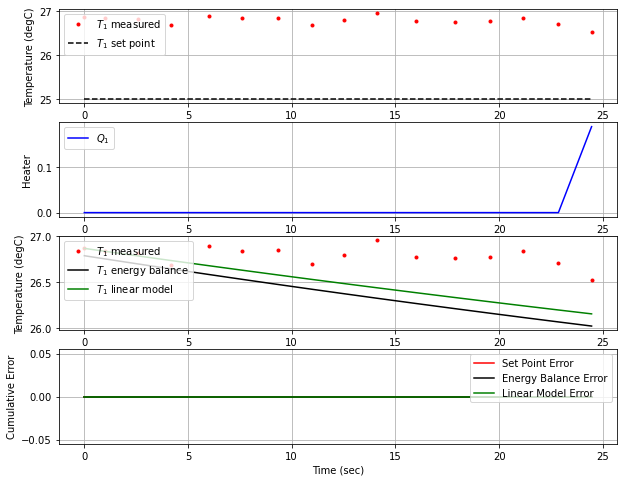

T1 NIH BOS  [26.82 26.69 26.9  26.84 26.85 26.7  26.8  26.96 26.78 26.76 26.78 26.84
 26.71 26.53 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  27.8  25.00  26.74   0.00   0.48


<Figure size 432x288 with 0 Axes>

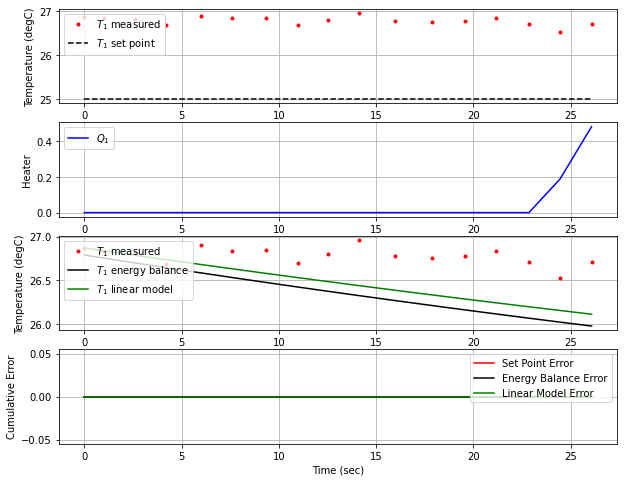

T1 NIH BOS  [26.69 26.9  26.84 26.85 26.7  26.8  26.96 26.78 26.76 26.78 26.84 26.71
 26.53 26.71 26.74]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  29.7  25.00  26.68   0.00   0.38


<Figure size 432x288 with 0 Axes>

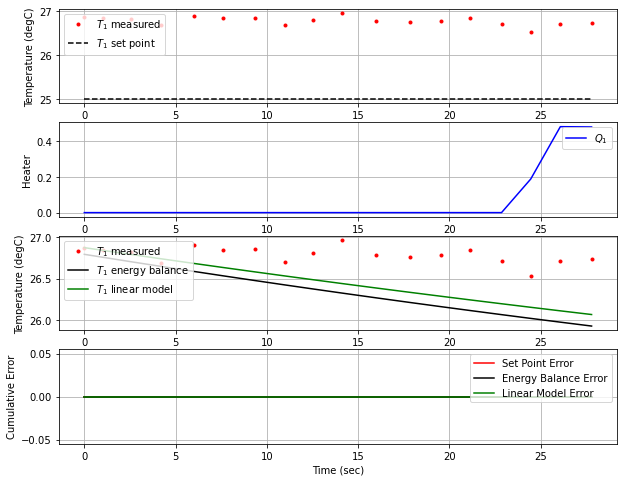

T1 NIH BOS  [26.9  26.84 26.85 26.7  26.8  26.96 26.78 26.76 26.78 26.84 26.71 26.53
 26.71 26.74 26.68]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  31.8  25.00  26.69   0.00   0.36


<Figure size 432x288 with 0 Axes>

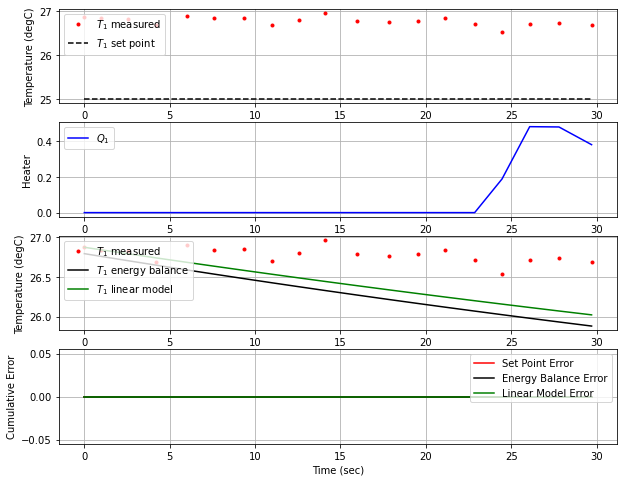

T1 NIH BOS  [26.84 26.85 26.7  26.8  26.96 26.78 26.76 26.78 26.84 26.71 26.53 26.71
 26.74 26.68 26.69]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  33.5  25.00  26.77   0.00   0.38


<Figure size 432x288 with 0 Axes>

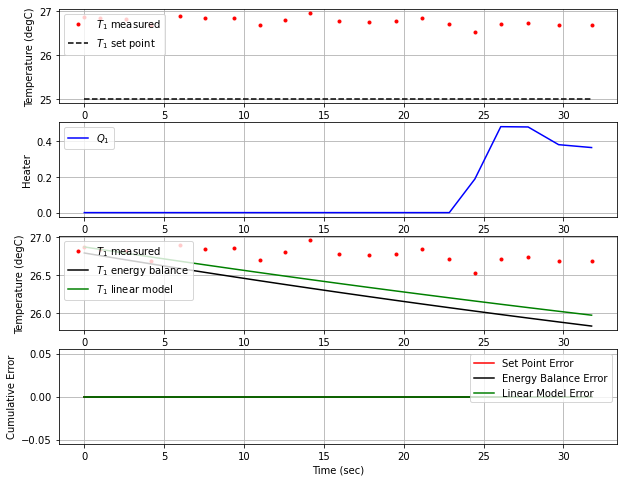

T1 NIH BOS  [26.85 26.7  26.8  26.96 26.78 26.76 26.78 26.84 26.71 26.53 26.71 26.74
 26.68 26.69 26.77]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  35.3  25.00  26.61   0.00   0.30


<Figure size 432x288 with 0 Axes>

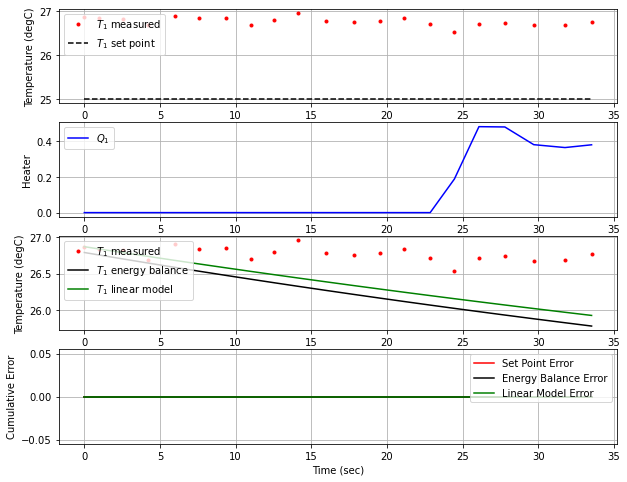

T1 NIH BOS  [26.7  26.8  26.96 26.78 26.76 26.78 26.84 26.71 26.53 26.71 26.74 26.68
 26.69 26.77 26.61]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  37.1  25.00  26.79   0.00   0.43


<Figure size 432x288 with 0 Axes>

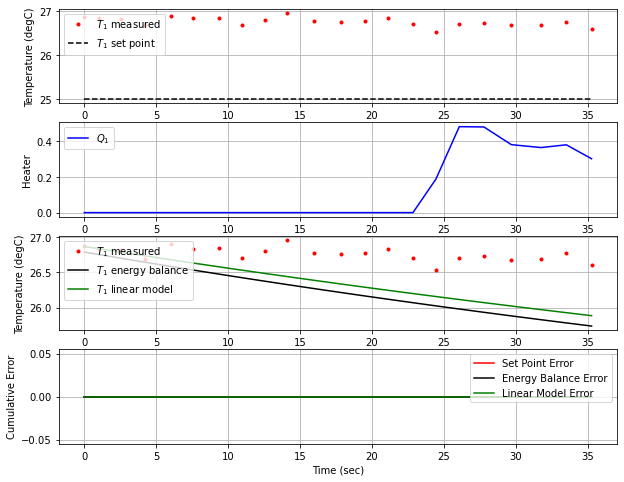

T1 NIH BOS  [26.8  26.96 26.78 26.76 26.78 26.84 26.71 26.53 26.71 26.74 26.68 26.69
 26.77 26.61 26.79]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  38.9  25.00  26.87   0.00   0.33


<Figure size 432x288 with 0 Axes>

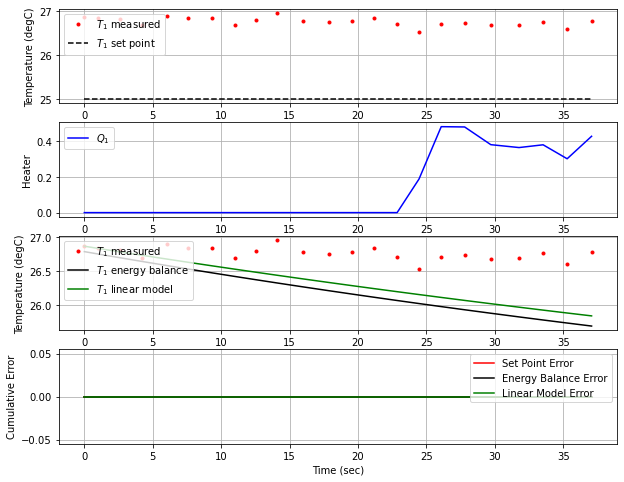

T1 NIH BOS  [26.96 26.78 26.76 26.78 26.84 26.71 26.53 26.71 26.74 26.68 26.69 26.77
 26.61 26.79 26.87]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  40.6  25.00  26.76   0.00   0.15


<Figure size 432x288 with 0 Axes>

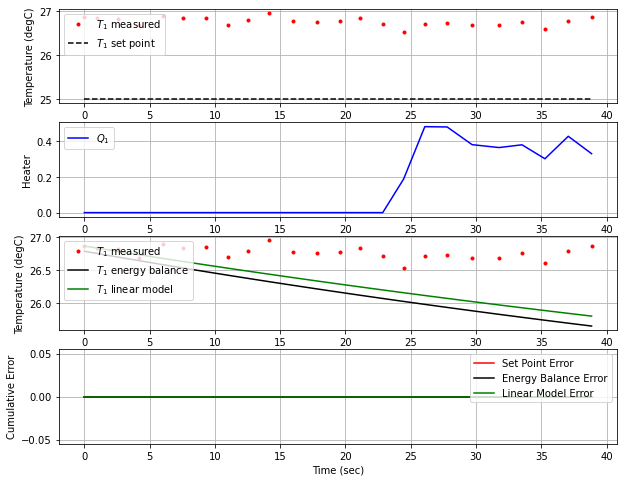

T1 NIH BOS  [26.78 26.76 26.78 26.84 26.71 26.53 26.71 26.74 26.68 26.69 26.77 26.61
 26.79 26.87 26.76]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  42.6  25.00  26.66   0.00   0.17


<Figure size 432x288 with 0 Axes>

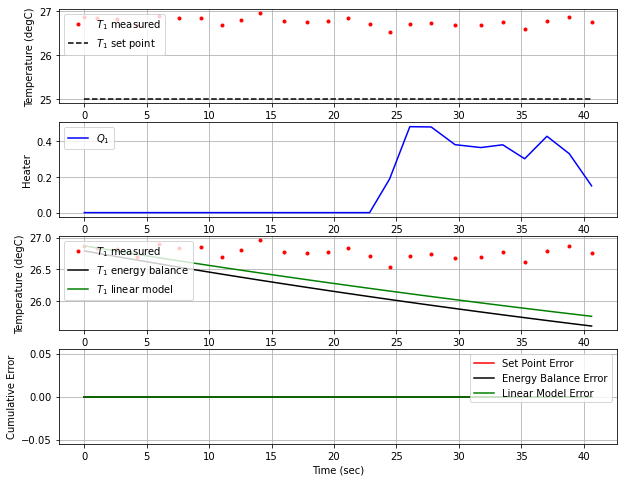

T1 NIH BOS  [26.76 26.78 26.84 26.71 26.53 26.71 26.74 26.68 26.69 26.77 26.61 26.79
 26.87 26.76 26.66]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  44.4  25.00  26.93   0.00   0.34


<Figure size 432x288 with 0 Axes>

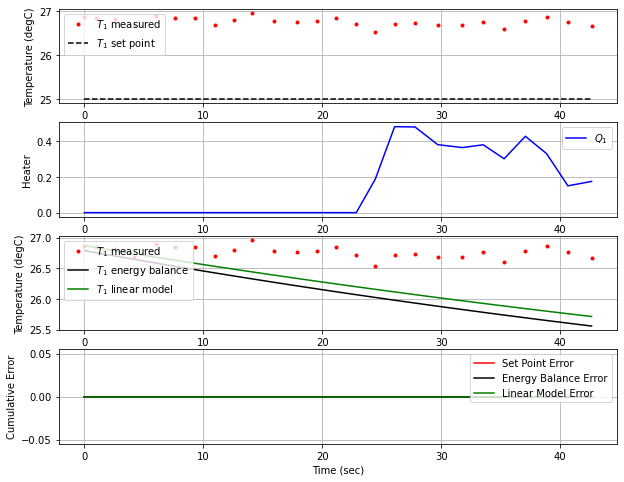

T1 NIH BOS  [26.78 26.84 26.71 26.53 26.71 26.74 26.68 26.69 26.77 26.61 26.79 26.87
 26.76 26.66 26.93]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 39ms/step
  46.2  25.00  26.70   0.00   0.16


<Figure size 432x288 with 0 Axes>

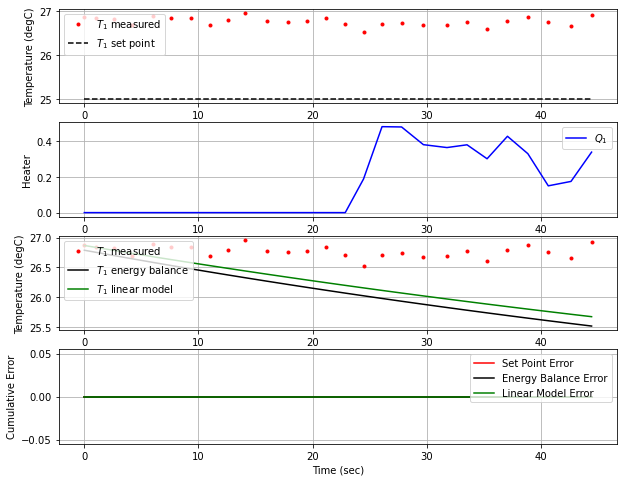

T1 NIH BOS  [26.84 26.71 26.53 26.71 26.74 26.68 26.69 26.77 26.61 26.79 26.87 26.76
 26.66 26.93 26.7 ]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  48.1  25.00  26.87   0.00   0.25


<Figure size 432x288 with 0 Axes>

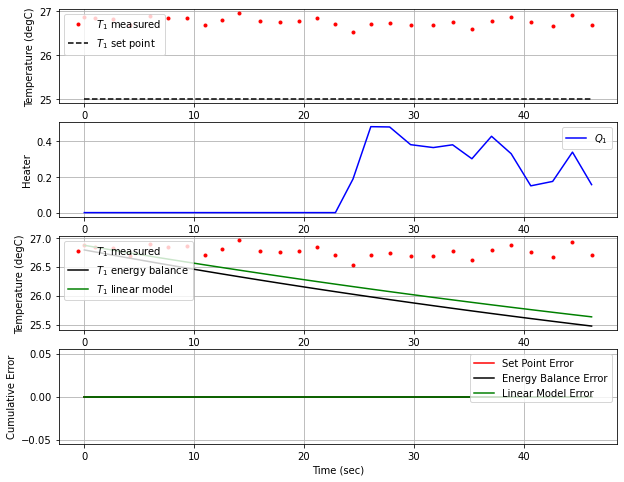

T1 NIH BOS  [26.71 26.53 26.71 26.74 26.68 26.69 26.77 26.61 26.79 26.87 26.76 26.66
 26.93 26.7  26.87]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  49.8  25.00  26.55   0.00   0.17


<Figure size 432x288 with 0 Axes>

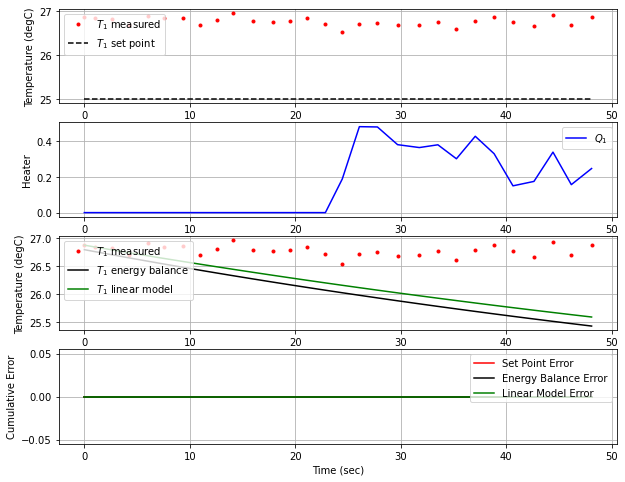

T1 NIH BOS  [26.53 26.71 26.74 26.68 26.69 26.77 26.61 26.79 26.87 26.76 26.66 26.93
 26.7  26.87 26.55]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  51.5  25.00  26.79   0.00   0.44


<Figure size 432x288 with 0 Axes>

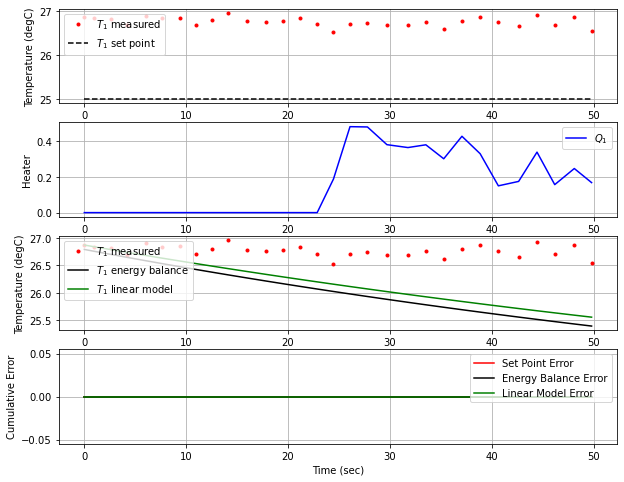

T1 NIH BOS  [26.71 26.74 26.68 26.69 26.77 26.61 26.79 26.87 26.76 26.66 26.93 26.7
 26.87 26.55 26.79]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 34ms/step
  53.2  25.00  26.75   0.00   0.38


<Figure size 432x288 with 0 Axes>

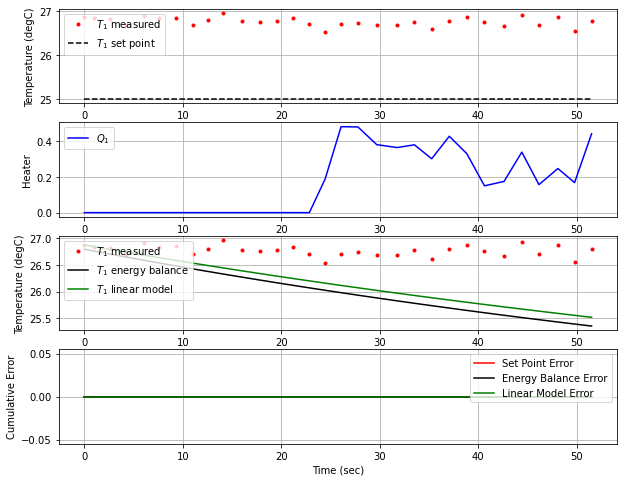

T1 NIH BOS  [26.74 26.68 26.69 26.77 26.61 26.79 26.87 26.76 26.66 26.93 26.7  26.87
 26.55 26.79 26.75]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  55.2  25.00  26.74   0.00   0.33


<Figure size 432x288 with 0 Axes>

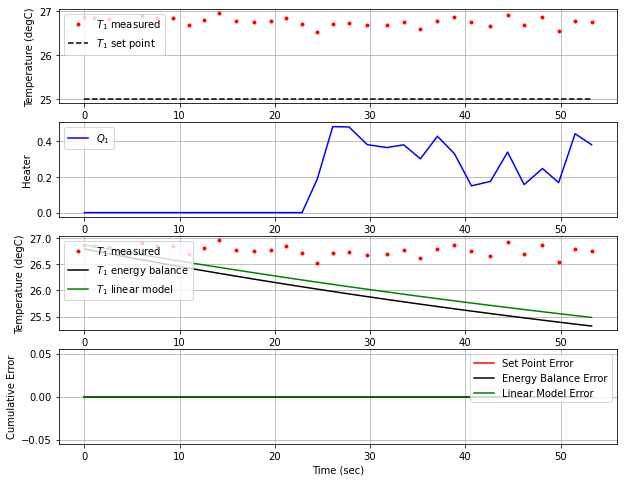

T1 NIH BOS  [26.68 26.69 26.77 26.61 26.79 26.87 26.76 26.66 26.93 26.7  26.87 26.55
 26.79 26.75 26.74]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  56.9  25.00  26.76   0.00   0.31


<Figure size 432x288 with 0 Axes>

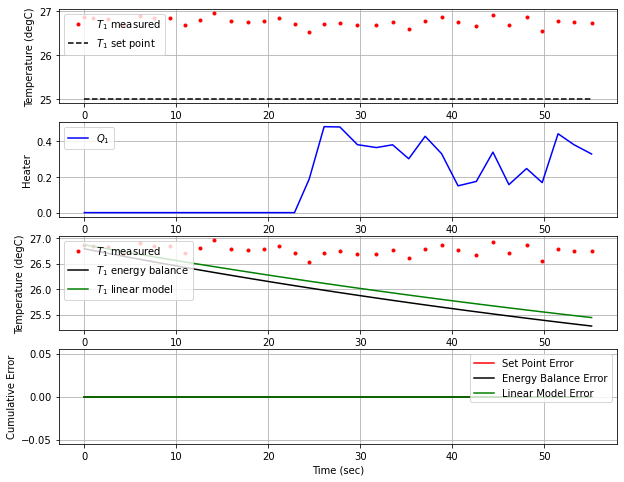

T1 NIH BOS  [26.69 26.77 26.61 26.79 26.87 26.76 26.66 26.93 26.7  26.87 26.55 26.79
 26.75 26.74 26.76]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  58.6  25.00  26.71   0.00   0.28


<Figure size 432x288 with 0 Axes>

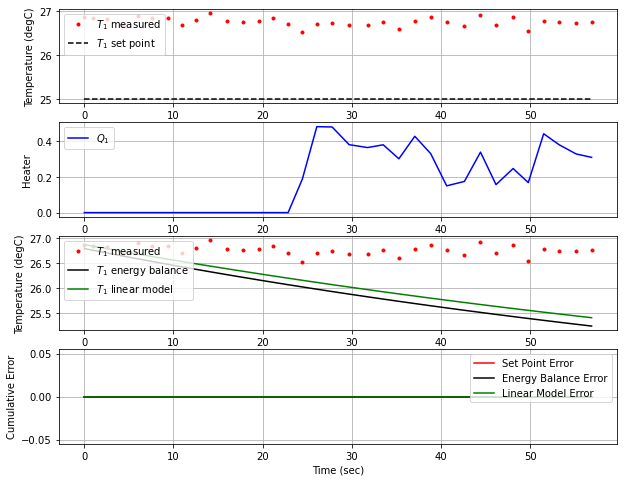

T1 NIH BOS  [26.77 26.61 26.79 26.87 26.76 26.66 26.93 26.7  26.87 26.55 26.79 26.75
 26.74 26.76 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  60.3  25.00  26.97   0.00   0.31


<Figure size 432x288 with 0 Axes>

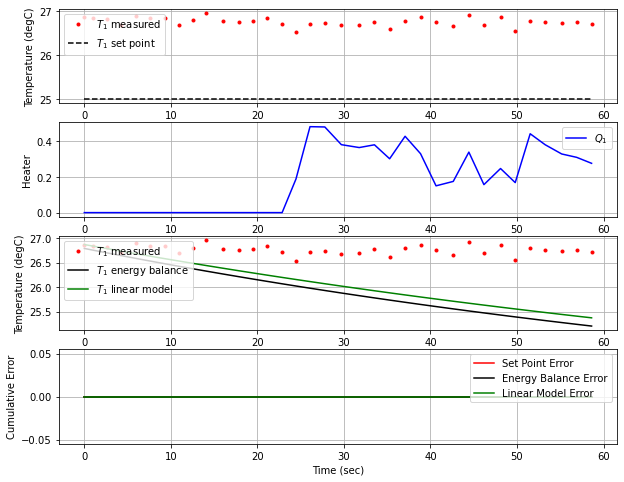

T1 NIH BOS  [26.61 26.79 26.87 26.76 26.66 26.93 26.7  26.87 26.55 26.79 26.75 26.74
 26.76 26.71 26.97]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 41ms/step
  62.0  25.00  26.71   0.00   0.05


<Figure size 432x288 with 0 Axes>

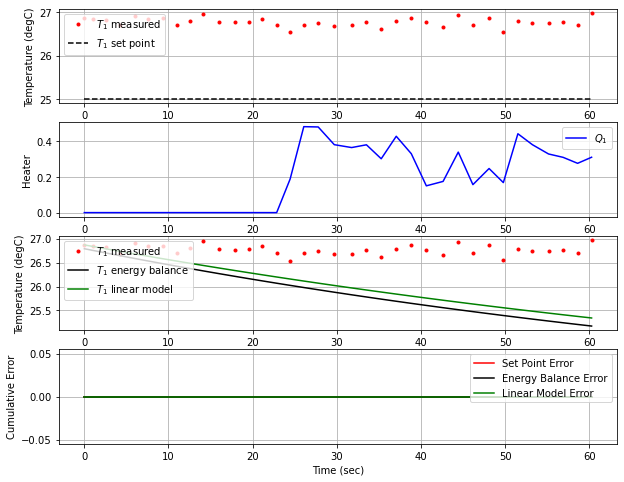

T1 NIH BOS  [26.79 26.87 26.76 26.66 26.93 26.7  26.87 26.55 26.79 26.75 26.74 26.76
 26.71 26.97 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  64.3  25.00  26.74   0.00   0.13


<Figure size 432x288 with 0 Axes>

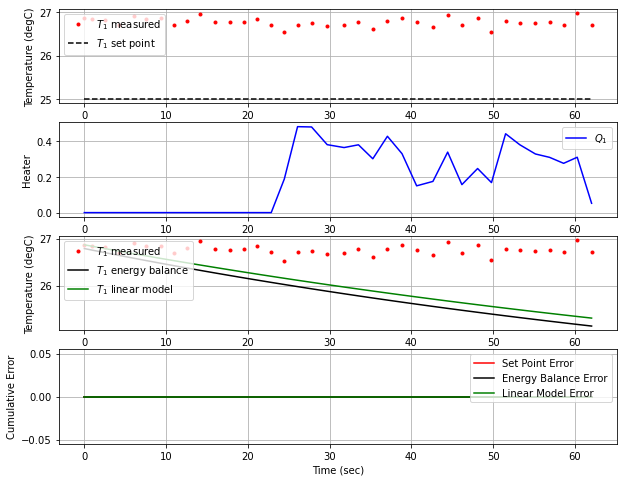

T1 NIH BOS  [26.87 26.76 26.66 26.93 26.7  26.87 26.55 26.79 26.75 26.74 26.76 26.71
 26.97 26.71 26.74]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 35ms/step
  66.0  25.00  26.70   0.00   0.22


<Figure size 432x288 with 0 Axes>

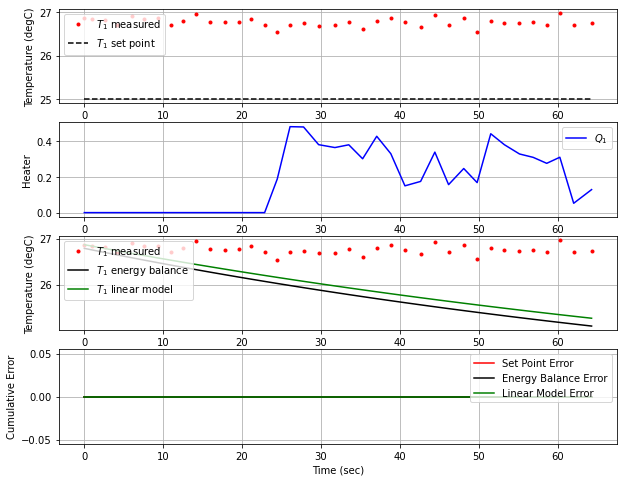

T1 NIH BOS  [26.76 26.66 26.93 26.7  26.87 26.55 26.79 26.75 26.74 26.76 26.71 26.97
 26.71 26.74 26.7 ]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  68.0  25.00  26.71   0.00   0.33


<Figure size 432x288 with 0 Axes>

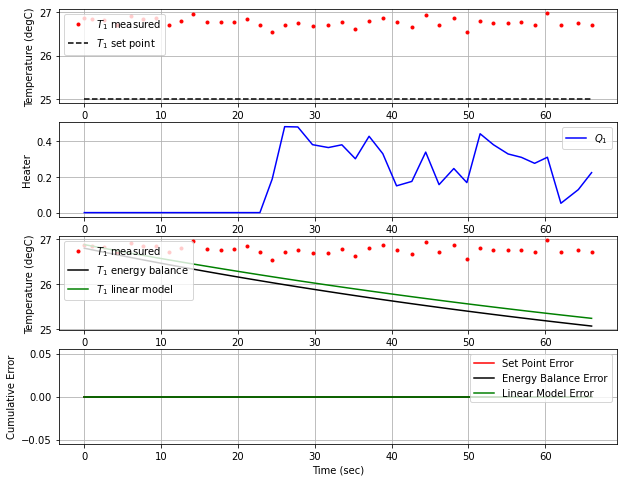

T1 NIH BOS  [26.66 26.93 26.7  26.87 26.55 26.79 26.75 26.74 26.76 26.71 26.97 26.71
 26.74 26.7  26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 38ms/step
  69.8  25.00  26.69   0.00   0.37


<Figure size 432x288 with 0 Axes>

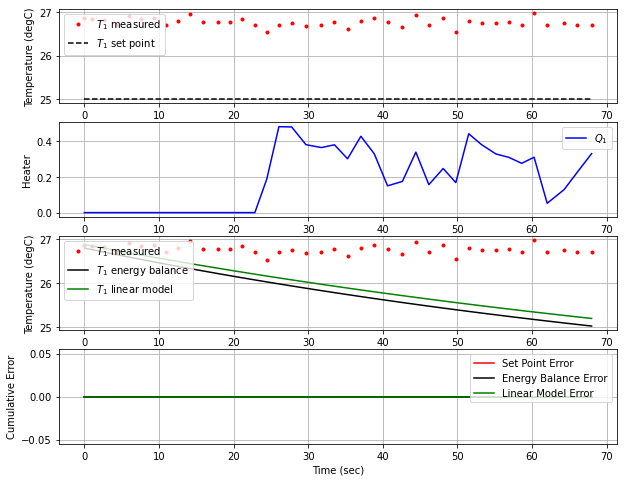

T1 NIH BOS  [26.93 26.7  26.87 26.55 26.79 26.75 26.74 26.76 26.71 26.97 26.71 26.74
 26.7  26.71 26.69]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  71.7  25.00  26.63   0.00   0.40


<Figure size 432x288 with 0 Axes>

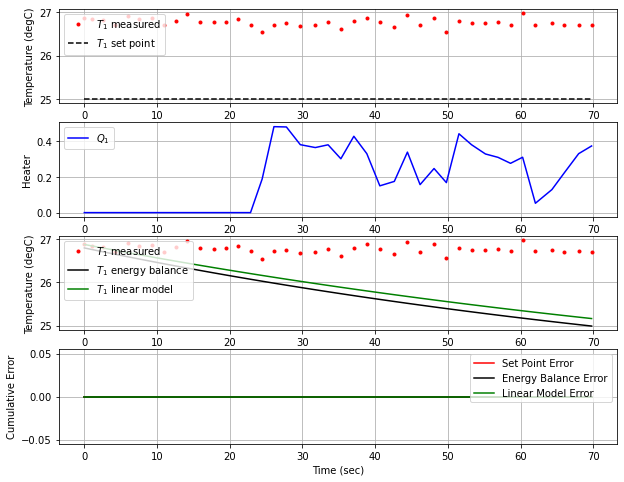

T1 NIH BOS  [26.7  26.87 26.55 26.79 26.75 26.74 26.76 26.71 26.97 26.71 26.74 26.7
 26.71 26.69 26.63]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  73.5  25.00  26.72   0.00   0.50


<Figure size 432x288 with 0 Axes>

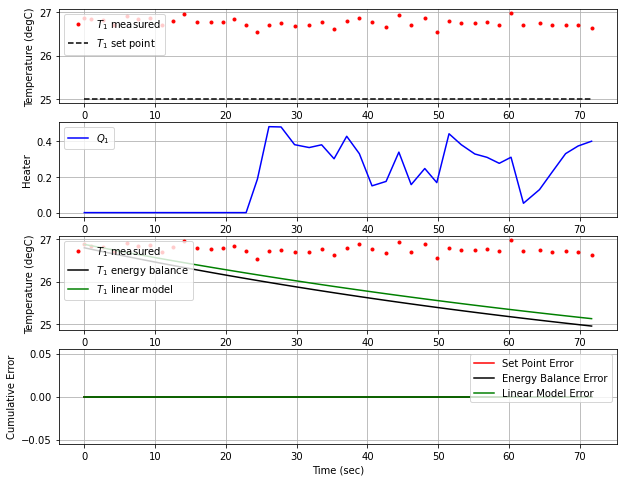

T1 NIH BOS  [26.87 26.55 26.79 26.75 26.74 26.76 26.71 26.97 26.71 26.74 26.7  26.71
 26.69 26.63 26.72]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  75.2  25.00  26.85   0.00   0.45


<Figure size 432x288 with 0 Axes>

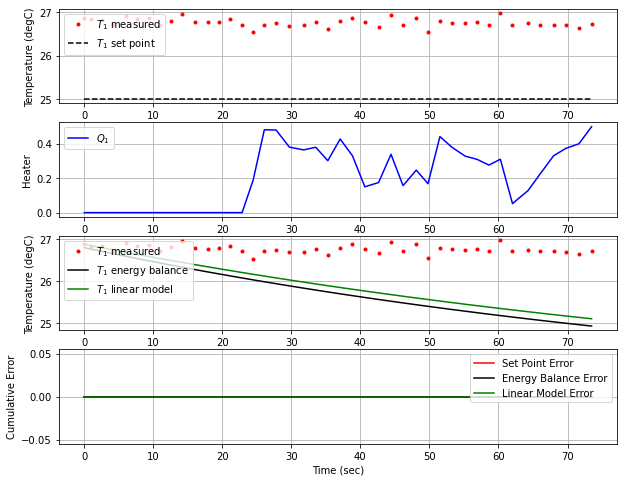

T1 NIH BOS  [26.55 26.79 26.75 26.74 26.76 26.71 26.97 26.71 26.74 26.7  26.71 26.69
 26.63 26.72 26.85]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  77.0  25.00  26.73   0.00   0.26


<Figure size 432x288 with 0 Axes>

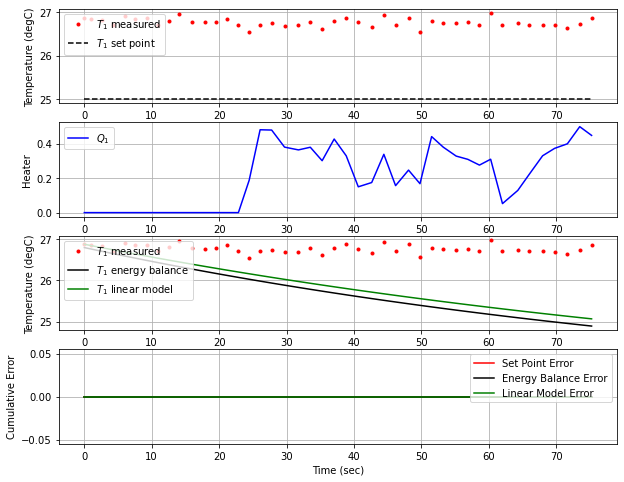

T1 NIH BOS  [26.79 26.75 26.74 26.76 26.71 26.97 26.71 26.74 26.7  26.71 26.69 26.63
 26.72 26.85 26.73]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 85ms/step
  79.4  25.00  26.72   0.00   0.23


<Figure size 432x288 with 0 Axes>

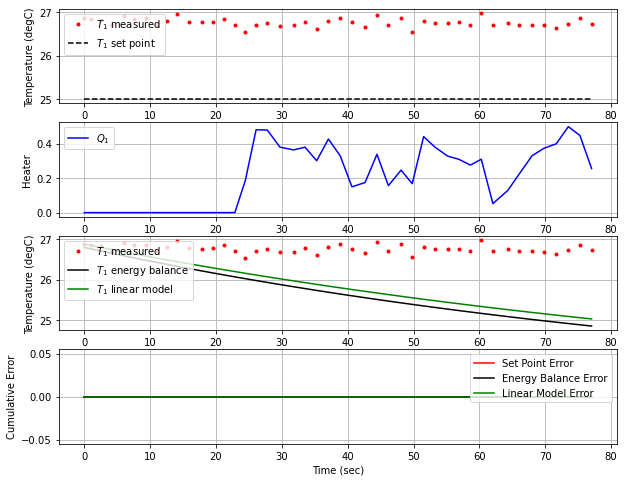

T1 NIH BOS  [26.75 26.74 26.76 26.71 26.97 26.71 26.74 26.7  26.71 26.69 26.63 26.72
 26.85 26.73 26.72]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  81.8  25.00  26.59   0.00   0.28


<Figure size 432x288 with 0 Axes>

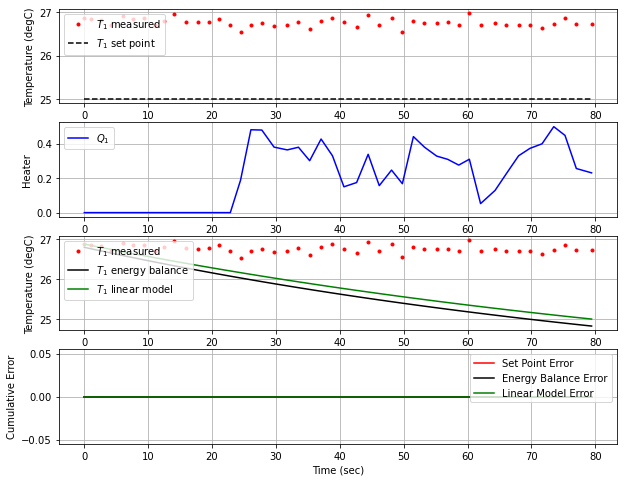

T1 NIH BOS  [26.74 26.76 26.71 26.97 26.71 26.74 26.7  26.71 26.69 26.63 26.72 26.85
 26.73 26.72 26.59]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  83.7  25.00  26.79   0.00   0.47


<Figure size 432x288 with 0 Axes>

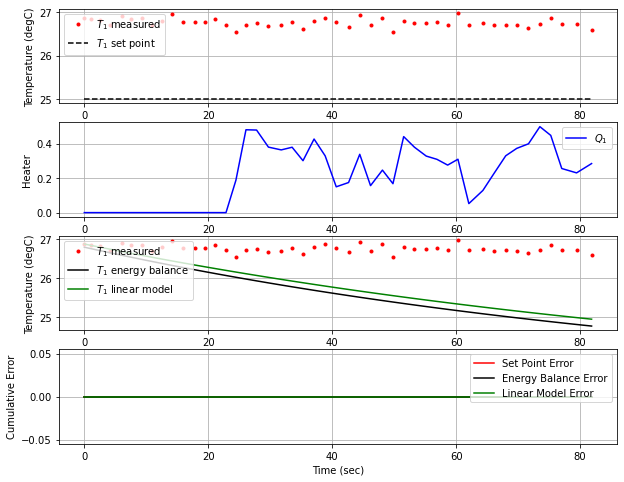

T1 NIH BOS  [26.76 26.71 26.97 26.71 26.74 26.7  26.71 26.69 26.63 26.72 26.85 26.73
 26.72 26.59 26.79]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  85.3  25.00  26.64   0.00   0.38


<Figure size 432x288 with 0 Axes>

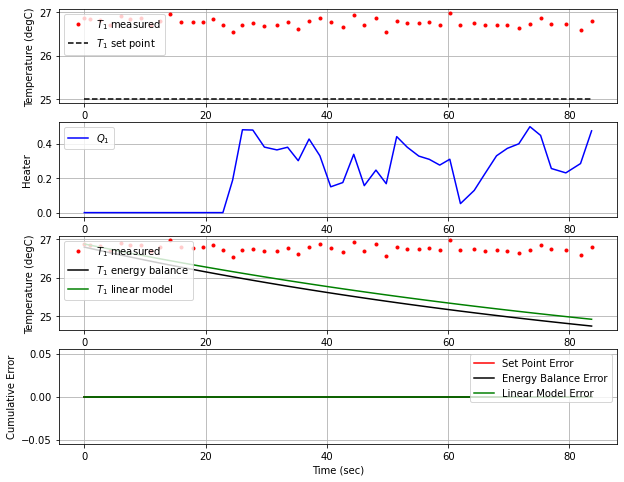

T1 NIH BOS  [26.71 26.97 26.71 26.74 26.7  26.71 26.69 26.63 26.72 26.85 26.73 26.72
 26.59 26.79 26.64]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 41ms/step
  87.0  25.00  26.57   0.00   0.44


<Figure size 432x288 with 0 Axes>

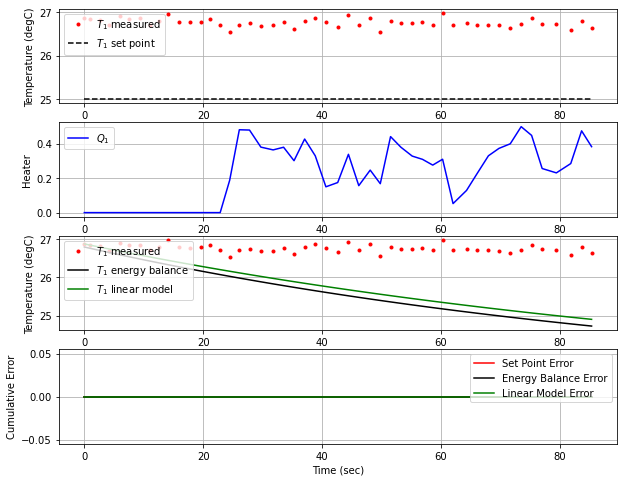

T1 NIH BOS  [26.97 26.71 26.74 26.7  26.71 26.69 26.63 26.72 26.85 26.73 26.72 26.59
 26.79 26.64 26.57]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 38ms/step
  88.8  25.00  26.66   0.00   0.59


<Figure size 432x288 with 0 Axes>

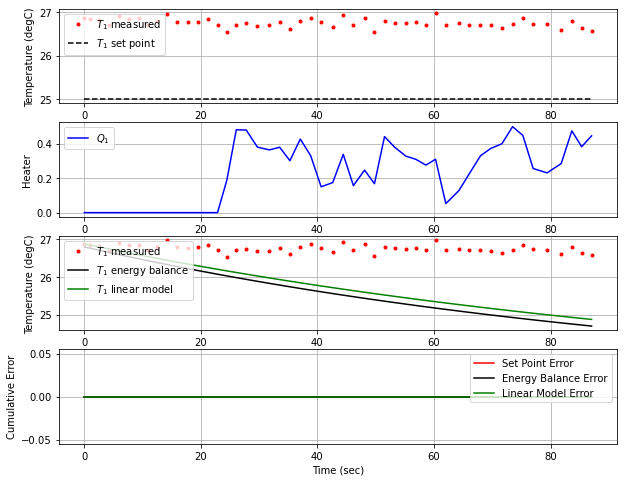

T1 NIH BOS  [26.71 26.74 26.7  26.71 26.69 26.63 26.72 26.85 26.73 26.72 26.59 26.79
 26.64 26.57 26.66]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
  90.5  25.00  26.77   0.00   0.61


<Figure size 432x288 with 0 Axes>

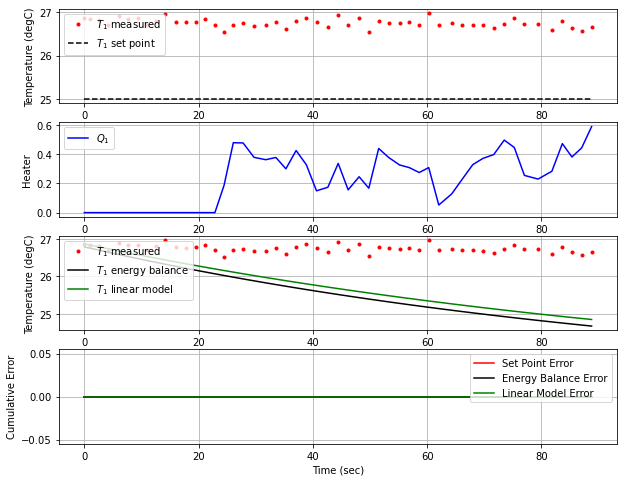

T1 NIH BOS  [26.74 26.7  26.71 26.69 26.63 26.72 26.85 26.73 26.72 26.59 26.79 26.64
 26.57 26.66 26.77]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
  92.2  25.00  26.71   0.00   0.45


<Figure size 432x288 with 0 Axes>

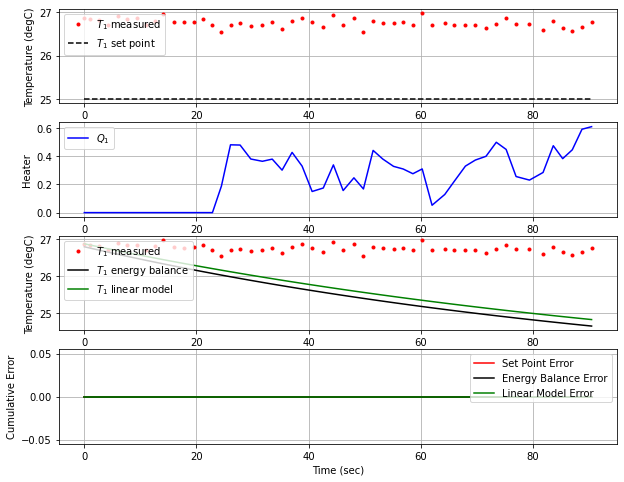

T1 NIH BOS  [26.7  26.71 26.69 26.63 26.72 26.85 26.73 26.72 26.59 26.79 26.64 26.57
 26.66 26.77 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 53ms/step
  94.3  25.00  26.79   0.00   0.40


<Figure size 432x288 with 0 Axes>

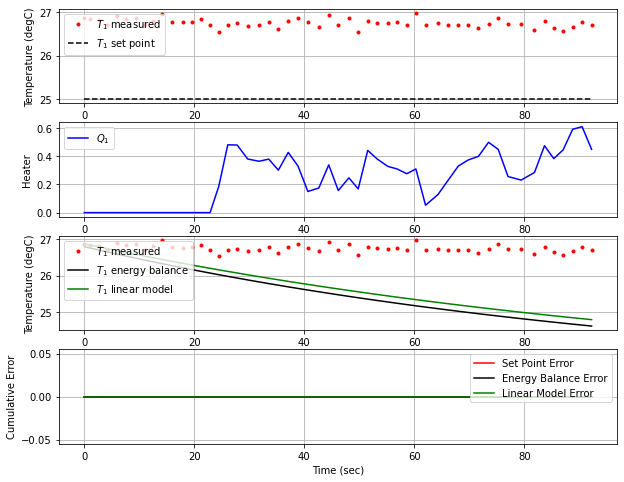

T1 NIH BOS  [26.71 26.69 26.63 26.72 26.85 26.73 26.72 26.59 26.79 26.64 26.57 26.66
 26.77 26.71 26.79]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 40ms/step
  96.4  25.00  26.55   0.00   0.30


<Figure size 432x288 with 0 Axes>

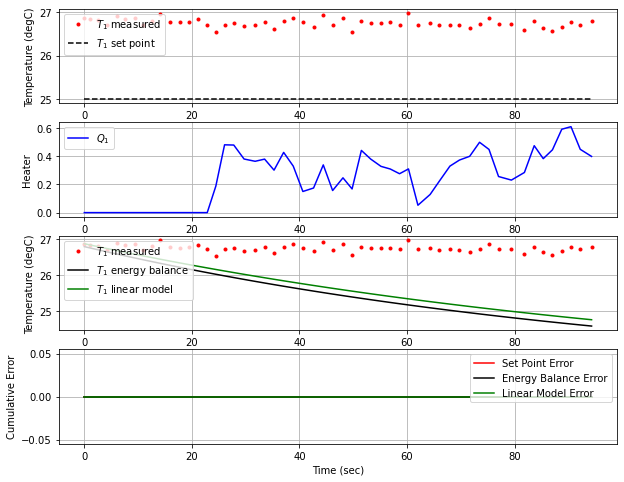

T1 NIH BOS  [26.69 26.63 26.72 26.85 26.73 26.72 26.59 26.79 26.64 26.57 26.66 26.77
 26.71 26.79 26.55]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 46ms/step
  98.3  25.00  26.71   0.00   0.51


<Figure size 432x288 with 0 Axes>

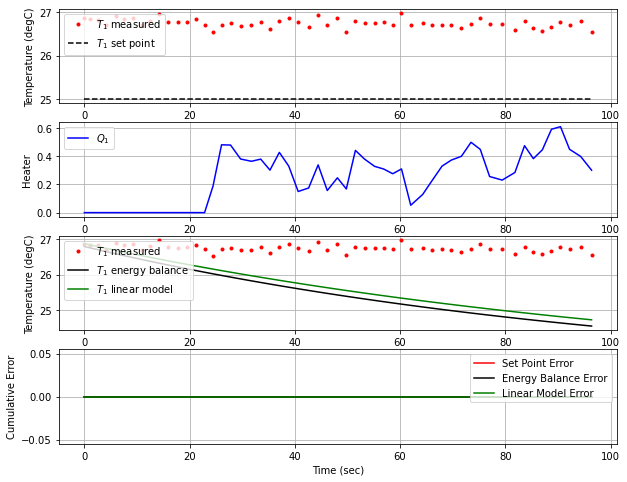

T1 NIH BOS  [26.63 26.72 26.85 26.73 26.72 26.59 26.79 26.64 26.57 26.66 26.77 26.71
 26.79 26.55 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
 100.0  25.00  26.59   0.00   0.51


<Figure size 432x288 with 0 Axes>

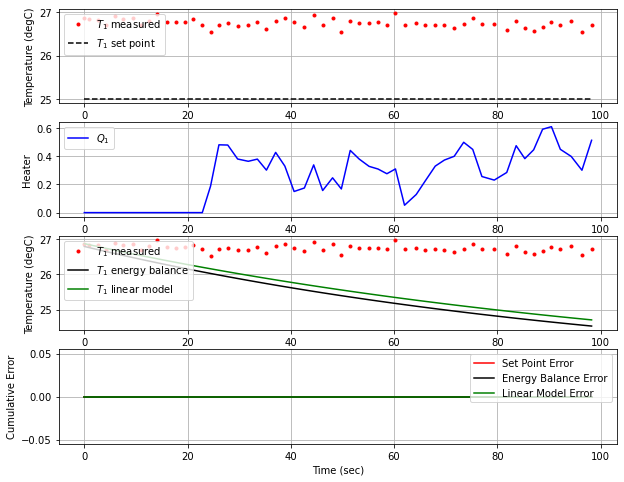

T1 NIH BOS  [26.72 26.85 26.73 26.72 26.59 26.79 26.64 26.57 26.66 26.77 26.71 26.79
 26.55 26.71 26.59]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
 101.8  25.00  26.62   0.00   0.60


<Figure size 432x288 with 0 Axes>

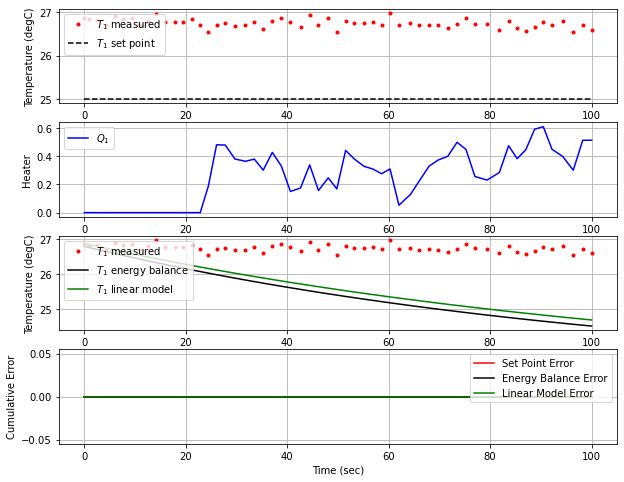

T1 NIH BOS  [26.85 26.73 26.72 26.59 26.79 26.64 26.57 26.66 26.77 26.71 26.79 26.55
 26.71 26.59 26.62]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
 103.7  25.00  26.85   0.00   0.64


<Figure size 432x288 with 0 Axes>

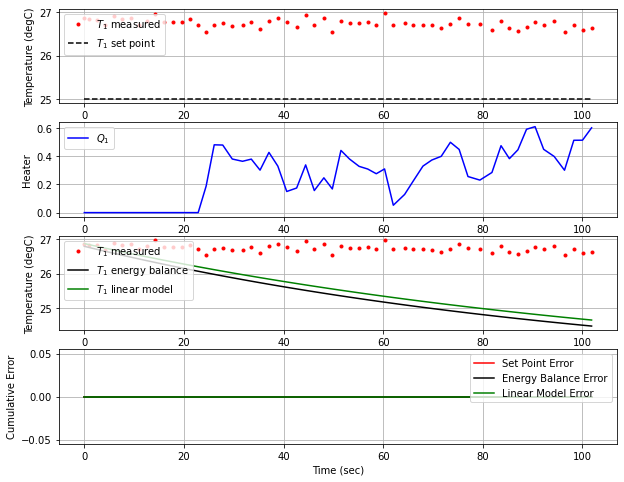

T1 NIH BOS  [26.73 26.72 26.59 26.79 26.64 26.57 26.66 26.77 26.71 26.79 26.55 26.71
 26.59 26.62 26.85]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 37ms/step
 105.7  25.00  26.77   0.00   0.40


<Figure size 432x288 with 0 Axes>

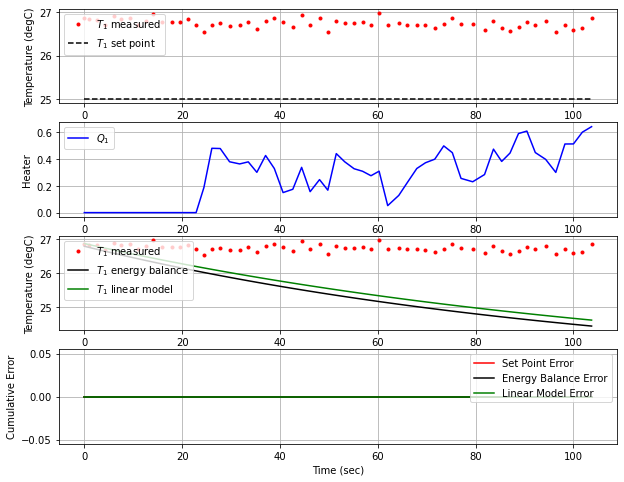

T1 NIH BOS  [26.72 26.59 26.79 26.64 26.57 26.66 26.77 26.71 26.79 26.55 26.71 26.59
 26.62 26.85 26.77]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25.]
1/1 [==============================] - 0s 36ms/step
 107.9  45.00  26.66   0.00   0.30


<Figure size 432x288 with 0 Axes>

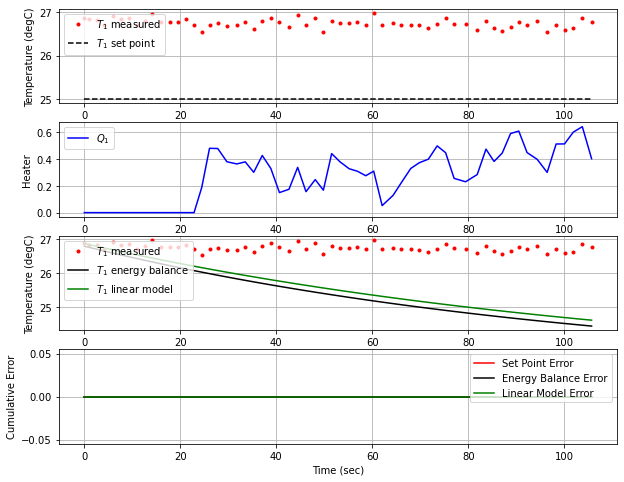

T1 NIH BOS  [26.59 26.79 26.64 26.57 26.66 26.77 26.71 26.79 26.55 26.71 26.59 26.62
 26.85 26.77 26.66]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 45.]
1/1 [==============================] - 0s 37ms/step
 109.7  45.00  26.78   0.00  67.35


<Figure size 432x288 with 0 Axes>

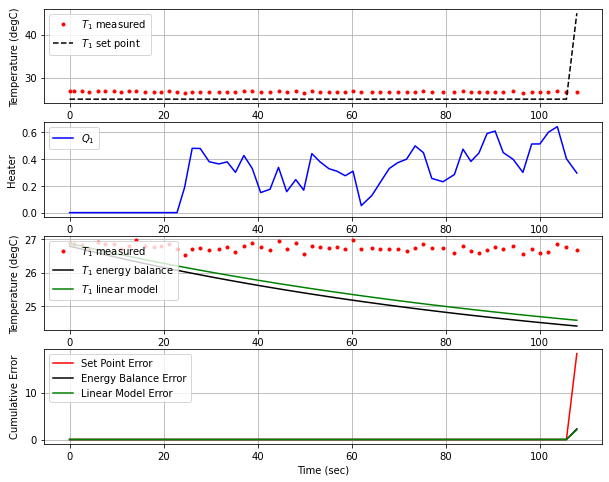

T1 NIH BOS  [26.79 26.64 26.57 26.66 26.77 26.71 26.79 26.55 26.71 26.59 26.62 26.85
 26.77 26.66 26.78]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 111.6  45.00  26.84   0.00  87.06


<Figure size 432x288 with 0 Axes>

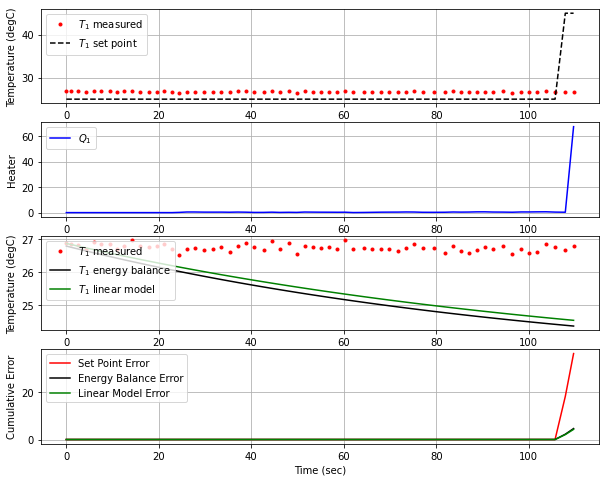

T1 NIH BOS  [26.64 26.57 26.66 26.77 26.71 26.79 26.55 26.71 26.59 26.62 26.85 26.77
 26.66 26.78 26.84]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 113.5  45.00  26.67   0.00  88.25


<Figure size 432x288 with 0 Axes>

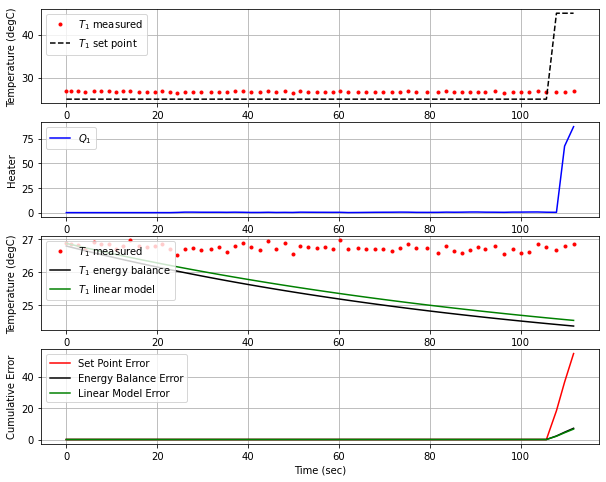

T1 NIH BOS  [26.57 26.66 26.77 26.71 26.79 26.55 26.71 26.59 26.62 26.85 26.77 26.66
 26.78 26.84 26.67]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 115.3  45.00  26.91   0.00  94.40


<Figure size 432x288 with 0 Axes>

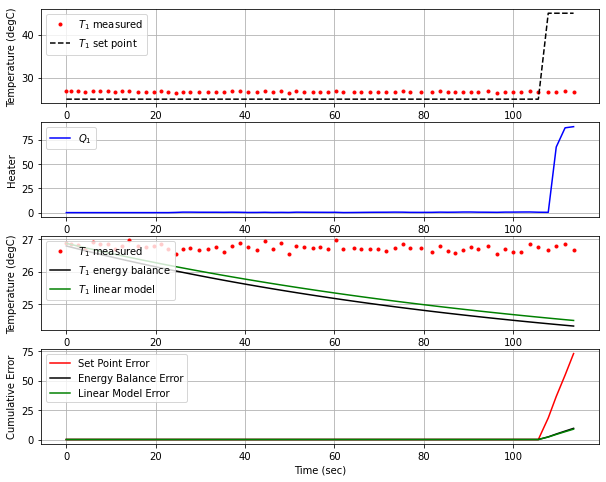

T1 NIH BOS  [26.66 26.77 26.71 26.79 26.55 26.71 26.59 26.62 26.85 26.77 26.66 26.78
 26.84 26.67 26.91]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 25. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 117.0  45.00  26.71   0.00  98.65


<Figure size 432x288 with 0 Axes>

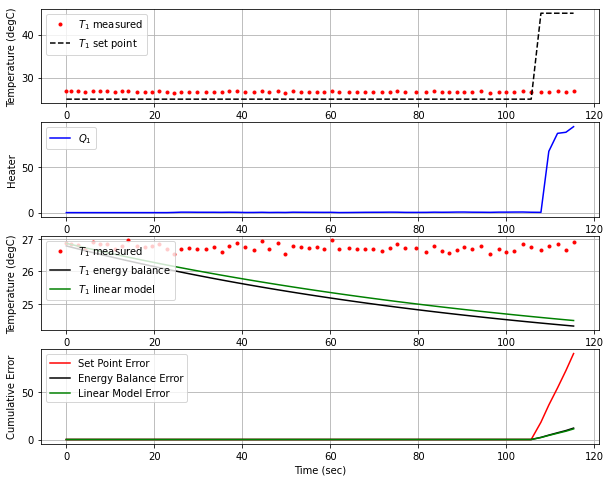

T1 NIH BOS  [26.77 26.71 26.79 26.55 26.71 26.59 26.62 26.85 26.77 26.66 26.78 26.84
 26.67 26.91 26.71]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 25. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 118.8  45.00  26.93   0.00 100.00


<Figure size 432x288 with 0 Axes>

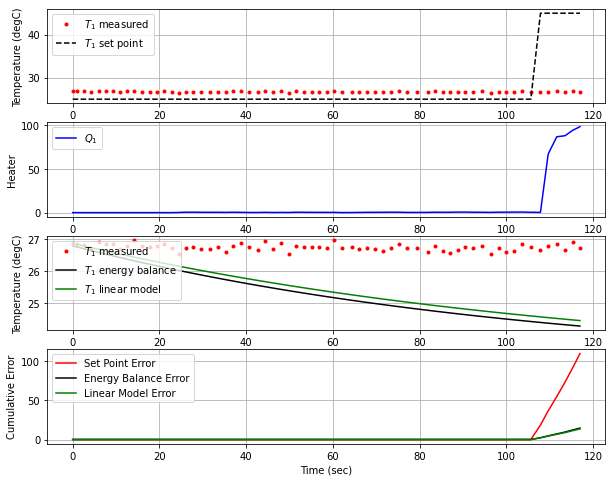

T1 NIH BOS  [26.71 26.79 26.55 26.71 26.59 26.62 26.85 26.77 26.66 26.78 26.84 26.67
 26.91 26.71 26.93]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 25. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 120.9  45.00  26.87   0.00 100.00


<Figure size 432x288 with 0 Axes>

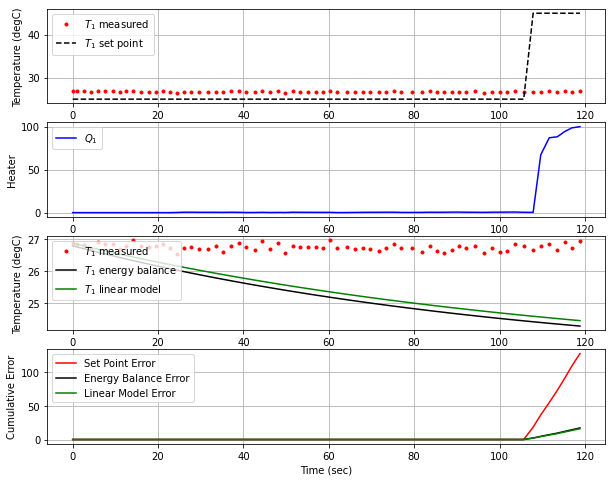

T1 NIH BOS  [26.79 26.55 26.71 26.59 26.62 26.85 26.77 26.66 26.78 26.84 26.67 26.91
 26.71 26.93 26.87]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 25. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 122.7  45.00  27.16   0.00 100.00


<Figure size 432x288 with 0 Axes>

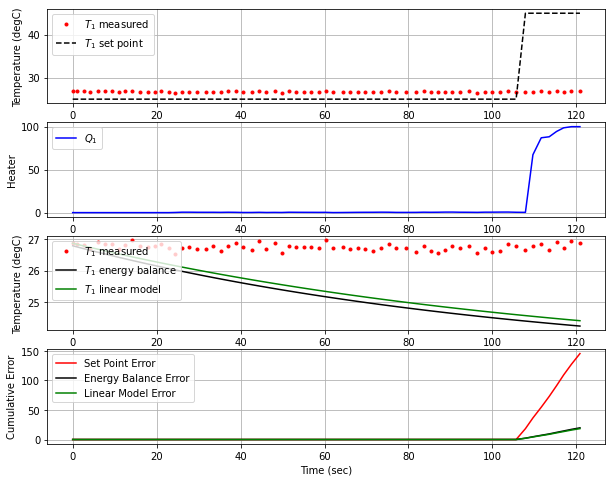

T1 NIH BOS  [26.55 26.71 26.59 26.62 26.85 26.77 26.66 26.78 26.84 26.67 26.91 26.71
 26.93 26.87 27.16]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 25. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 124.4  45.00  27.15   0.00 100.00


<Figure size 432x288 with 0 Axes>

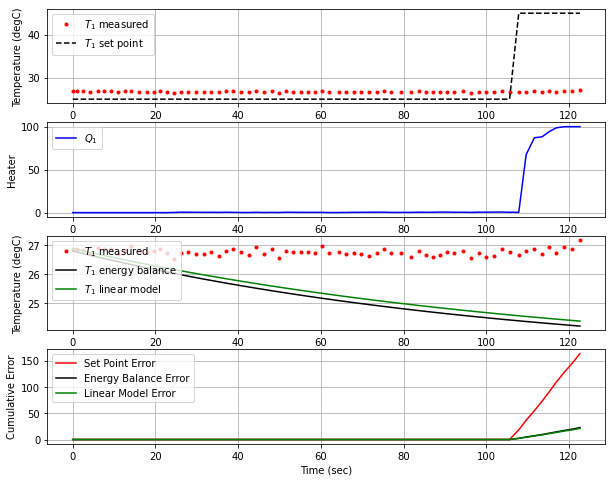

T1 NIH BOS  [26.71 26.59 26.62 26.85 26.77 26.66 26.78 26.84 26.67 26.91 26.71 26.93
 26.87 27.16 27.15]
Tsp1 NIH BOS  [25. 25. 25. 25. 25. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 65ms/step
 126.3  45.00  27.36   0.00 100.00


<Figure size 432x288 with 0 Axes>

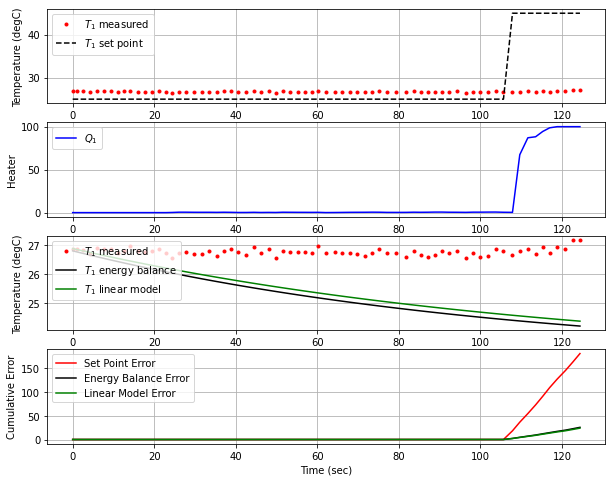

T1 NIH BOS  [26.59 26.62 26.85 26.77 26.66 26.78 26.84 26.67 26.91 26.71 26.93 26.87
 27.16 27.15 27.36]
Tsp1 NIH BOS  [25. 25. 25. 25. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 128.4  45.00  27.39   0.00 100.00


<Figure size 432x288 with 0 Axes>

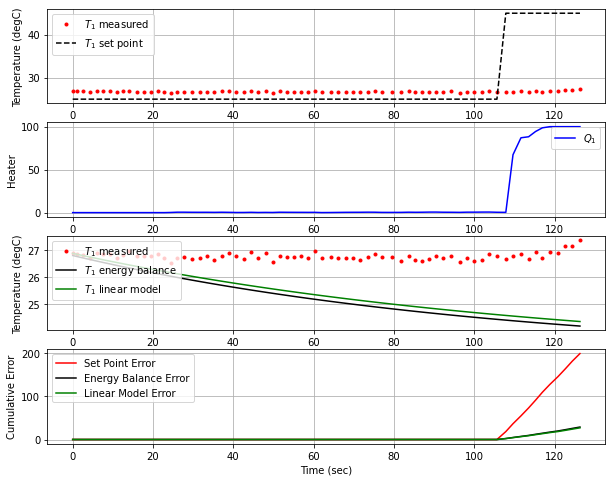

T1 NIH BOS  [26.62 26.85 26.77 26.66 26.78 26.84 26.67 26.91 26.71 26.93 26.87 27.16
 27.15 27.36 27.39]
Tsp1 NIH BOS  [25. 25. 25. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 130.3  45.00  27.61   0.00 100.00


<Figure size 432x288 with 0 Axes>

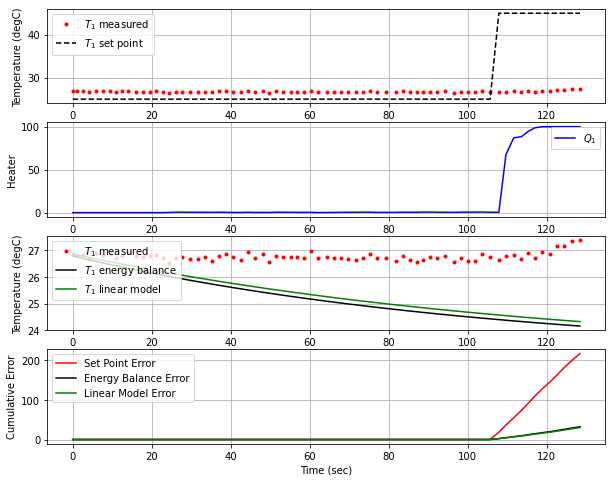

T1 NIH BOS  [26.85 26.77 26.66 26.78 26.84 26.67 26.91 26.71 26.93 26.87 27.16 27.15
 27.36 27.39 27.61]
Tsp1 NIH BOS  [25. 25. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 132.0  45.00  27.56   0.00 100.00


<Figure size 432x288 with 0 Axes>

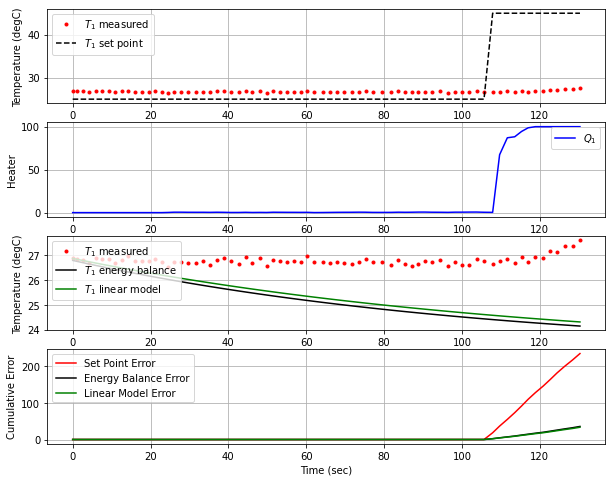

T1 NIH BOS  [26.77 26.66 26.78 26.84 26.67 26.91 26.71 26.93 26.87 27.16 27.15 27.36
 27.39 27.61 27.56]
Tsp1 NIH BOS  [25. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 133.9  45.00  27.85   0.00 100.00


<Figure size 432x288 with 0 Axes>

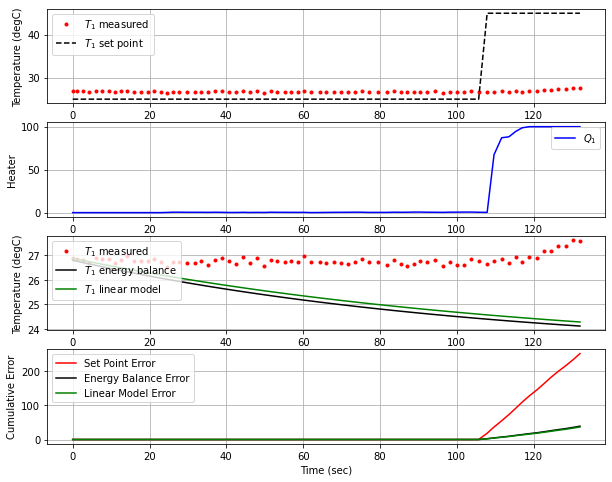

T1 NIH BOS  [26.66 26.78 26.84 26.67 26.91 26.71 26.93 26.87 27.16 27.15 27.36 27.39
 27.61 27.56 27.85]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 136.0  45.00  28.09   0.00 100.00


<Figure size 432x288 with 0 Axes>

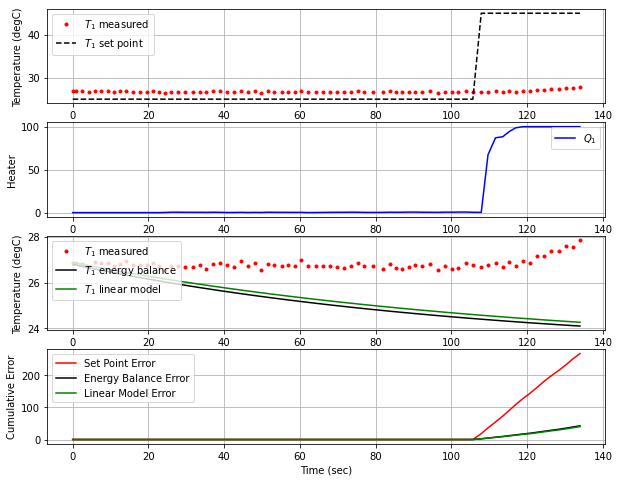

T1 NIH BOS  [26.78 26.84 26.67 26.91 26.71 26.93 26.87 27.16 27.15 27.36 27.39 27.61
 27.56 27.85 28.09]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 137.9  45.00  28.42   0.00 100.00


<Figure size 432x288 with 0 Axes>

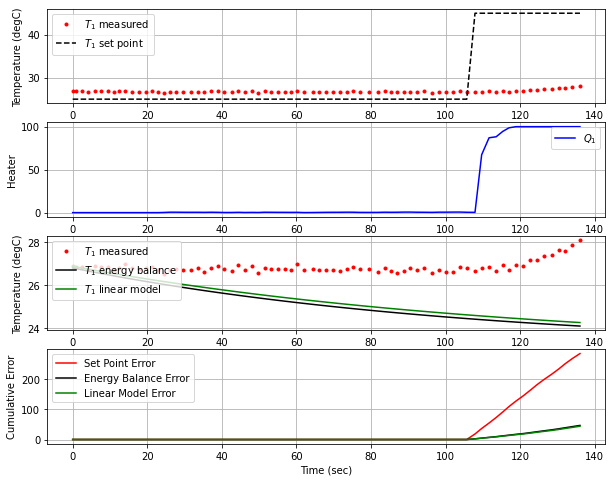

T1 NIH BOS  [26.84 26.67 26.91 26.71 26.93 26.87 27.16 27.15 27.36 27.39 27.61 27.56
 27.85 28.09 28.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 139.9  45.00  28.61   0.00 100.00


<Figure size 432x288 with 0 Axes>

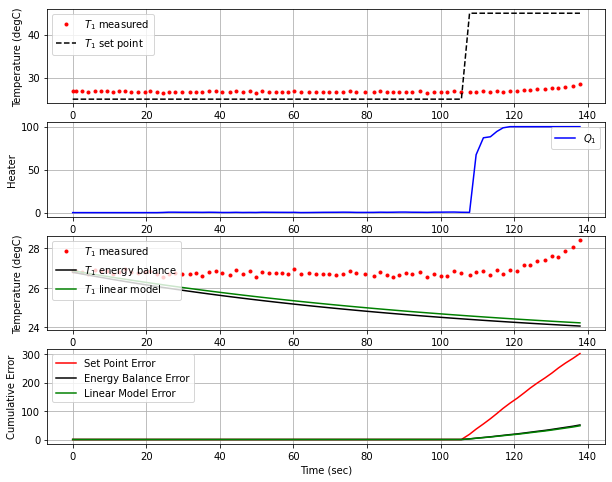

T1 NIH BOS  [26.67 26.91 26.71 26.93 26.87 27.16 27.15 27.36 27.39 27.61 27.56 27.85
 28.09 28.42 28.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 53ms/step
 141.7  45.00  28.91   0.00 100.00


<Figure size 432x288 with 0 Axes>

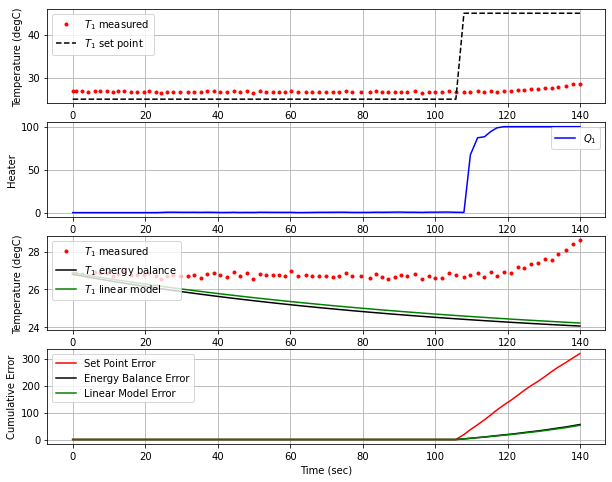

T1 NIH BOS  [26.91 26.71 26.93 26.87 27.16 27.15 27.36 27.39 27.61 27.56 27.85 28.09
 28.42 28.61 28.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 143.9  45.00  29.17   0.00 100.00


<Figure size 432x288 with 0 Axes>

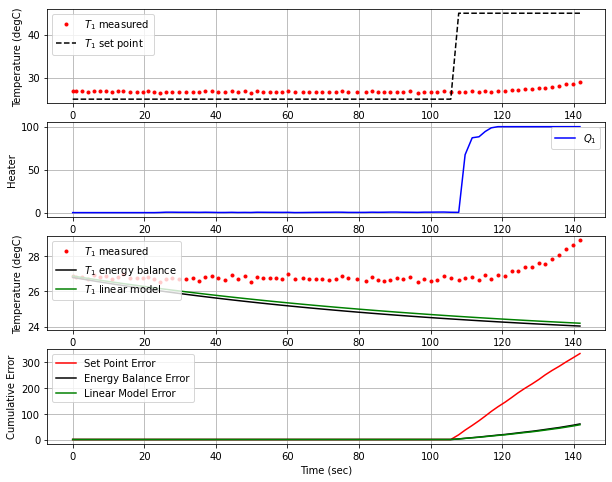

T1 NIH BOS  [26.71 26.93 26.87 27.16 27.15 27.36 27.39 27.61 27.56 27.85 28.09 28.42
 28.61 28.91 29.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 145.7  45.00  29.24   0.00 100.00


<Figure size 432x288 with 0 Axes>

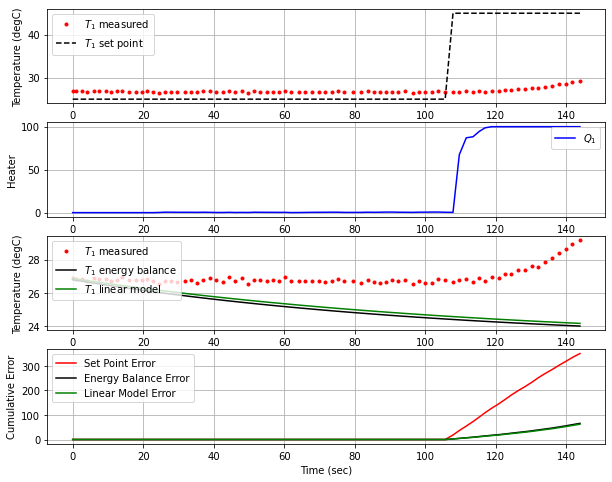

T1 NIH BOS  [26.93 26.87 27.16 27.15 27.36 27.39 27.61 27.56 27.85 28.09 28.42 28.61
 28.91 29.17 29.24]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 147.6  45.00  29.54   0.00 100.00


<Figure size 432x288 with 0 Axes>

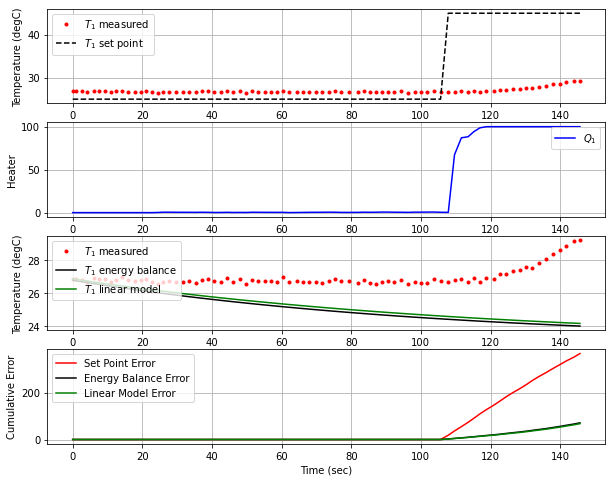

T1 NIH BOS  [26.87 27.16 27.15 27.36 27.39 27.61 27.56 27.85 28.09 28.42 28.61 28.91
 29.17 29.24 29.54]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 149.6  45.00  29.75   0.00 100.00


<Figure size 432x288 with 0 Axes>

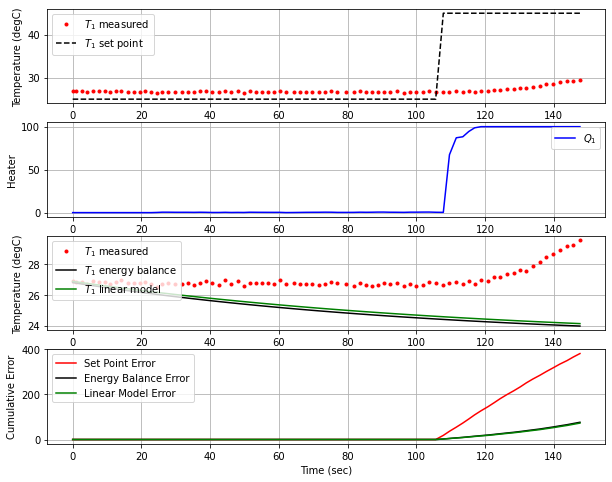

T1 NIH BOS  [27.16 27.15 27.36 27.39 27.61 27.56 27.85 28.09 28.42 28.61 28.91 29.17
 29.24 29.54 29.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 151.4  45.00  29.99   0.00 100.00


<Figure size 432x288 with 0 Axes>

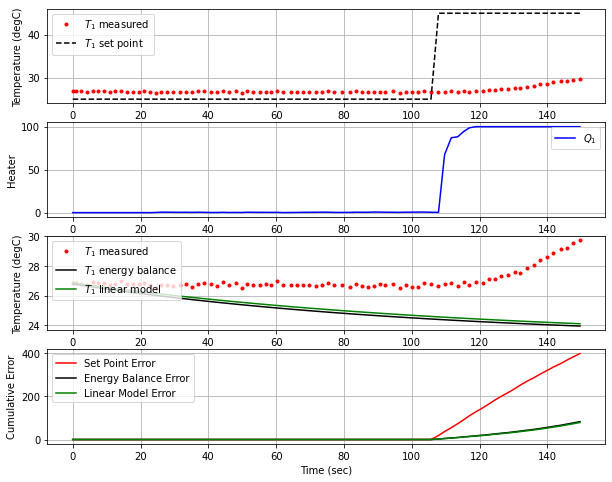

T1 NIH BOS  [27.15 27.36 27.39 27.61 27.56 27.85 28.09 28.42 28.61 28.91 29.17 29.24
 29.54 29.75 29.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 153.2  45.00  30.26   0.00 100.00


<Figure size 432x288 with 0 Axes>

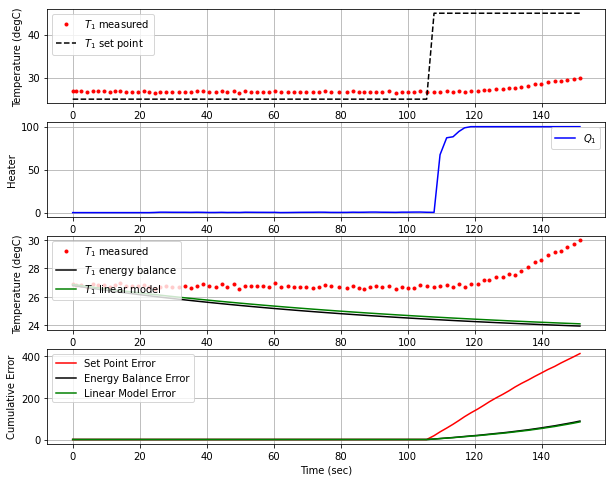

T1 NIH BOS  [27.36 27.39 27.61 27.56 27.85 28.09 28.42 28.61 28.91 29.17 29.24 29.54
 29.75 29.99 30.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 155.1  45.00  30.41   0.00 100.00


<Figure size 432x288 with 0 Axes>

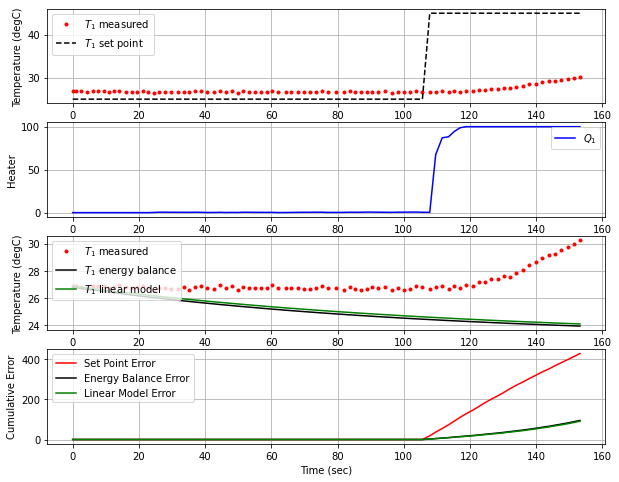

T1 NIH BOS  [27.39 27.61 27.56 27.85 28.09 28.42 28.61 28.91 29.17 29.24 29.54 29.75
 29.99 30.26 30.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 157.0  45.00  30.76   0.00 100.00


<Figure size 432x288 with 0 Axes>

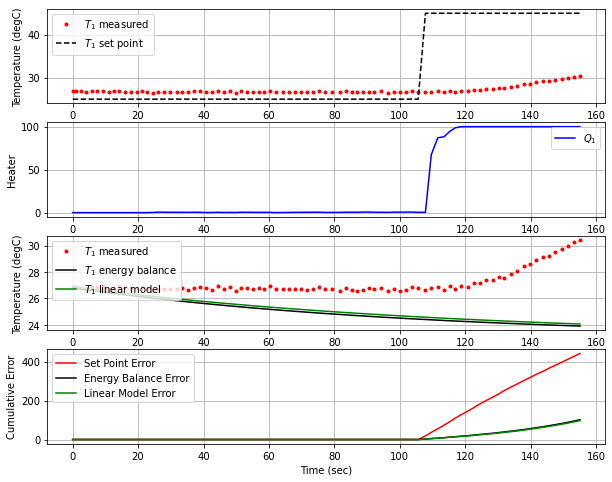

T1 NIH BOS  [27.61 27.56 27.85 28.09 28.42 28.61 28.91 29.17 29.24 29.54 29.75 29.99
 30.26 30.41 30.76]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 59ms/step
 159.6  45.00  31.03   0.00  99.84


<Figure size 432x288 with 0 Axes>

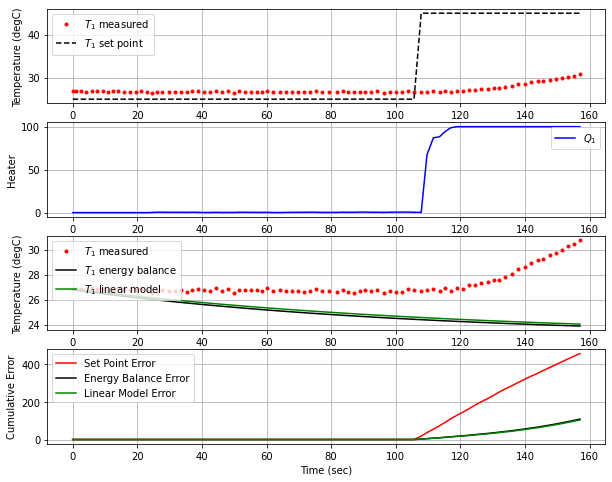

T1 NIH BOS  [27.56 27.85 28.09 28.42 28.61 28.91 29.17 29.24 29.54 29.75 29.99 30.26
 30.41 30.76 31.03]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 161.5  45.00  31.26   0.00  99.62


<Figure size 432x288 with 0 Axes>

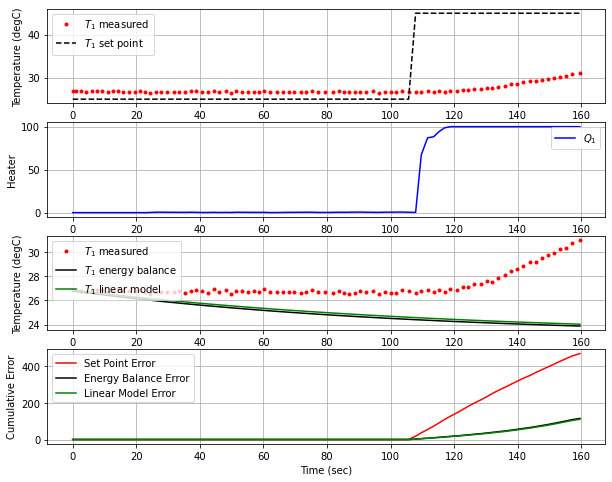

T1 NIH BOS  [27.85 28.09 28.42 28.61 28.91 29.17 29.24 29.54 29.75 29.99 30.26 30.41
 30.76 31.03 31.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 163.3  45.00  31.45   0.00  99.43


<Figure size 432x288 with 0 Axes>

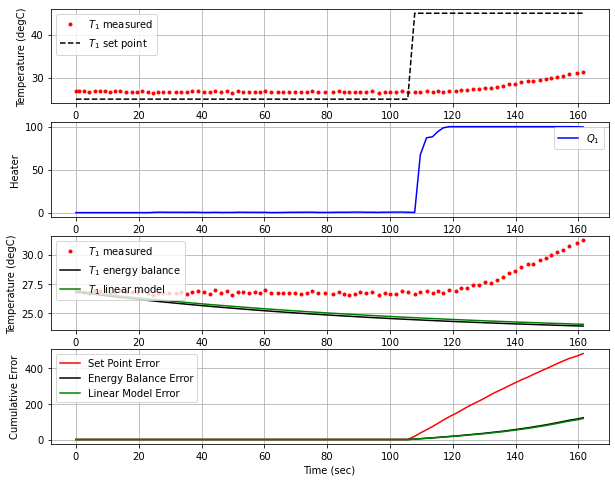

T1 NIH BOS  [28.09 28.42 28.61 28.91 29.17 29.24 29.54 29.75 29.99 30.26 30.41 30.76
 31.03 31.26 31.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 165.0  45.00  31.61   0.00  99.26


<Figure size 432x288 with 0 Axes>

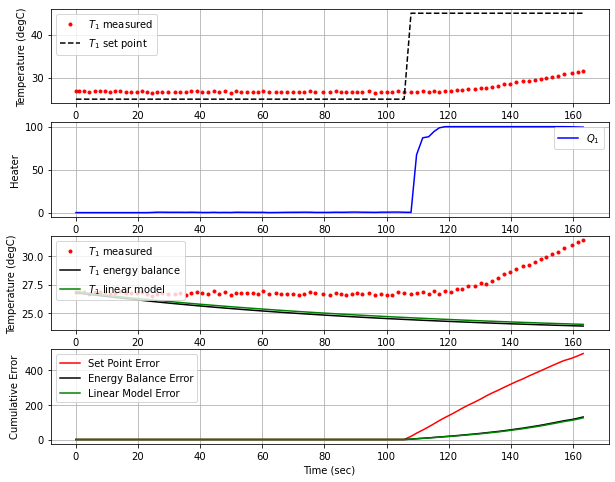

T1 NIH BOS  [28.42 28.61 28.91 29.17 29.24 29.54 29.75 29.99 30.26 30.41 30.76 31.03
 31.26 31.45 31.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 166.7  45.00  31.92   0.00  99.11


<Figure size 432x288 with 0 Axes>

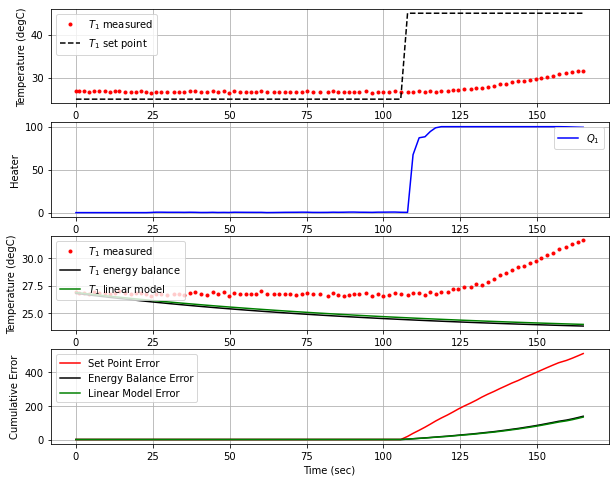

T1 NIH BOS  [28.61 28.91 29.17 29.24 29.54 29.75 29.99 30.26 30.41 30.76 31.03 31.26
 31.45 31.61 31.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 168.5  45.00  32.14   0.00  98.81


<Figure size 432x288 with 0 Axes>

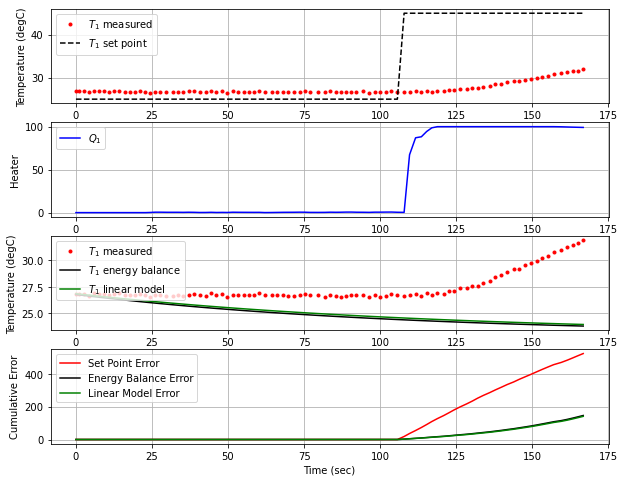

T1 NIH BOS  [28.91 29.17 29.24 29.54 29.75 29.99 30.26 30.41 30.76 31.03 31.26 31.45
 31.61 31.92 32.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 170.3  45.00  32.40   0.00  98.56


<Figure size 432x288 with 0 Axes>

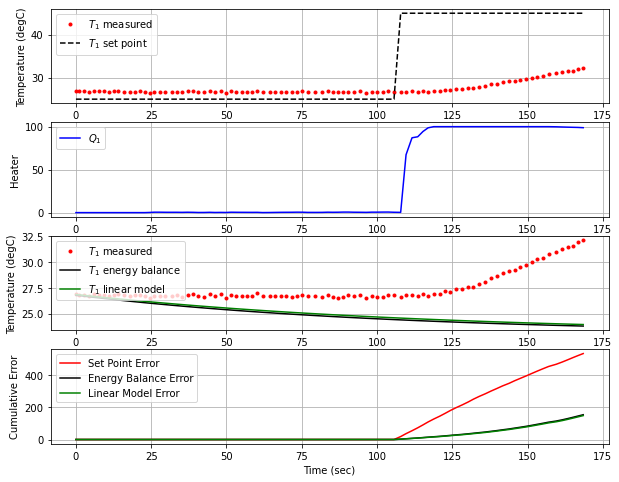

T1 NIH BOS  [29.17 29.24 29.54 29.75 29.99 30.26 30.41 30.76 31.03 31.26 31.45 31.61
 31.92 32.14 32.4 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 172.3  45.00  32.75   0.00  98.26


<Figure size 432x288 with 0 Axes>

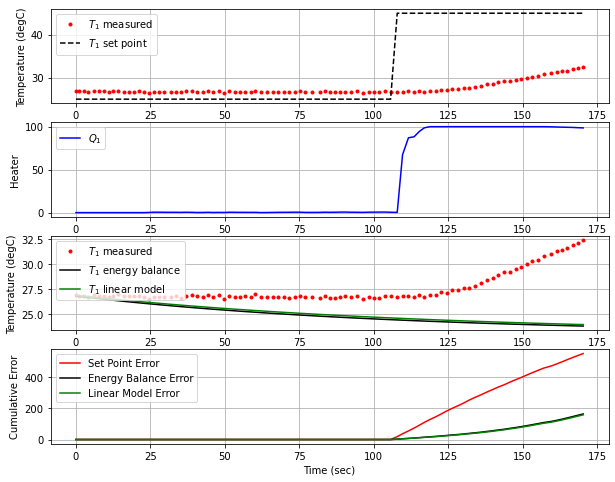

T1 NIH BOS  [29.24 29.54 29.75 29.99 30.26 30.41 30.76 31.03 31.26 31.45 31.61 31.92
 32.14 32.4  32.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 174.3  45.00  33.40   0.00  97.83


<Figure size 432x288 with 0 Axes>

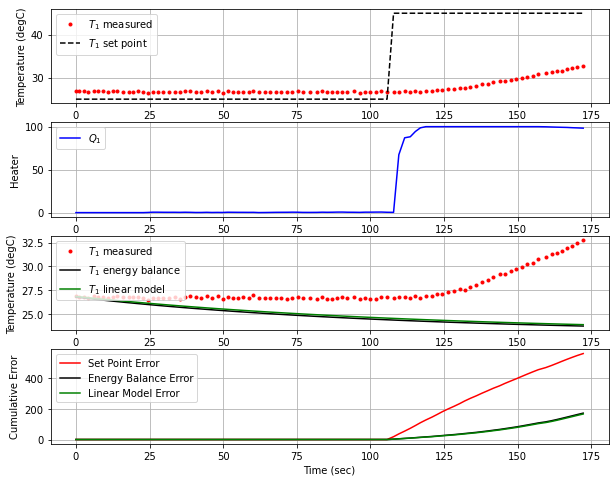

T1 NIH BOS  [29.54 29.75 29.99 30.26 30.41 30.76 31.03 31.26 31.45 31.61 31.92 32.14
 32.4  32.75 33.4 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 176.4  45.00  33.44   0.00  97.03


<Figure size 432x288 with 0 Axes>

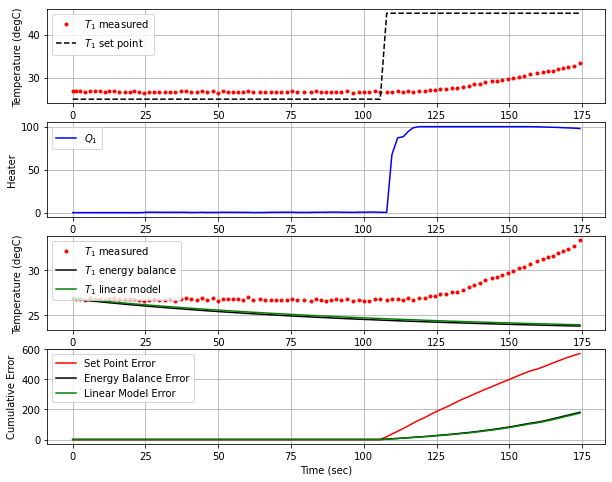

T1 NIH BOS  [29.75 29.99 30.26 30.41 30.76 31.03 31.26 31.45 31.61 31.92 32.14 32.4
 32.75 33.4  33.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 178.2  45.00  33.51   0.00  96.77


<Figure size 432x288 with 0 Axes>

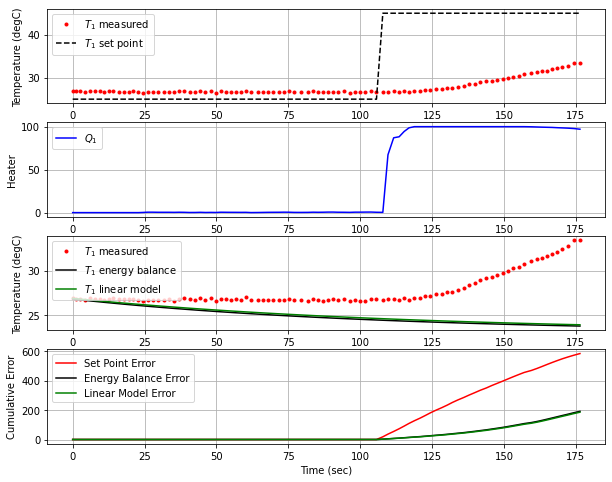

T1 NIH BOS  [29.99 30.26 30.41 30.76 31.03 31.26 31.45 31.61 31.92 32.14 32.4  32.75
 33.4  33.44 33.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 179.9  45.00  33.87   0.00  96.52


<Figure size 432x288 with 0 Axes>

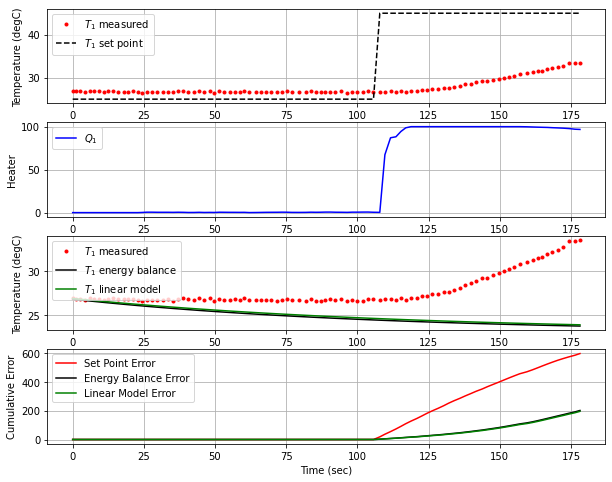

T1 NIH BOS  [30.26 30.41 30.76 31.03 31.26 31.45 31.61 31.92 32.14 32.4  32.75 33.4
 33.44 33.51 33.87]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 181.7  45.00  33.99   0.00  95.94


<Figure size 432x288 with 0 Axes>

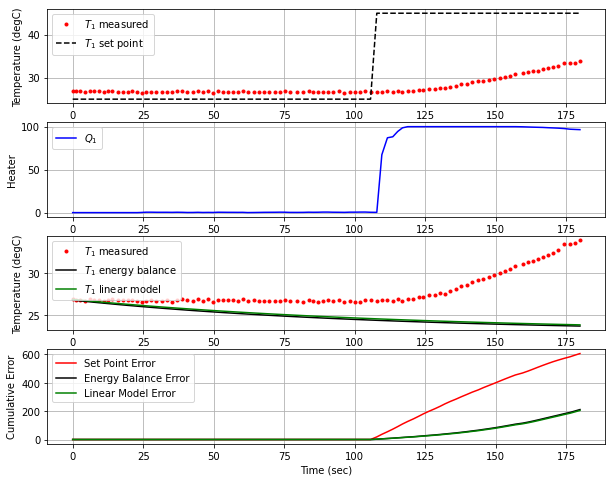

T1 NIH BOS  [30.41 30.76 31.03 31.26 31.45 31.61 31.92 32.14 32.4  32.75 33.4  33.44
 33.51 33.87 33.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 183.4  45.00  34.08   0.00  95.57


<Figure size 432x288 with 0 Axes>

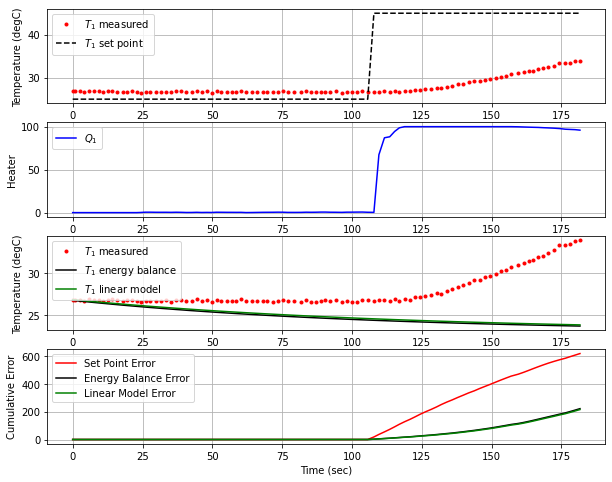

T1 NIH BOS  [30.76 31.03 31.26 31.45 31.61 31.92 32.14 32.4  32.75 33.4  33.44 33.51
 33.87 33.99 34.08]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 185.3  45.00  34.19   0.00  95.24


<Figure size 432x288 with 0 Axes>

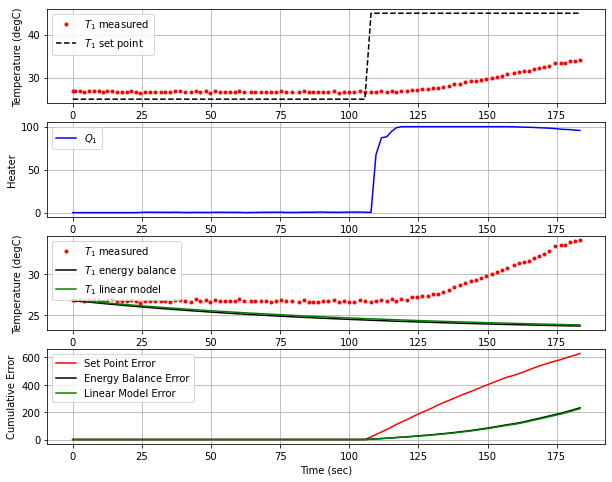

T1 NIH BOS  [31.03 31.26 31.45 31.61 31.92 32.14 32.4  32.75 33.4  33.44 33.51 33.87
 33.99 34.08 34.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 187.3  45.00  34.50   0.00  94.88


<Figure size 432x288 with 0 Axes>

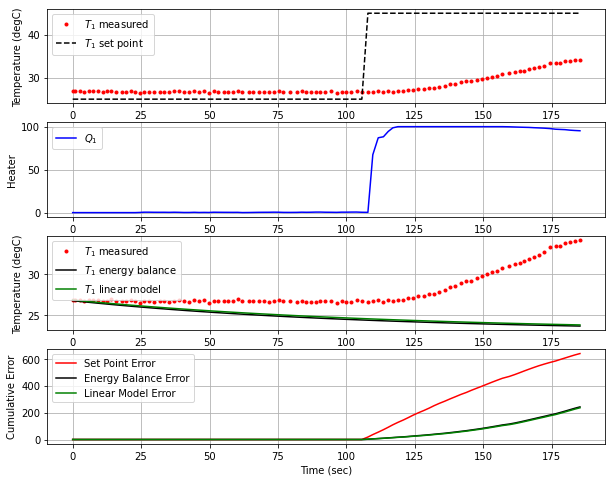

T1 NIH BOS  [31.26 31.45 31.61 31.92 32.14 32.4  32.75 33.4  33.44 33.51 33.87 33.99
 34.08 34.19 34.5 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 189.0  45.00  34.82   0.00  94.30


<Figure size 432x288 with 0 Axes>

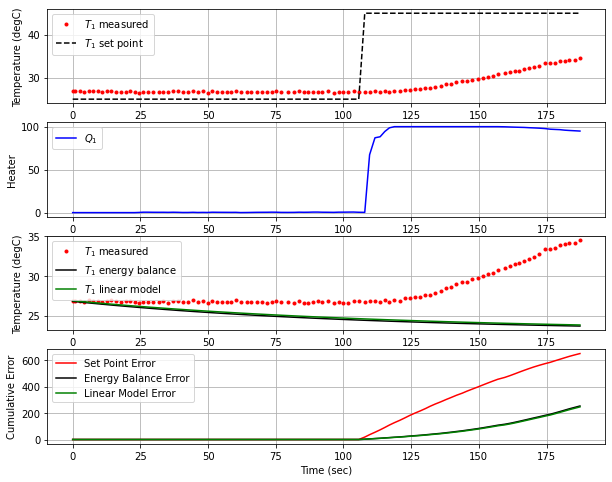

T1 NIH BOS  [31.45 31.61 31.92 32.14 32.4  32.75 33.4  33.44 33.51 33.87 33.99 34.08
 34.19 34.5  34.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 58ms/step
 191.7  45.00  35.04   0.00  93.64


<Figure size 432x288 with 0 Axes>

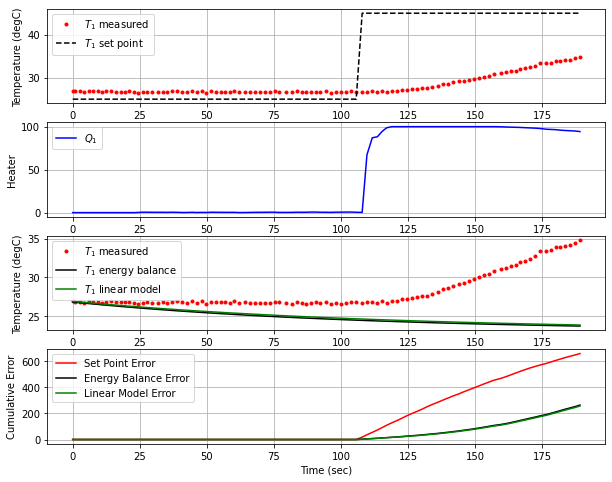

T1 NIH BOS  [31.61 31.92 32.14 32.4  32.75 33.4  33.44 33.51 33.87 33.99 34.08 34.19
 34.5  34.82 35.04]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 193.7  45.00  35.19   0.00  93.03


<Figure size 432x288 with 0 Axes>

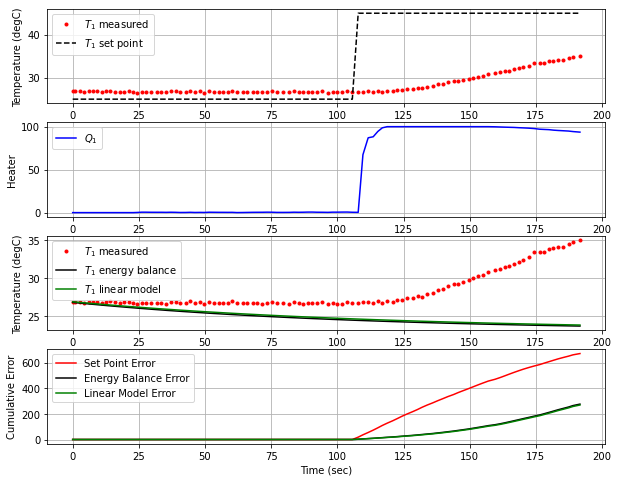

T1 NIH BOS  [31.92 32.14 32.4  32.75 33.4  33.44 33.51 33.87 33.99 34.08 34.19 34.5
 34.82 35.04 35.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 195.6  45.00  35.51   0.00  92.47


<Figure size 432x288 with 0 Axes>

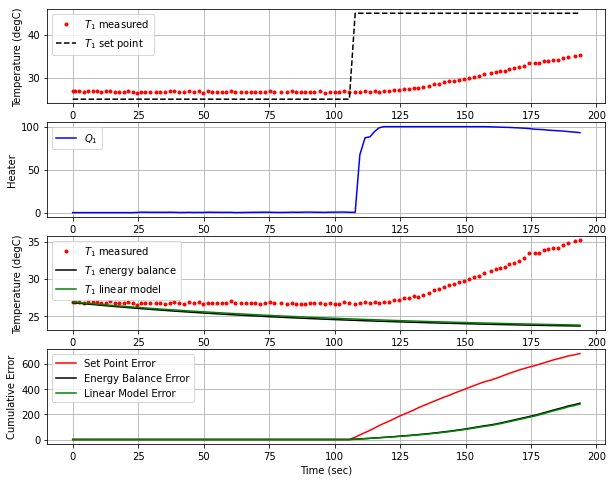

T1 NIH BOS  [32.14 32.4  32.75 33.4  33.44 33.51 33.87 33.99 34.08 34.19 34.5  34.82
 35.04 35.19 35.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 197.9  45.00  35.56   0.00  91.70


<Figure size 432x288 with 0 Axes>

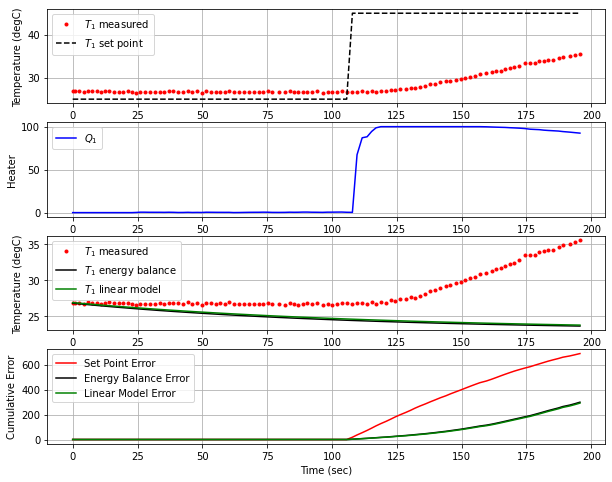

T1 NIH BOS  [32.4  32.75 33.4  33.44 33.51 33.87 33.99 34.08 34.19 34.5  34.82 35.04
 35.19 35.51 35.56]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 199.8  45.00  35.82   0.00  91.18


<Figure size 432x288 with 0 Axes>

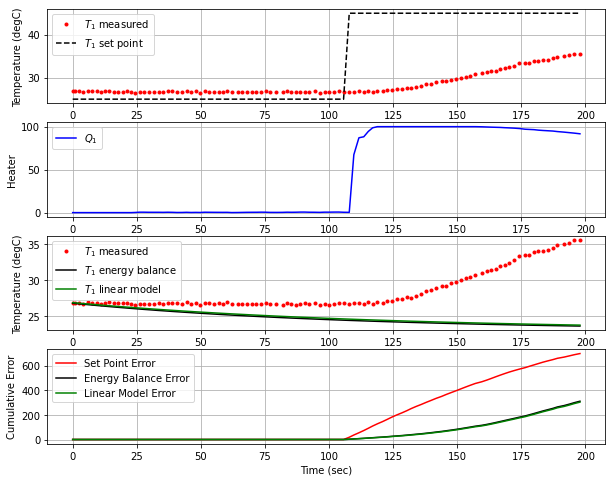

T1 NIH BOS  [32.75 33.4  33.44 33.51 33.87 33.99 34.08 34.19 34.5  34.82 35.04 35.19
 35.51 35.56 35.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 201.7  45.00  36.17   0.00  90.44


<Figure size 432x288 with 0 Axes>

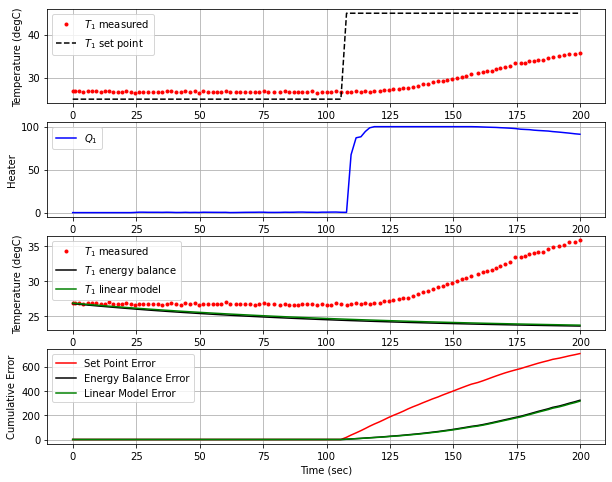

T1 NIH BOS  [33.4  33.44 33.51 33.87 33.99 34.08 34.19 34.5  34.82 35.04 35.19 35.51
 35.56 35.82 36.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 203.5  45.00  36.26   0.00  89.54


<Figure size 432x288 with 0 Axes>

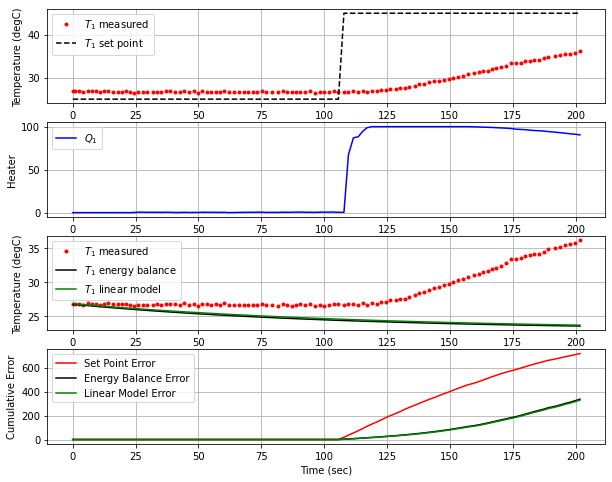

T1 NIH BOS  [33.44 33.51 33.87 33.99 34.08 34.19 34.5  34.82 35.04 35.19 35.51 35.56
 35.82 36.17 36.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 205.3  45.00  36.54   0.00  88.90


<Figure size 432x288 with 0 Axes>

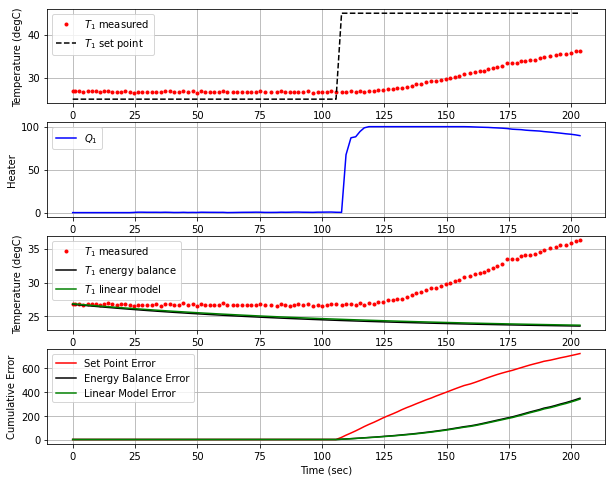

T1 NIH BOS  [33.51 33.87 33.99 34.08 34.19 34.5  34.82 35.04 35.19 35.51 35.56 35.82
 36.17 36.26 36.54]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 207.4  45.00  36.61   0.00  88.04


<Figure size 432x288 with 0 Axes>

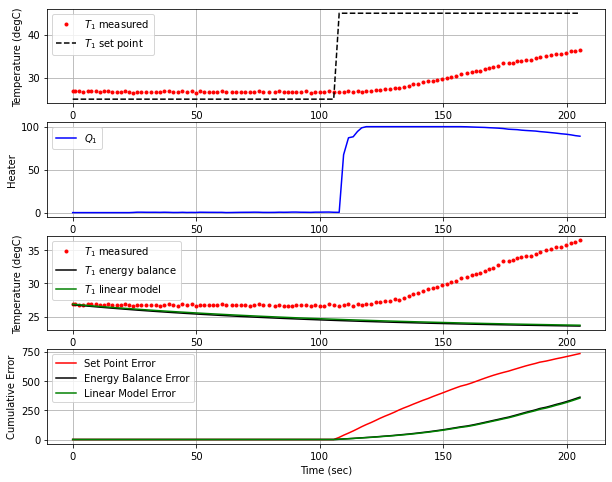

T1 NIH BOS  [33.87 33.99 34.08 34.19 34.5  34.82 35.04 35.19 35.51 35.56 35.82 36.17
 36.26 36.54 36.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 209.3  45.00  36.99   0.00  87.37


<Figure size 432x288 with 0 Axes>

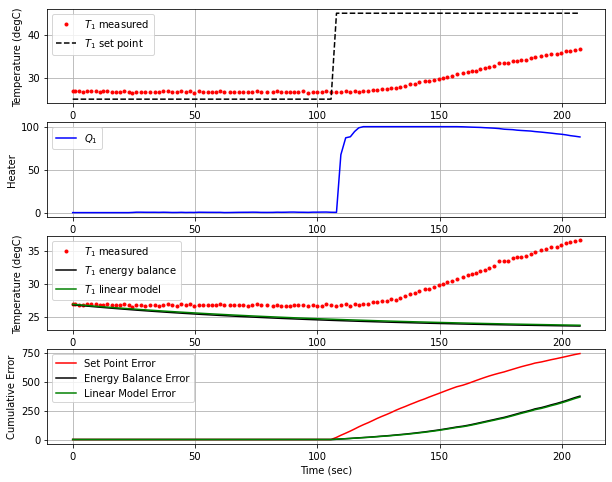

T1 NIH BOS  [33.99 34.08 34.19 34.5  34.82 35.04 35.19 35.51 35.56 35.82 36.17 36.26
 36.54 36.61 36.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 210.9  45.00  37.14   0.00  86.36


<Figure size 432x288 with 0 Axes>

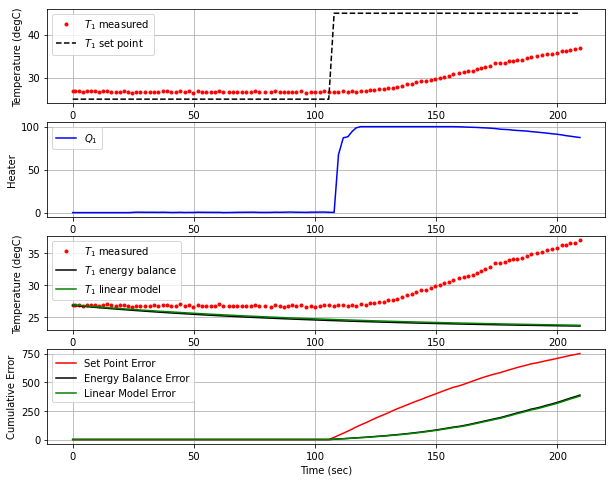

T1 NIH BOS  [34.08 34.19 34.5  34.82 35.04 35.19 35.51 35.56 35.82 36.17 36.26 36.54
 36.61 36.99 37.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 212.6  45.00  37.14   0.00  85.52


<Figure size 432x288 with 0 Axes>

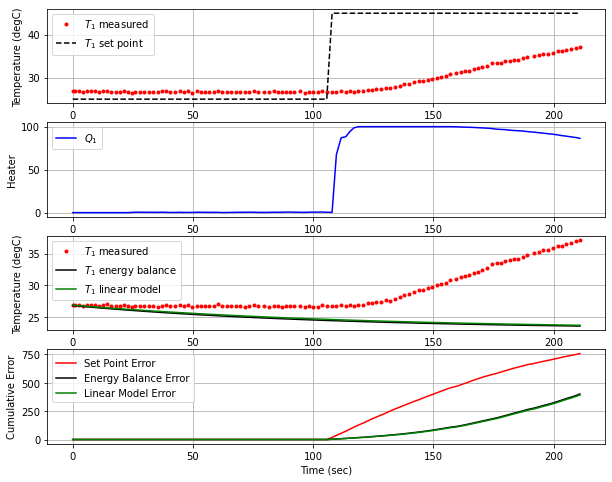

T1 NIH BOS  [34.19 34.5  34.82 35.04 35.19 35.51 35.56 35.82 36.17 36.26 36.54 36.61
 36.99 37.14 37.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 214.2  45.00  37.41   0.00  84.88


<Figure size 432x288 with 0 Axes>

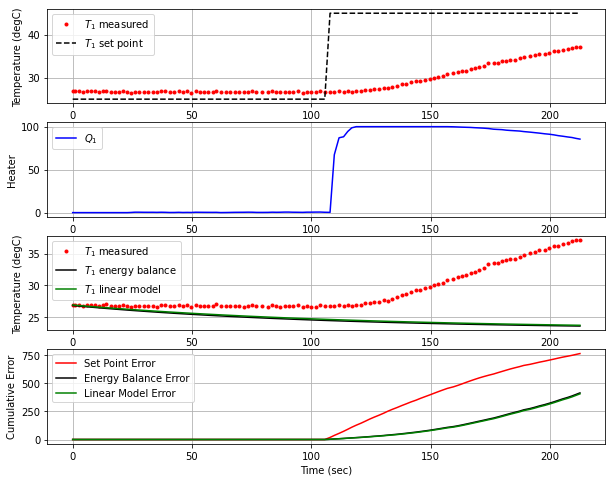

T1 NIH BOS  [34.5  34.82 35.04 35.19 35.51 35.56 35.82 36.17 36.26 36.54 36.61 36.99
 37.14 37.14 37.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 215.9  45.00  37.64   0.00  83.95


<Figure size 432x288 with 0 Axes>

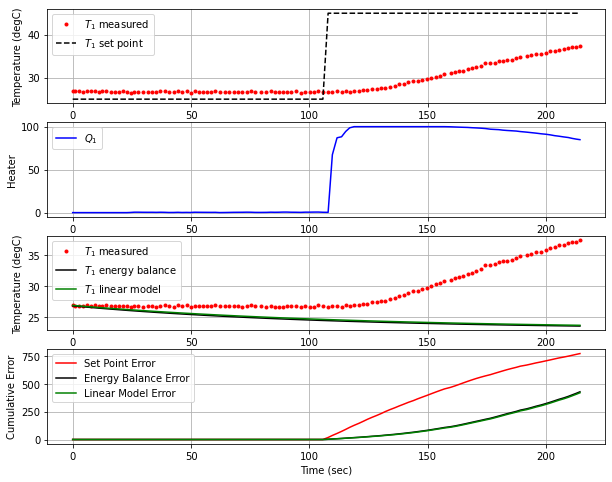

T1 NIH BOS  [34.82 35.04 35.19 35.51 35.56 35.82 36.17 36.26 36.54 36.61 36.99 37.14
 37.14 37.41 37.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 217.5  45.00  37.92   0.00  83.02


<Figure size 432x288 with 0 Axes>

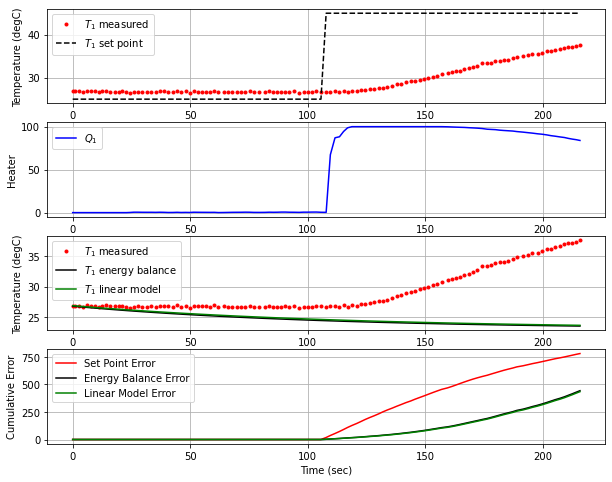

T1 NIH BOS  [35.04 35.19 35.51 35.56 35.82 36.17 36.26 36.54 36.61 36.99 37.14 37.14
 37.41 37.64 37.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 219.2  45.00  38.06   0.00  82.01


<Figure size 432x288 with 0 Axes>

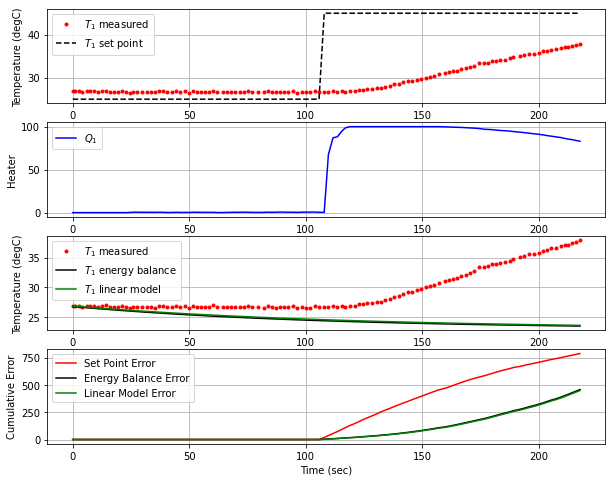

T1 NIH BOS  [35.19 35.51 35.56 35.82 36.17 36.26 36.54 36.61 36.99 37.14 37.14 37.41
 37.64 37.92 38.06]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 221.1  45.00  38.34   0.00  81.11


<Figure size 432x288 with 0 Axes>

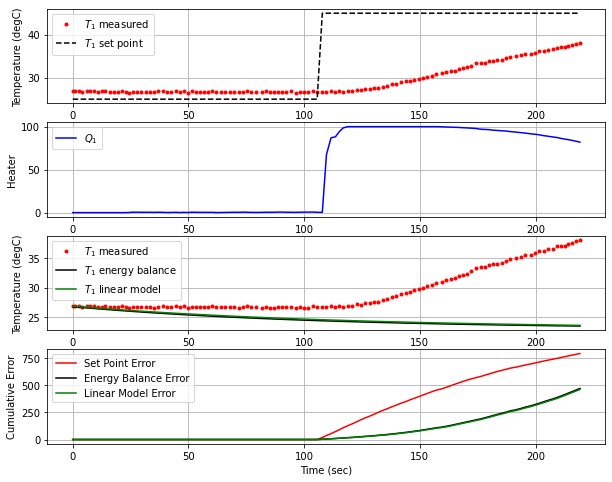

T1 NIH BOS  [35.51 35.56 35.82 36.17 36.26 36.54 36.61 36.99 37.14 37.14 37.41 37.64
 37.92 38.06 38.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 223.0  45.00  38.47   0.00  80.04


<Figure size 432x288 with 0 Axes>

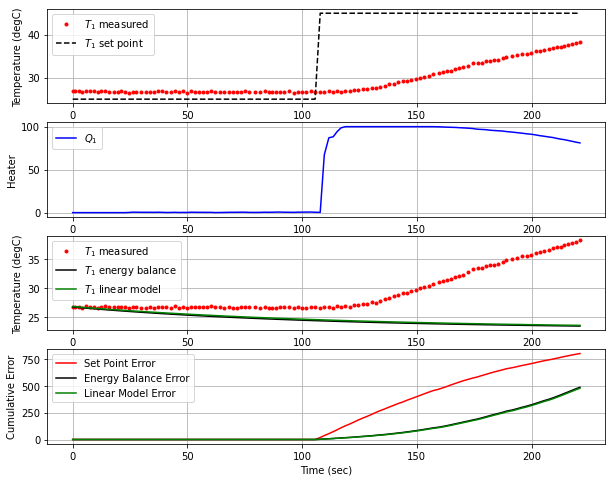

T1 NIH BOS  [35.56 35.82 36.17 36.26 36.54 36.61 36.99 37.14 37.14 37.41 37.64 37.92
 38.06 38.34 38.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 224.7  45.00  38.85   0.00  79.09


<Figure size 432x288 with 0 Axes>

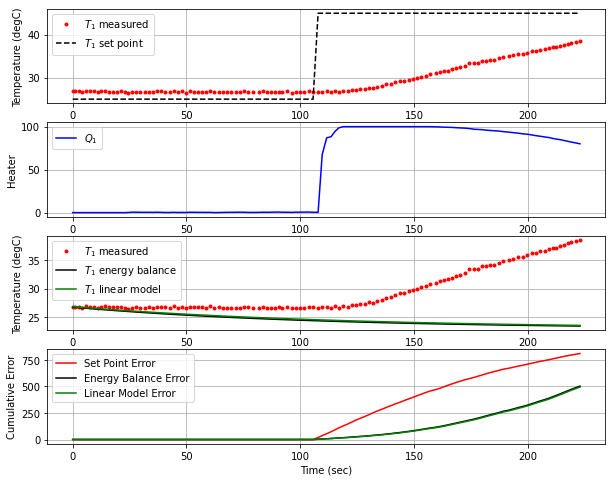

T1 NIH BOS  [35.82 36.17 36.26 36.54 36.61 36.99 37.14 37.14 37.41 37.64 37.92 38.06
 38.34 38.47 38.85]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 226.4  45.00  39.07   0.00  77.83


<Figure size 432x288 with 0 Axes>

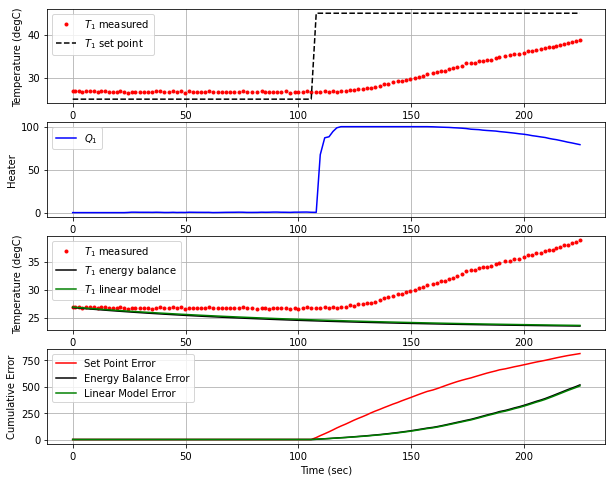

T1 NIH BOS  [36.17 36.26 36.54 36.61 36.99 37.14 37.14 37.41 37.64 37.92 38.06 38.34
 38.47 38.85 39.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 228.0  45.00  39.26   0.00  76.66


<Figure size 432x288 with 0 Axes>

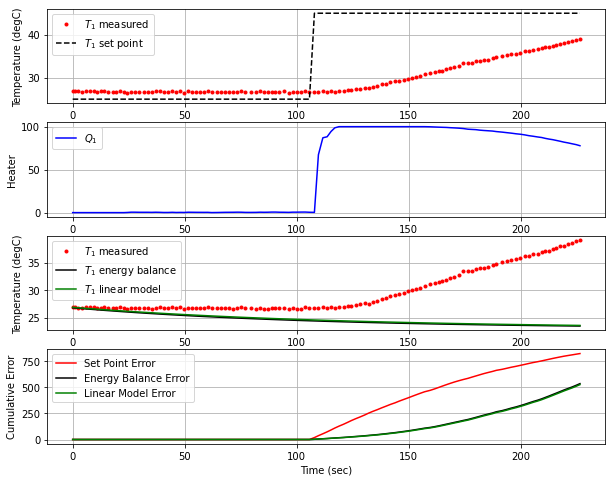

T1 NIH BOS  [36.26 36.54 36.61 36.99 37.14 37.14 37.41 37.64 37.92 38.06 38.34 38.47
 38.85 39.07 39.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 229.7  45.00  39.50   0.00  75.52


<Figure size 432x288 with 0 Axes>

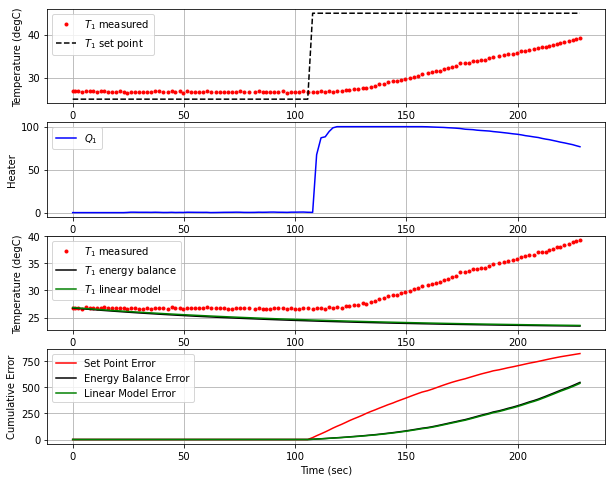

T1 NIH BOS  [36.54 36.61 36.99 37.14 37.14 37.41 37.64 37.92 38.06 38.34 38.47 38.85
 39.07 39.26 39.5 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 231.3  45.00  39.55   0.00  74.28


<Figure size 432x288 with 0 Axes>

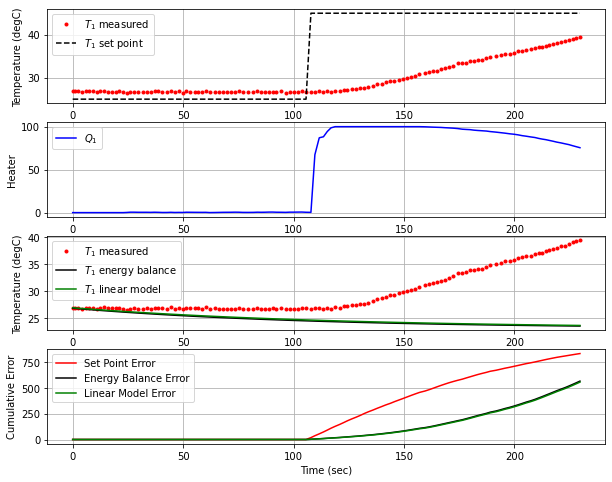

T1 NIH BOS  [36.61 36.99 37.14 37.14 37.41 37.64 37.92 38.06 38.34 38.47 38.85 39.07
 39.26 39.5  39.55]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 233.0  45.00  39.50   0.00  73.25


<Figure size 432x288 with 0 Axes>

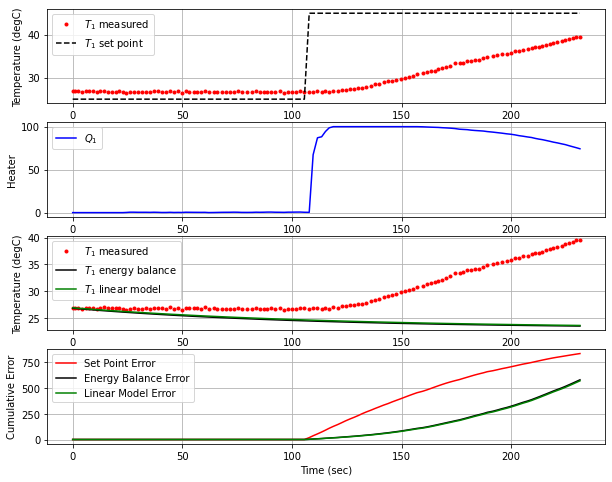

T1 NIH BOS  [36.99 37.14 37.14 37.41 37.64 37.92 38.06 38.34 38.47 38.85 39.07 39.26
 39.5  39.55 39.5 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 234.8  45.00  39.81   0.00  72.40


<Figure size 432x288 with 0 Axes>

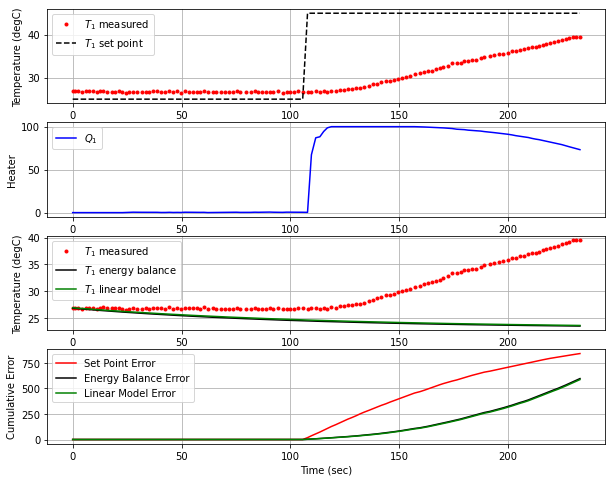

T1 NIH BOS  [37.14 37.14 37.41 37.64 37.92 38.06 38.34 38.47 38.85 39.07 39.26 39.5
 39.55 39.5  39.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 236.5  45.00  39.74   0.00  71.23


<Figure size 432x288 with 0 Axes>

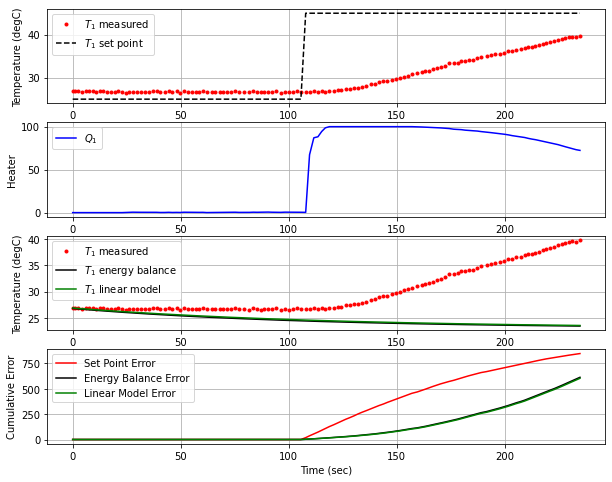

T1 NIH BOS  [37.14 37.41 37.64 37.92 38.06 38.34 38.47 38.85 39.07 39.26 39.5  39.55
 39.5  39.81 39.74]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 238.2  45.00  39.69   0.00  70.46


<Figure size 432x288 with 0 Axes>

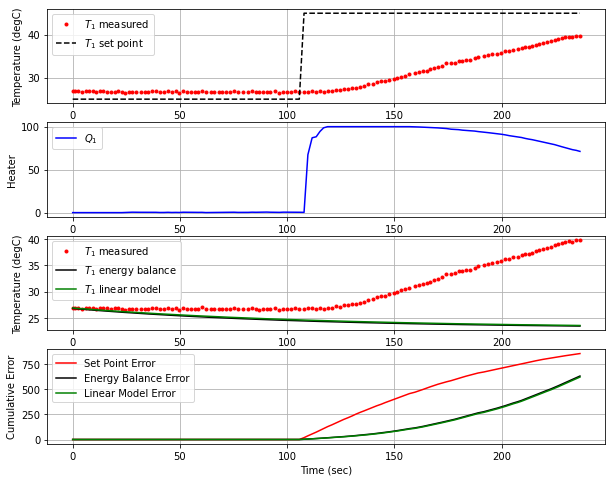

T1 NIH BOS  [37.41 37.64 37.92 38.06 38.34 38.47 38.85 39.07 39.26 39.5  39.55 39.5
 39.81 39.74 39.69]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 240.1  45.00  39.79   0.00  69.80


<Figure size 432x288 with 0 Axes>

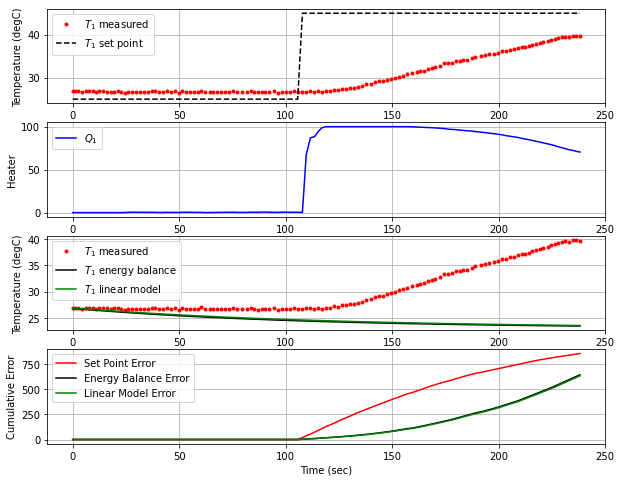

T1 NIH BOS  [37.64 37.92 38.06 38.34 38.47 38.85 39.07 39.26 39.5  39.55 39.5  39.81
 39.74 39.69 39.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 241.8  45.00  39.90   0.00  69.07


<Figure size 432x288 with 0 Axes>

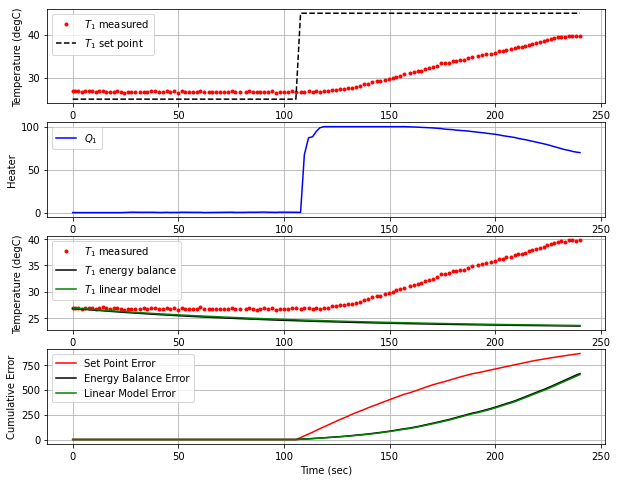

T1 NIH BOS  [37.92 38.06 38.34 38.47 38.85 39.07 39.26 39.5  39.55 39.5  39.81 39.74
 39.69 39.79 39.9 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 243.9  45.00  40.23   0.00  68.35


<Figure size 432x288 with 0 Axes>

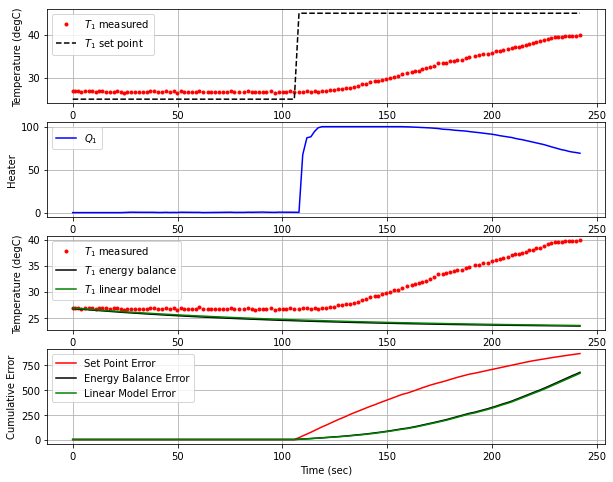

T1 NIH BOS  [38.06 38.34 38.47 38.85 39.07 39.26 39.5  39.55 39.5  39.81 39.74 39.69
 39.79 39.9  40.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 246.2  45.00  40.57   0.00  67.39


<Figure size 432x288 with 0 Axes>

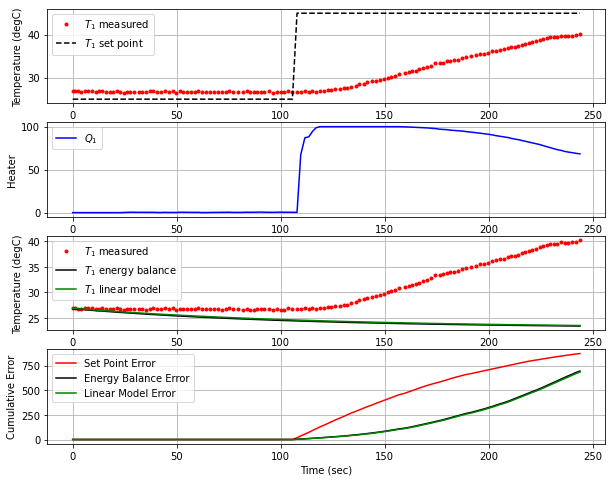

T1 NIH BOS  [38.34 38.47 38.85 39.07 39.26 39.5  39.55 39.5  39.81 39.74 39.69 39.79
 39.9  40.23 40.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 247.9  45.00  40.97   0.00  66.30


<Figure size 432x288 with 0 Axes>

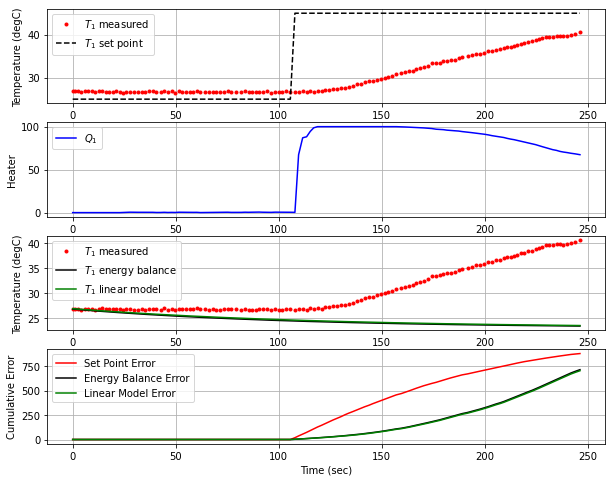

T1 NIH BOS  [38.47 38.85 39.07 39.26 39.5  39.55 39.5  39.81 39.74 39.69 39.79 39.9
 40.23 40.57 40.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 249.7  45.00  41.24   0.00  65.02


<Figure size 432x288 with 0 Axes>

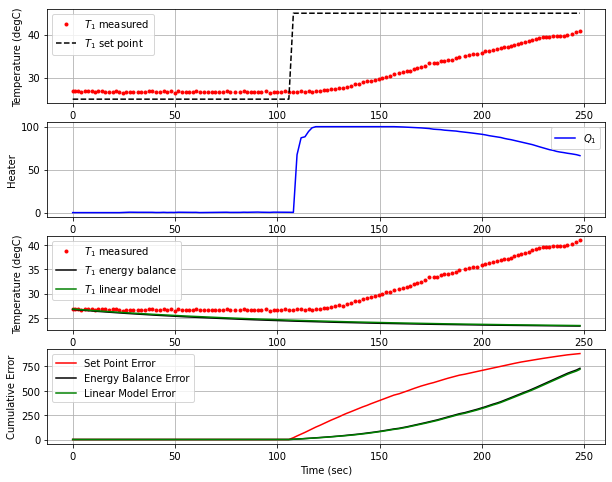

T1 NIH BOS  [38.85 39.07 39.26 39.5  39.55 39.5  39.81 39.74 39.69 39.79 39.9  40.23
 40.57 40.97 41.24]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 251.6  45.00  41.09   0.00  63.72


<Figure size 432x288 with 0 Axes>

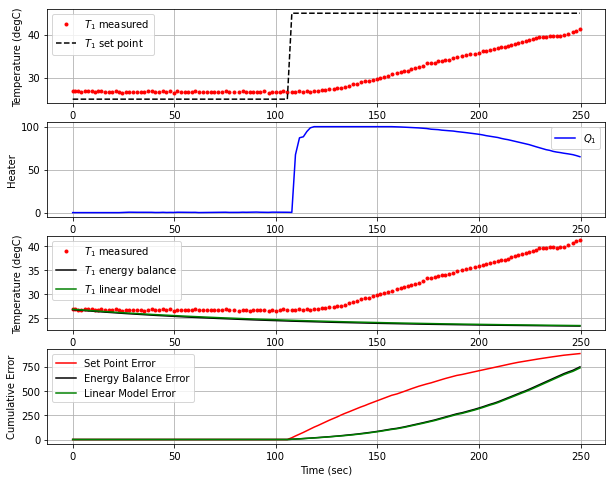

T1 NIH BOS  [39.07 39.26 39.5  39.55 39.5  39.81 39.74 39.69 39.79 39.9  40.23 40.57
 40.97 41.24 41.09]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 253.4  45.00  41.05   0.00  62.89


<Figure size 432x288 with 0 Axes>

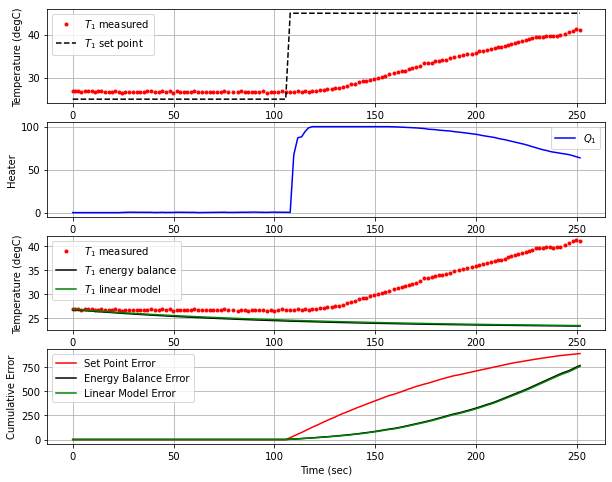

T1 NIH BOS  [39.26 39.5  39.55 39.5  39.81 39.74 39.69 39.79 39.9  40.23 40.57 40.97
 41.24 41.09 41.05]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 255.3  45.00  41.45   0.00  62.11


<Figure size 432x288 with 0 Axes>

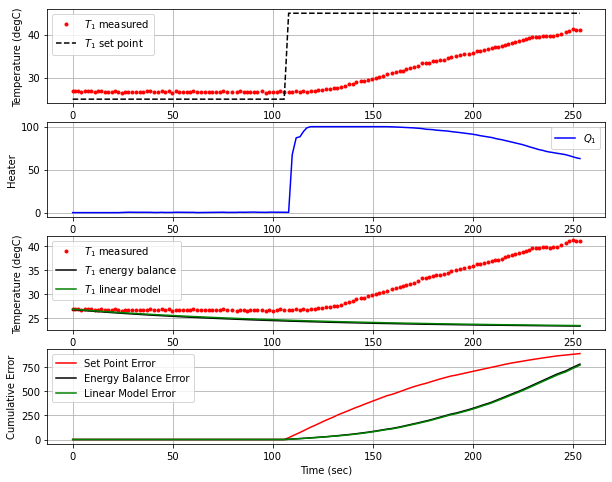

T1 NIH BOS  [39.5  39.55 39.5  39.81 39.74 39.69 39.79 39.9  40.23 40.57 40.97 41.24
 41.09 41.05 41.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 257.0  45.00  41.46   0.00  60.88


<Figure size 432x288 with 0 Axes>

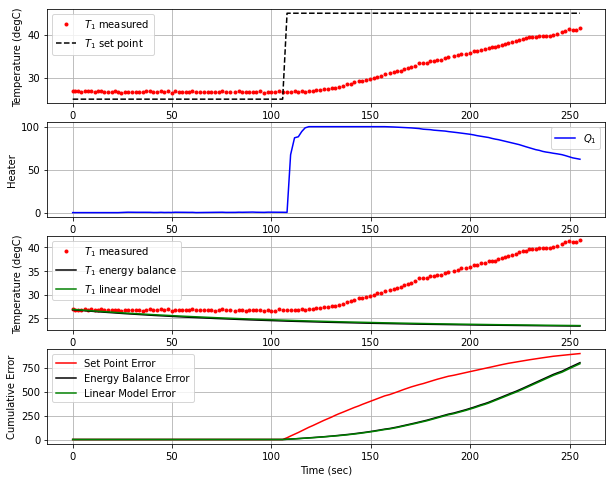

T1 NIH BOS  [39.55 39.5  39.81 39.74 39.69 39.79 39.9  40.23 40.57 40.97 41.24 41.09
 41.05 41.45 41.46]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 258.9  45.00  41.36   0.00  59.97


<Figure size 432x288 with 0 Axes>

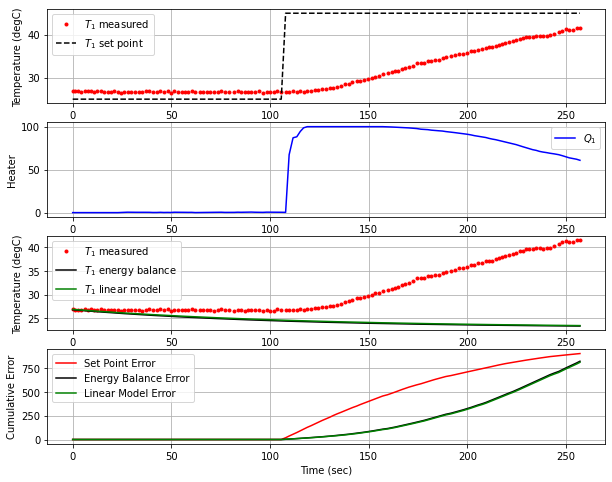

T1 NIH BOS  [39.5  39.81 39.74 39.69 39.79 39.9  40.23 40.57 40.97 41.24 41.09 41.05
 41.45 41.46 41.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 260.5  45.00  41.61   0.00  59.31


<Figure size 432x288 with 0 Axes>

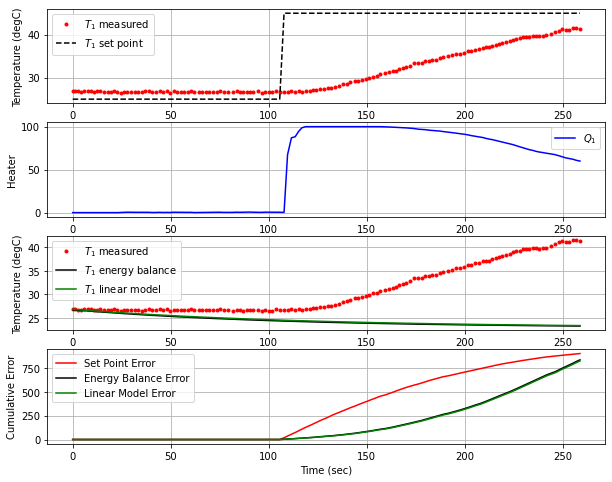

T1 NIH BOS  [39.81 39.74 39.69 39.79 39.9  40.23 40.57 40.97 41.24 41.09 41.05 41.45
 41.46 41.36 41.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 262.2  45.00  41.68   0.00  58.34


<Figure size 432x288 with 0 Axes>

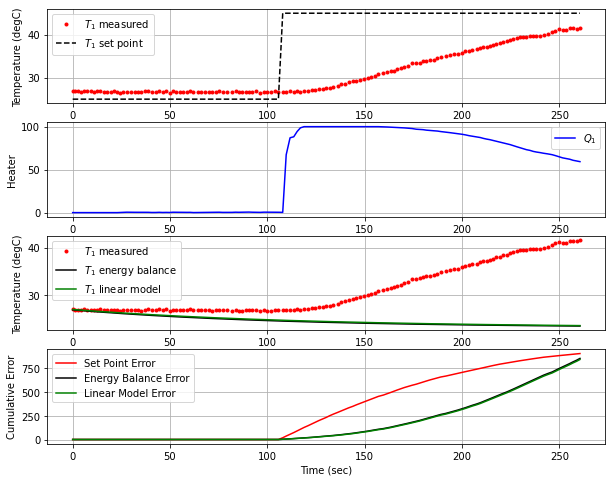

T1 NIH BOS  [39.74 39.69 39.79 39.9  40.23 40.57 40.97 41.24 41.09 41.05 41.45 41.46
 41.36 41.61 41.68]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 263.9  45.00  42.15   0.00  57.54


<Figure size 432x288 with 0 Axes>

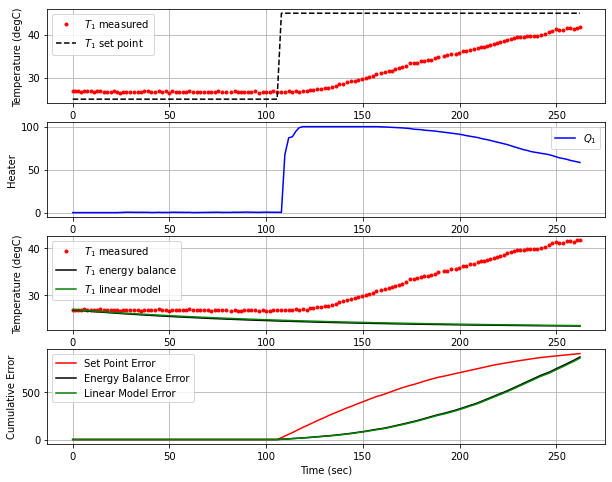

T1 NIH BOS  [39.69 39.79 39.9  40.23 40.57 40.97 41.24 41.09 41.05 41.45 41.46 41.36
 41.61 41.68 42.15]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 265.5  45.00  42.28   0.00  56.27


<Figure size 432x288 with 0 Axes>

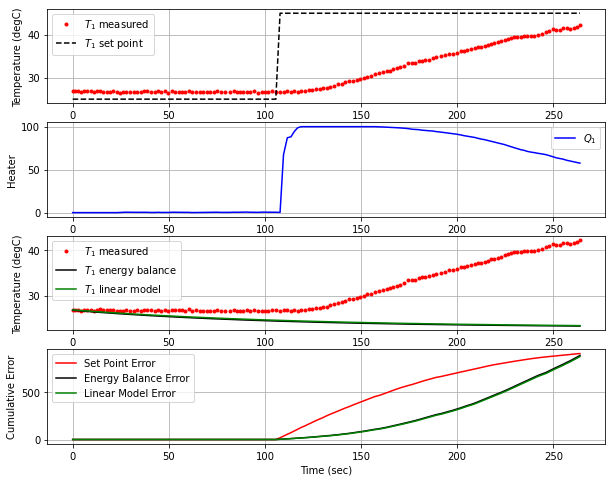

T1 NIH BOS  [39.79 39.9  40.23 40.57 40.97 41.24 41.09 41.05 41.45 41.46 41.36 41.61
 41.68 42.15 42.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 267.1  45.00  42.47   0.00  55.16


<Figure size 432x288 with 0 Axes>

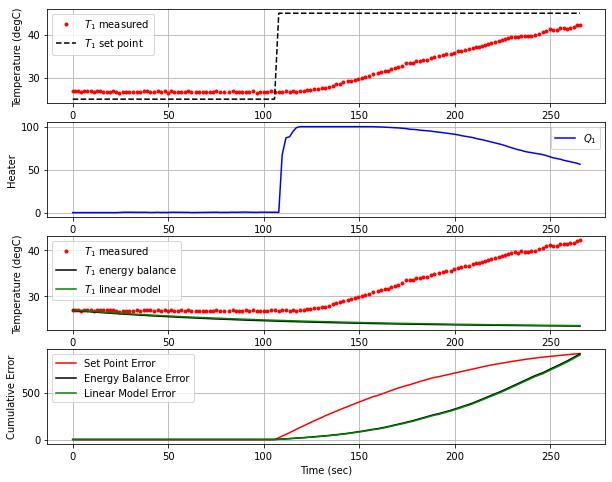

T1 NIH BOS  [39.9  40.23 40.57 40.97 41.24 41.09 41.05 41.45 41.46 41.36 41.61 41.68
 42.15 42.28 42.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 268.8  45.00  42.56   0.00  54.01


<Figure size 432x288 with 0 Axes>

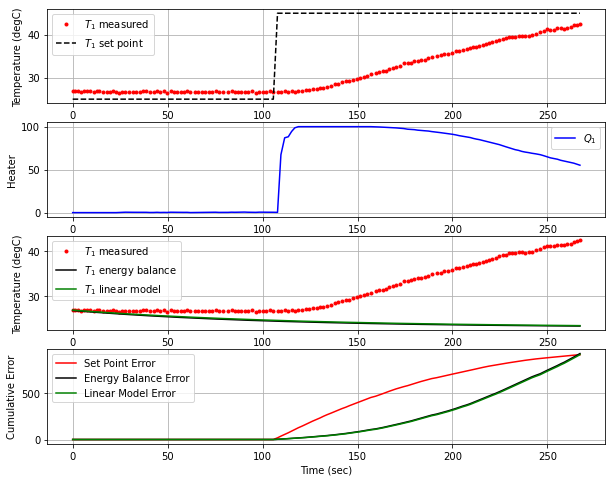

T1 NIH BOS  [40.23 40.57 40.97 41.24 41.09 41.05 41.45 41.46 41.36 41.61 41.68 42.15
 42.28 42.47 42.56]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 270.9  45.00  42.47   0.00  52.93


<Figure size 432x288 with 0 Axes>

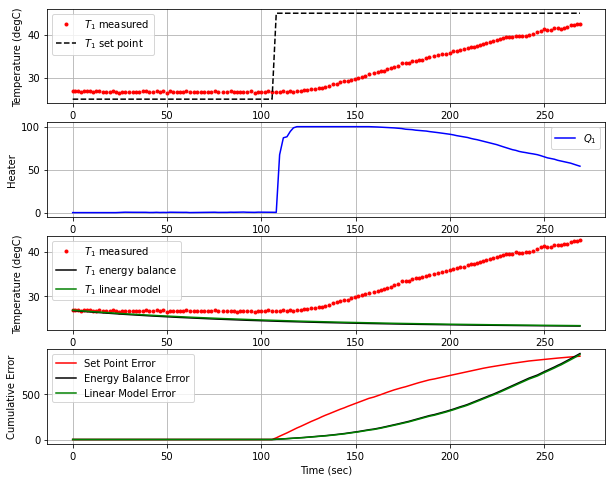

T1 NIH BOS  [40.57 40.97 41.24 41.09 41.05 41.45 41.46 41.36 41.61 41.68 42.15 42.28
 42.47 42.56 42.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 272.6  45.00  42.26   0.00  52.14


<Figure size 432x288 with 0 Axes>

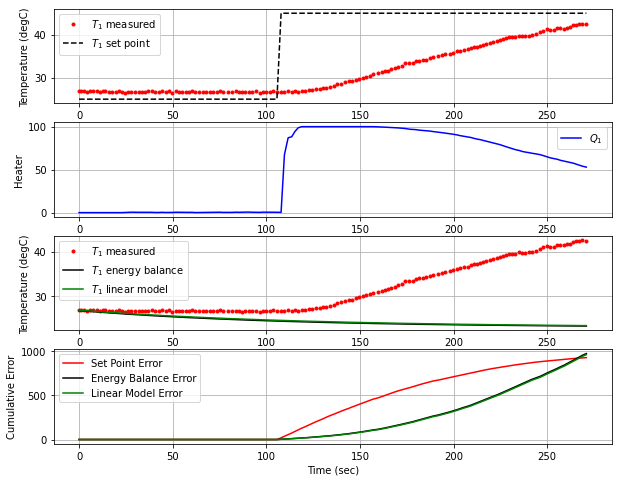

T1 NIH BOS  [40.97 41.24 41.09 41.05 41.45 41.46 41.36 41.61 41.68 42.15 42.28 42.47
 42.56 42.47 42.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 274.3  45.00  42.47   0.00  51.68


<Figure size 432x288 with 0 Axes>

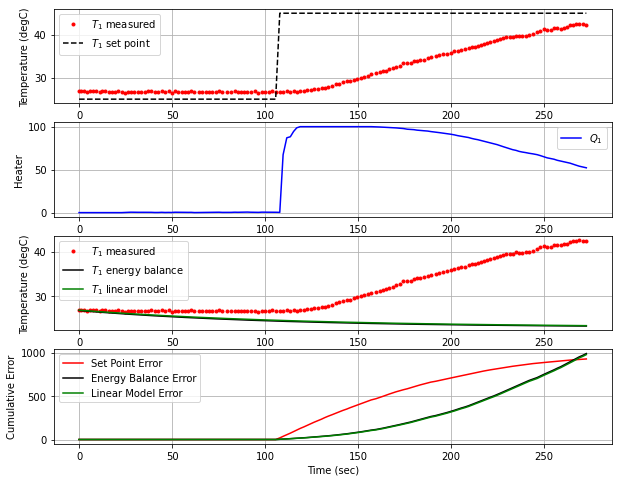

T1 NIH BOS  [41.24 41.09 41.05 41.45 41.46 41.36 41.61 41.68 42.15 42.28 42.47 42.56
 42.47 42.26 42.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 276.0  45.00  42.67   0.00  50.97


<Figure size 432x288 with 0 Axes>

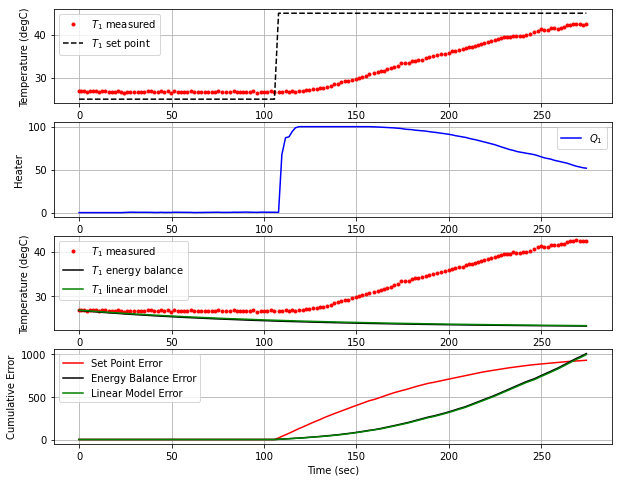

T1 NIH BOS  [41.09 41.05 41.45 41.46 41.36 41.61 41.68 42.15 42.28 42.47 42.56 42.47
 42.26 42.47 42.67]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 277.7  45.00  42.98   0.00  50.22


<Figure size 432x288 with 0 Axes>

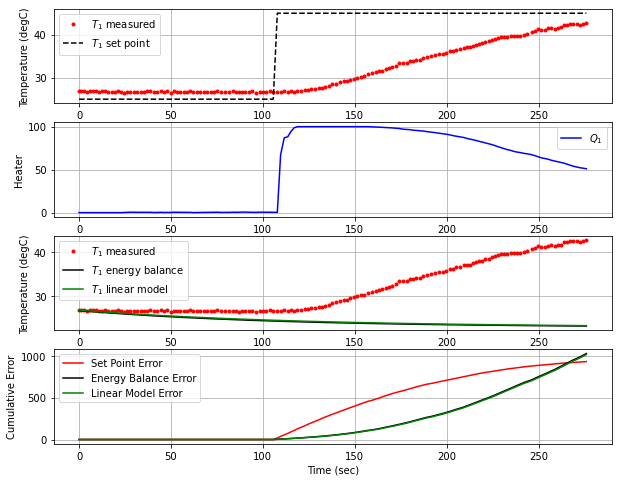

T1 NIH BOS  [41.05 41.45 41.46 41.36 41.61 41.68 42.15 42.28 42.47 42.56 42.47 42.26
 42.47 42.67 42.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 279.3  45.00  43.15   0.00  49.26


<Figure size 432x288 with 0 Axes>

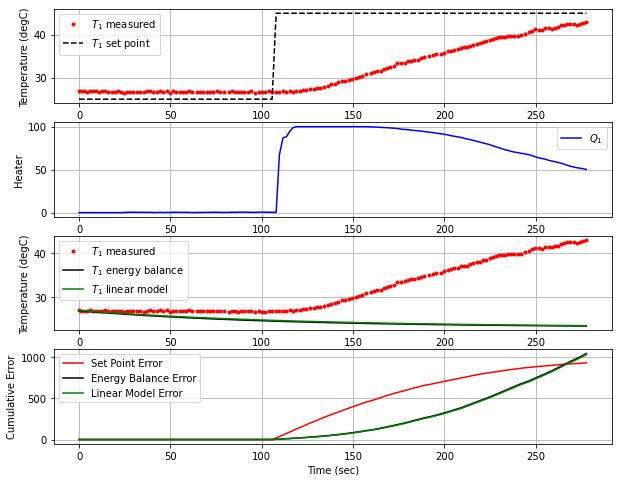

T1 NIH BOS  [41.45 41.46 41.36 41.61 41.68 42.15 42.28 42.47 42.56 42.47 42.26 42.47
 42.67 42.98 43.15]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 281.0  45.00  43.07   0.00  48.31


<Figure size 432x288 with 0 Axes>

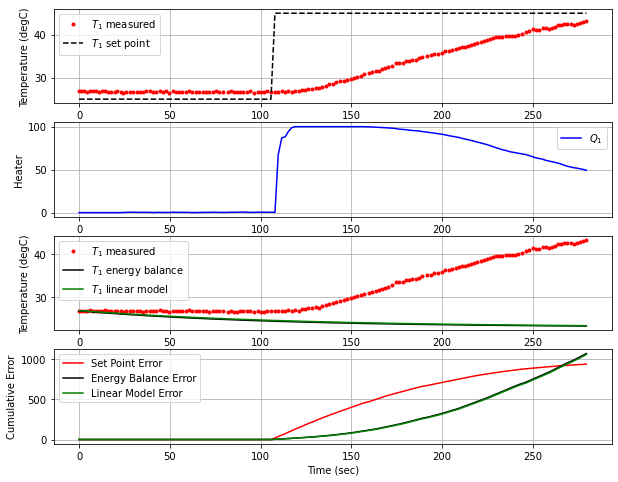

T1 NIH BOS  [41.46 41.36 41.61 41.68 42.15 42.28 42.47 42.56 42.47 42.26 42.47 42.67
 42.98 43.15 43.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 282.9  45.00  43.49   0.00  47.70


<Figure size 432x288 with 0 Axes>

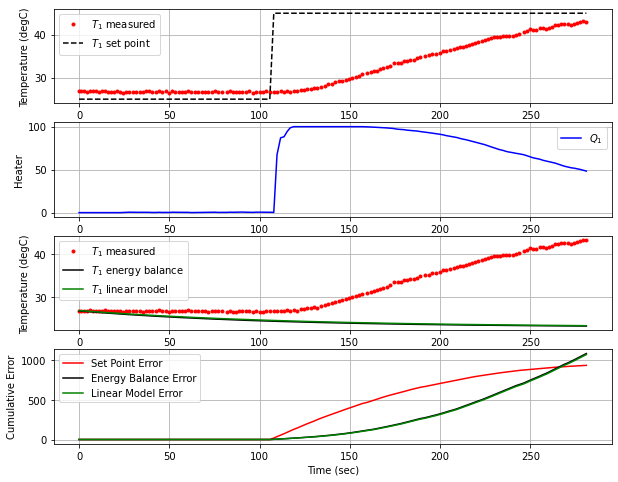

T1 NIH BOS  [41.36 41.61 41.68 42.15 42.28 42.47 42.56 42.47 42.26 42.47 42.67 42.98
 43.15 43.07 43.49]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 284.5  45.00  43.77   0.00  46.62


<Figure size 432x288 with 0 Axes>

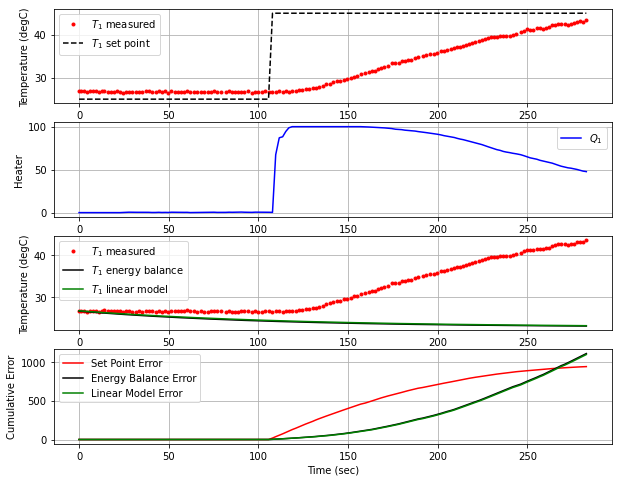

T1 NIH BOS  [41.61 41.68 42.15 42.28 42.47 42.56 42.47 42.26 42.47 42.67 42.98 43.15
 43.07 43.49 43.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 47ms/step
 286.2  45.00  43.88   0.00  45.42


<Figure size 432x288 with 0 Axes>

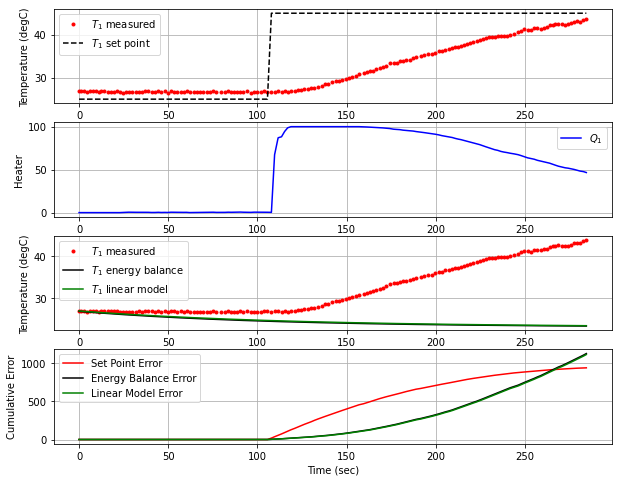

T1 NIH BOS  [41.68 42.15 42.28 42.47 42.56 42.47 42.26 42.47 42.67 42.98 43.15 43.07
 43.49 43.77 43.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 288.1  45.00  44.12   0.00  44.37


<Figure size 432x288 with 0 Axes>

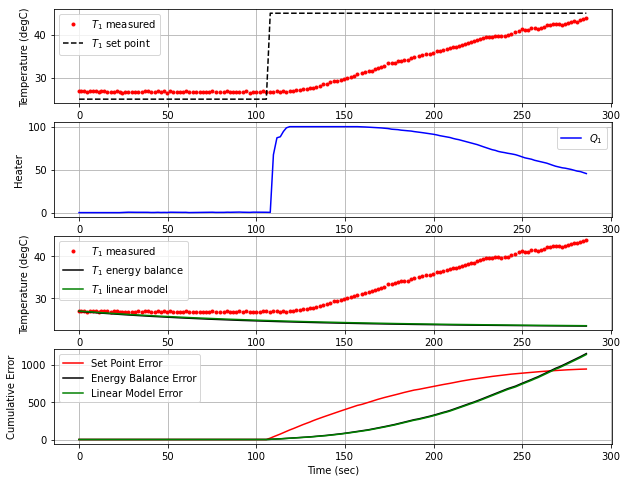

T1 NIH BOS  [42.15 42.28 42.47 42.56 42.47 42.26 42.47 42.67 42.98 43.15 43.07 43.49
 43.77 43.88 44.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 289.9  45.00  44.38   0.00  43.20


<Figure size 432x288 with 0 Axes>

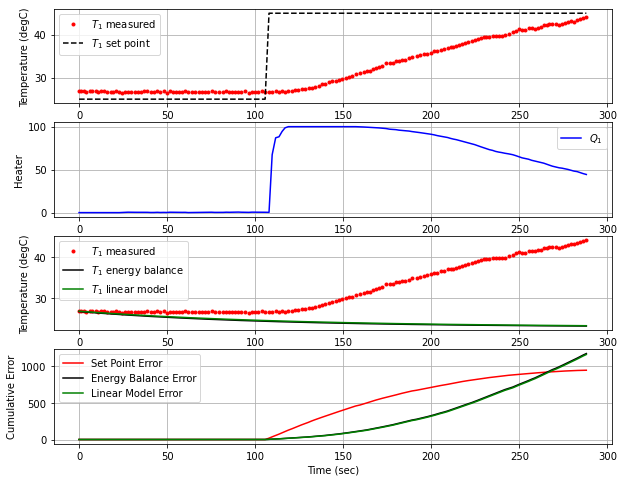

T1 NIH BOS  [42.28 42.47 42.56 42.47 42.26 42.47 42.67 42.98 43.15 43.07 43.49 43.77
 43.88 44.12 44.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 291.7  45.00  44.38   0.00  42.00


<Figure size 432x288 with 0 Axes>

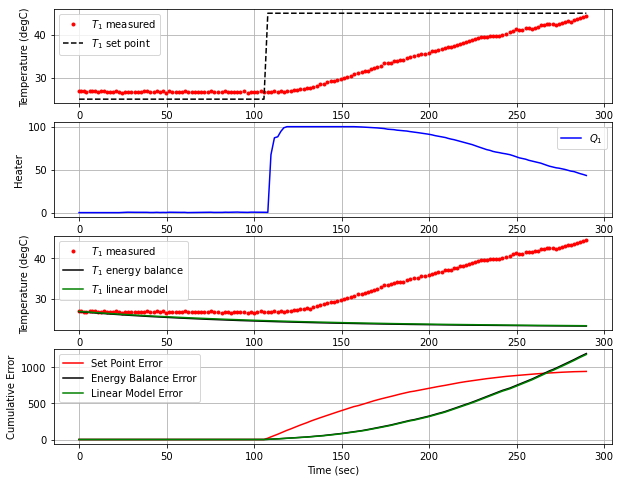

T1 NIH BOS  [42.47 42.56 42.47 42.26 42.47 42.67 42.98 43.15 43.07 43.49 43.77 43.88
 44.12 44.38 44.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 293.5  45.00  44.46   0.00  41.03


<Figure size 432x288 with 0 Axes>

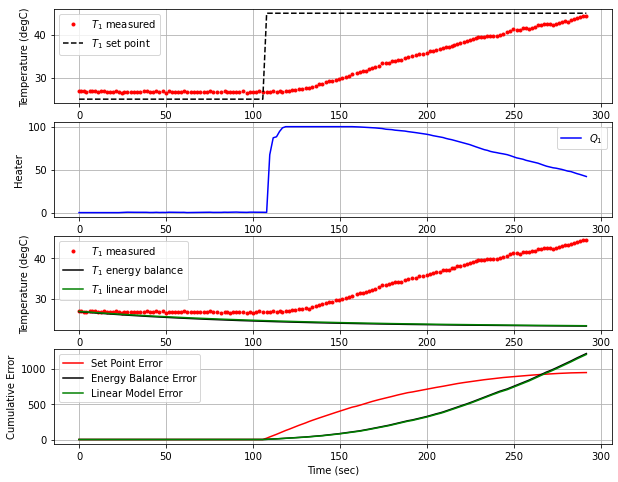

T1 NIH BOS  [42.56 42.47 42.26 42.47 42.67 42.98 43.15 43.07 43.49 43.77 43.88 44.12
 44.38 44.38 44.46]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 295.4  45.00  44.71   0.00  40.11


<Figure size 432x288 with 0 Axes>

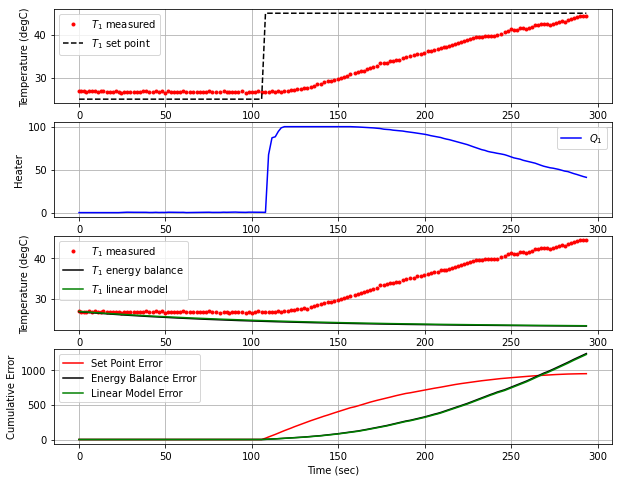

T1 NIH BOS  [42.47 42.26 42.47 42.67 42.98 43.15 43.07 43.49 43.77 43.88 44.12 44.38
 44.38 44.46 44.71]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 297.2  45.00  44.91   0.00  39.04


<Figure size 432x288 with 0 Axes>

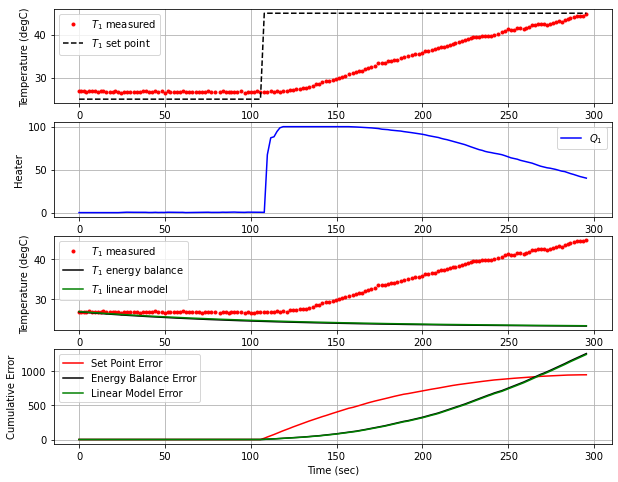

T1 NIH BOS  [42.26 42.47 42.67 42.98 43.15 43.07 43.49 43.77 43.88 44.12 44.38 44.38
 44.46 44.71 44.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 299.0  45.00  45.13   0.00  37.92


<Figure size 432x288 with 0 Axes>

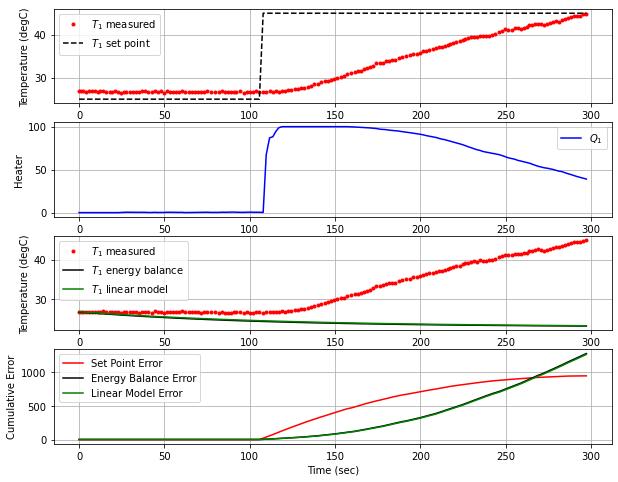

T1 NIH BOS  [42.47 42.67 42.98 43.15 43.07 43.49 43.77 43.88 44.12 44.38 44.38 44.46
 44.71 44.91 45.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 300.7  45.00  45.08   0.00  36.72


<Figure size 432x288 with 0 Axes>

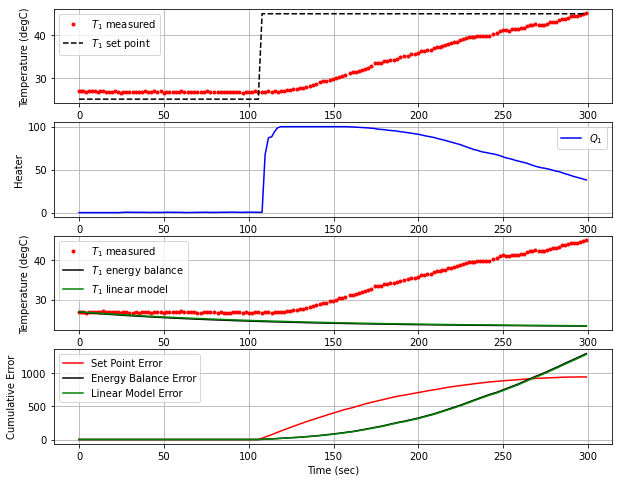

T1 NIH BOS  [42.67 42.98 43.15 43.07 43.49 43.77 43.88 44.12 44.38 44.38 44.46 44.71
 44.91 45.13 45.08]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 302.7  45.00  44.93   0.00  35.82


<Figure size 432x288 with 0 Axes>

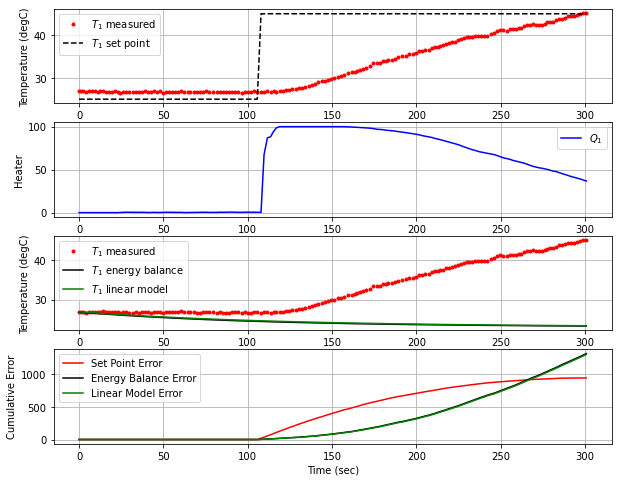

T1 NIH BOS  [42.98 43.15 43.07 43.49 43.77 43.88 44.12 44.38 44.38 44.46 44.71 44.91
 45.13 45.08 44.93]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 304.8  45.00  45.23   0.00  35.23


<Figure size 432x288 with 0 Axes>

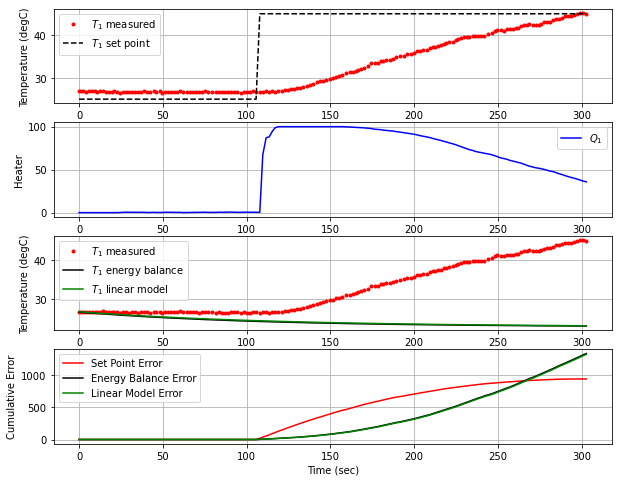

T1 NIH BOS  [43.15 43.07 43.49 43.77 43.88 44.12 44.38 44.38 44.46 44.71 44.91 45.13
 45.08 44.93 45.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 306.6  45.00  44.72   0.00  34.36


<Figure size 432x288 with 0 Axes>

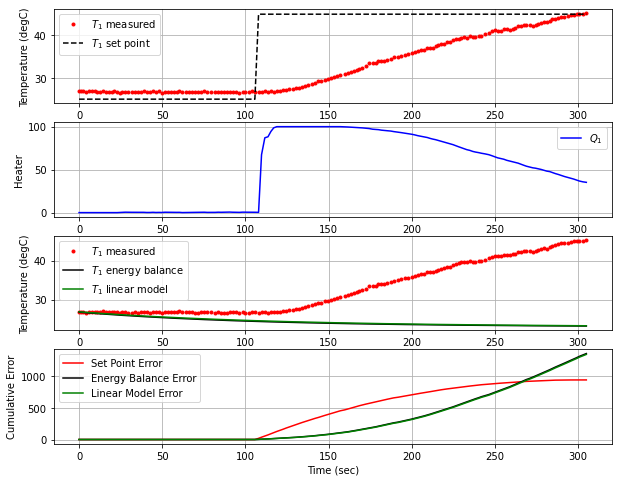

T1 NIH BOS  [43.07 43.49 43.77 43.88 44.12 44.38 44.38 44.46 44.71 44.91 45.13 45.08
 44.93 45.23 44.72]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 308.6  45.00  44.61   0.00  34.24


<Figure size 432x288 with 0 Axes>

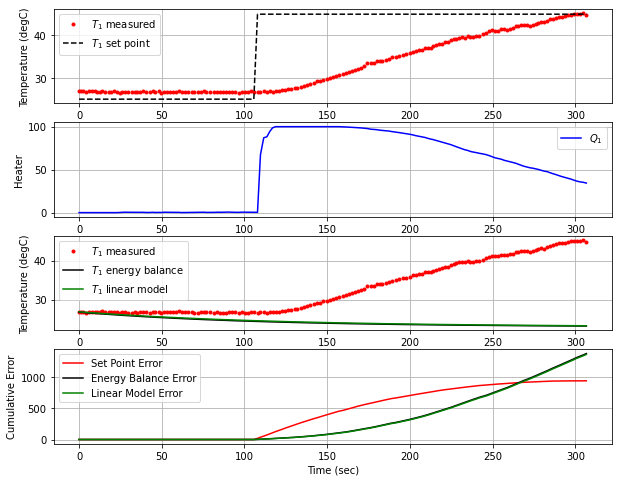

T1 NIH BOS  [43.49 43.77 43.88 44.12 44.38 44.38 44.46 44.71 44.91 45.13 45.08 44.93
 45.23 44.72 44.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 310.7  45.00  44.73   0.00  34.13


<Figure size 432x288 with 0 Axes>

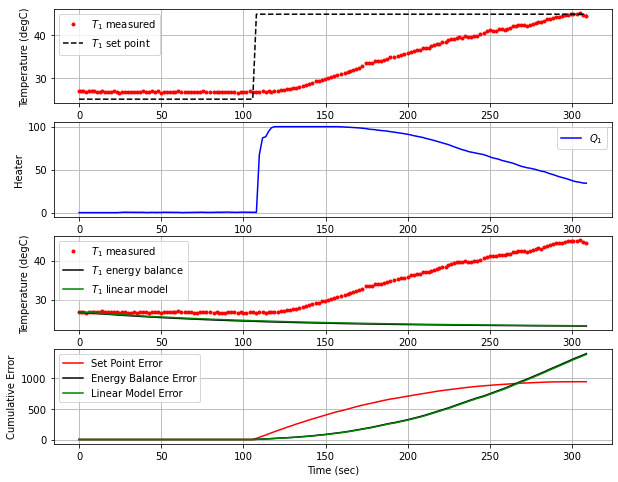

T1 NIH BOS  [43.77 43.88 44.12 44.38 44.38 44.46 44.71 44.91 45.13 45.08 44.93 45.23
 44.72 44.61 44.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 312.8  45.00  44.81   0.00  33.89


<Figure size 432x288 with 0 Axes>

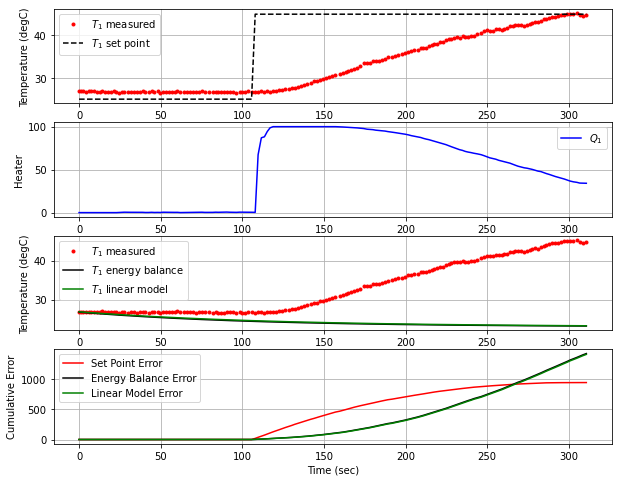

T1 NIH BOS  [43.88 44.12 44.38 44.38 44.46 44.71 44.91 45.13 45.08 44.93 45.23 44.72
 44.61 44.73 44.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 314.5  45.00  44.93   0.00  33.64


<Figure size 432x288 with 0 Axes>

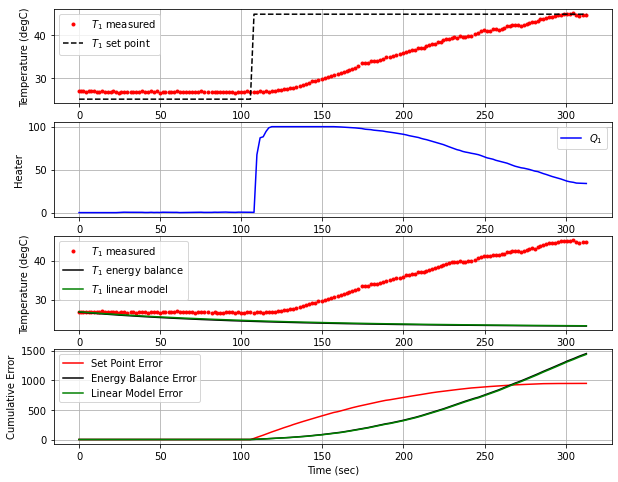

T1 NIH BOS  [44.12 44.38 44.38 44.46 44.71 44.91 45.13 45.08 44.93 45.23 44.72 44.61
 44.73 44.81 44.93]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 316.3  45.00  45.22   0.00  33.34


<Figure size 432x288 with 0 Axes>

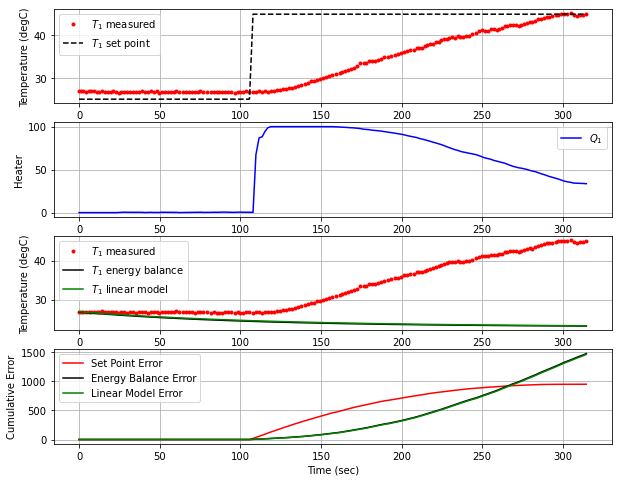

T1 NIH BOS  [44.38 44.38 44.46 44.71 44.91 45.13 45.08 44.93 45.23 44.72 44.61 44.73
 44.81 44.93 45.22]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 318.2  45.00  45.34   0.00  32.85


<Figure size 432x288 with 0 Axes>

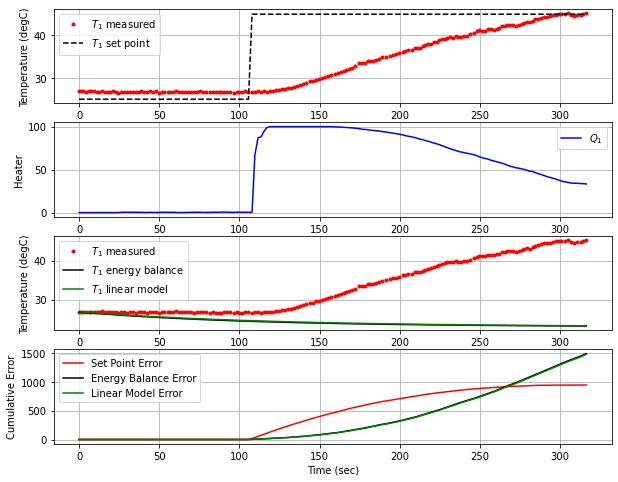

T1 NIH BOS  [44.38 44.46 44.71 44.91 45.13 45.08 44.93 45.23 44.72 44.61 44.73 44.81
 44.93 45.22 45.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 55ms/step
 320.7  45.00  45.73   0.00  32.40


<Figure size 432x288 with 0 Axes>

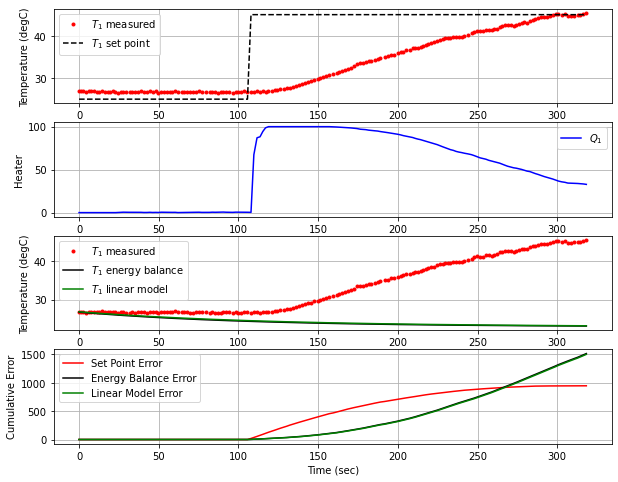

T1 NIH BOS  [44.46 44.71 44.91 45.13 45.08 44.93 45.23 44.72 44.61 44.73 44.81 44.93
 45.22 45.34 45.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 322.9  45.00  46.02   0.00  31.64


<Figure size 432x288 with 0 Axes>

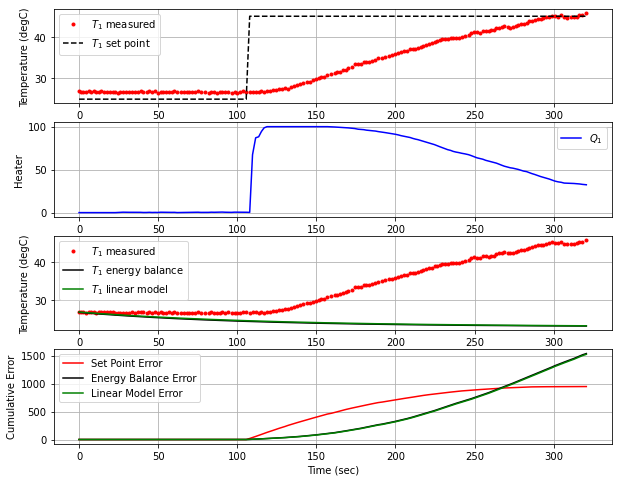

T1 NIH BOS  [44.71 44.91 45.13 45.08 44.93 45.23 44.72 44.61 44.73 44.81 44.93 45.22
 45.34 45.73 46.02]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 324.6  45.00  46.25   0.00  30.76


<Figure size 432x288 with 0 Axes>

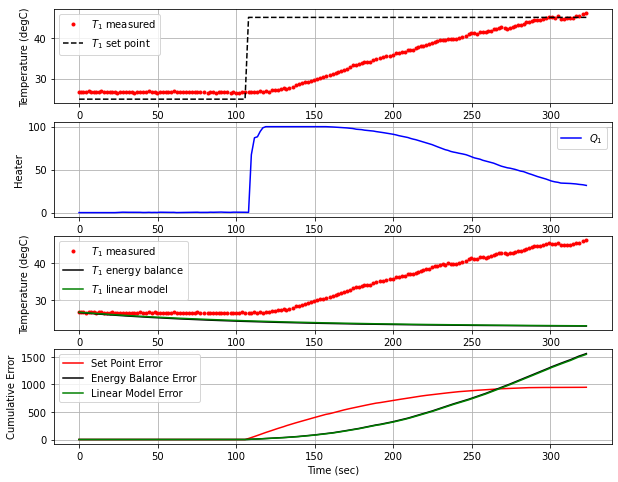

T1 NIH BOS  [44.91 45.13 45.08 44.93 45.23 44.72 44.61 44.73 44.81 44.93 45.22 45.34
 45.73 46.02 46.25]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 326.3  45.00  46.35   0.00  29.88


<Figure size 432x288 with 0 Axes>

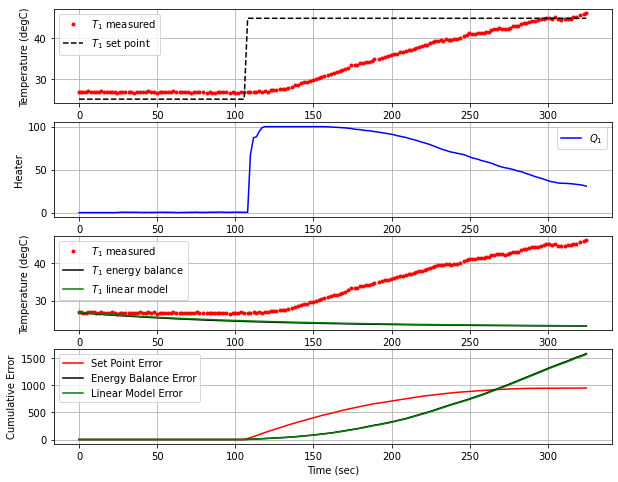

T1 NIH BOS  [45.13 45.08 44.93 45.23 44.72 44.61 44.73 44.81 44.93 45.22 45.34 45.73
 46.02 46.25 46.35]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 328.1  45.00  46.17   0.00  29.11


<Figure size 432x288 with 0 Axes>

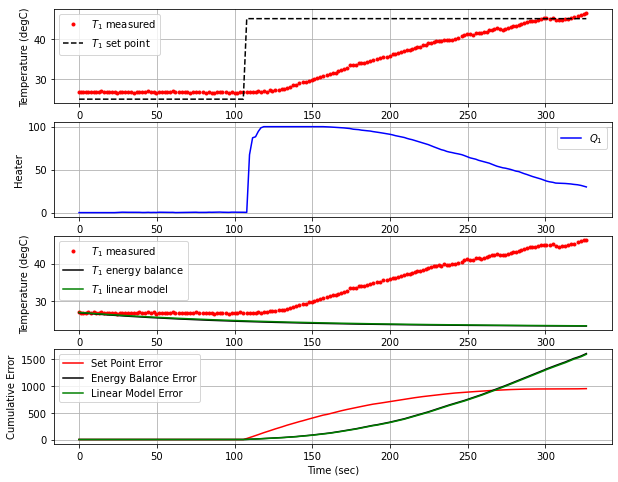

T1 NIH BOS  [45.08 44.93 45.23 44.72 44.61 44.73 44.81 44.93 45.22 45.34 45.73 46.02
 46.25 46.35 46.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 330.1  45.00  45.91   0.00  28.69


<Figure size 432x288 with 0 Axes>

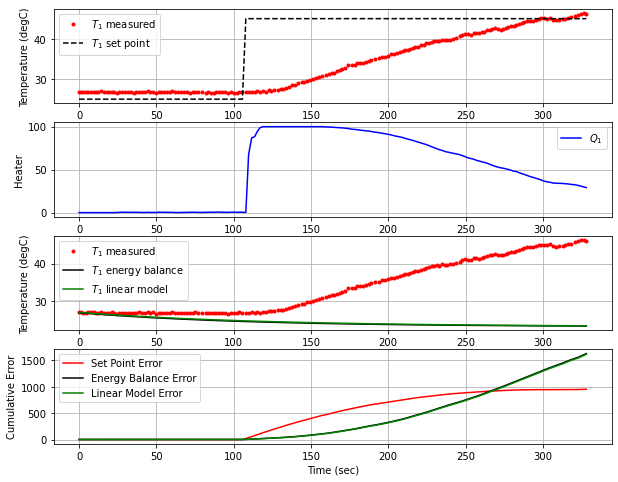

T1 NIH BOS  [44.93 45.23 44.72 44.61 44.73 44.81 44.93 45.22 45.34 45.73 46.02 46.25
 46.35 46.17 45.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 332.0  45.00  45.94   0.00  28.56


<Figure size 432x288 with 0 Axes>

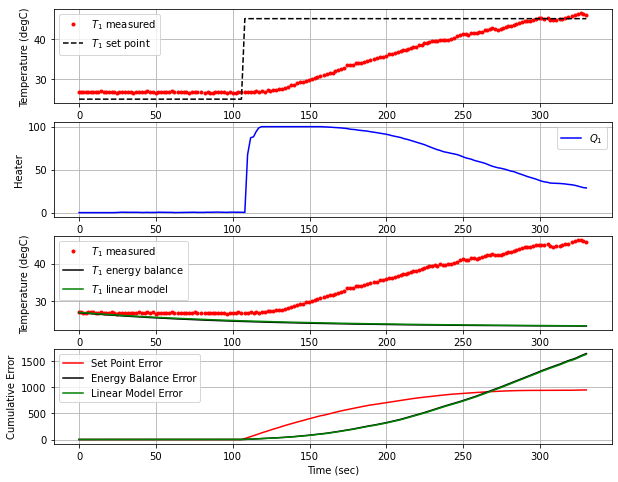

T1 NIH BOS  [45.23 44.72 44.61 44.73 44.81 44.93 45.22 45.34 45.73 46.02 46.25 46.35
 46.17 45.91 45.94]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 52ms/step
 333.8  45.00  46.19   0.00  28.31


<Figure size 432x288 with 0 Axes>

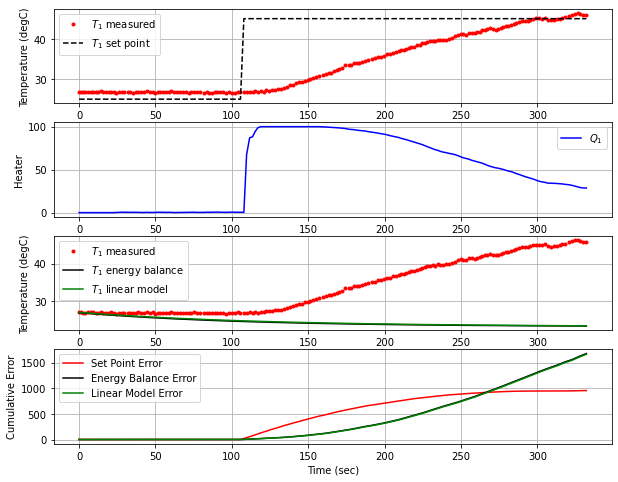

T1 NIH BOS  [44.72 44.61 44.73 44.81 44.93 45.22 45.34 45.73 46.02 46.25 46.35 46.17
 45.91 45.94 46.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 336.2  45.00  46.30   0.00  27.83


<Figure size 432x288 with 0 Axes>

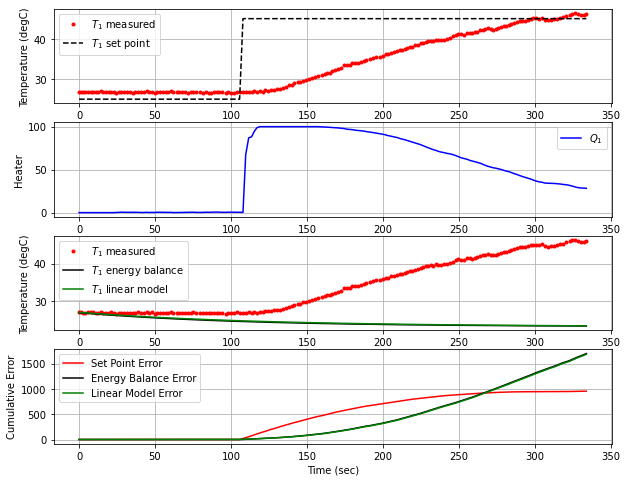

T1 NIH BOS  [44.61 44.73 44.81 44.93 45.22 45.34 45.73 46.02 46.25 46.35 46.17 45.91
 45.94 46.19 46.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 337.9  45.00  46.38   0.00  27.28


<Figure size 432x288 with 0 Axes>

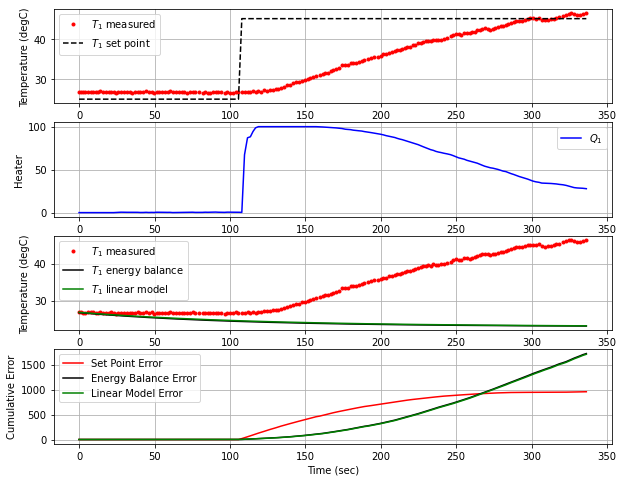

T1 NIH BOS  [44.73 44.81 44.93 45.22 45.34 45.73 46.02 46.25 46.35 46.17 45.91 45.94
 46.19 46.3  46.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 339.8  45.00  46.56   0.00  26.77


<Figure size 432x288 with 0 Axes>

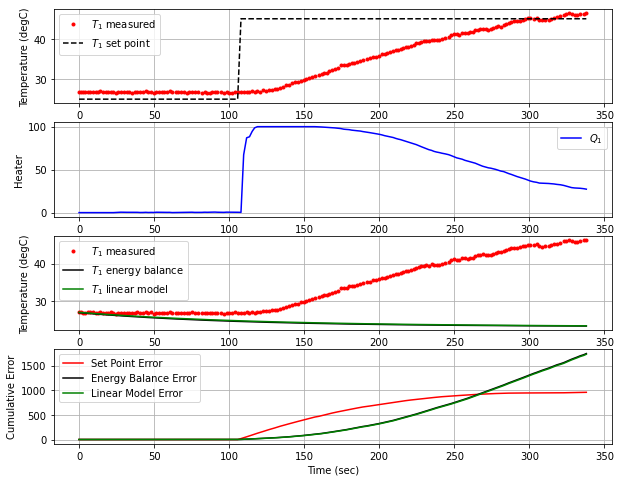

T1 NIH BOS  [44.81 44.93 45.22 45.34 45.73 46.02 46.25 46.35 46.17 45.91 45.94 46.19
 46.3  46.38 46.56]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 341.7  45.00  46.78   0.00  26.19


<Figure size 432x288 with 0 Axes>

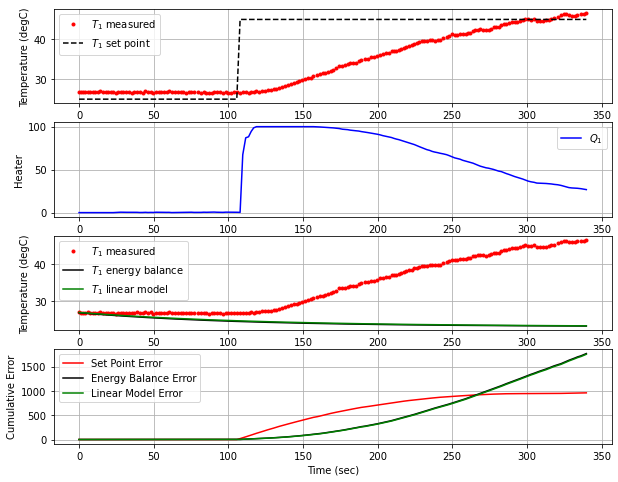

T1 NIH BOS  [44.93 45.22 45.34 45.73 46.02 46.25 46.35 46.17 45.91 45.94 46.19 46.3
 46.38 46.56 46.78]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 343.5  45.00  46.91   0.00  25.51


<Figure size 432x288 with 0 Axes>

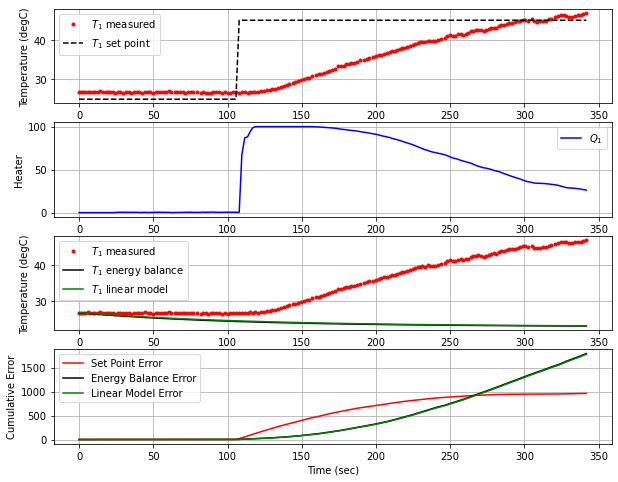

T1 NIH BOS  [45.22 45.34 45.73 46.02 46.25 46.35 46.17 45.91 45.94 46.19 46.3  46.38
 46.56 46.78 46.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 345.2  45.00  46.84   0.00  24.87


<Figure size 432x288 with 0 Axes>

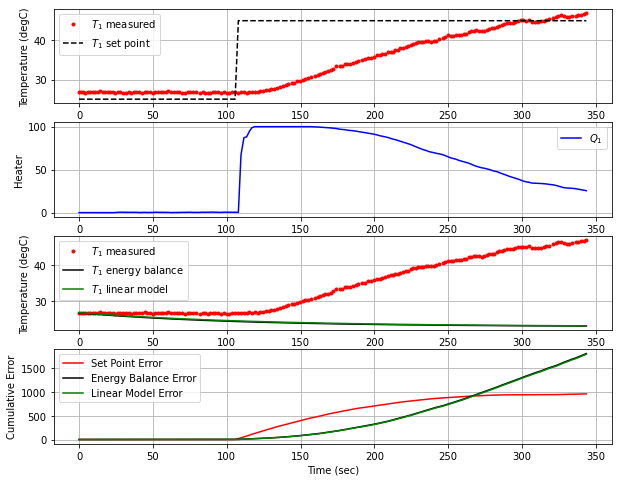

T1 NIH BOS  [45.34 45.73 46.02 46.25 46.35 46.17 45.91 45.94 46.19 46.3  46.38 46.56
 46.78 46.91 46.84]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 347.0  45.00  47.06   0.00  24.46


<Figure size 432x288 with 0 Axes>

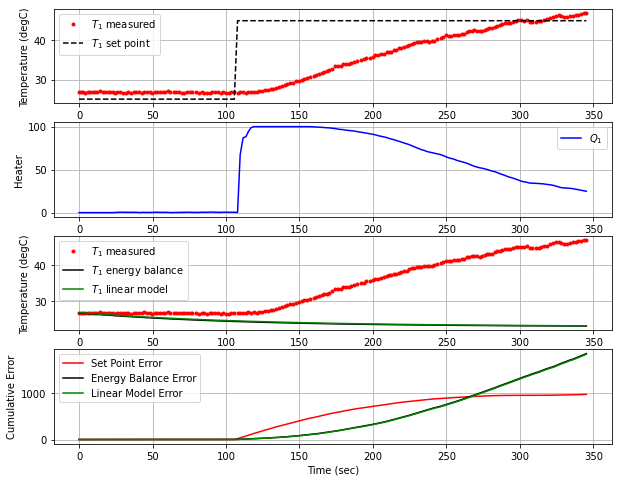

T1 NIH BOS  [45.73 46.02 46.25 46.35 46.17 45.91 45.94 46.19 46.3  46.38 46.56 46.78
 46.91 46.84 47.06]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 349.0  45.00  47.29   0.00  23.90


<Figure size 432x288 with 0 Axes>

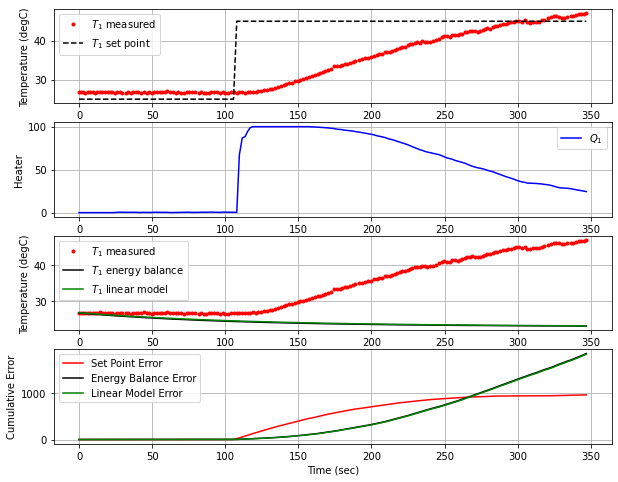

T1 NIH BOS  [46.02 46.25 46.35 46.17 45.91 45.94 46.19 46.3  46.38 46.56 46.78 46.91
 46.84 47.06 47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 350.9  45.00  47.51   0.00  23.26


<Figure size 432x288 with 0 Axes>

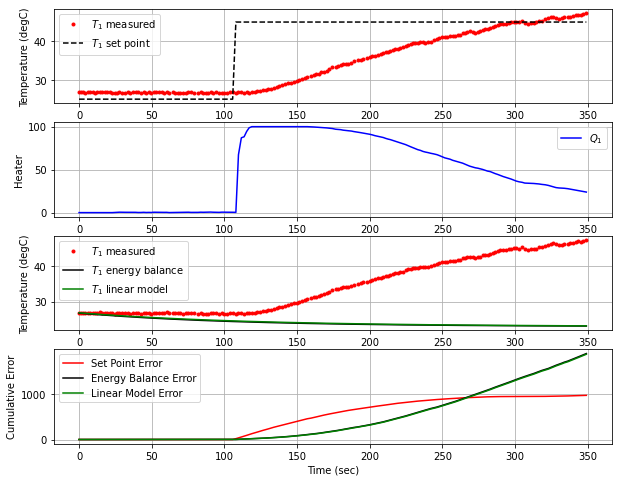

T1 NIH BOS  [46.25 46.35 46.17 45.91 45.94 46.19 46.3  46.38 46.56 46.78 46.91 46.84
 47.06 47.29 47.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 352.7  45.00  47.55   0.00  22.57


<Figure size 432x288 with 0 Axes>

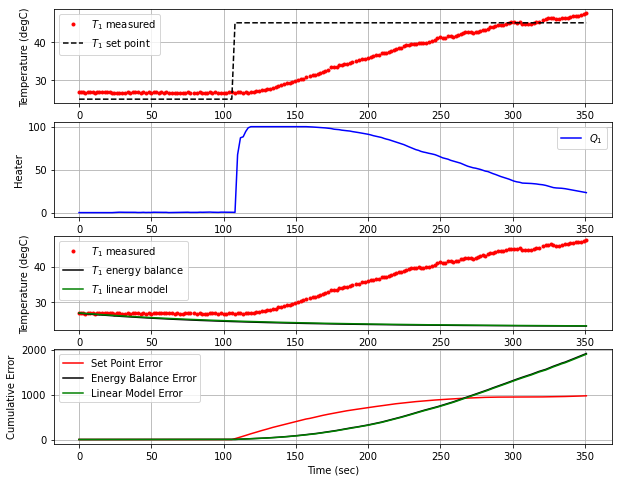

T1 NIH BOS  [46.35 46.17 45.91 45.94 46.19 46.3  46.38 46.56 46.78 46.91 46.84 47.06
 47.29 47.51 47.55]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 354.5  45.00  47.61   0.00  22.03


<Figure size 432x288 with 0 Axes>

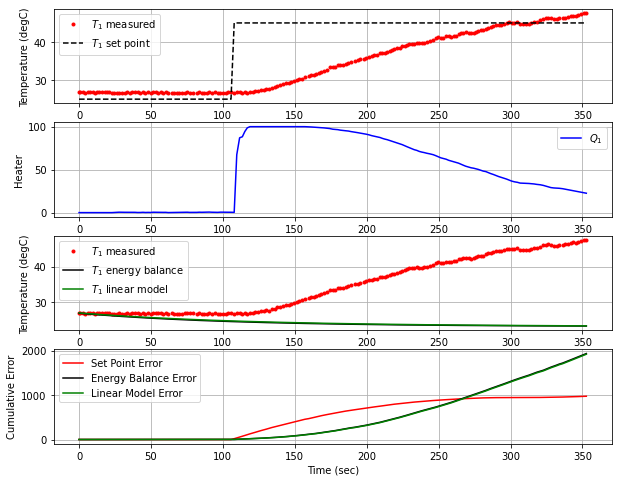

T1 NIH BOS  [46.17 45.91 45.94 46.19 46.3  46.38 46.56 46.78 46.91 46.84 47.06 47.29
 47.51 47.55 47.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 356.2  45.00  47.89   0.00  21.57


<Figure size 432x288 with 0 Axes>

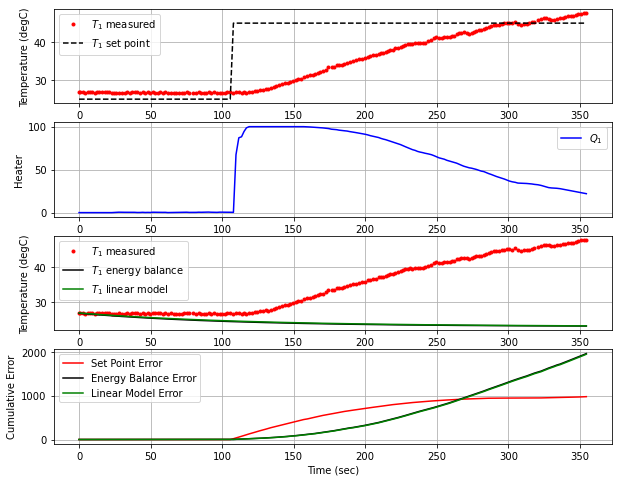

T1 NIH BOS  [45.91 45.94 46.19 46.3  46.38 46.56 46.78 46.91 46.84 47.06 47.29 47.51
 47.55 47.61 47.89]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 358.0  45.00  47.97   0.00  20.90


<Figure size 432x288 with 0 Axes>

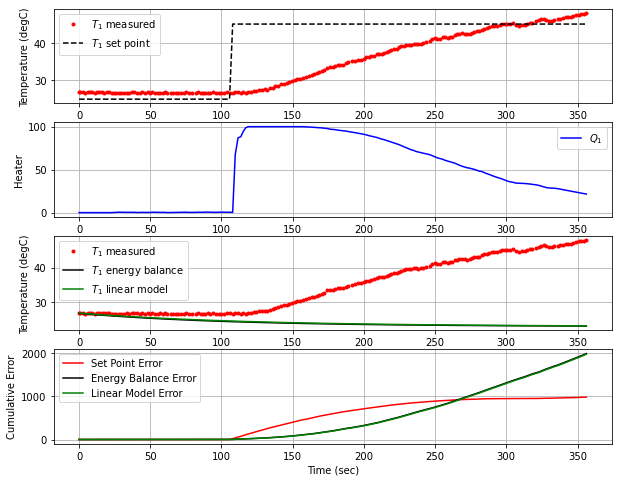

T1 NIH BOS  [45.94 46.19 46.3  46.38 46.56 46.78 46.91 46.84 47.06 47.29 47.51 47.55
 47.61 47.89 47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 359.9  45.00  48.02   0.00  20.27


<Figure size 432x288 with 0 Axes>

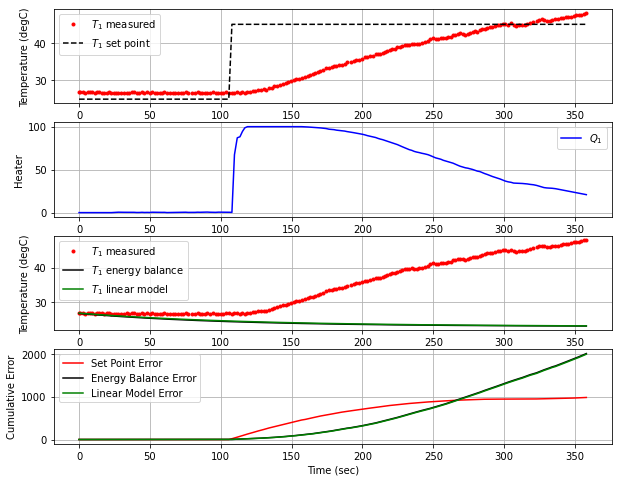

T1 NIH BOS  [46.19 46.3  46.38 46.56 46.78 46.91 46.84 47.06 47.29 47.51 47.55 47.61
 47.89 47.97 48.02]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 361.6  45.00  48.21   0.00  19.73


<Figure size 432x288 with 0 Axes>

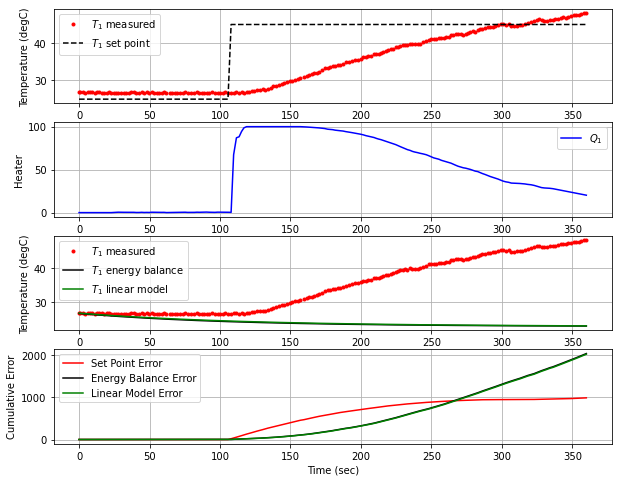

T1 NIH BOS  [46.3  46.38 46.56 46.78 46.91 46.84 47.06 47.29 47.51 47.55 47.61 47.89
 47.97 48.02 48.21]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 363.3  45.00  48.28   0.00  19.14


<Figure size 432x288 with 0 Axes>

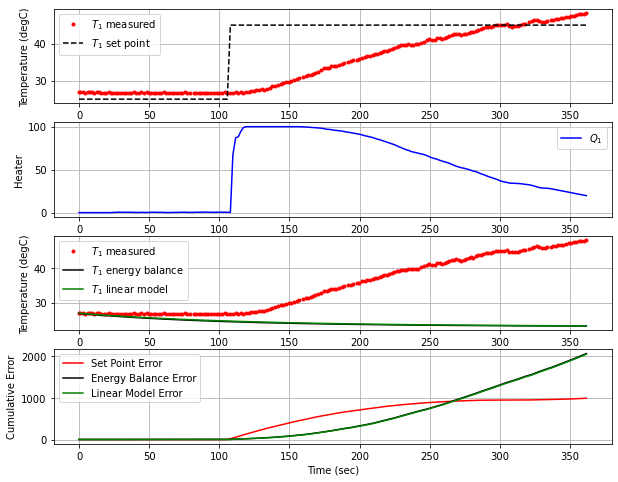

T1 NIH BOS  [46.38 46.56 46.78 46.91 46.84 47.06 47.29 47.51 47.55 47.61 47.89 47.97
 48.02 48.21 48.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 365.1  45.00  48.12   0.00  18.62


<Figure size 432x288 with 0 Axes>

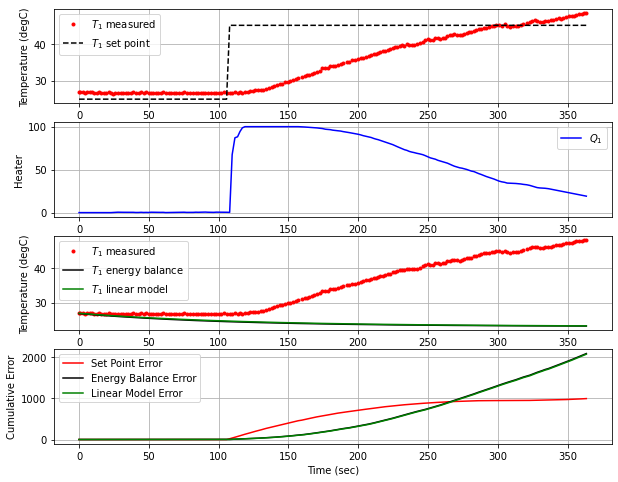

T1 NIH BOS  [46.56 46.78 46.91 46.84 47.06 47.29 47.51 47.55 47.61 47.89 47.97 48.02
 48.21 48.28 48.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 367.0  45.00  48.25   0.00  18.36


<Figure size 432x288 with 0 Axes>

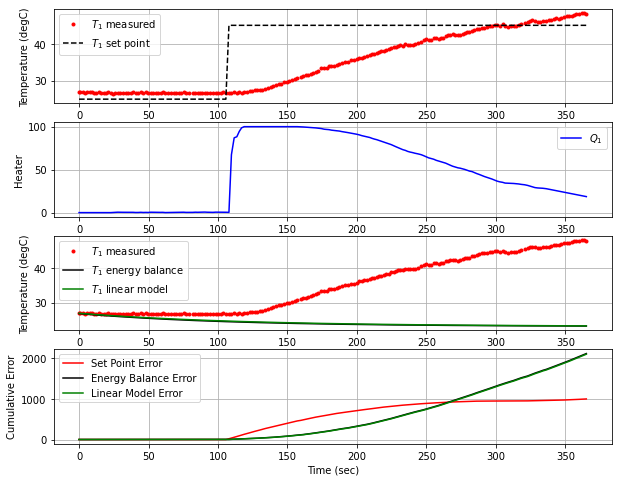

T1 NIH BOS  [46.78 46.91 46.84 47.06 47.29 47.51 47.55 47.61 47.89 47.97 48.02 48.21
 48.28 48.12 48.25]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 369.1  45.00  48.35   0.00  18.03


<Figure size 432x288 with 0 Axes>

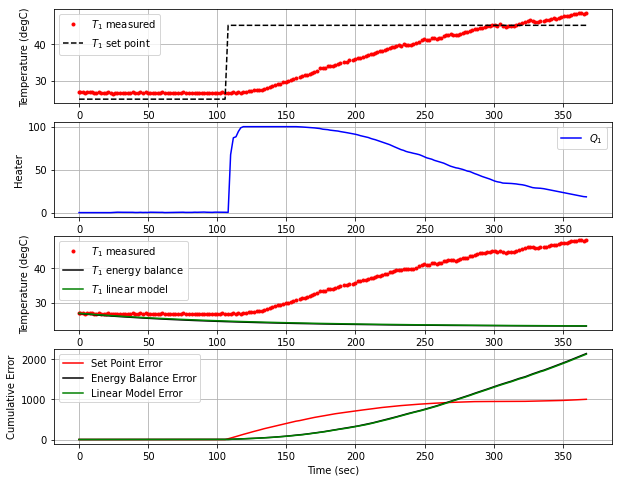

T1 NIH BOS  [46.91 46.84 47.06 47.29 47.51 47.55 47.61 47.89 47.97 48.02 48.21 48.28
 48.12 48.25 48.35]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 371.0  45.00  48.39   0.00  17.67


<Figure size 432x288 with 0 Axes>

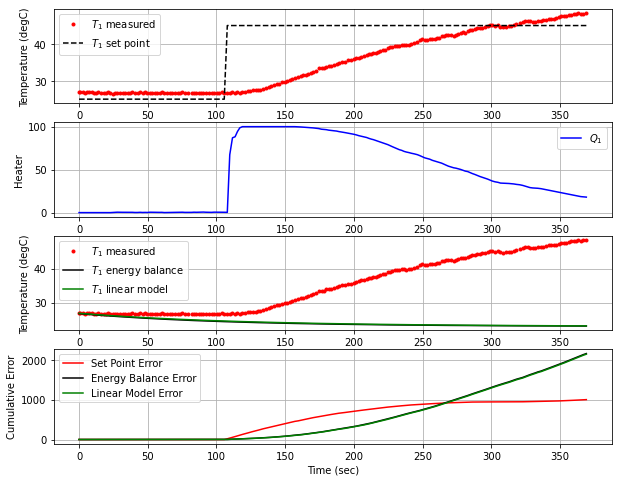

T1 NIH BOS  [46.84 47.06 47.29 47.51 47.55 47.61 47.89 47.97 48.02 48.21 48.28 48.12
 48.25 48.35 48.39]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 373.4  45.00  48.12   0.00  17.34


<Figure size 432x288 with 0 Axes>

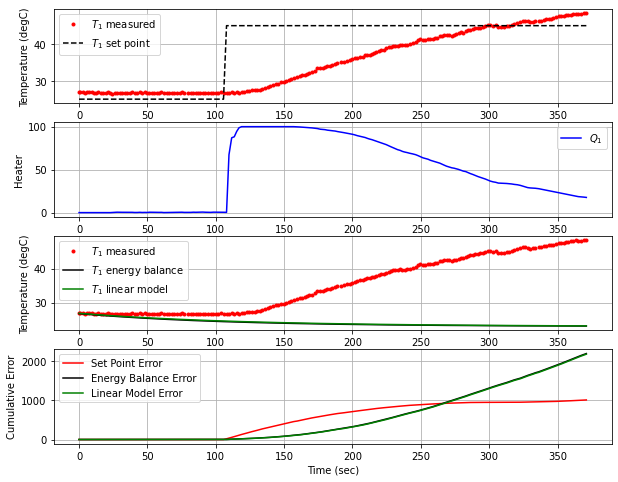

T1 NIH BOS  [47.06 47.29 47.51 47.55 47.61 47.89 47.97 48.02 48.21 48.28 48.12 48.25
 48.35 48.39 48.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 375.2  45.00  48.52   0.00  17.33


<Figure size 432x288 with 0 Axes>

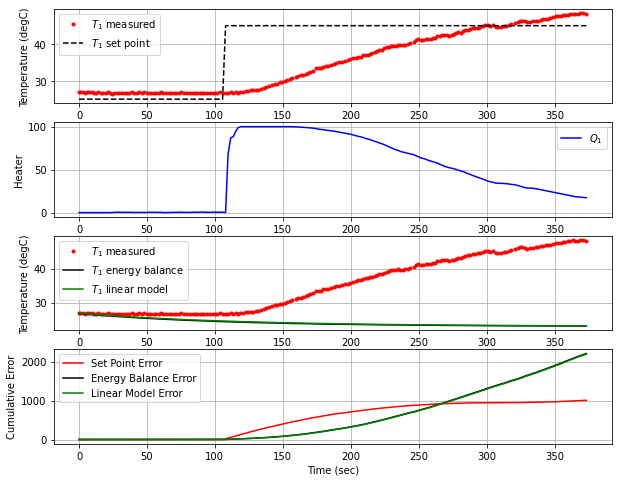

T1 NIH BOS  [47.29 47.51 47.55 47.61 47.89 47.97 48.02 48.21 48.28 48.12 48.25 48.35
 48.39 48.12 48.52]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 377.1  45.00  48.30   0.00  16.95


<Figure size 432x288 with 0 Axes>

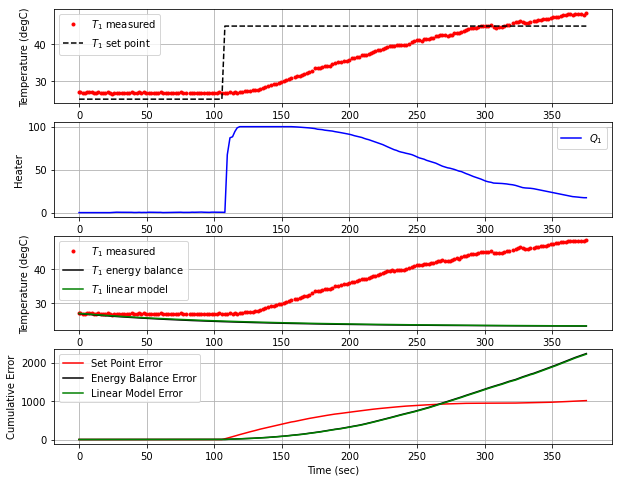

T1 NIH BOS  [47.51 47.55 47.61 47.89 47.97 48.02 48.21 48.28 48.12 48.25 48.35 48.39
 48.12 48.52 48.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 379.1  45.00  48.41   0.00  16.84


<Figure size 432x288 with 0 Axes>

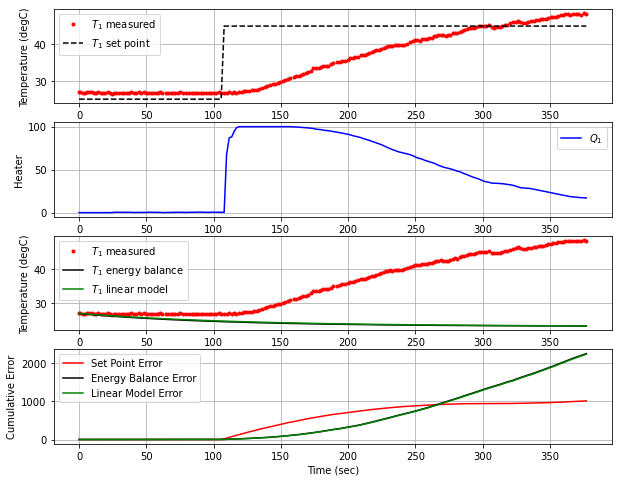

T1 NIH BOS  [47.55 47.61 47.89 47.97 48.02 48.21 48.28 48.12 48.25 48.35 48.39 48.12
 48.52 48.3  48.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 381.0  45.00  48.16   0.00  16.68


<Figure size 432x288 with 0 Axes>

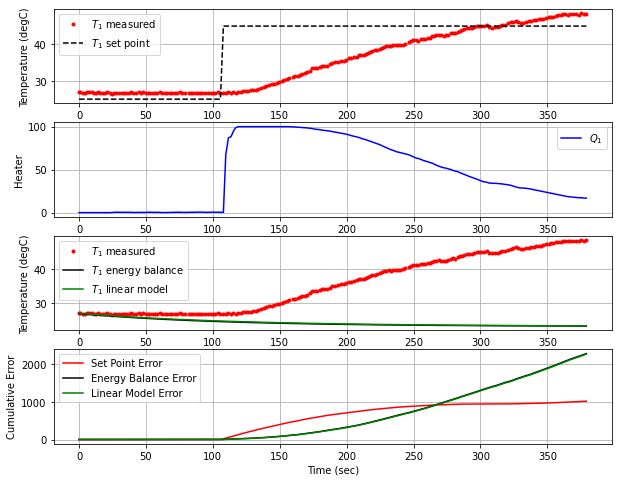

T1 NIH BOS  [47.61 47.89 47.97 48.02 48.21 48.28 48.12 48.25 48.35 48.39 48.12 48.52
 48.3  48.41 48.16]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 383.2  45.00  47.97   0.00  16.78


<Figure size 432x288 with 0 Axes>

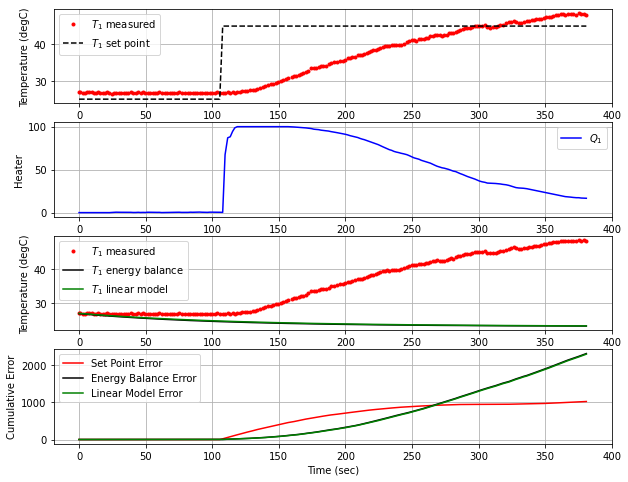

T1 NIH BOS  [47.89 47.97 48.02 48.21 48.28 48.12 48.25 48.35 48.39 48.12 48.52 48.3
 48.41 48.16 47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 385.3  45.00  47.59   0.00  17.01


<Figure size 432x288 with 0 Axes>

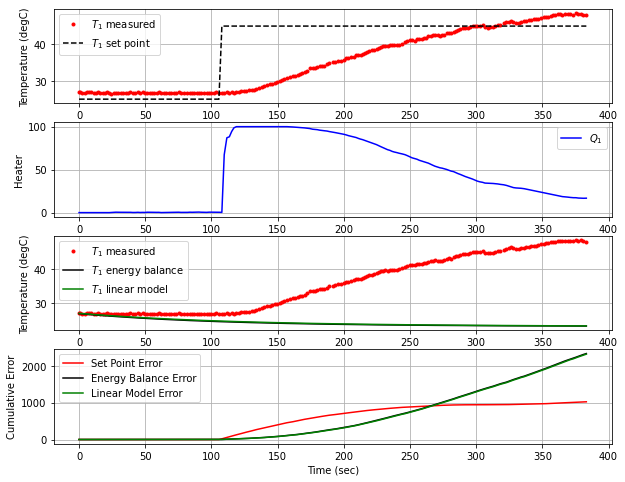

T1 NIH BOS  [47.97 48.02 48.21 48.28 48.12 48.25 48.35 48.39 48.12 48.52 48.3  48.41
 48.16 47.97 47.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 387.1  45.00  47.67   0.00  17.52


<Figure size 432x288 with 0 Axes>

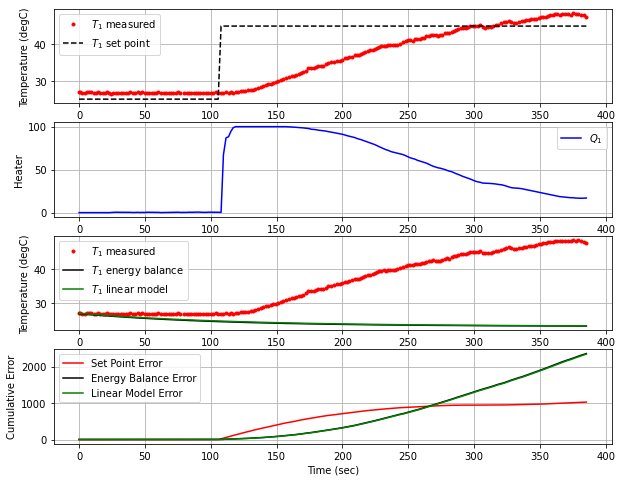

T1 NIH BOS  [48.02 48.21 48.28 48.12 48.25 48.35 48.39 48.12 48.52 48.3  48.41 48.16
 47.97 47.59 47.67]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 388.9  45.00  47.78   0.00  17.80


<Figure size 432x288 with 0 Axes>

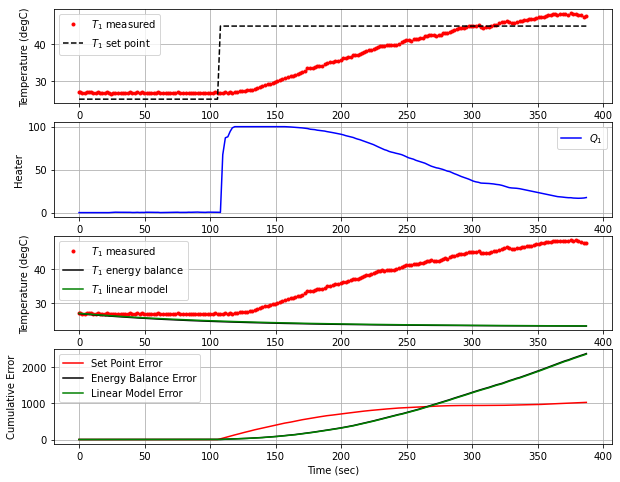

T1 NIH BOS  [48.21 48.28 48.12 48.25 48.35 48.39 48.12 48.52 48.3  48.41 48.16 47.97
 47.59 47.67 47.78]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 390.8  45.00  47.80   0.00  17.86


<Figure size 432x288 with 0 Axes>

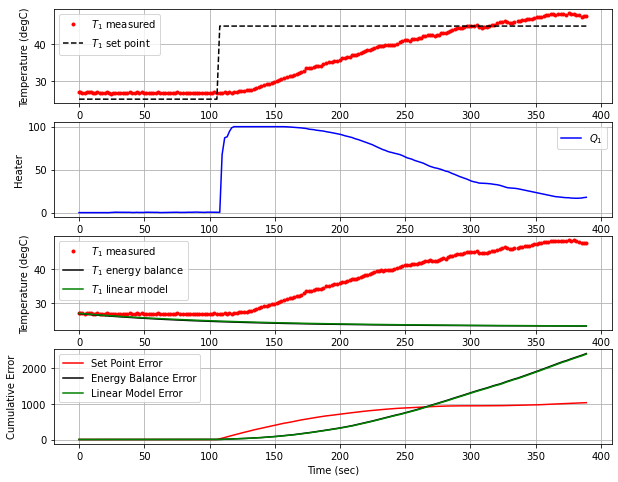

T1 NIH BOS  [48.28 48.12 48.25 48.35 48.39 48.12 48.52 48.3  48.41 48.16 47.97 47.59
 47.67 47.78 47.8 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 51ms/step
 392.6  45.00  47.82   0.00  17.91


<Figure size 432x288 with 0 Axes>

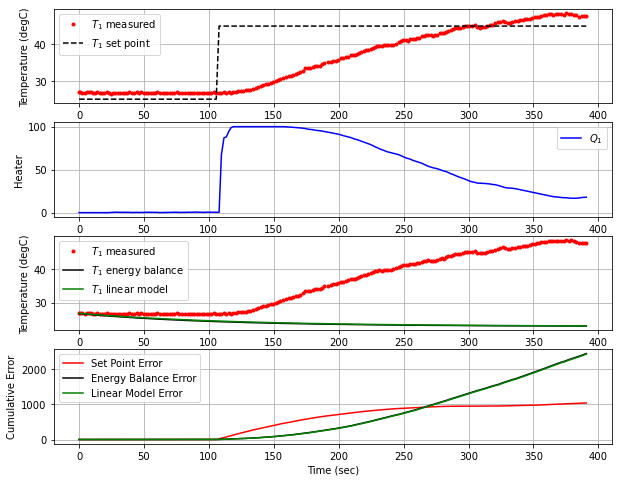

T1 NIH BOS  [48.12 48.25 48.35 48.39 48.12 48.52 48.3  48.41 48.16 47.97 47.59 47.67
 47.78 47.8  47.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 394.4  45.00  47.86   0.00  17.97


<Figure size 432x288 with 0 Axes>

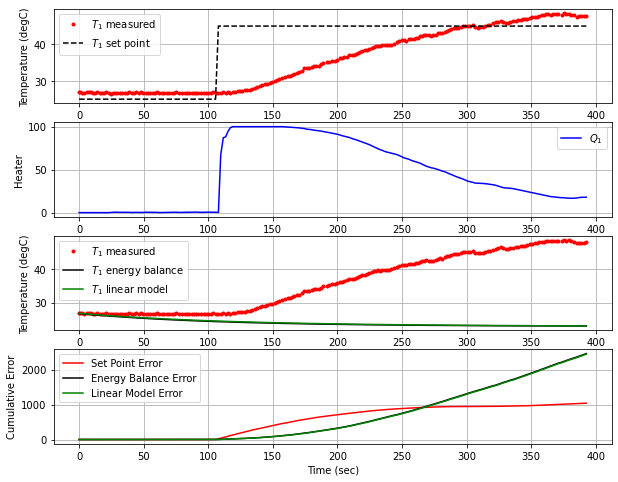

T1 NIH BOS  [48.25 48.35 48.39 48.12 48.52 48.3  48.41 48.16 47.97 47.59 47.67 47.78
 47.8  47.82 47.86]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 396.7  45.00  47.96   0.00  17.99


<Figure size 432x288 with 0 Axes>

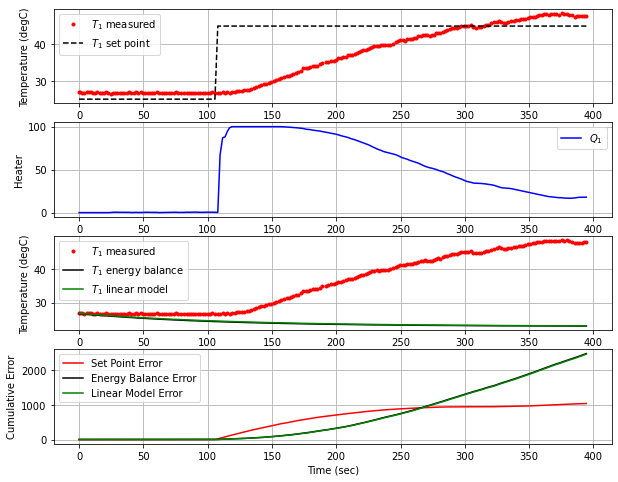

T1 NIH BOS  [48.35 48.39 48.12 48.52 48.3  48.41 48.16 47.97 47.59 47.67 47.78 47.8
 47.82 47.86 47.96]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 53ms/step
 398.7  45.00  47.90   0.00  17.94


<Figure size 432x288 with 0 Axes>

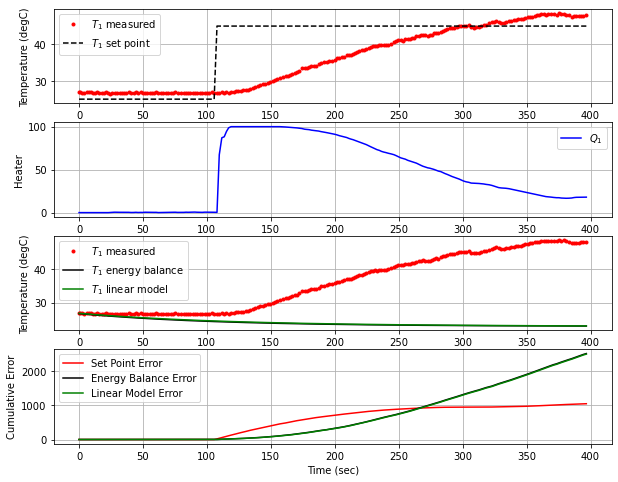

T1 NIH BOS  [48.39 48.12 48.52 48.3  48.41 48.16 47.97 47.59 47.67 47.78 47.8  47.82
 47.86 47.96 47.9 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 400.8  45.00  47.81   0.00  17.99


<Figure size 432x288 with 0 Axes>

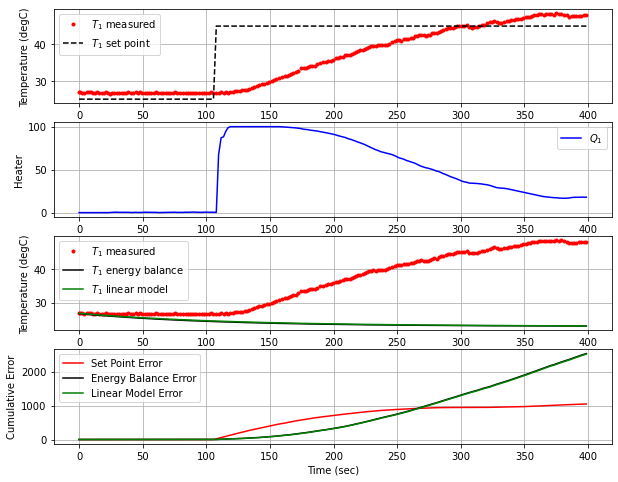

T1 NIH BOS  [48.12 48.52 48.3  48.41 48.16 47.97 47.59 47.67 47.78 47.8  47.82 47.86
 47.96 47.9  47.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 402.7  45.00  47.89   0.00  18.13


<Figure size 432x288 with 0 Axes>

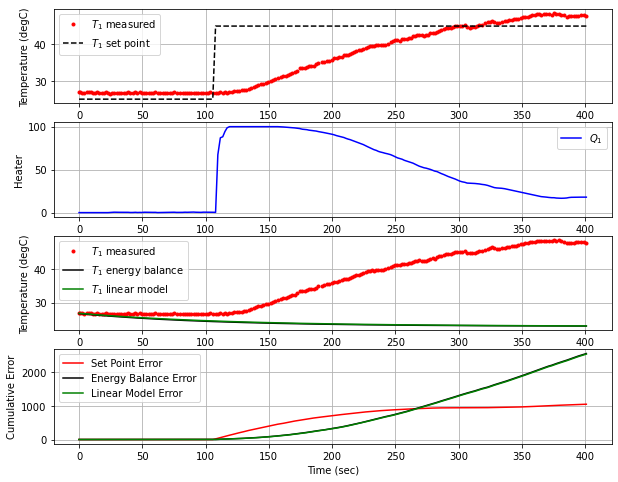

T1 NIH BOS  [48.52 48.3  48.41 48.16 47.97 47.59 47.67 47.78 47.8  47.82 47.86 47.96
 47.9  47.81 47.89]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 404.7  45.00  48.06   0.00  18.15


<Figure size 432x288 with 0 Axes>

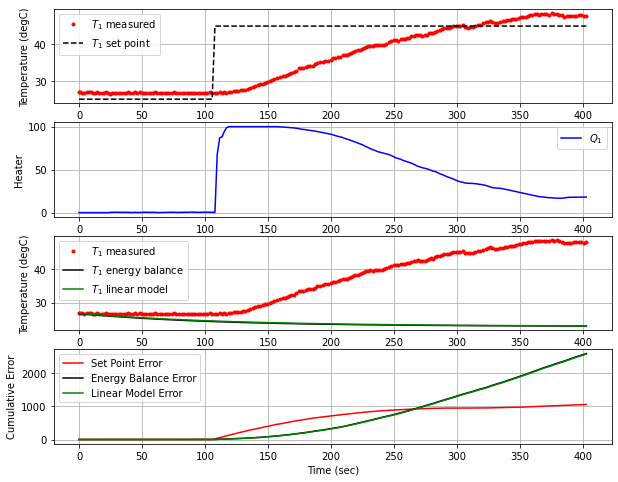

T1 NIH BOS  [48.3  48.41 48.16 47.97 47.59 47.67 47.78 47.8  47.82 47.86 47.96 47.9
 47.81 47.89 48.06]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 406.6  45.00  47.98   0.00  18.03


<Figure size 432x288 with 0 Axes>

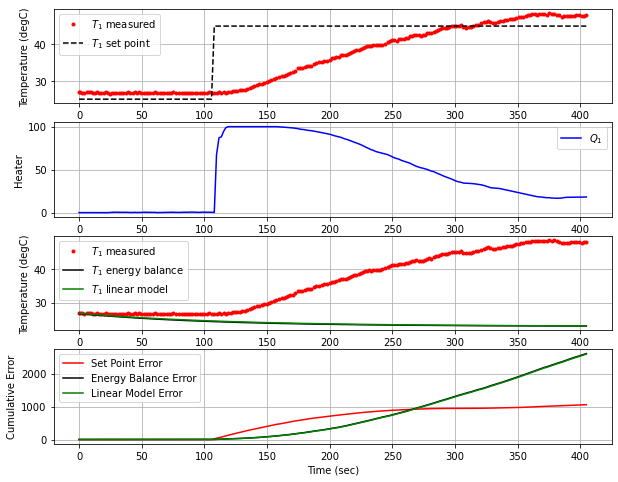

T1 NIH BOS  [48.41 48.16 47.97 47.59 47.67 47.78 47.8  47.82 47.86 47.96 47.9  47.81
 47.89 48.06 47.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 408.5  45.00  48.21   0.00  18.01


<Figure size 432x288 with 0 Axes>

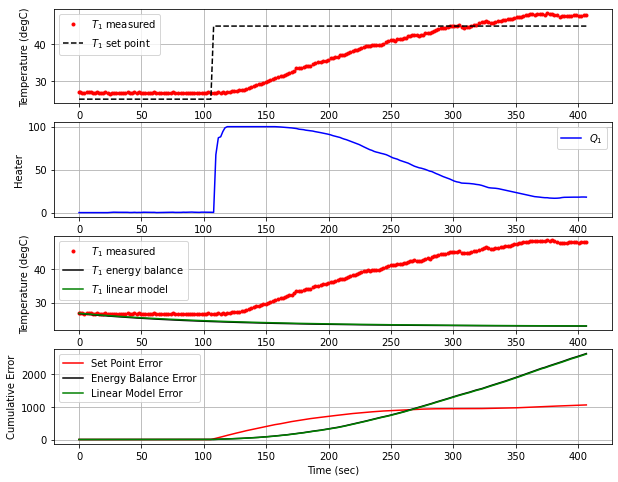

T1 NIH BOS  [48.16 47.97 47.59 47.67 47.78 47.8  47.82 47.86 47.96 47.9  47.81 47.89
 48.06 47.98 48.21]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 410.6  45.00  48.08   0.00  17.81


<Figure size 432x288 with 0 Axes>

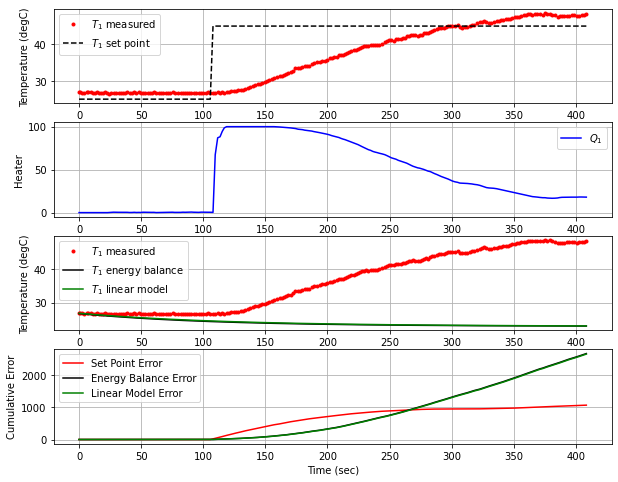

T1 NIH BOS  [47.97 47.59 47.67 47.78 47.8  47.82 47.86 47.96 47.9  47.81 47.89 48.06
 47.98 48.21 48.08]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 412.5  45.00  47.97   0.00  17.77


<Figure size 432x288 with 0 Axes>

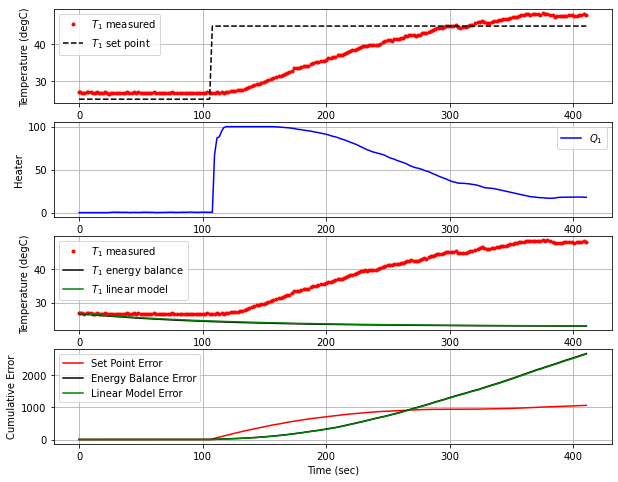

T1 NIH BOS  [47.59 47.67 47.78 47.8  47.82 47.86 47.96 47.9  47.81 47.89 48.06 47.98
 48.21 48.08 47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 414.5  45.00  48.19   0.00  17.85


<Figure size 432x288 with 0 Axes>

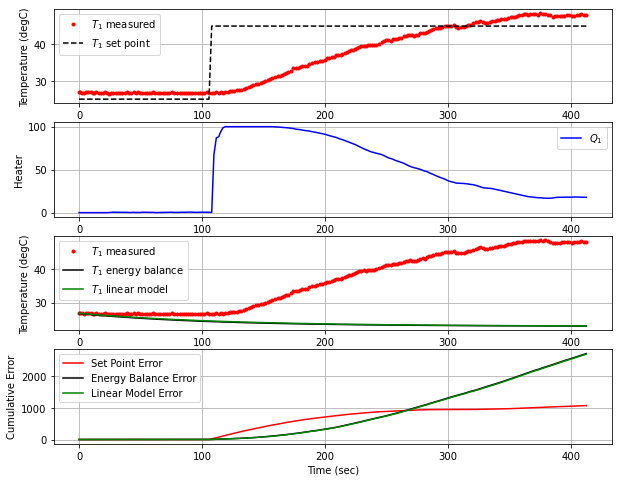

T1 NIH BOS  [47.67 47.78 47.8  47.82 47.86 47.96 47.9  47.81 47.89 48.06 47.98 48.21
 48.08 47.97 48.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 416.6  45.00  47.79   0.00  17.66


<Figure size 432x288 with 0 Axes>

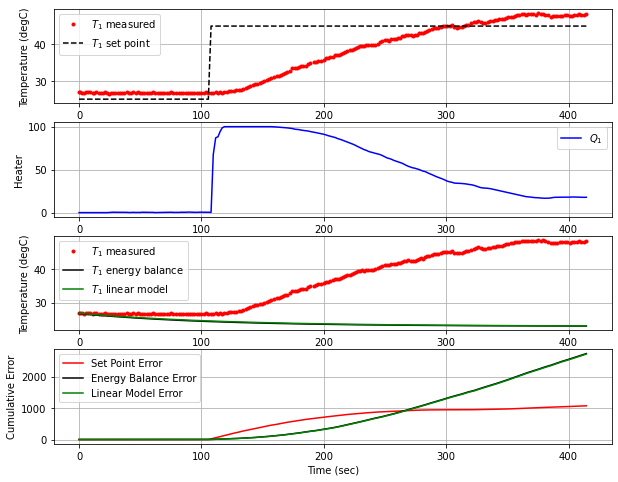

T1 NIH BOS  [47.78 47.8  47.82 47.86 47.96 47.9  47.81 47.89 48.06 47.98 48.21 48.08
 47.97 48.19 47.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 418.4  45.00  47.73   0.00  17.87


<Figure size 432x288 with 0 Axes>

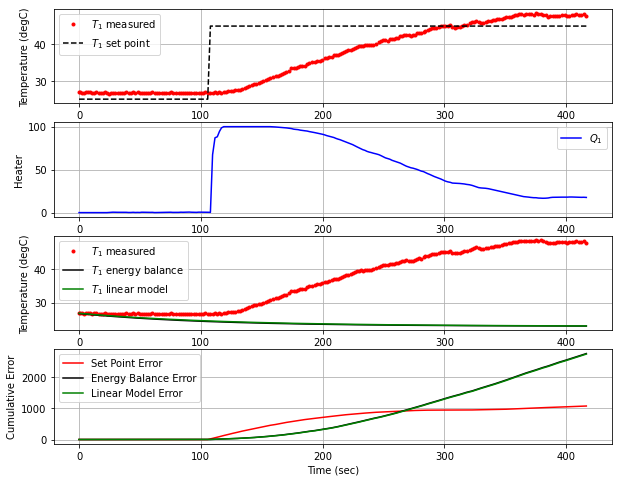

T1 NIH BOS  [47.8  47.82 47.86 47.96 47.9  47.81 47.89 48.06 47.98 48.21 48.08 47.97
 48.19 47.79 47.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 420.2  45.00  47.75   0.00  18.09


<Figure size 432x288 with 0 Axes>

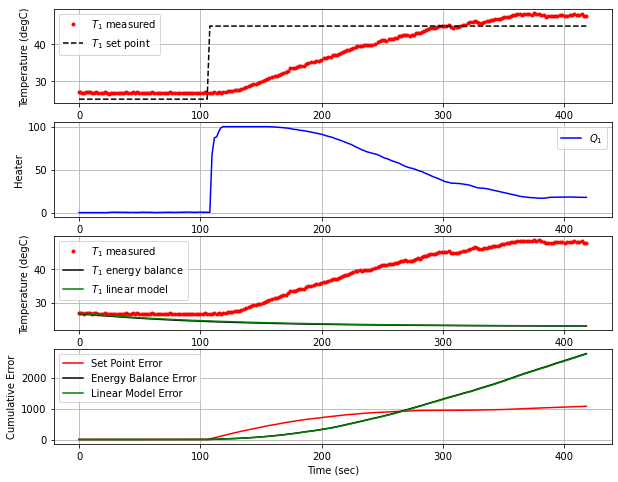

T1 NIH BOS  [47.82 47.86 47.96 47.9  47.81 47.89 48.06 47.98 48.21 48.08 47.97 48.19
 47.79 47.73 47.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 421.9  45.00  47.77   0.00  18.21


<Figure size 432x288 with 0 Axes>

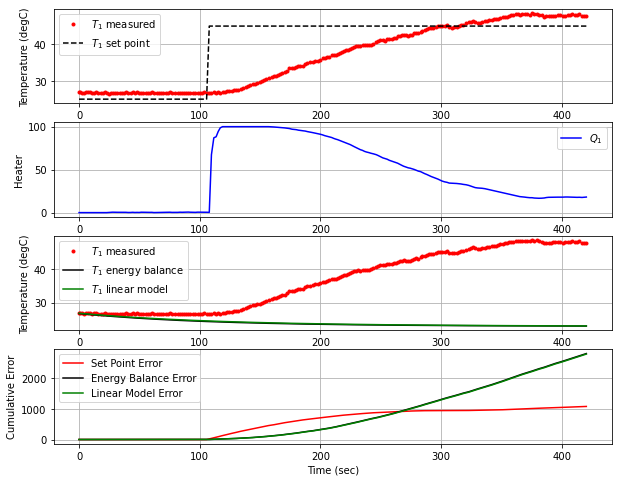

T1 NIH BOS  [47.86 47.96 47.9  47.81 47.89 48.06 47.98 48.21 48.08 47.97 48.19 47.79
 47.73 47.75 47.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 423.8  45.00  47.80   0.00  18.25


<Figure size 432x288 with 0 Axes>

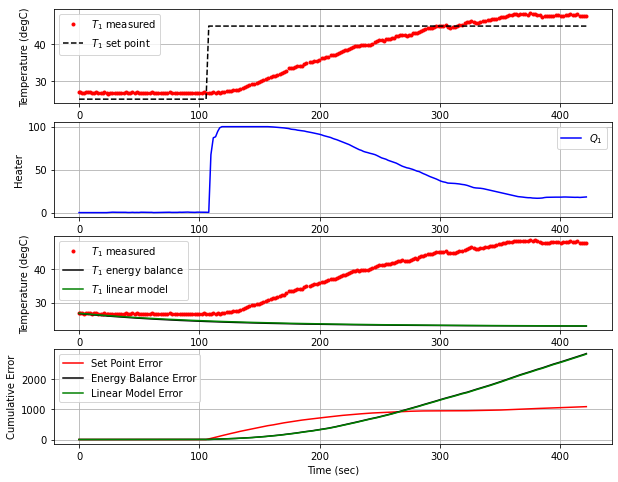

T1 NIH BOS  [47.96 47.9  47.81 47.89 48.06 47.98 48.21 48.08 47.97 48.19 47.79 47.73
 47.75 47.77 47.8 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 425.5  45.00  47.69   0.00  18.26


<Figure size 432x288 with 0 Axes>

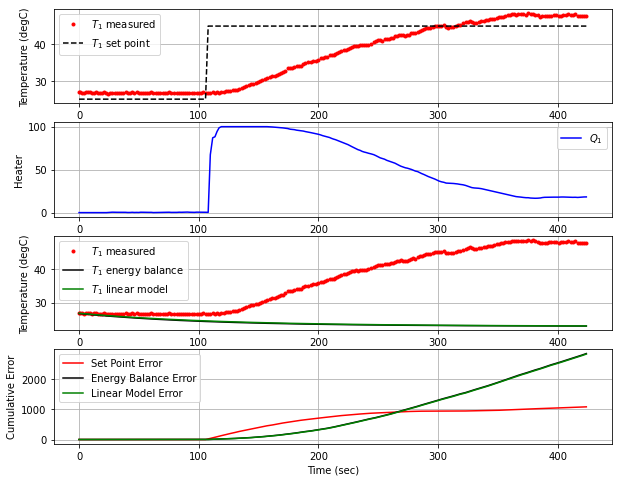

T1 NIH BOS  [47.9  47.81 47.89 48.06 47.98 48.21 48.08 47.97 48.19 47.79 47.73 47.75
 47.77 47.8  47.69]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 427.5  45.00  47.45   0.00  18.39


<Figure size 432x288 with 0 Axes>

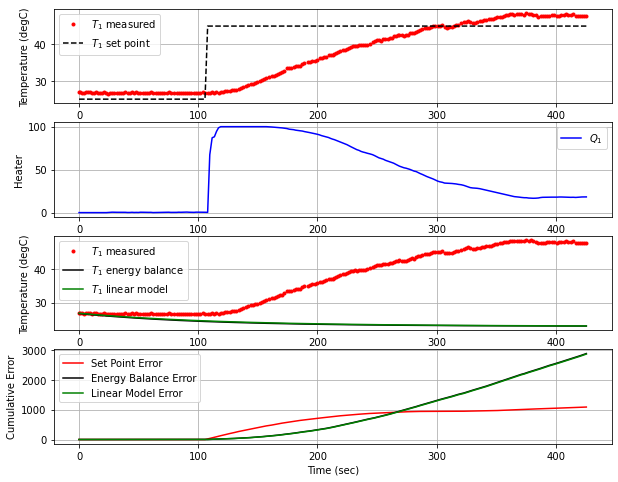

T1 NIH BOS  [47.81 47.89 48.06 47.98 48.21 48.08 47.97 48.19 47.79 47.73 47.75 47.77
 47.8  47.69 47.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 429.5  45.00  47.44   0.00  18.72


<Figure size 432x288 with 0 Axes>

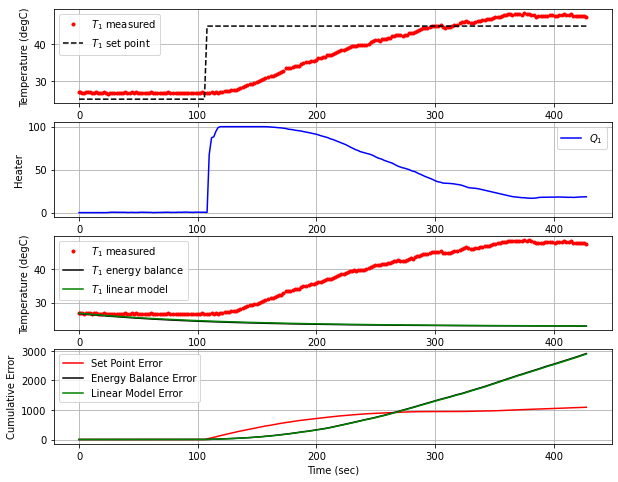

T1 NIH BOS  [47.89 48.06 47.98 48.21 48.08 47.97 48.19 47.79 47.73 47.75 47.77 47.8
 47.69 47.45 47.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 432.2  45.00  47.57   0.00  18.97


<Figure size 432x288 with 0 Axes>

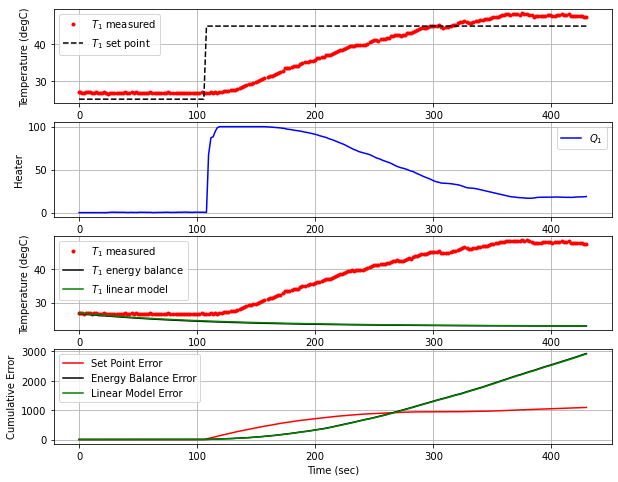

T1 NIH BOS  [48.06 47.98 48.21 48.08 47.97 48.19 47.79 47.73 47.75 47.77 47.8  47.69
 47.45 47.44 47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 434.4  45.00  47.63   0.00  19.01


<Figure size 432x288 with 0 Axes>

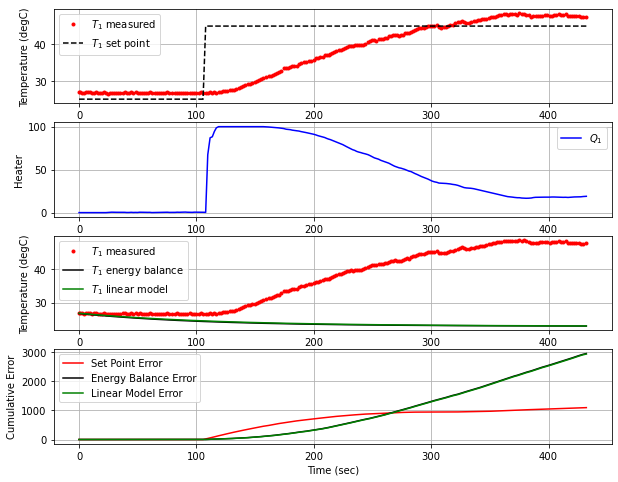

T1 NIH BOS  [47.98 48.21 48.08 47.97 48.19 47.79 47.73 47.75 47.77 47.8  47.69 47.45
 47.44 47.57 47.63]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 436.2  45.00  47.43   0.00  19.01


<Figure size 432x288 with 0 Axes>

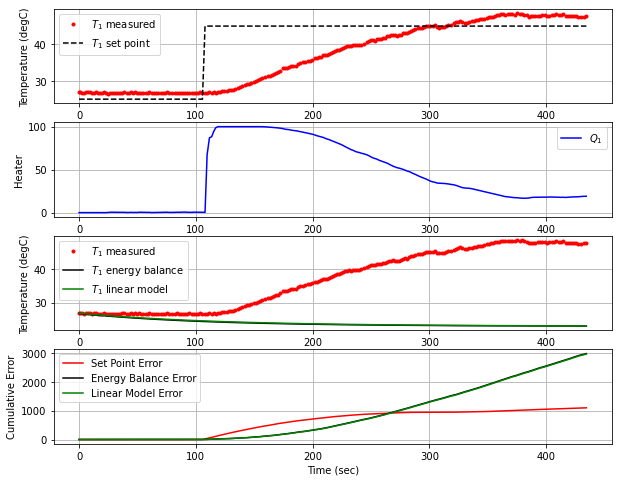

T1 NIH BOS  [48.21 48.08 47.97 48.19 47.79 47.73 47.75 47.77 47.8  47.69 47.45 47.44
 47.57 47.63 47.43]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 438.2  45.00  47.59   0.00  19.22


<Figure size 432x288 with 0 Axes>

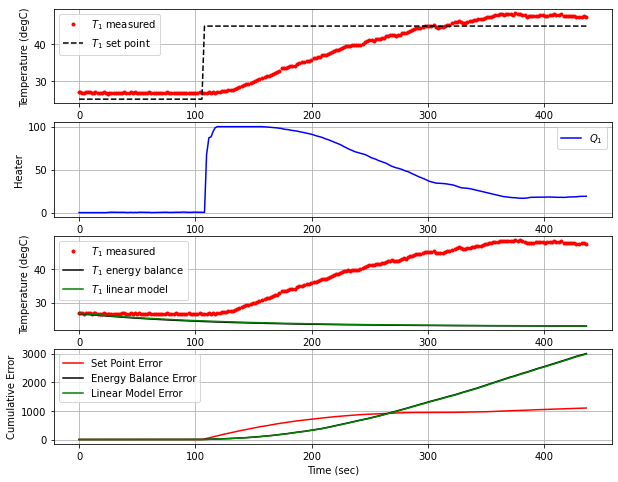

T1 NIH BOS  [48.08 47.97 48.19 47.79 47.73 47.75 47.77 47.8  47.69 47.45 47.44 47.57
 47.63 47.43 47.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 440.0  45.00  47.64   0.00  19.26


<Figure size 432x288 with 0 Axes>

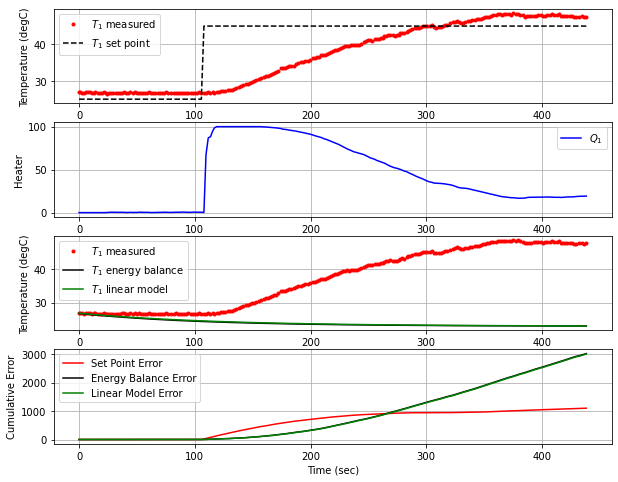

T1 NIH BOS  [47.97 48.19 47.79 47.73 47.75 47.77 47.8  47.69 47.45 47.44 47.57 47.63
 47.43 47.59 47.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 442.0  45.00  47.84   0.00  19.24


<Figure size 432x288 with 0 Axes>

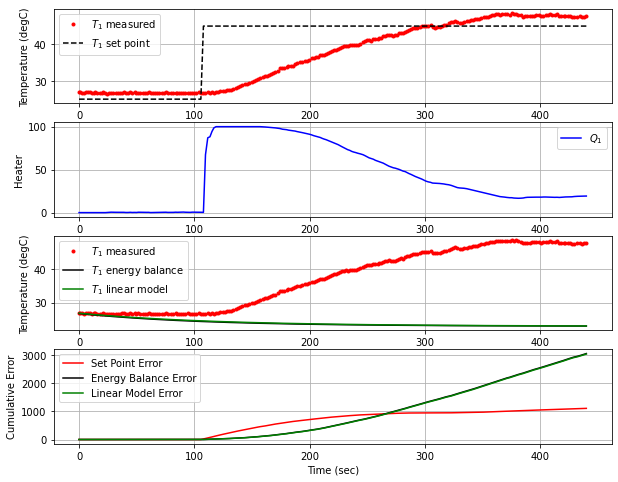

T1 NIH BOS  [48.19 47.79 47.73 47.75 47.77 47.8  47.69 47.45 47.44 47.57 47.63 47.43
 47.59 47.64 47.84]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 443.6  45.00  47.89   0.00  19.05


<Figure size 432x288 with 0 Axes>

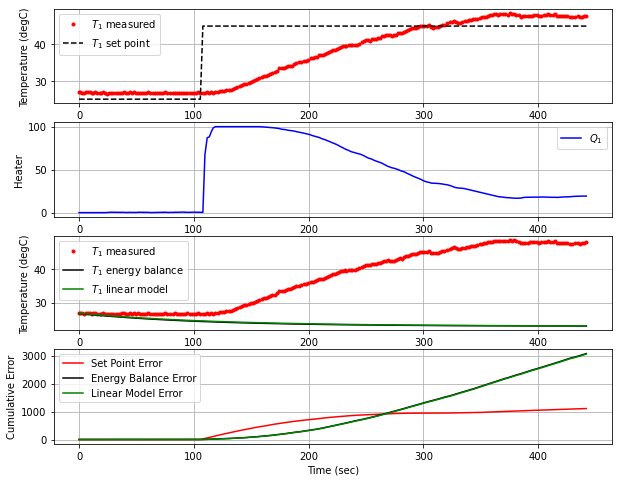

T1 NIH BOS  [47.79 47.73 47.75 47.77 47.8  47.69 47.45 47.44 47.57 47.63 47.43 47.59
 47.64 47.84 47.89]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 445.7  45.00  48.04   0.00  18.90


<Figure size 432x288 with 0 Axes>

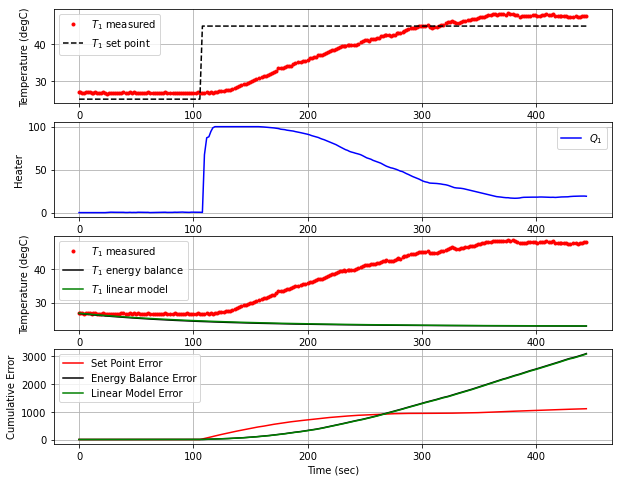

T1 NIH BOS  [47.73 47.75 47.77 47.8  47.69 47.45 47.44 47.57 47.63 47.43 47.59 47.64
 47.84 47.89 48.04]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 448.1  45.00  47.90   0.00  18.64


<Figure size 432x288 with 0 Axes>

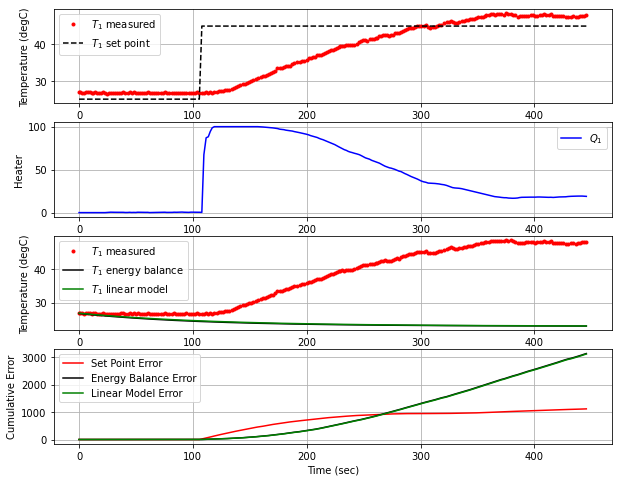

T1 NIH BOS  [47.75 47.77 47.8  47.69 47.45 47.44 47.57 47.63 47.43 47.59 47.64 47.84
 47.89 48.04 47.9 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 449.8  45.00  47.73   0.00  18.59


<Figure size 432x288 with 0 Axes>

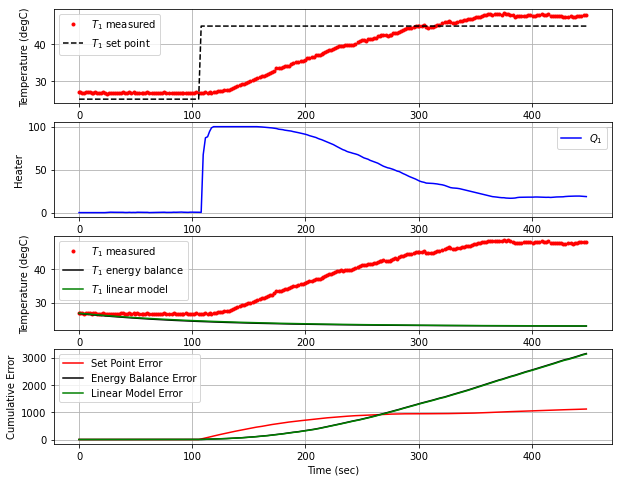

T1 NIH BOS  [47.77 47.8  47.69 47.45 47.44 47.57 47.63 47.43 47.59 47.64 47.84 47.89
 48.04 47.9  47.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 451.7  45.00  47.30   0.00  18.71


<Figure size 432x288 with 0 Axes>

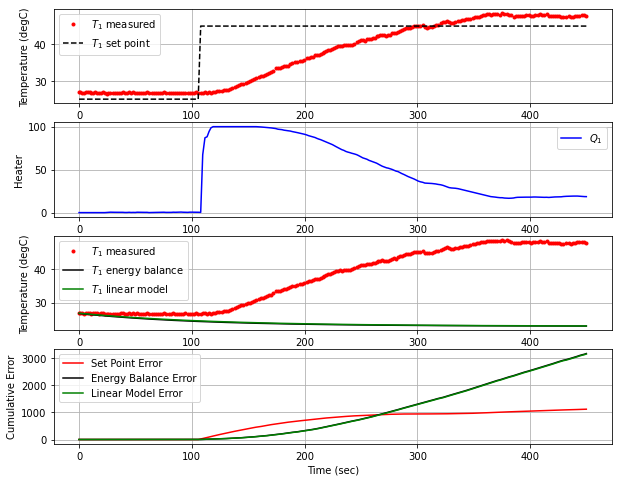

T1 NIH BOS  [47.8  47.69 47.45 47.44 47.57 47.63 47.43 47.59 47.64 47.84 47.89 48.04
 47.9  47.73 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 453.7  45.00  47.23   0.00  19.20


<Figure size 432x288 with 0 Axes>

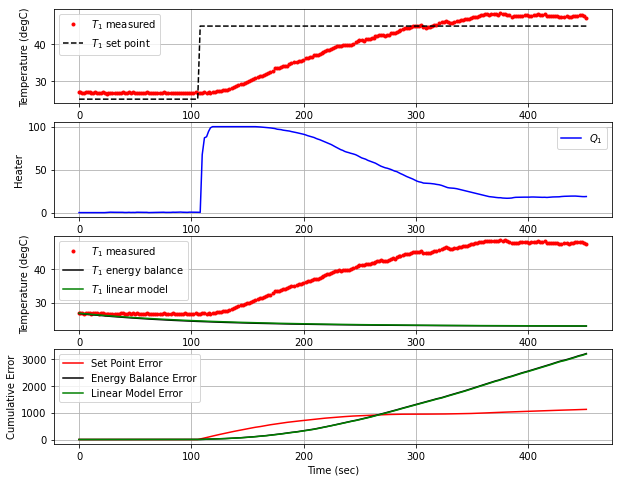

T1 NIH BOS  [47.69 47.45 47.44 47.57 47.63 47.43 47.59 47.64 47.84 47.89 48.04 47.9
 47.73 47.3  47.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 455.6  45.00  47.24   0.00  19.59


<Figure size 432x288 with 0 Axes>

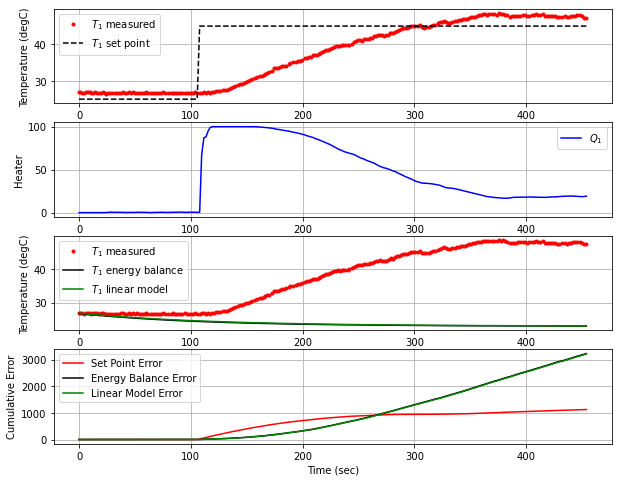

T1 NIH BOS  [47.45 47.44 47.57 47.63 47.43 47.59 47.64 47.84 47.89 48.04 47.9  47.73
 47.3  47.23 47.24]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 51ms/step
 457.3  45.00  47.22   0.00  19.81


<Figure size 432x288 with 0 Axes>

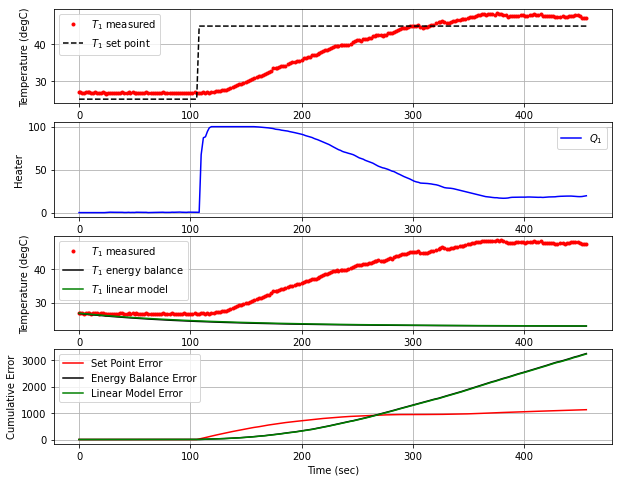

T1 NIH BOS  [47.44 47.57 47.63 47.43 47.59 47.64 47.84 47.89 48.04 47.9  47.73 47.3
 47.23 47.24 47.22]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 459.3  45.00  47.24   0.00  19.96


<Figure size 432x288 with 0 Axes>

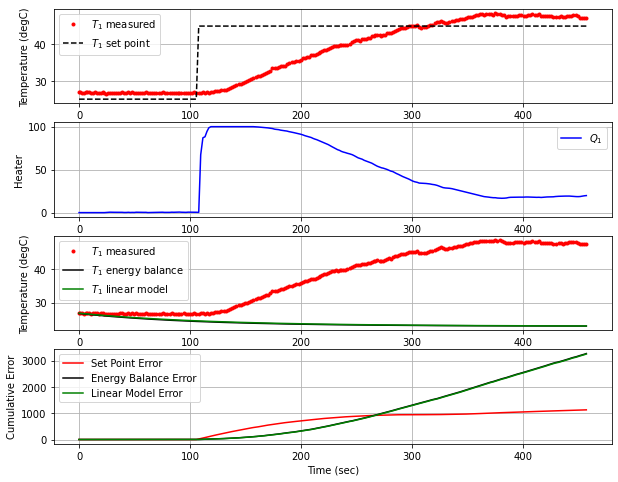

T1 NIH BOS  [47.57 47.63 47.43 47.59 47.64 47.84 47.89 48.04 47.9  47.73 47.3  47.23
 47.24 47.22 47.24]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 461.0  45.00  47.11   0.00  20.06


<Figure size 432x288 with 0 Axes>

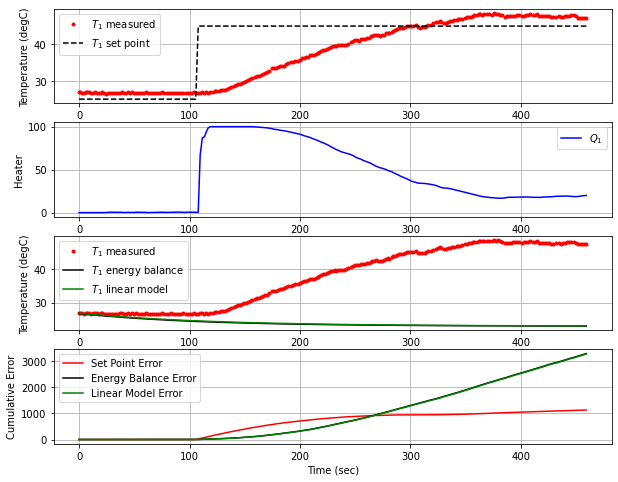

T1 NIH BOS  [47.63 47.43 47.59 47.64 47.84 47.89 48.04 47.9  47.73 47.3  47.23 47.24
 47.22 47.24 47.11]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 462.9  45.00  47.17   0.00  20.30


<Figure size 432x288 with 0 Axes>

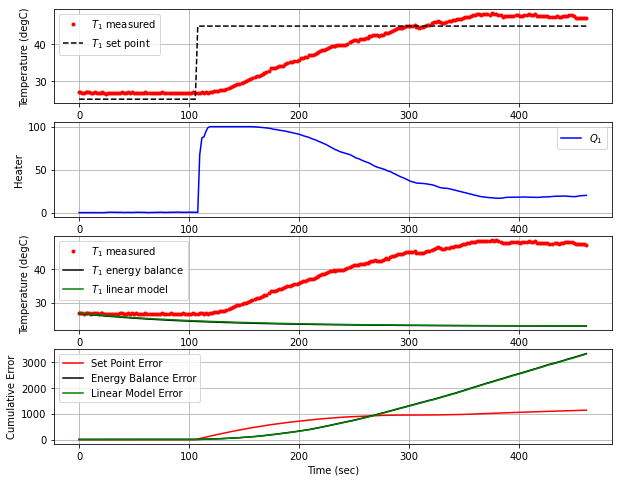

T1 NIH BOS  [47.43 47.59 47.64 47.84 47.89 48.04 47.9  47.73 47.3  47.23 47.24 47.22
 47.24 47.11 47.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 464.7  45.00  47.30   0.00  20.44


<Figure size 432x288 with 0 Axes>

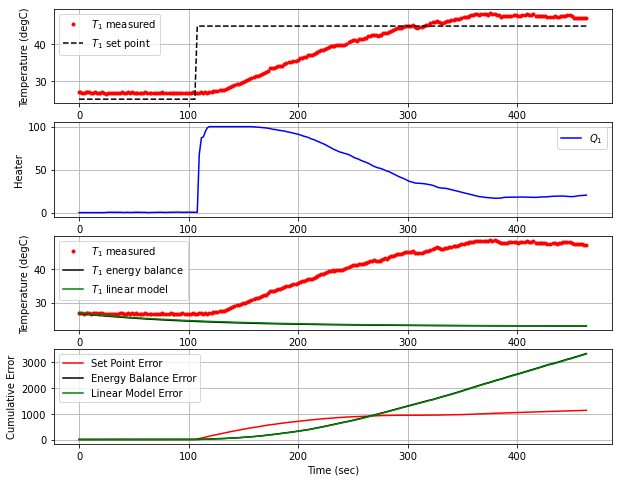

T1 NIH BOS  [47.59 47.64 47.84 47.89 48.04 47.9  47.73 47.3  47.23 47.24 47.22 47.24
 47.11 47.17 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 466.6  45.00  47.32   0.00  20.41


<Figure size 432x288 with 0 Axes>

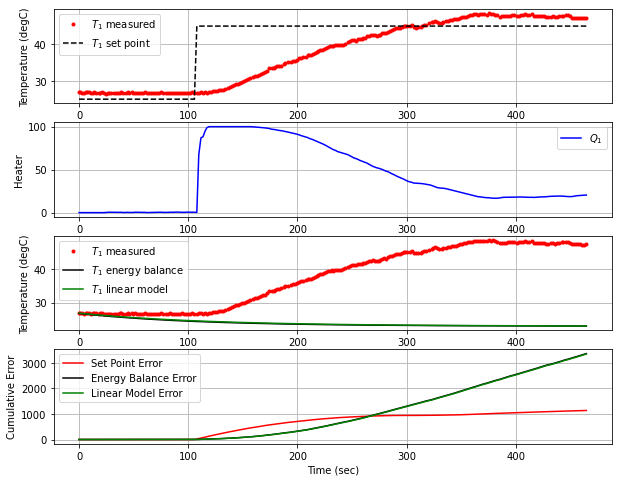

T1 NIH BOS  [47.64 47.84 47.89 48.04 47.9  47.73 47.3  47.23 47.24 47.22 47.24 47.11
 47.17 47.3  47.32]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 468.2  45.00  47.48   0.00  20.40


<Figure size 432x288 with 0 Axes>

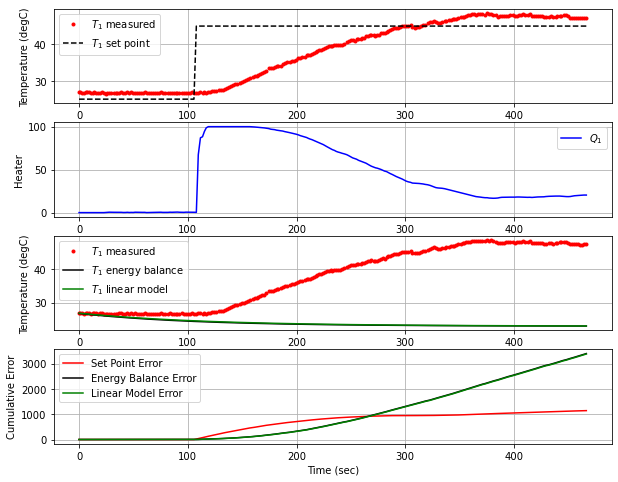

T1 NIH BOS  [47.84 47.89 48.04 47.9  47.73 47.3  47.23 47.24 47.22 47.24 47.11 47.17
 47.3  47.32 47.48]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 469.9  45.00  47.31   0.00  20.27


<Figure size 432x288 with 0 Axes>

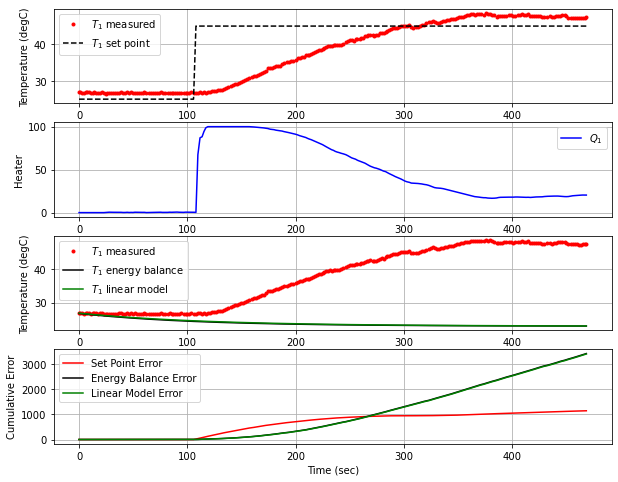

T1 NIH BOS  [47.89 48.04 47.9  47.73 47.3  47.23 47.24 47.22 47.24 47.11 47.17 47.3
 47.32 47.48 47.31]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 471.5  45.00  47.30   0.00  20.38


<Figure size 432x288 with 0 Axes>

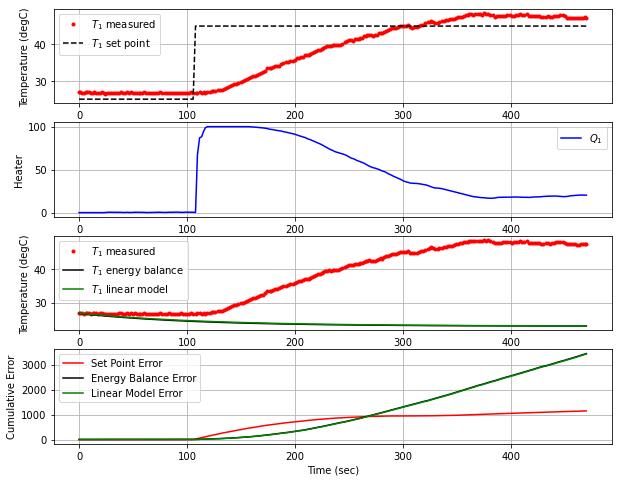

T1 NIH BOS  [48.04 47.9  47.73 47.3  47.23 47.24 47.22 47.24 47.11 47.17 47.3  47.32
 47.48 47.31 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 473.2  45.00  47.43   0.00  20.49


<Figure size 432x288 with 0 Axes>

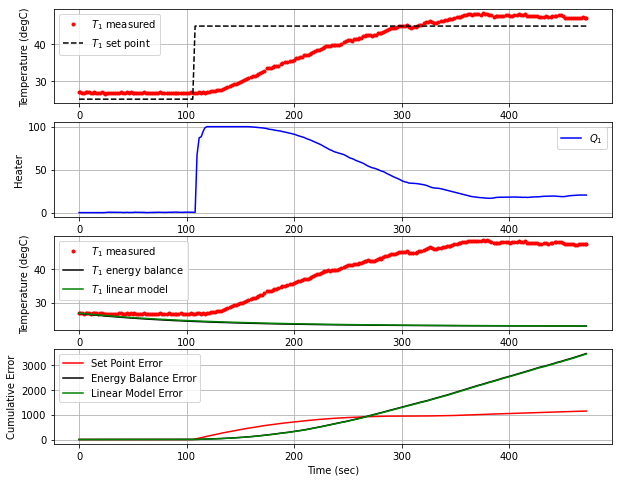

T1 NIH BOS  [47.9  47.73 47.3  47.23 47.24 47.22 47.24 47.11 47.17 47.3  47.32 47.48
 47.31 47.3  47.43]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 474.8  45.00  47.44   0.00  20.46


<Figure size 432x288 with 0 Axes>

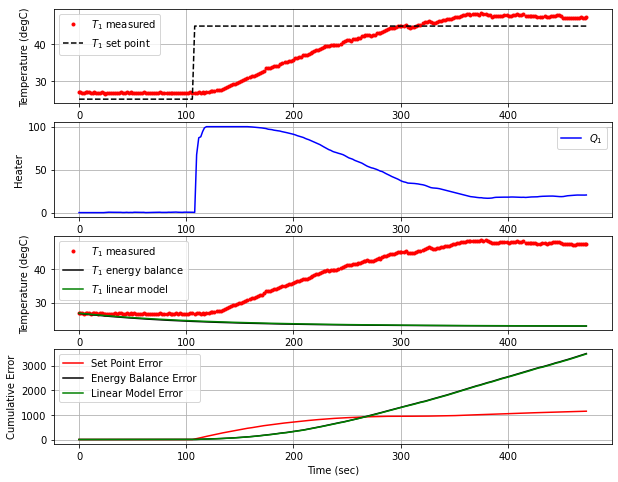

T1 NIH BOS  [47.73 47.3  47.23 47.24 47.22 47.24 47.11 47.17 47.3  47.32 47.48 47.31
 47.3  47.43 47.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 476.5  45.00  47.51   0.00  20.42


<Figure size 432x288 with 0 Axes>

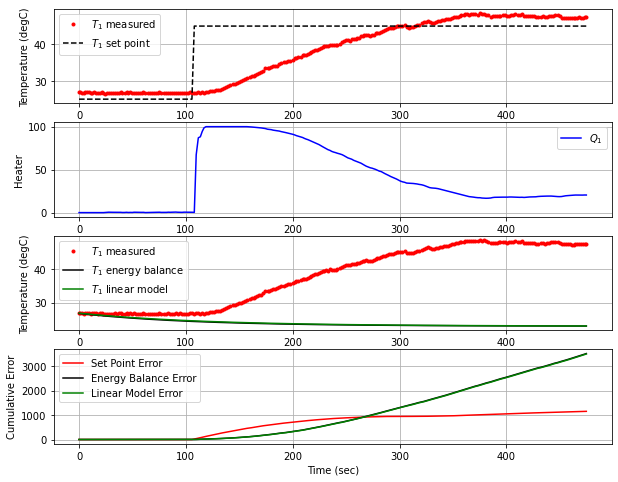

T1 NIH BOS  [47.3  47.23 47.24 47.22 47.24 47.11 47.17 47.3  47.32 47.48 47.31 47.3
 47.43 47.44 47.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 478.4  45.00  47.60   0.00  20.33


<Figure size 432x288 with 0 Axes>

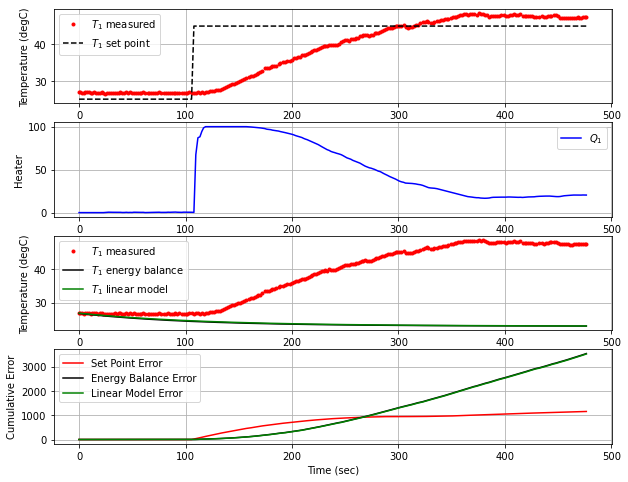

T1 NIH BOS  [47.23 47.24 47.22 47.24 47.11 47.17 47.3  47.32 47.48 47.31 47.3  47.43
 47.44 47.51 47.6 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 480.3  45.00  47.66   0.00  20.14


<Figure size 432x288 with 0 Axes>

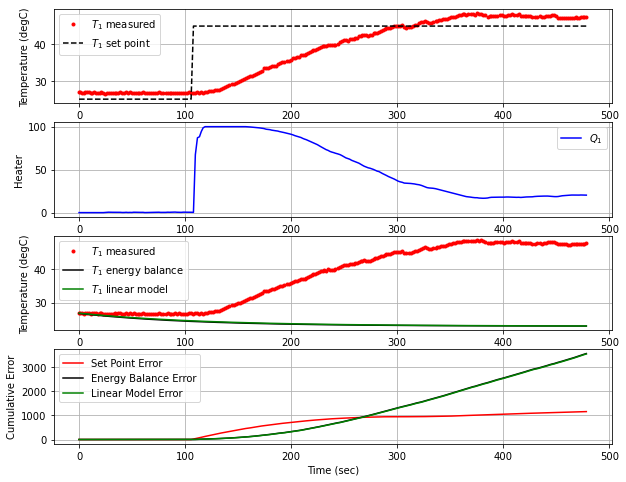

T1 NIH BOS  [47.24 47.22 47.24 47.11 47.17 47.3  47.32 47.48 47.31 47.3  47.43 47.44
 47.51 47.6  47.66]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 482.0  45.00  47.62   0.00  19.94


<Figure size 432x288 with 0 Axes>

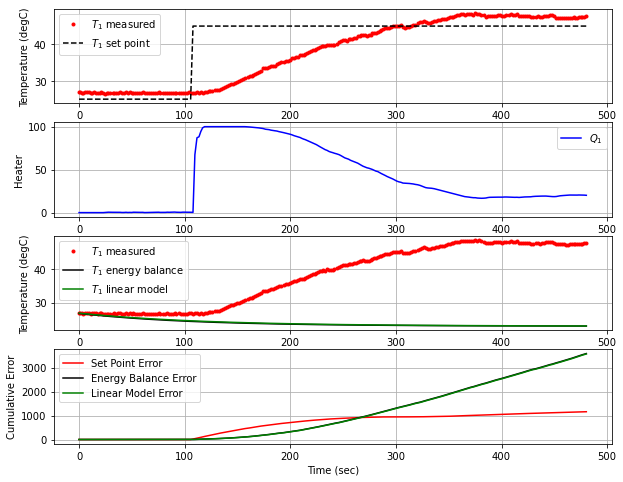

T1 NIH BOS  [47.22 47.24 47.11 47.17 47.3  47.32 47.48 47.31 47.3  47.43 47.44 47.51
 47.6  47.66 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 483.6  45.00  47.57   0.00  19.84


<Figure size 432x288 with 0 Axes>

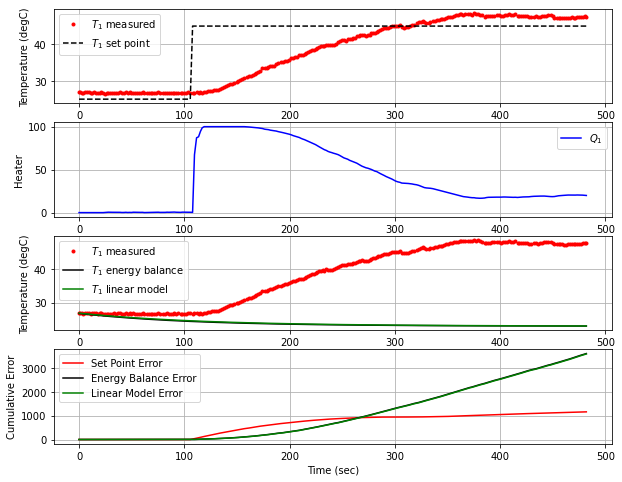

T1 NIH BOS  [47.24 47.11 47.17 47.3  47.32 47.48 47.31 47.3  47.43 47.44 47.51 47.6
 47.66 47.62 47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 485.3  45.00  47.38   0.00  19.80


<Figure size 432x288 with 0 Axes>

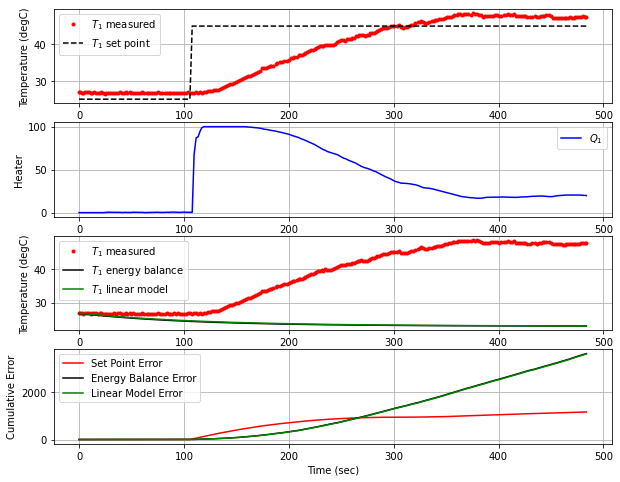

T1 NIH BOS  [47.11 47.17 47.3  47.32 47.48 47.31 47.3  47.43 47.44 47.51 47.6  47.66
 47.62 47.57 47.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 487.0  45.00  47.36   0.00  19.94


<Figure size 432x288 with 0 Axes>

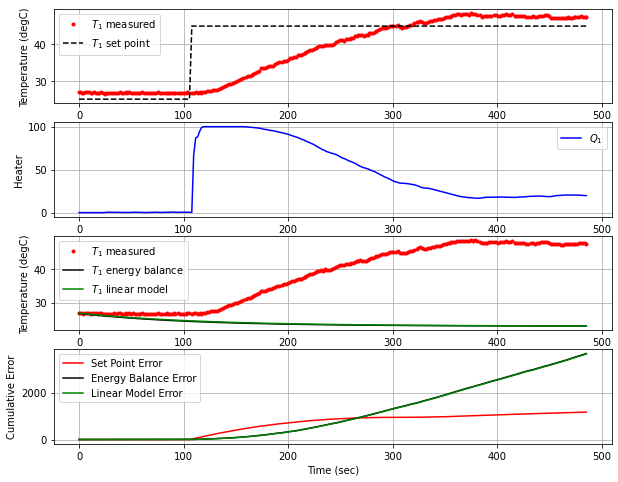

T1 NIH BOS  [47.17 47.3  47.32 47.48 47.31 47.3  47.43 47.44 47.51 47.6  47.66 47.62
 47.57 47.38 47.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 488.9  45.00  47.47   0.00  20.03


<Figure size 432x288 with 0 Axes>

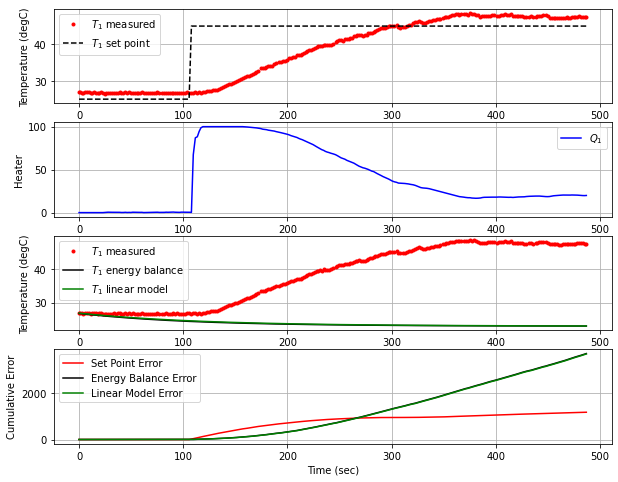

T1 NIH BOS  [47.3  47.32 47.48 47.31 47.3  47.43 47.44 47.51 47.6  47.66 47.62 47.57
 47.38 47.36 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 490.8  45.00  47.31   0.00  19.96


<Figure size 432x288 with 0 Axes>

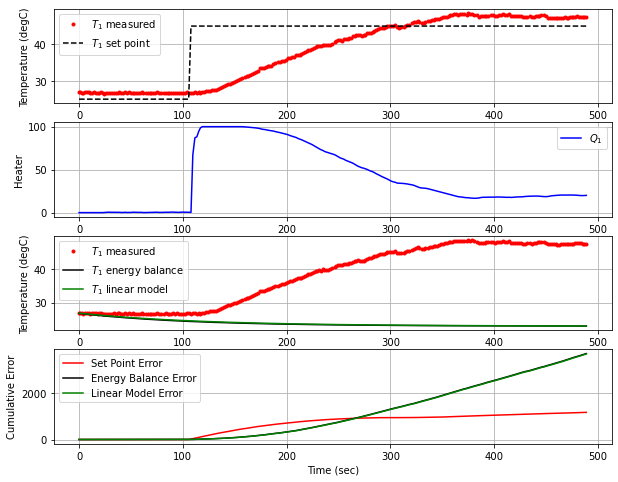

T1 NIH BOS  [47.32 47.48 47.31 47.3  47.43 47.44 47.51 47.6  47.66 47.62 47.57 47.38
 47.36 47.47 47.31]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 492.7  45.00  47.18   0.00  20.07


<Figure size 432x288 with 0 Axes>

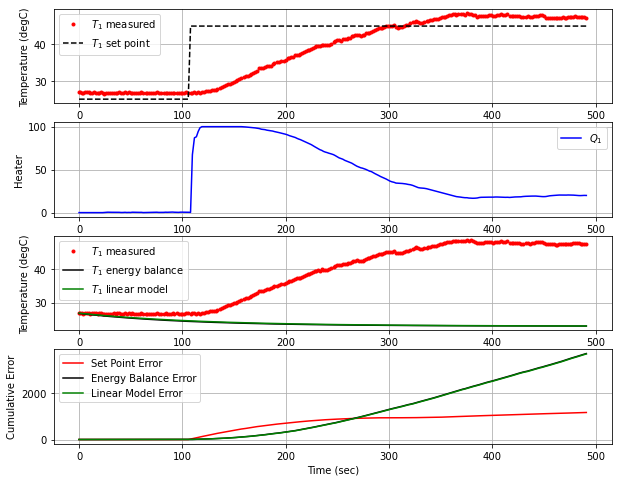

T1 NIH BOS  [47.48 47.31 47.3  47.43 47.44 47.51 47.6  47.66 47.62 47.57 47.38 47.36
 47.47 47.31 47.18]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 494.9  45.00  47.45   0.00  20.28


<Figure size 432x288 with 0 Axes>

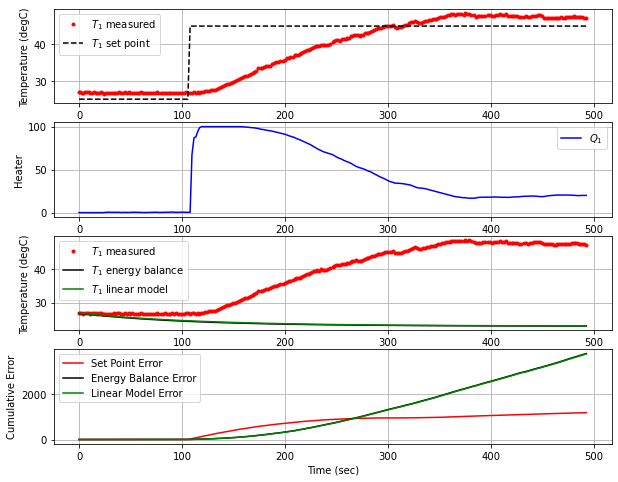

T1 NIH BOS  [47.31 47.3  47.43 47.44 47.51 47.6  47.66 47.62 47.57 47.38 47.36 47.47
 47.31 47.18 47.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 496.9  45.00  47.70   0.00  20.18


<Figure size 432x288 with 0 Axes>

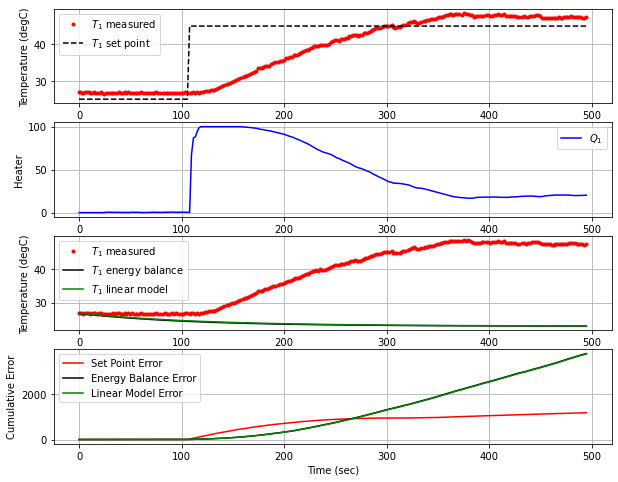

T1 NIH BOS  [47.3  47.43 47.44 47.51 47.6  47.66 47.62 47.57 47.38 47.36 47.47 47.31
 47.18 47.45 47.7 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 498.7  45.00  47.49   0.00  19.86


<Figure size 432x288 with 0 Axes>

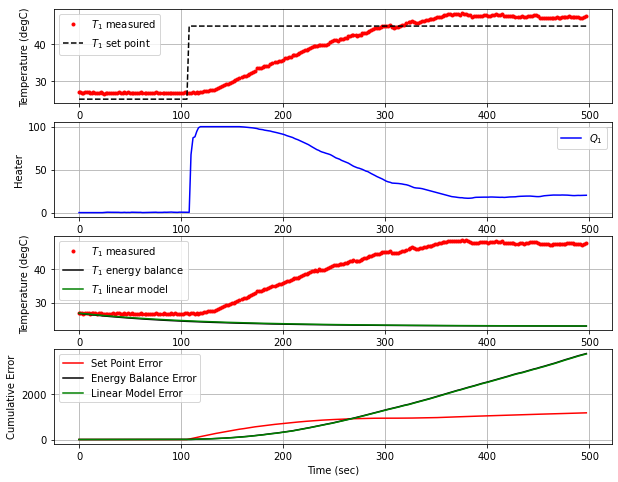

T1 NIH BOS  [47.43 47.44 47.51 47.6  47.66 47.62 47.57 47.38 47.36 47.47 47.31 47.18
 47.45 47.7  47.49]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 500.3  45.00  47.53   0.00  19.84


<Figure size 432x288 with 0 Axes>

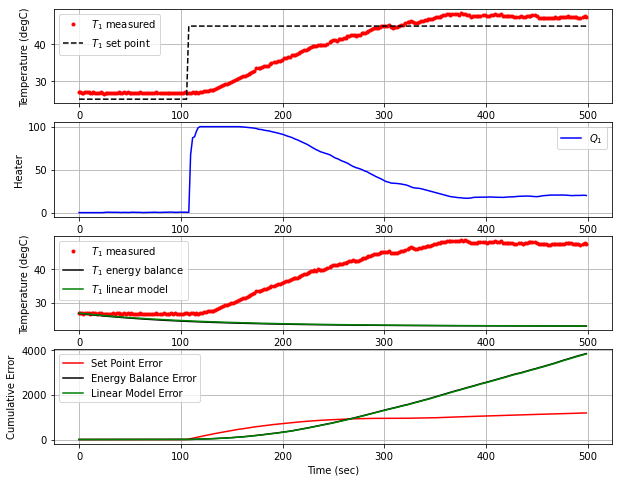

T1 NIH BOS  [47.44 47.51 47.6  47.66 47.62 47.57 47.38 47.36 47.47 47.31 47.18 47.45
 47.7  47.49 47.53]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 34ms/step
 502.2  45.00  47.29   0.00  19.83


<Figure size 432x288 with 0 Axes>

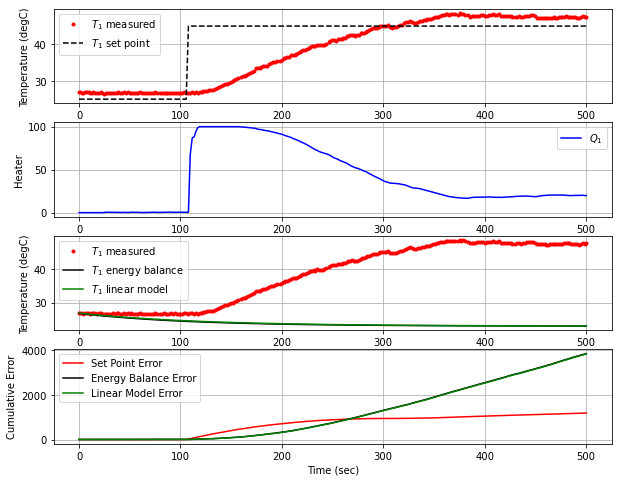

T1 NIH BOS  [47.51 47.6  47.66 47.62 47.57 47.38 47.36 47.47 47.31 47.18 47.45 47.7
 47.49 47.53 47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 504.0  45.00  47.30   0.00  20.04


<Figure size 432x288 with 0 Axes>

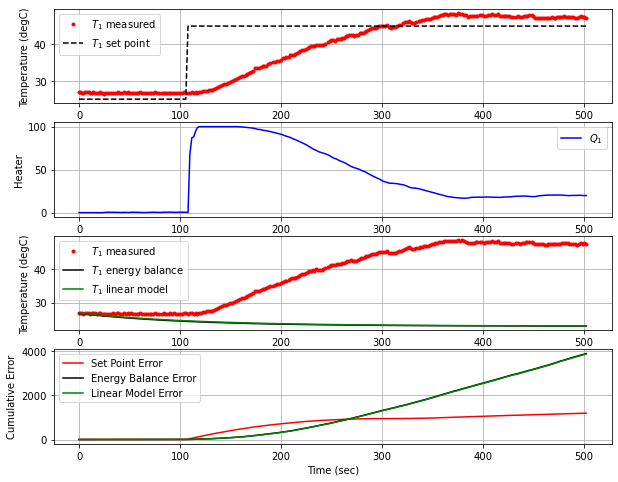

T1 NIH BOS  [47.6  47.66 47.62 47.57 47.38 47.36 47.47 47.31 47.18 47.45 47.7  47.49
 47.53 47.29 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 505.8  45.00  47.10   0.00  20.18


<Figure size 432x288 with 0 Axes>

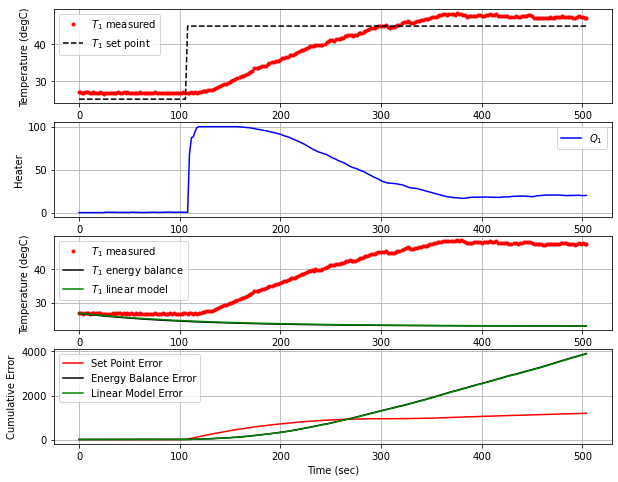

T1 NIH BOS  [47.66 47.62 47.57 47.38 47.36 47.47 47.31 47.18 47.45 47.7  47.49 47.53
 47.29 47.3  47.1 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 507.6  45.00  47.47   0.00  20.46


<Figure size 432x288 with 0 Axes>

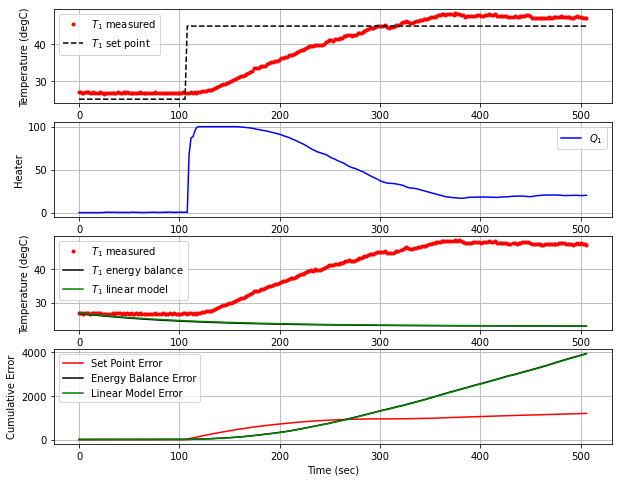

T1 NIH BOS  [47.62 47.57 47.38 47.36 47.47 47.31 47.18 47.45 47.7  47.49 47.53 47.29
 47.3  47.1  47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 509.4  45.00  47.34   0.00  20.31


<Figure size 432x288 with 0 Axes>

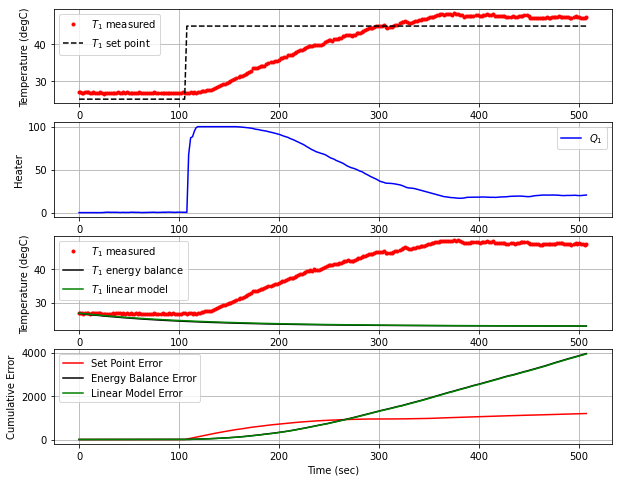

T1 NIH BOS  [47.57 47.38 47.36 47.47 47.31 47.18 47.45 47.7  47.49 47.53 47.29 47.3
 47.1  47.47 47.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 511.6  45.00  47.34   0.00  20.32


<Figure size 432x288 with 0 Axes>

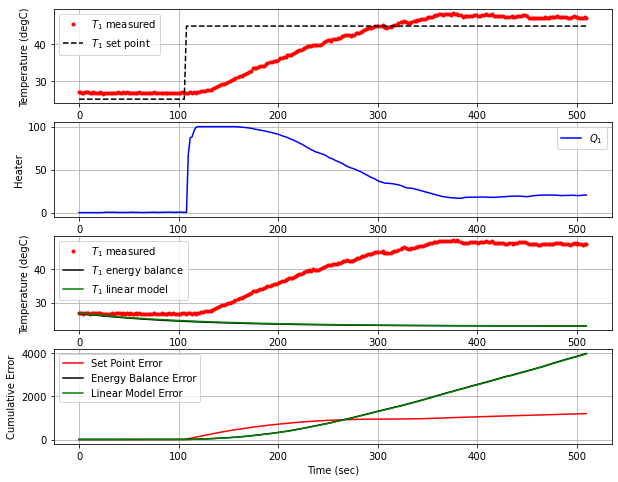

T1 NIH BOS  [47.38 47.36 47.47 47.31 47.18 47.45 47.7  47.49 47.53 47.29 47.3  47.1
 47.47 47.34 47.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 513.4  45.00  47.22   0.00  20.37


<Figure size 432x288 with 0 Axes>

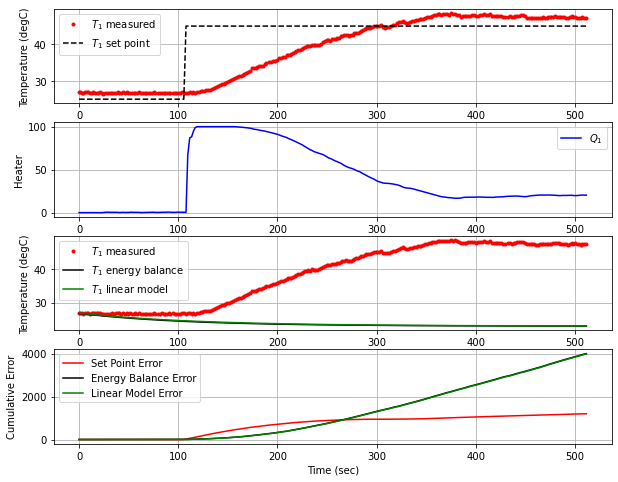

T1 NIH BOS  [47.36 47.47 47.31 47.18 47.45 47.7  47.49 47.53 47.29 47.3  47.1  47.47
 47.34 47.34 47.22]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 515.4  45.00  47.42   0.00  20.50


<Figure size 432x288 with 0 Axes>

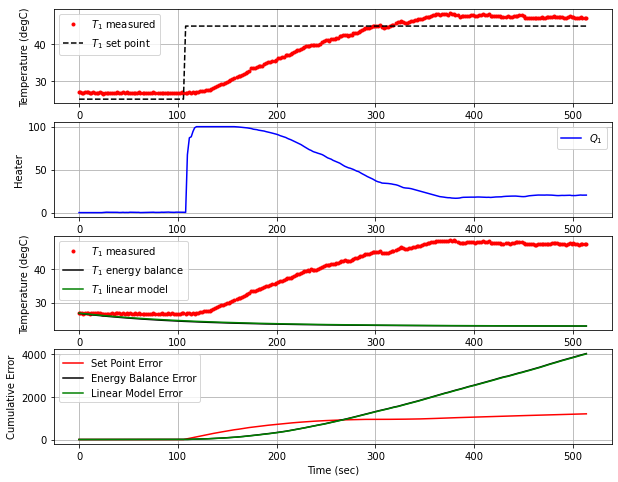

T1 NIH BOS  [47.47 47.31 47.18 47.45 47.7  47.49 47.53 47.29 47.3  47.1  47.47 47.34
 47.34 47.22 47.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 517.2  45.00  47.34   0.00  20.41


<Figure size 432x288 with 0 Axes>

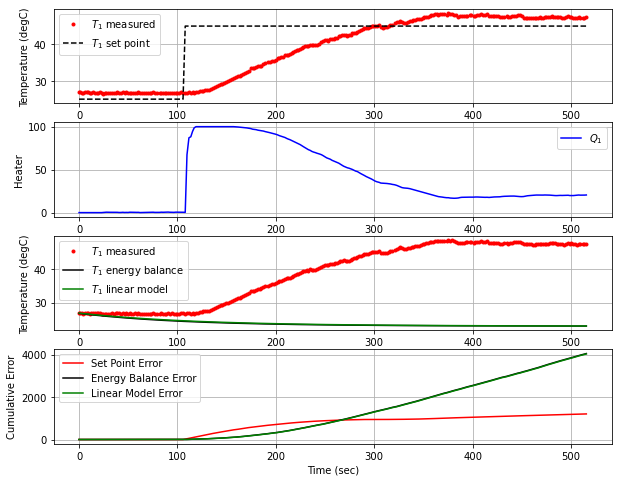

T1 NIH BOS  [47.31 47.18 47.45 47.7  47.49 47.53 47.29 47.3  47.1  47.47 47.34 47.34
 47.22 47.42 47.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 519.0  45.00  47.52   0.00  20.42


<Figure size 432x288 with 0 Axes>

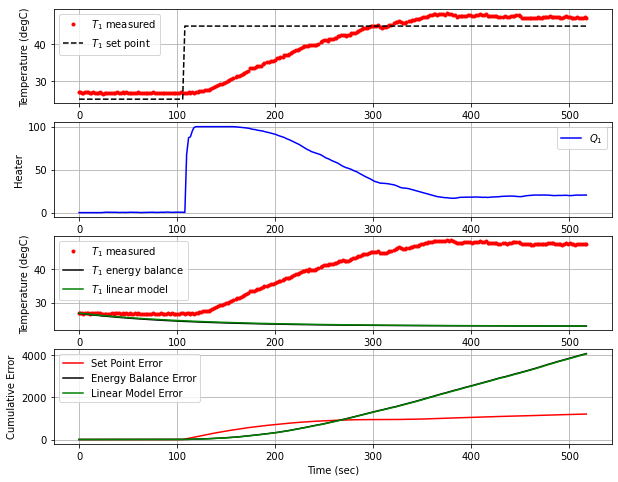

T1 NIH BOS  [47.18 47.45 47.7  47.49 47.53 47.29 47.3  47.1  47.47 47.34 47.34 47.22
 47.42 47.34 47.52]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 520.8  45.00  47.38   0.00  20.26


<Figure size 432x288 with 0 Axes>

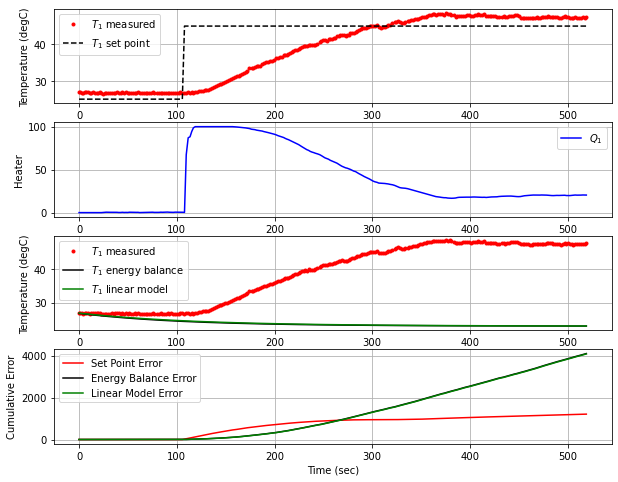

T1 NIH BOS  [47.45 47.7  47.49 47.53 47.29 47.3  47.1  47.47 47.34 47.34 47.22 47.42
 47.34 47.52 47.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 522.7  45.00  47.51   0.00  20.26


<Figure size 432x288 with 0 Axes>

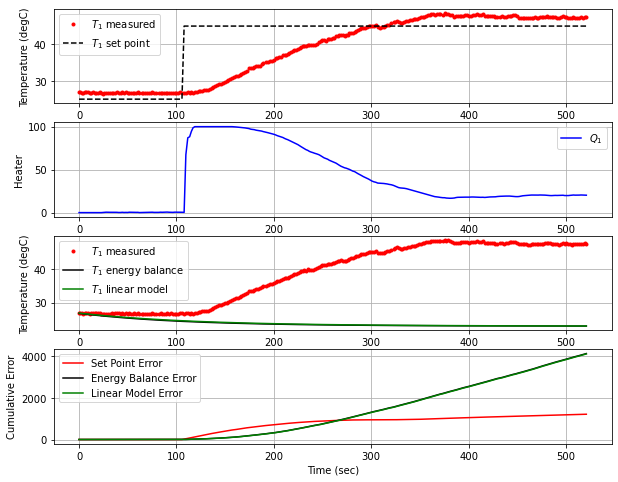

T1 NIH BOS  [47.7  47.49 47.53 47.29 47.3  47.1  47.47 47.34 47.34 47.22 47.42 47.34
 47.52 47.38 47.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 524.6  45.00  47.61   0.00  20.17


<Figure size 432x288 with 0 Axes>

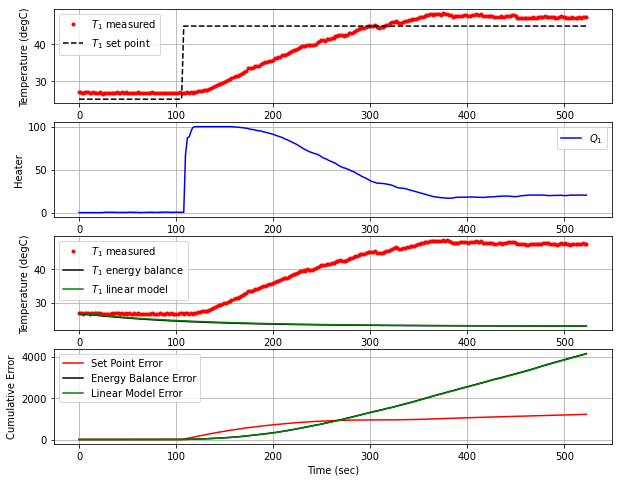

T1 NIH BOS  [47.49 47.53 47.29 47.3  47.1  47.47 47.34 47.34 47.22 47.42 47.34 47.52
 47.38 47.51 47.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 59ms/step
 526.6  45.00  47.61   0.00  20.02


<Figure size 432x288 with 0 Axes>

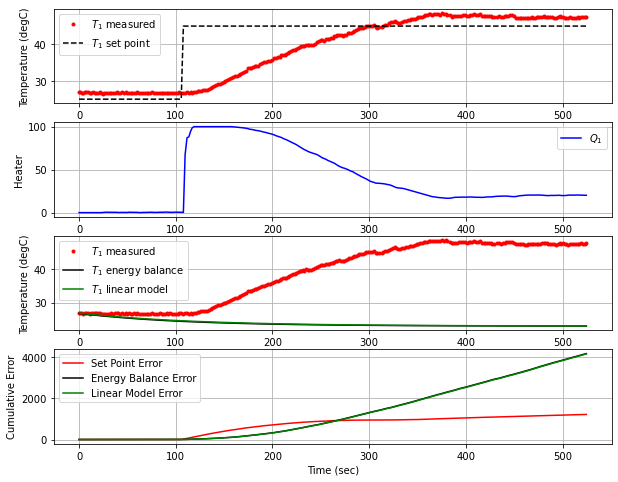

T1 NIH BOS  [47.53 47.29 47.3  47.1  47.47 47.34 47.34 47.22 47.42 47.34 47.52 47.38
 47.51 47.61 47.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 51ms/step
 529.0  45.00  47.57   0.00  19.90


<Figure size 432x288 with 0 Axes>

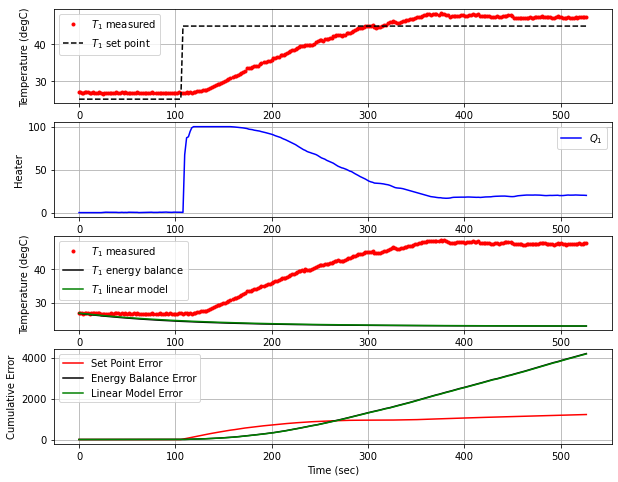

T1 NIH BOS  [47.29 47.3  47.1  47.47 47.34 47.34 47.22 47.42 47.34 47.52 47.38 47.51
 47.61 47.61 47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 531.6  45.00  47.61   0.00  19.86


<Figure size 432x288 with 0 Axes>

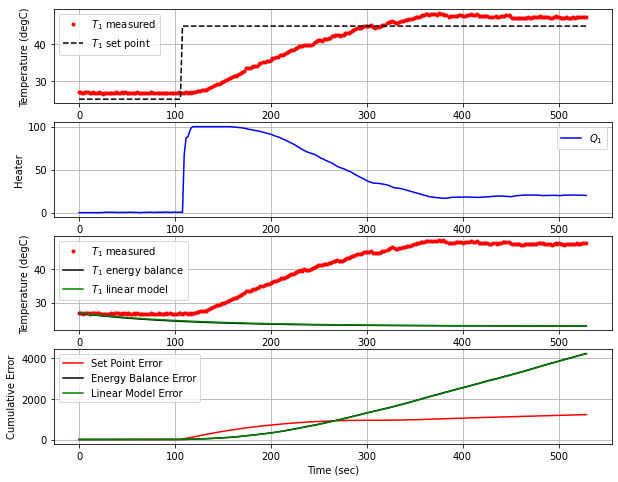

T1 NIH BOS  [47.3  47.1  47.47 47.34 47.34 47.22 47.42 47.34 47.52 47.38 47.51 47.61
 47.61 47.57 47.61]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 533.3  45.00  47.67   0.00  19.77


<Figure size 432x288 with 0 Axes>

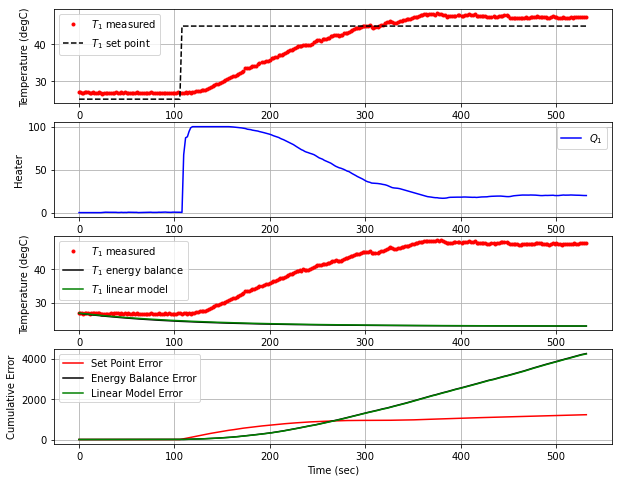

T1 NIH BOS  [47.1  47.47 47.34 47.34 47.22 47.42 47.34 47.52 47.38 47.51 47.61 47.61
 47.57 47.61 47.67]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 535.0  45.00  47.78   0.00  19.64


<Figure size 432x288 with 0 Axes>

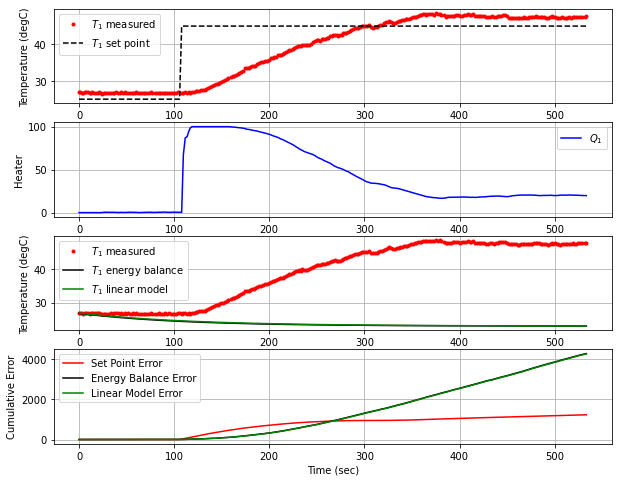

T1 NIH BOS  [47.47 47.34 47.34 47.22 47.42 47.34 47.52 47.38 47.51 47.61 47.61 47.57
 47.61 47.67 47.78]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 536.8  45.00  47.64   0.00  19.41


<Figure size 432x288 with 0 Axes>

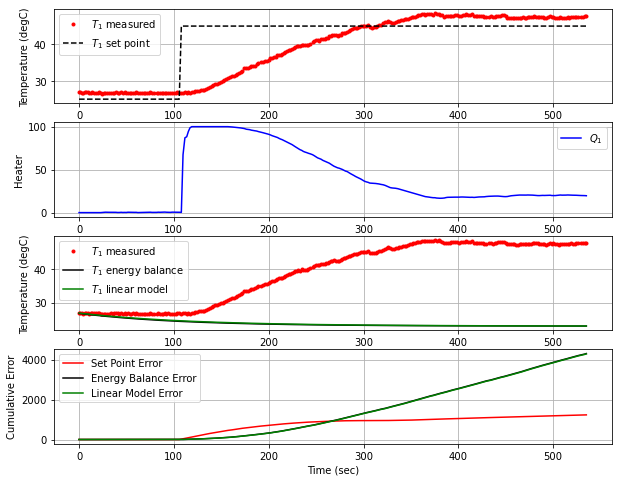

T1 NIH BOS  [47.34 47.34 47.22 47.42 47.34 47.52 47.38 47.51 47.61 47.61 47.57 47.61
 47.67 47.78 47.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 538.5  45.00  47.79   0.00  19.40


<Figure size 432x288 with 0 Axes>

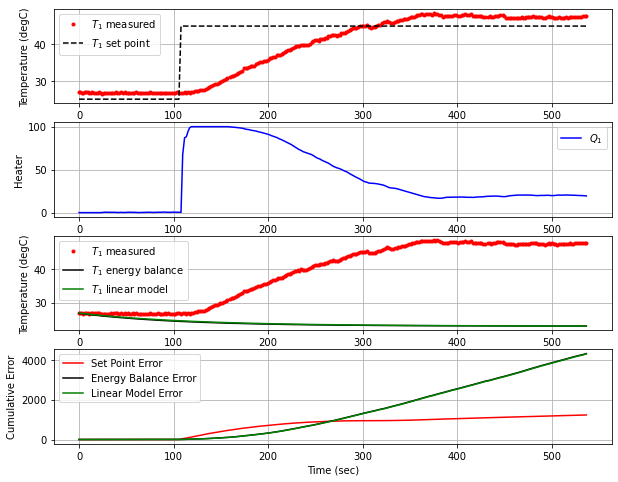

T1 NIH BOS  [47.34 47.22 47.42 47.34 47.52 47.38 47.51 47.61 47.61 47.57 47.61 47.67
 47.78 47.64 47.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 540.2  45.00  47.65   0.00  19.24


<Figure size 432x288 with 0 Axes>

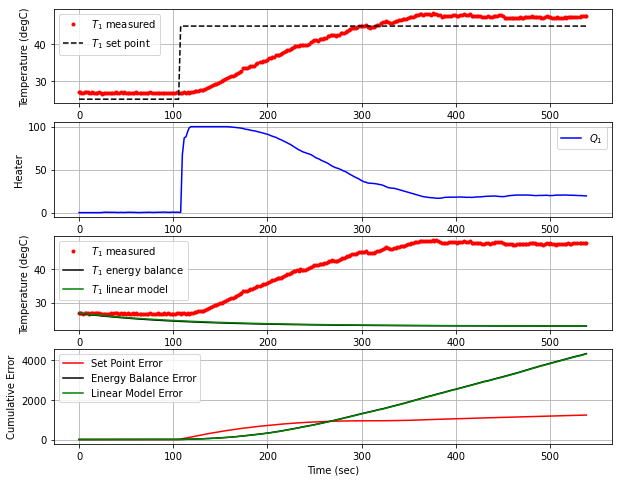

T1 NIH BOS  [47.22 47.42 47.34 47.52 47.38 47.51 47.61 47.61 47.57 47.61 47.67 47.78
 47.64 47.79 47.65]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 47ms/step
 542.3  45.00  47.62   0.00  19.23


<Figure size 432x288 with 0 Axes>

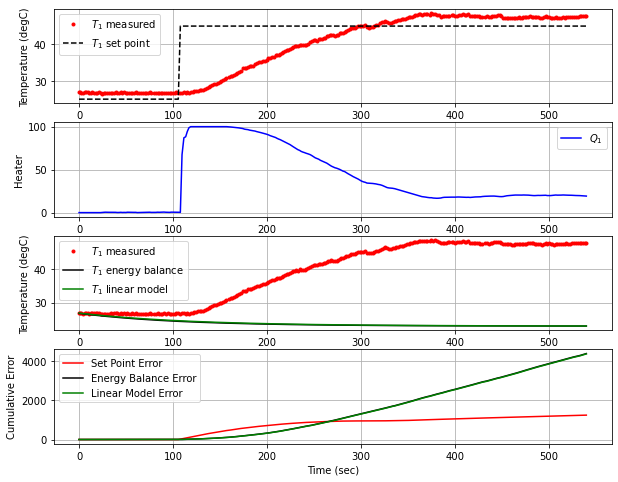

T1 NIH BOS  [47.42 47.34 47.52 47.38 47.51 47.61 47.61 47.57 47.61 47.67 47.78 47.64
 47.79 47.65 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 544.3  45.00  47.82   0.00  19.25


<Figure size 432x288 with 0 Axes>

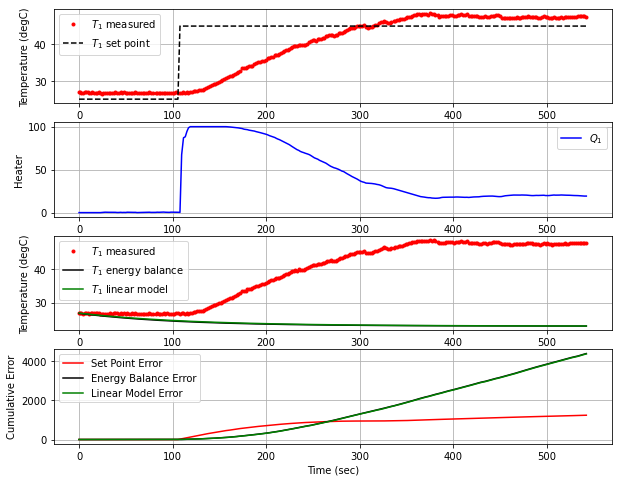

T1 NIH BOS  [47.34 47.52 47.38 47.51 47.61 47.61 47.57 47.61 47.67 47.78 47.64 47.79
 47.65 47.62 47.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 546.2  45.00  47.62   0.00  19.06


<Figure size 432x288 with 0 Axes>

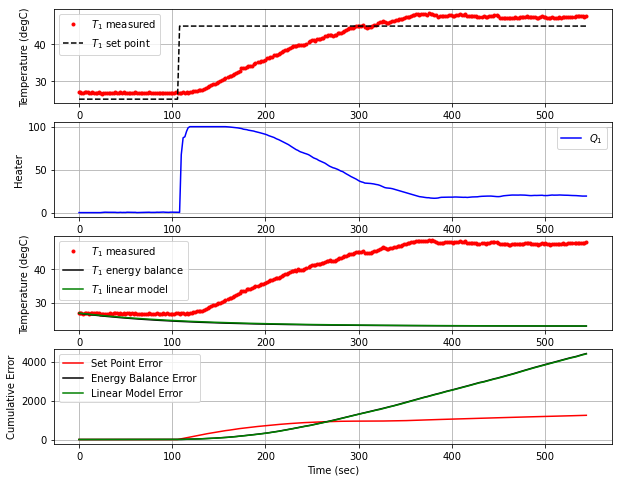

T1 NIH BOS  [47.52 47.38 47.51 47.61 47.61 47.57 47.61 47.67 47.78 47.64 47.79 47.65
 47.62 47.82 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 548.0  45.00  47.79   0.00  19.10


<Figure size 432x288 with 0 Axes>

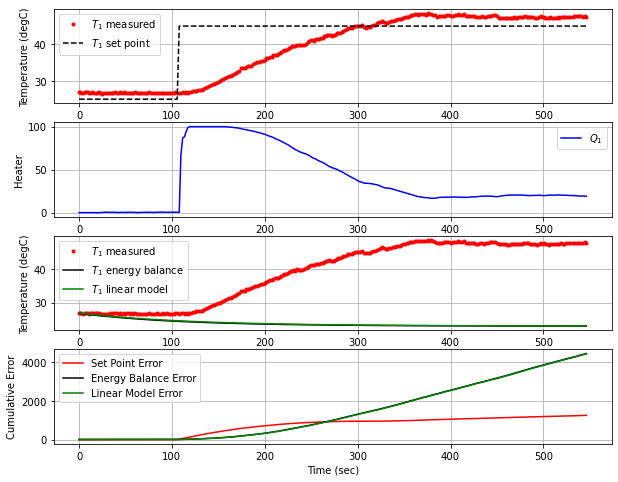

T1 NIH BOS  [47.38 47.51 47.61 47.61 47.57 47.61 47.67 47.78 47.64 47.79 47.65 47.62
 47.82 47.62 47.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 549.7  45.00  47.95   0.00  18.99


<Figure size 432x288 with 0 Axes>

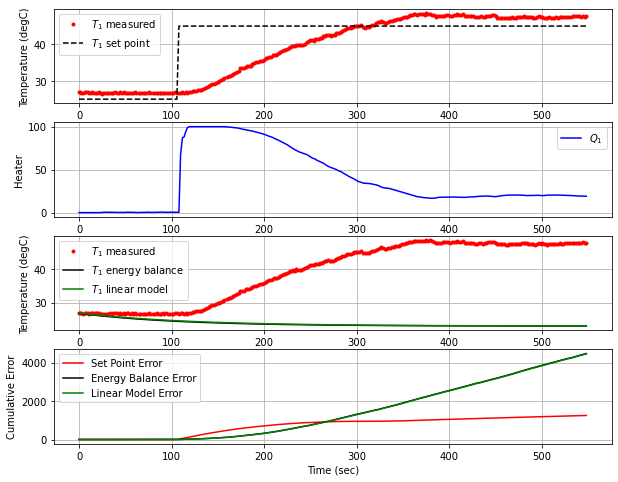

T1 NIH BOS  [47.51 47.61 47.61 47.57 47.61 47.67 47.78 47.64 47.79 47.65 47.62 47.82
 47.62 47.79 47.95]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 54ms/step
 551.7  45.00  48.00   0.00  18.73


<Figure size 432x288 with 0 Axes>

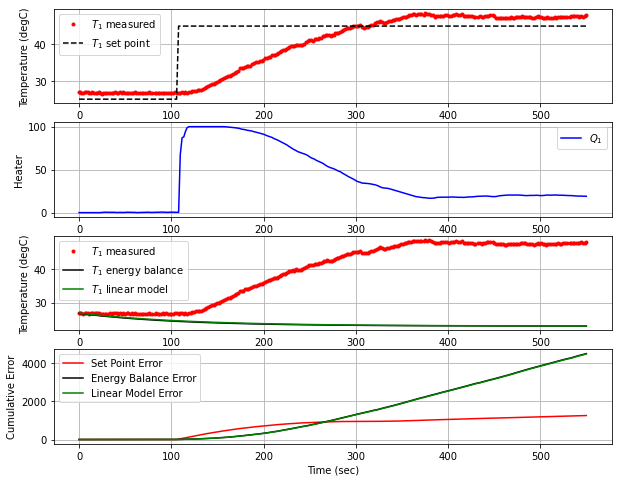

T1 NIH BOS  [47.61 47.61 47.57 47.61 47.67 47.78 47.64 47.79 47.65 47.62 47.82 47.62
 47.79 47.95 48.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 55ms/step
 554.0  45.00  47.97   0.00  18.50


<Figure size 432x288 with 0 Axes>

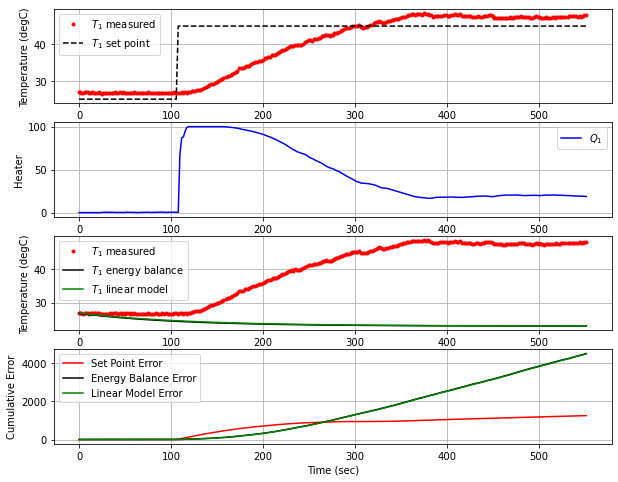

T1 NIH BOS  [47.61 47.57 47.61 47.67 47.78 47.64 47.79 47.65 47.62 47.82 47.62 47.79
 47.95 48.   47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 556.3  45.00  47.47   0.00  18.39


<Figure size 432x288 with 0 Axes>

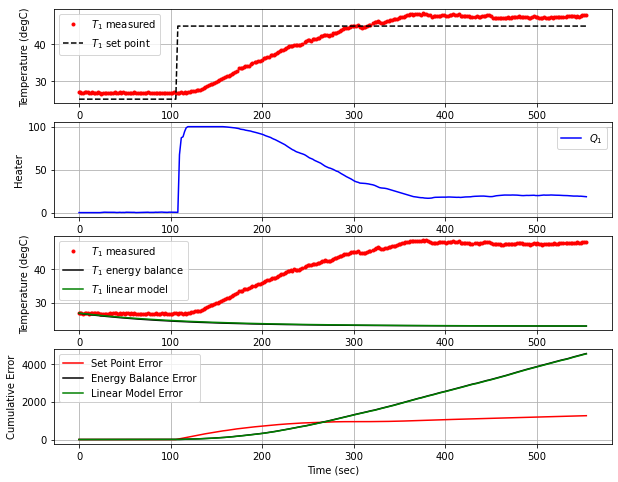

T1 NIH BOS  [47.57 47.61 47.67 47.78 47.64 47.79 47.65 47.62 47.82 47.62 47.79 47.95
 48.   47.97 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 53ms/step
 558.4  45.00  47.54   0.00  18.78


<Figure size 432x288 with 0 Axes>

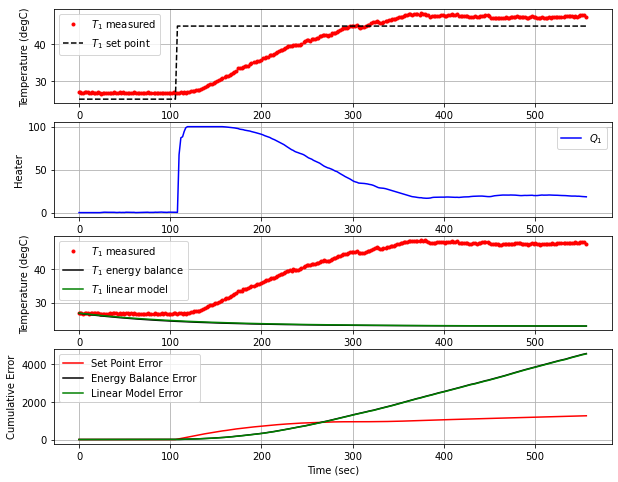

T1 NIH BOS  [47.61 47.67 47.78 47.64 47.79 47.65 47.62 47.82 47.62 47.79 47.95 48.
 47.97 47.47 47.54]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 47ms/step
 560.7  45.00  47.82   0.00  18.98


<Figure size 432x288 with 0 Axes>

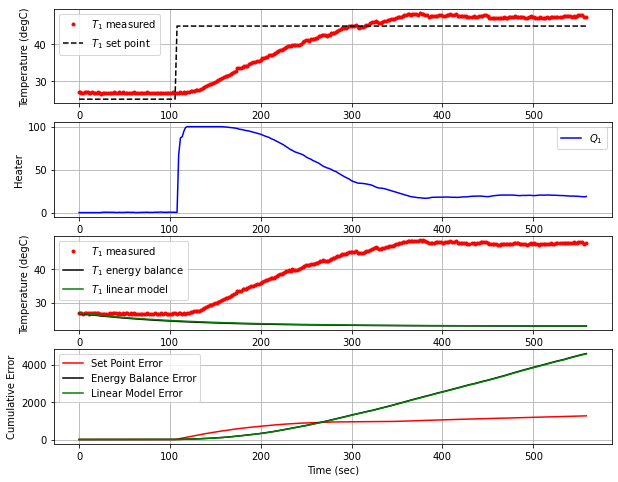

T1 NIH BOS  [47.67 47.78 47.64 47.79 47.65 47.62 47.82 47.62 47.79 47.95 48.   47.97
 47.47 47.54 47.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 562.5  45.00  47.74   0.00  18.81


<Figure size 432x288 with 0 Axes>

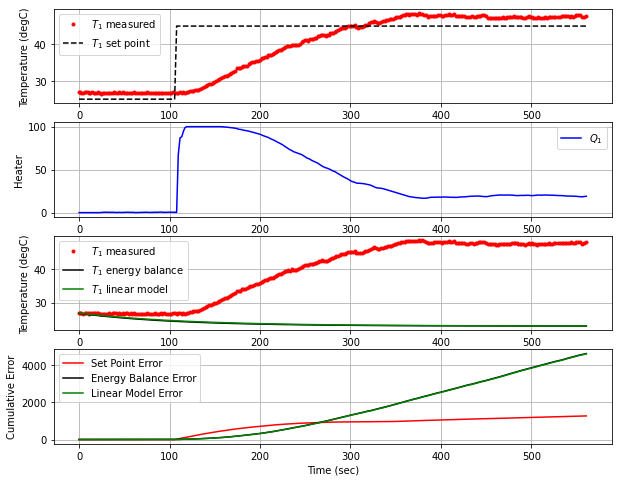

T1 NIH BOS  [47.78 47.64 47.79 47.65 47.62 47.82 47.62 47.79 47.95 48.   47.97 47.47
 47.54 47.82 47.74]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 564.2  45.00  47.55   0.00  18.76


<Figure size 432x288 with 0 Axes>

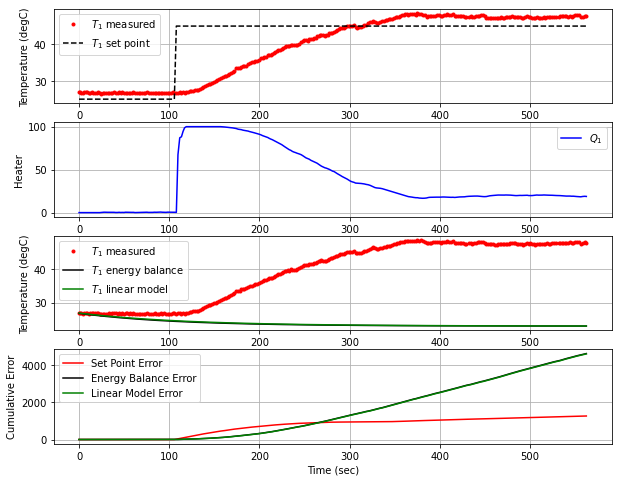

T1 NIH BOS  [47.64 47.79 47.65 47.62 47.82 47.62 47.79 47.95 48.   47.97 47.47 47.54
 47.82 47.74 47.55]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 566.0  45.00  47.44   0.00  18.94


<Figure size 432x288 with 0 Axes>

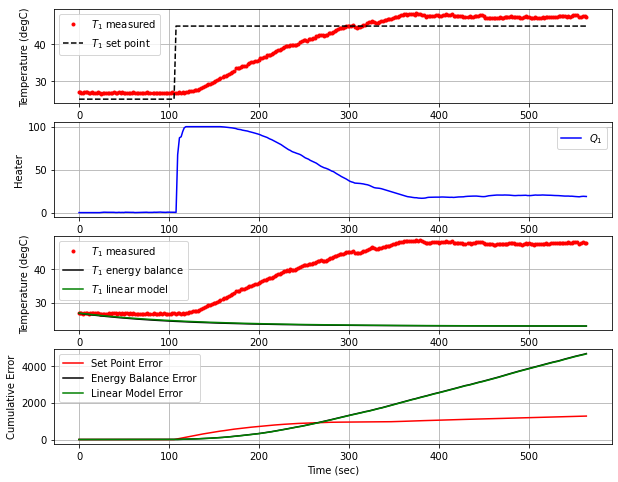

T1 NIH BOS  [47.79 47.65 47.62 47.82 47.62 47.79 47.95 48.   47.97 47.47 47.54 47.82
 47.74 47.55 47.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 34ms/step
 567.9  45.00  47.27   0.00  19.17


<Figure size 432x288 with 0 Axes>

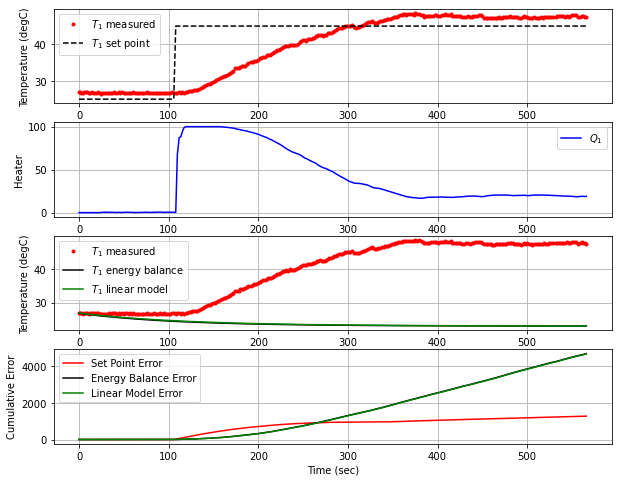

T1 NIH BOS  [47.65 47.62 47.82 47.62 47.79 47.95 48.   47.97 47.47 47.54 47.82 47.74
 47.55 47.44 47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 569.9  45.00  47.14   0.00  19.50


<Figure size 432x288 with 0 Axes>

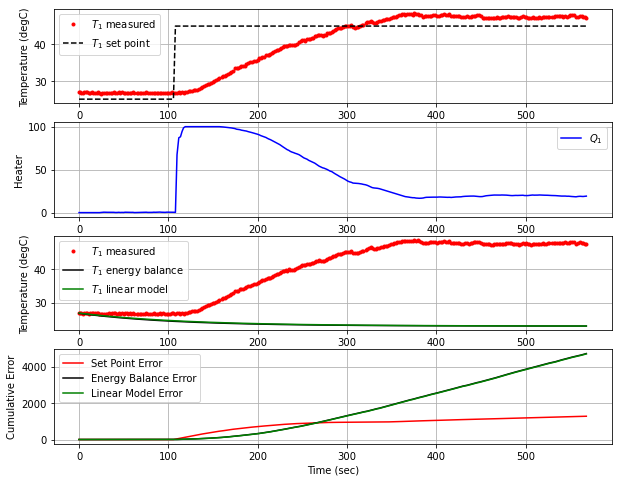

T1 NIH BOS  [47.62 47.82 47.62 47.79 47.95 48.   47.97 47.47 47.54 47.82 47.74 47.55
 47.44 47.27 47.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 102ms/step
 571.8  45.00  47.04   0.00  19.84


<Figure size 432x288 with 0 Axes>

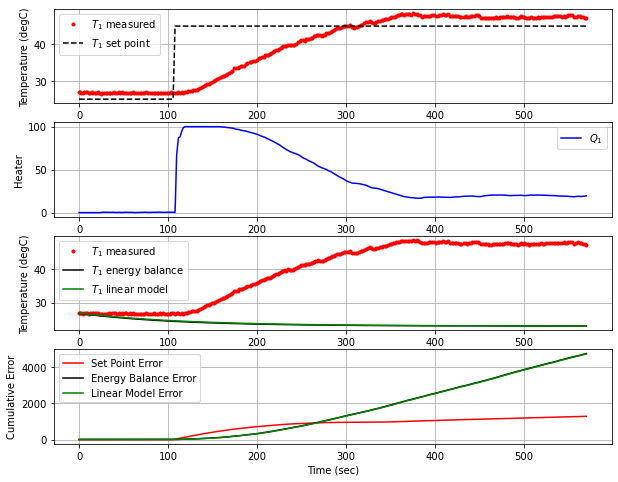

T1 NIH BOS  [47.82 47.62 47.79 47.95 48.   47.97 47.47 47.54 47.82 47.74 47.55 47.44
 47.27 47.14 47.04]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 573.6  45.00  47.06   0.00  20.17


<Figure size 432x288 with 0 Axes>

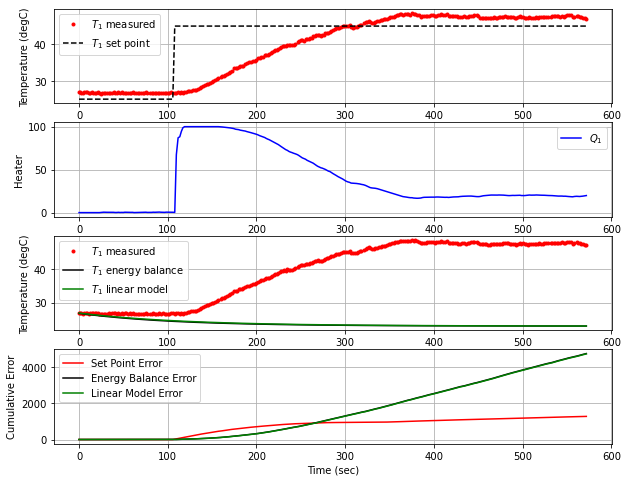

T1 NIH BOS  [47.62 47.79 47.95 48.   47.97 47.47 47.54 47.82 47.74 47.55 47.44 47.27
 47.14 47.04 47.06]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 575.7  45.00  47.13   0.00  20.42


<Figure size 432x288 with 0 Axes>

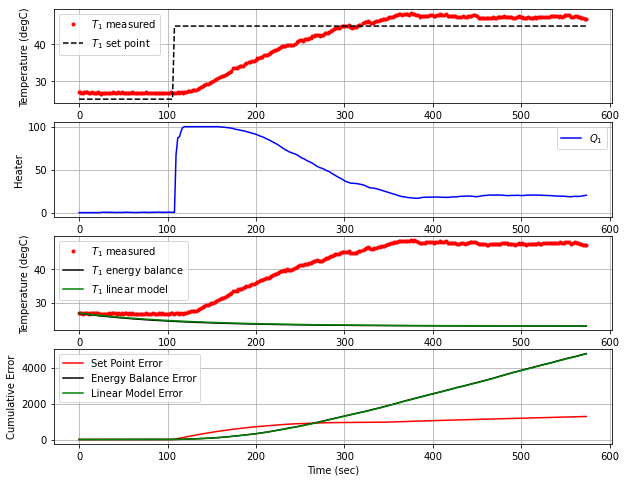

T1 NIH BOS  [47.79 47.95 48.   47.97 47.47 47.54 47.82 47.74 47.55 47.44 47.27 47.14
 47.04 47.06 47.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 577.5  45.00  47.14   0.00  20.53


<Figure size 432x288 with 0 Axes>

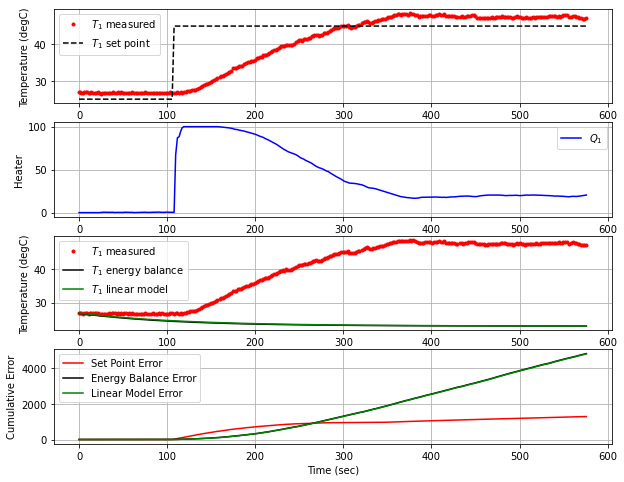

T1 NIH BOS  [47.95 48.   47.97 47.47 47.54 47.82 47.74 47.55 47.44 47.27 47.14 47.04
 47.06 47.13 47.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 579.3  45.00  47.30   0.00  20.64


<Figure size 432x288 with 0 Axes>

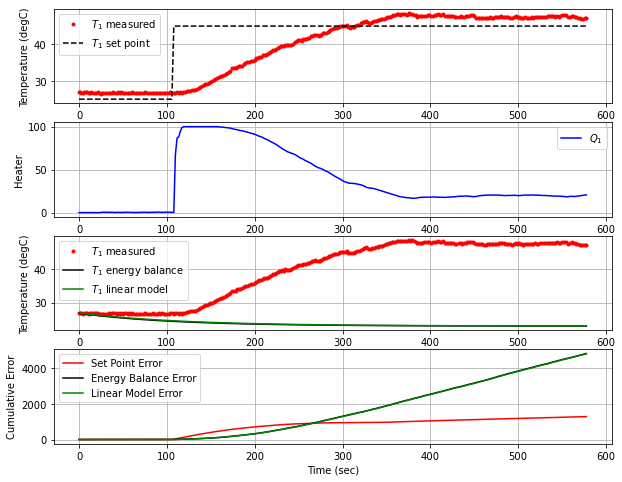

T1 NIH BOS  [48.   47.97 47.47 47.54 47.82 47.74 47.55 47.44 47.27 47.14 47.04 47.06
 47.13 47.14 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 581.1  45.00  47.39   0.00  20.62


<Figure size 432x288 with 0 Axes>

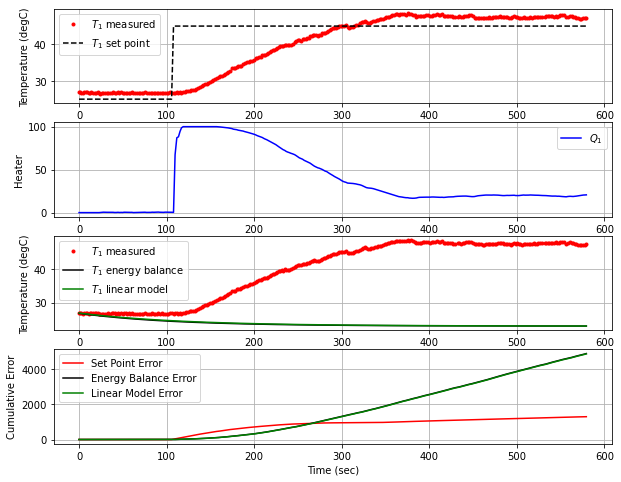

T1 NIH BOS  [47.97 47.47 47.54 47.82 47.74 47.55 47.44 47.27 47.14 47.04 47.06 47.13
 47.14 47.3  47.39]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 583.0  45.00  47.49   0.00  20.55


<Figure size 432x288 with 0 Axes>

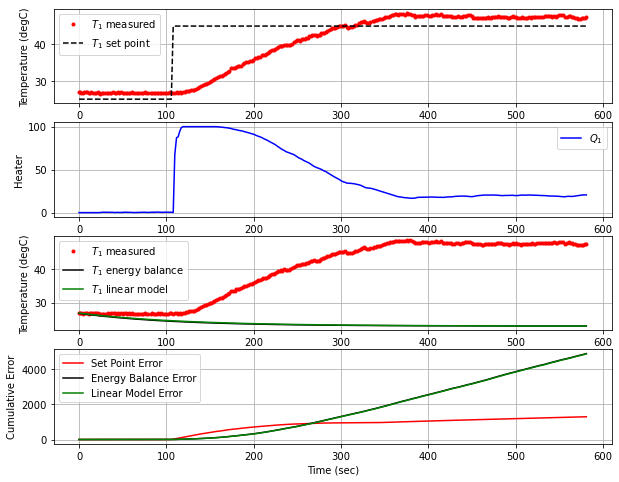

T1 NIH BOS  [47.47 47.54 47.82 47.74 47.55 47.44 47.27 47.14 47.04 47.06 47.13 47.14
 47.3  47.39 47.49]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 584.9  45.00  47.28   0.00  20.44


<Figure size 432x288 with 0 Axes>

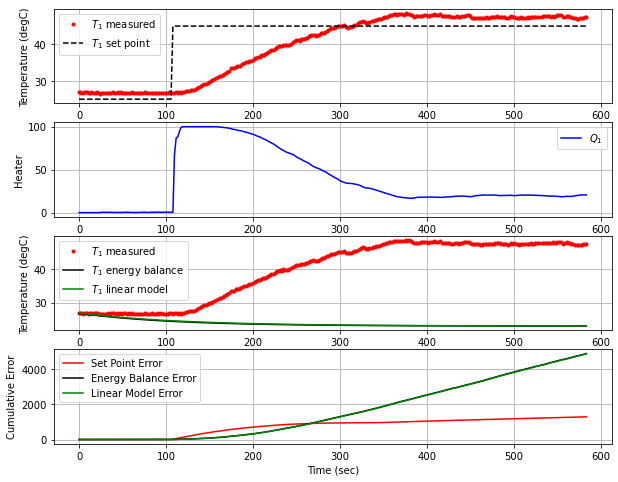

T1 NIH BOS  [47.54 47.82 47.74 47.55 47.44 47.27 47.14 47.04 47.06 47.13 47.14 47.3
 47.39 47.49 47.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 586.7  45.00  47.29   0.00  20.55


<Figure size 432x288 with 0 Axes>

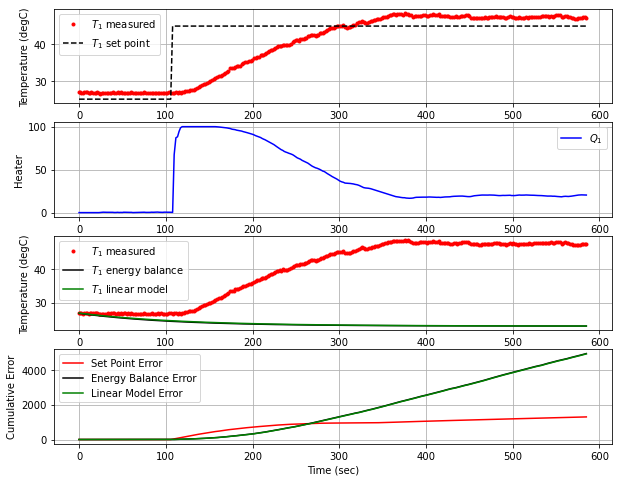

T1 NIH BOS  [47.82 47.74 47.55 47.44 47.27 47.14 47.04 47.06 47.13 47.14 47.3  47.39
 47.49 47.28 47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 588.4  45.00  47.03   0.00  20.62


<Figure size 432x288 with 0 Axes>

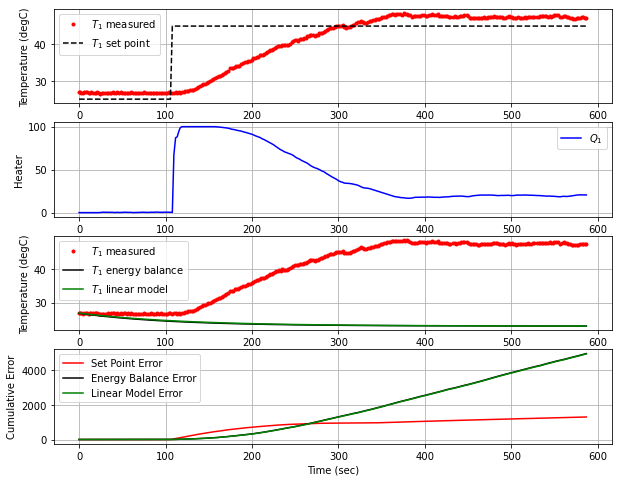

T1 NIH BOS  [47.74 47.55 47.44 47.27 47.14 47.04 47.06 47.13 47.14 47.3  47.39 47.49
 47.28 47.29 47.03]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 590.2  45.00  47.13   0.00  20.94


<Figure size 432x288 with 0 Axes>

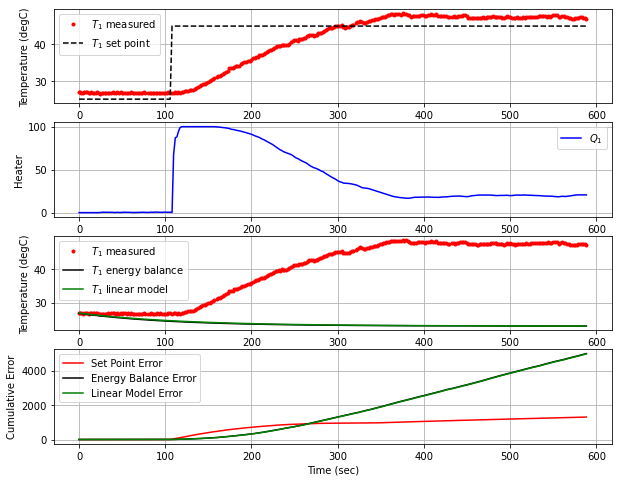

T1 NIH BOS  [47.55 47.44 47.27 47.14 47.04 47.06 47.13 47.14 47.3  47.39 47.49 47.28
 47.29 47.03 47.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 592.3  45.00  47.13   0.00  21.07


<Figure size 432x288 with 0 Axes>

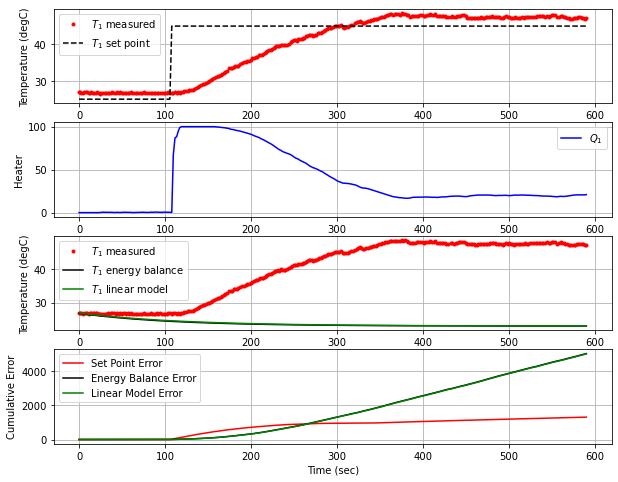

T1 NIH BOS  [47.44 47.27 47.14 47.04 47.06 47.13 47.14 47.3  47.39 47.49 47.28 47.29
 47.03 47.13 47.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 594.0  45.00  47.18   0.00  21.13


<Figure size 432x288 with 0 Axes>

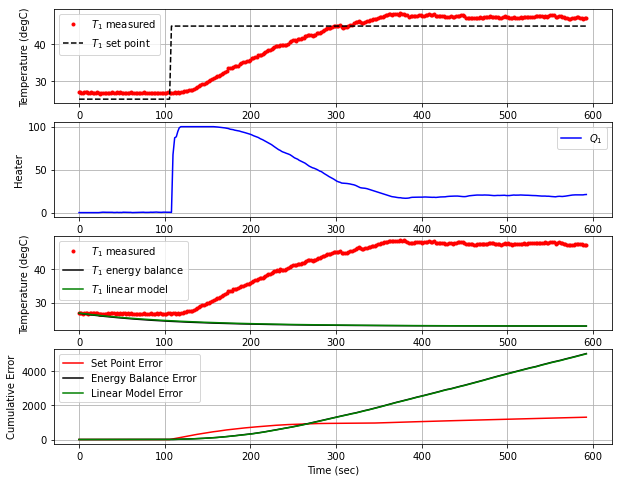

T1 NIH BOS  [47.27 47.14 47.04 47.06 47.13 47.14 47.3  47.39 47.49 47.28 47.29 47.03
 47.13 47.13 47.18]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 596.2  45.00  47.12   0.00  21.13


<Figure size 432x288 with 0 Axes>

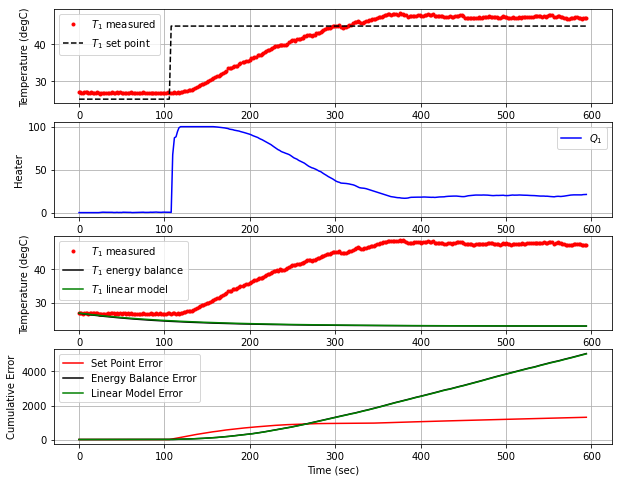

T1 NIH BOS  [47.14 47.04 47.06 47.13 47.14 47.3  47.39 47.49 47.28 47.29 47.03 47.13
 47.13 47.18 47.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 56ms/step
 598.2  45.00  46.88   0.00  21.19


<Figure size 432x288 with 0 Axes>

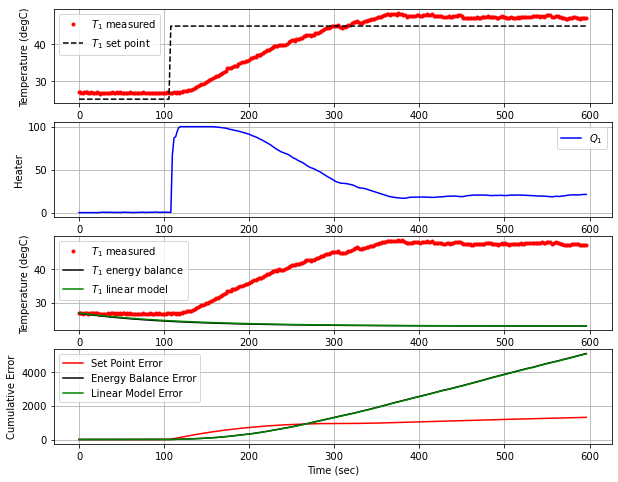

T1 NIH BOS  [47.04 47.06 47.13 47.14 47.3  47.39 47.49 47.28 47.29 47.03 47.13 47.13
 47.18 47.12 46.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 600.2  45.00  47.02   0.00  21.46


<Figure size 432x288 with 0 Axes>

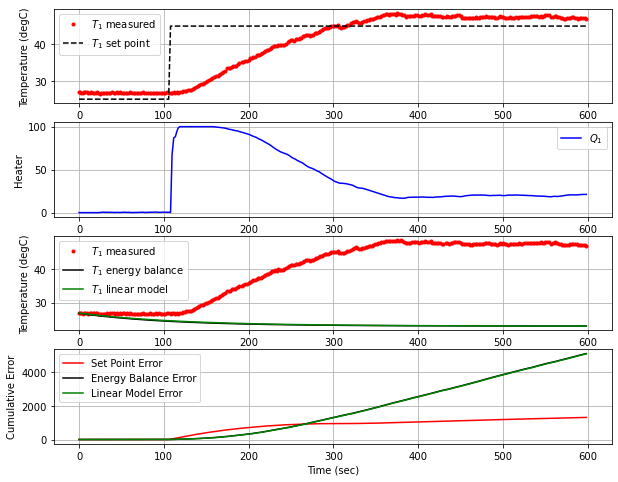

T1 NIH BOS  [47.06 47.13 47.14 47.3  47.39 47.49 47.28 47.29 47.03 47.13 47.13 47.18
 47.12 46.88 47.02]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 602.0  45.00  47.31   0.00  21.51


<Figure size 432x288 with 0 Axes>

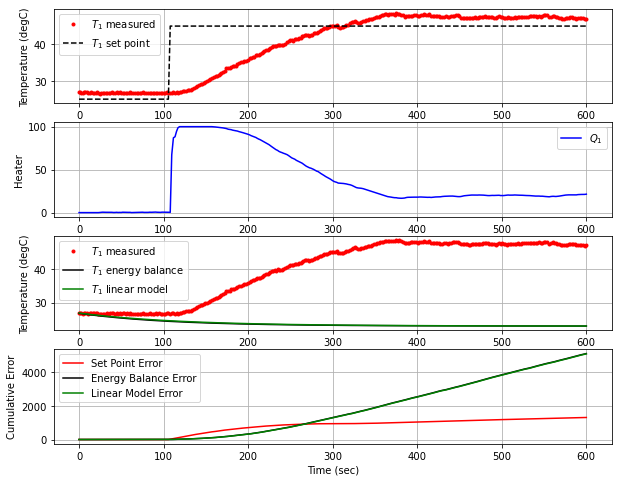

T1 NIH BOS  [47.13 47.14 47.3  47.39 47.49 47.28 47.29 47.03 47.13 47.13 47.18 47.12
 46.88 47.02 47.31]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 603.7  45.00  47.54   0.00  21.26


<Figure size 432x288 with 0 Axes>

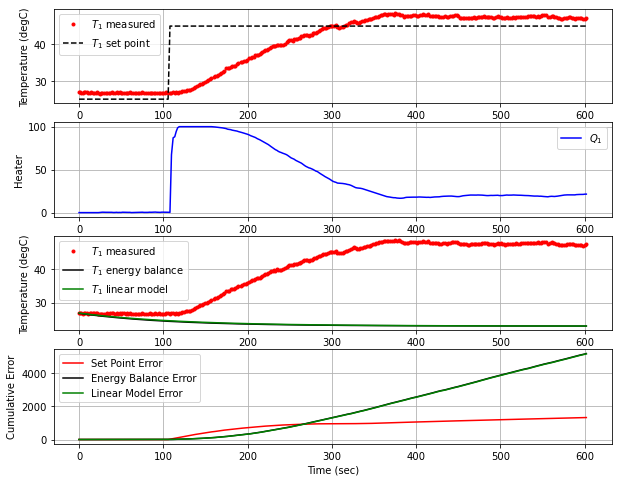

T1 NIH BOS  [47.14 47.3  47.39 47.49 47.28 47.29 47.03 47.13 47.13 47.18 47.12 46.88
 47.02 47.31 47.54]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 58ms/step
 605.4  45.00  47.59   0.00  20.87


<Figure size 432x288 with 0 Axes>

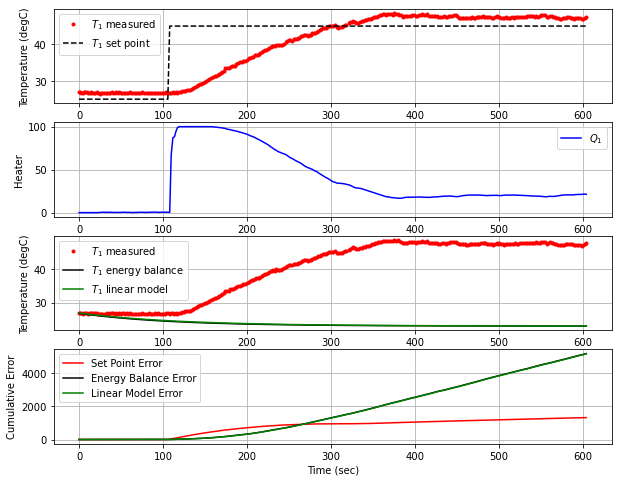

T1 NIH BOS  [47.3  47.39 47.49 47.28 47.29 47.03 47.13 47.13 47.18 47.12 46.88 47.02
 47.31 47.54 47.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 607.7  45.00  47.85   0.00  20.57


<Figure size 432x288 with 0 Axes>

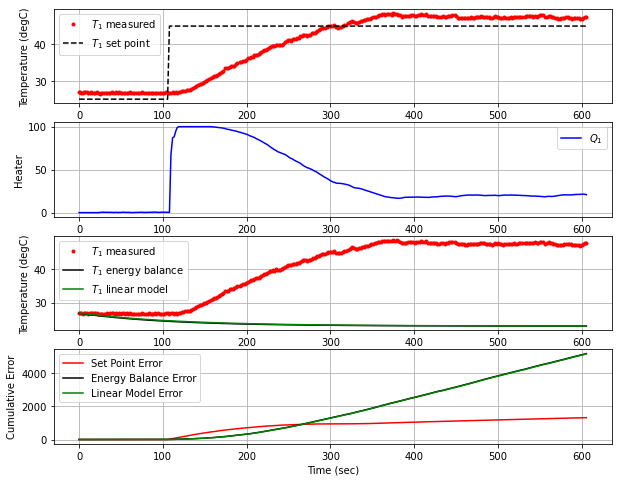

T1 NIH BOS  [47.39 47.49 47.28 47.29 47.03 47.13 47.13 47.18 47.12 46.88 47.02 47.31
 47.54 47.59 47.85]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 609.8  45.00  48.00   0.00  20.14


<Figure size 432x288 with 0 Axes>

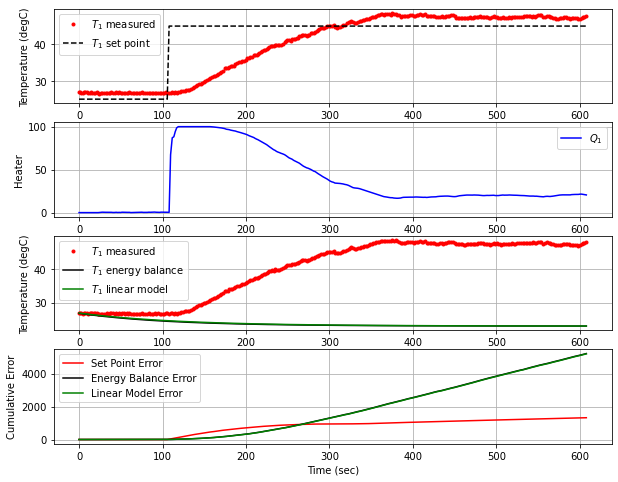

T1 NIH BOS  [47.49 47.28 47.29 47.03 47.13 47.13 47.18 47.12 46.88 47.02 47.31 47.54
 47.59 47.85 48.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 611.7  45.00  47.97   0.00  19.69


<Figure size 432x288 with 0 Axes>

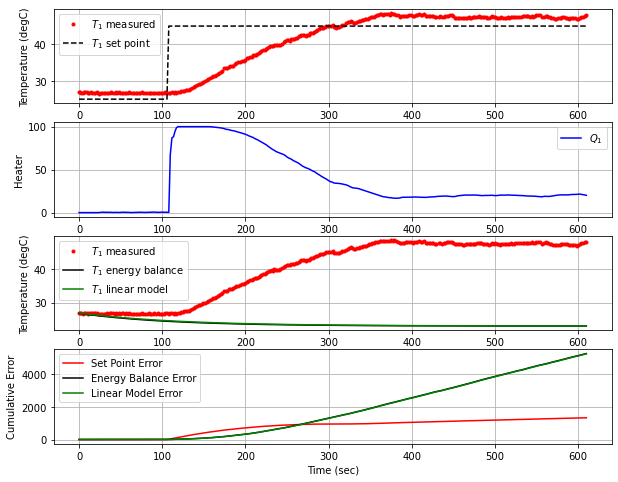

T1 NIH BOS  [47.28 47.29 47.03 47.13 47.13 47.18 47.12 46.88 47.02 47.31 47.54 47.59
 47.85 48.   47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 613.8  45.00  47.83   0.00  19.41


<Figure size 432x288 with 0 Axes>

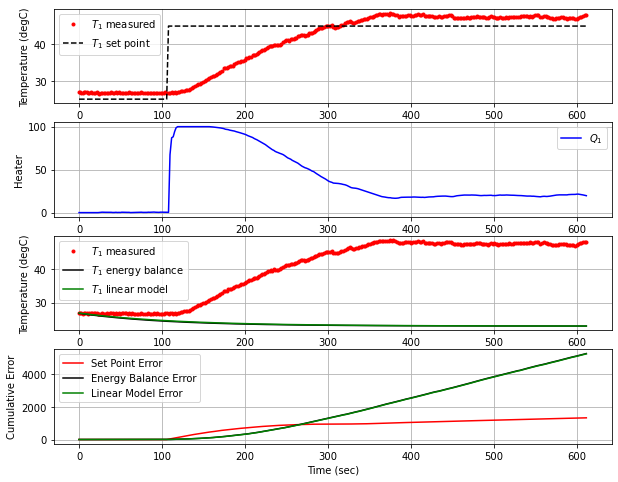

T1 NIH BOS  [47.29 47.03 47.13 47.13 47.18 47.12 46.88 47.02 47.31 47.54 47.59 47.85
 48.   47.97 47.83]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 615.9  45.00  47.39   0.00  19.31


<Figure size 432x288 with 0 Axes>

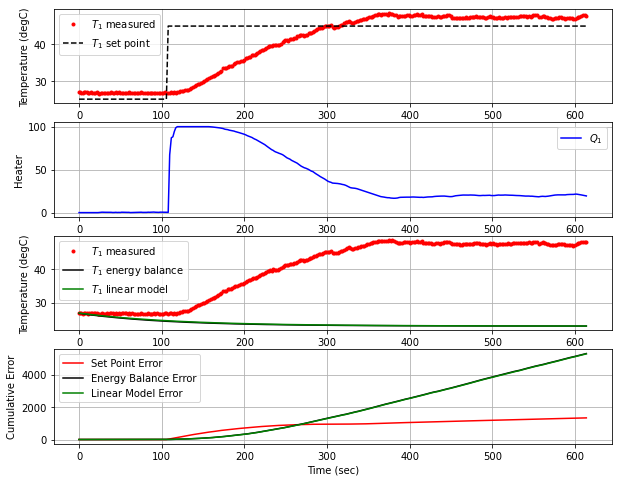

T1 NIH BOS  [47.03 47.13 47.13 47.18 47.12 46.88 47.02 47.31 47.54 47.59 47.85 48.
 47.97 47.83 47.39]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 617.7  45.00  47.22   0.00  19.63


<Figure size 432x288 with 0 Axes>

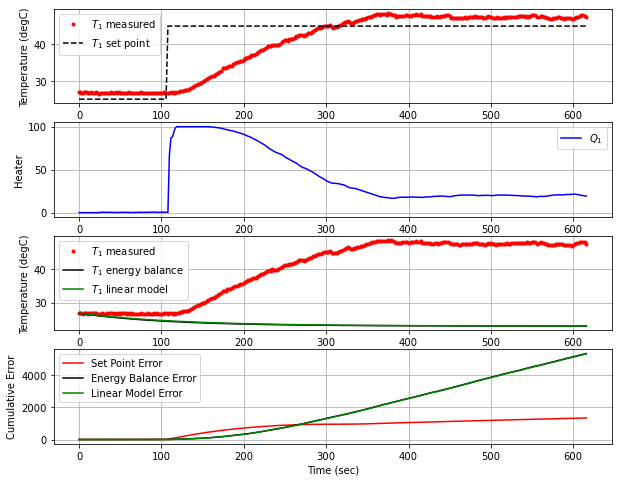

T1 NIH BOS  [47.13 47.13 47.18 47.12 46.88 47.02 47.31 47.54 47.59 47.85 48.   47.97
 47.83 47.39 47.22]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 619.5  45.00  47.42   0.00  19.96


<Figure size 432x288 with 0 Axes>

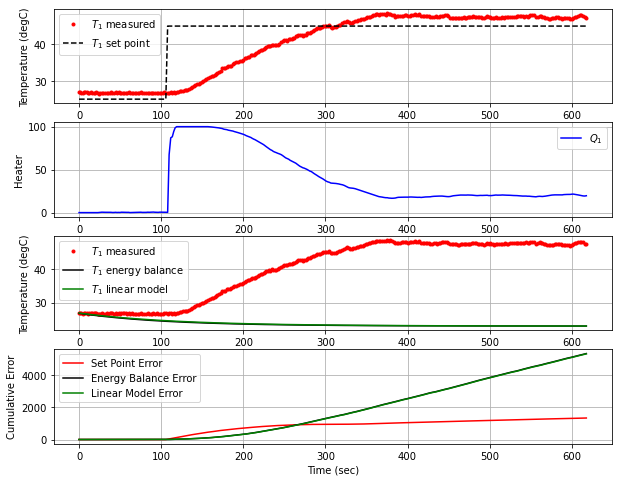

T1 NIH BOS  [47.13 47.18 47.12 46.88 47.02 47.31 47.54 47.59 47.85 48.   47.97 47.83
 47.39 47.22 47.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 621.3  45.00  47.48   0.00  19.94


<Figure size 432x288 with 0 Axes>

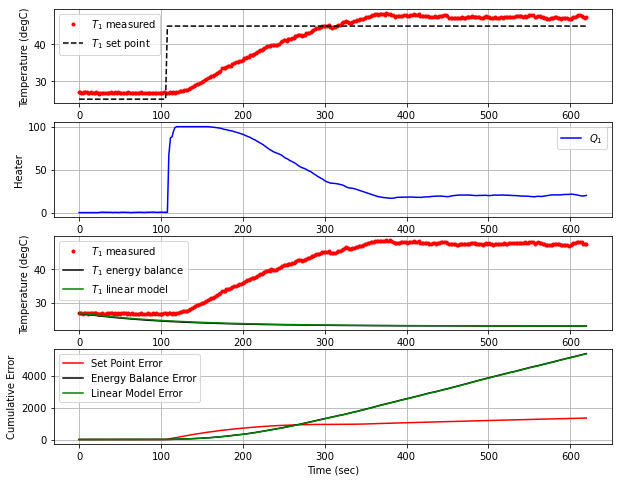

T1 NIH BOS  [47.18 47.12 46.88 47.02 47.31 47.54 47.59 47.85 48.   47.97 47.83 47.39
 47.22 47.42 47.48]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 623.6  45.00  47.64   0.00  19.84


<Figure size 432x288 with 0 Axes>

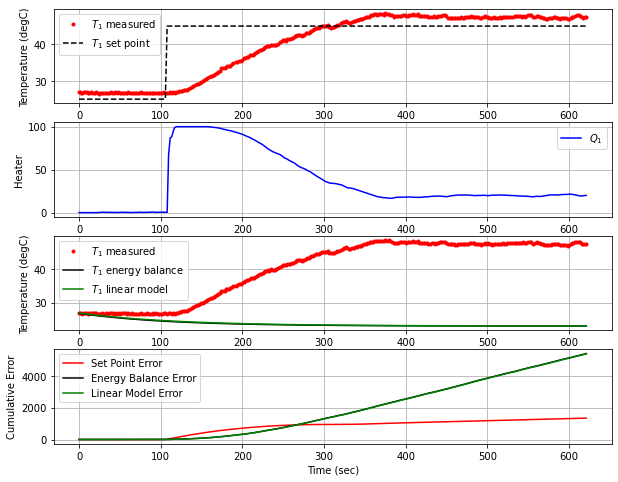

T1 NIH BOS  [47.12 46.88 47.02 47.31 47.54 47.59 47.85 48.   47.97 47.83 47.39 47.22
 47.42 47.48 47.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 625.5  45.00  47.72   0.00  19.63


<Figure size 432x288 with 0 Axes>

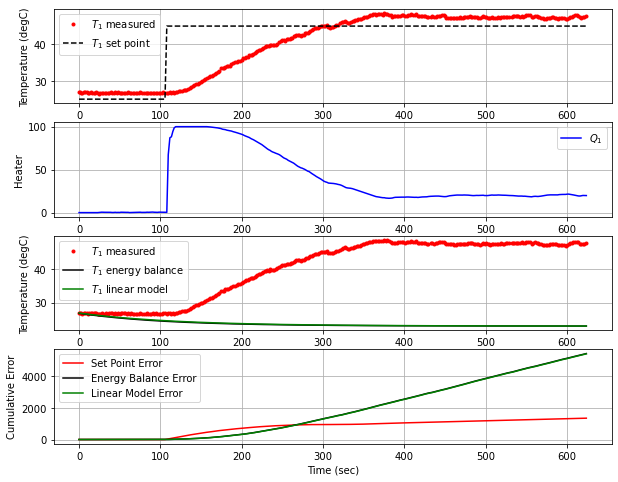

T1 NIH BOS  [46.88 47.02 47.31 47.54 47.59 47.85 48.   47.97 47.83 47.39 47.22 47.42
 47.48 47.64 47.72]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 627.2  45.00  47.75   0.00  19.42


<Figure size 432x288 with 0 Axes>

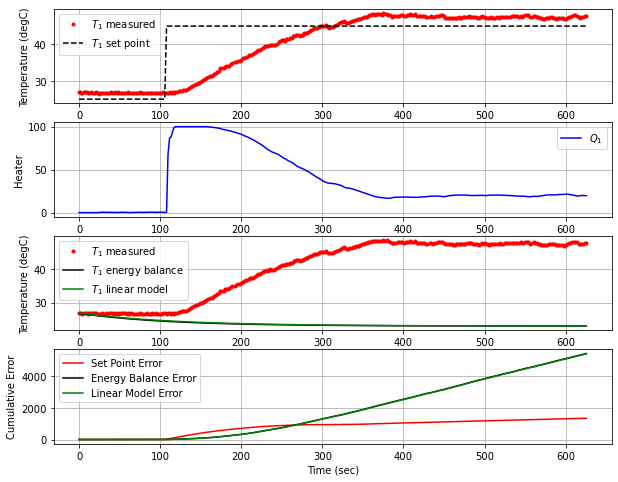

T1 NIH BOS  [47.02 47.31 47.54 47.59 47.85 48.   47.97 47.83 47.39 47.22 47.42 47.48
 47.64 47.72 47.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 628.9  45.00  47.58   0.00  19.23


<Figure size 432x288 with 0 Axes>

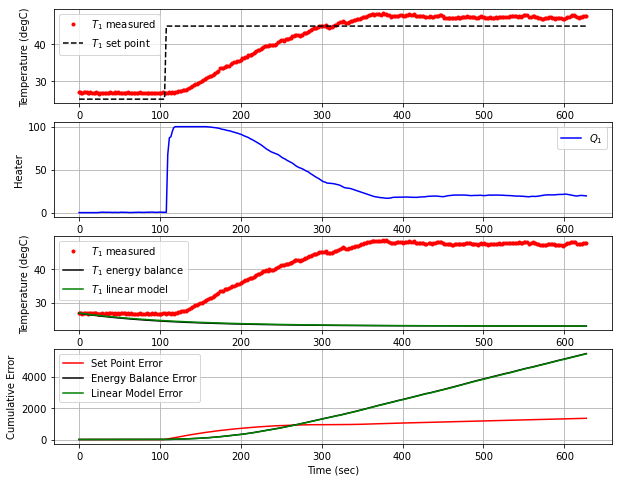

T1 NIH BOS  [47.31 47.54 47.59 47.85 48.   47.97 47.83 47.39 47.22 47.42 47.48 47.64
 47.72 47.75 47.58]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 630.8  45.00  47.36   0.00  19.26


<Figure size 432x288 with 0 Axes>

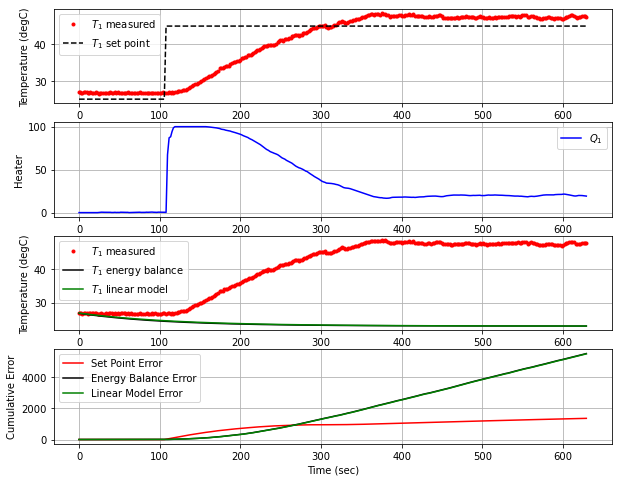

T1 NIH BOS  [47.54 47.59 47.85 48.   47.97 47.83 47.39 47.22 47.42 47.48 47.64 47.72
 47.75 47.58 47.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 633.0  45.00  47.18   0.00  19.51


<Figure size 432x288 with 0 Axes>

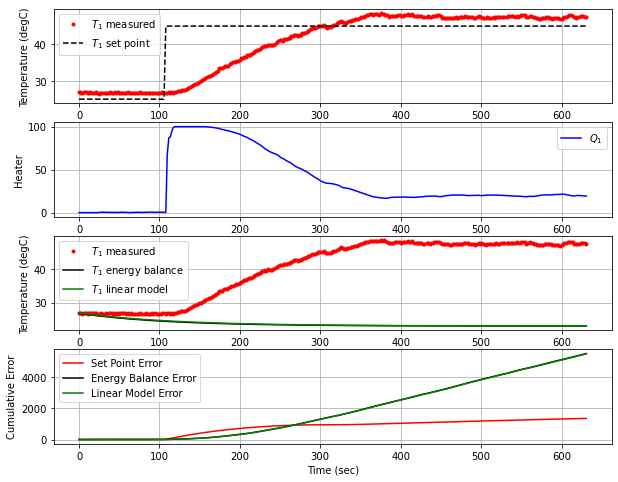

T1 NIH BOS  [47.59 47.85 48.   47.97 47.83 47.39 47.22 47.42 47.48 47.64 47.72 47.75
 47.58 47.36 47.18]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 634.8  45.00  47.16   0.00  19.86


<Figure size 432x288 with 0 Axes>

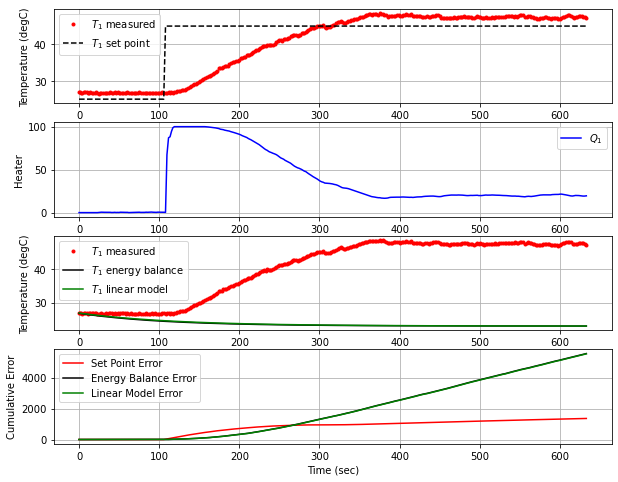

T1 NIH BOS  [47.85 48.   47.97 47.83 47.39 47.22 47.42 47.48 47.64 47.72 47.75 47.58
 47.36 47.18 47.16]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 636.9  45.00  46.92   0.00  20.12


<Figure size 432x288 with 0 Axes>

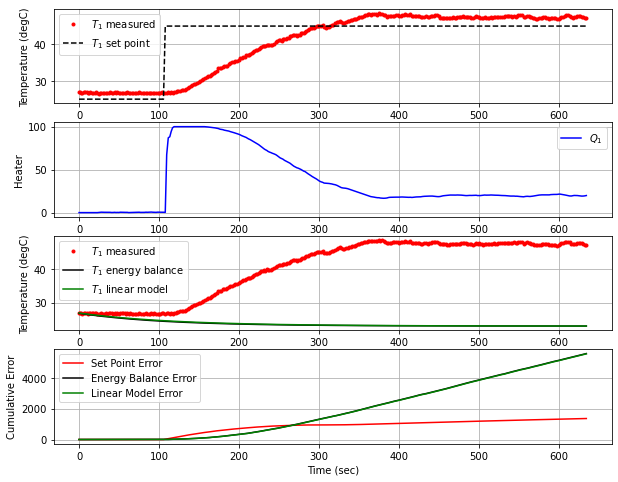

T1 NIH BOS  [48.   47.97 47.83 47.39 47.22 47.42 47.48 47.64 47.72 47.75 47.58 47.36
 47.18 47.16 46.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 53ms/step
 639.9  45.00  46.97   0.00  20.54


<Figure size 432x288 with 0 Axes>

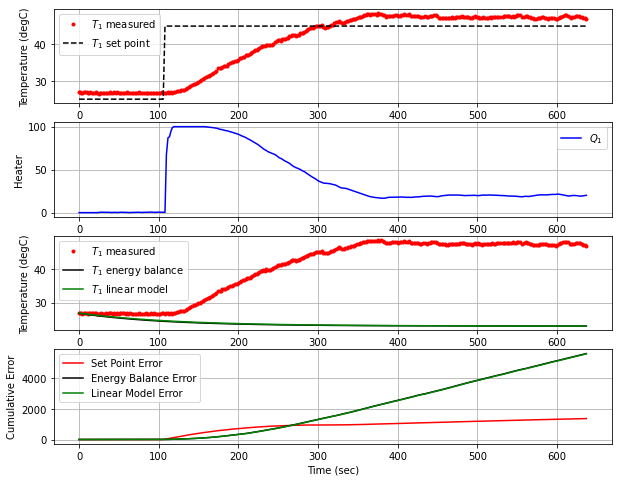

T1 NIH BOS  [47.97 47.83 47.39 47.22 47.42 47.48 47.64 47.72 47.75 47.58 47.36 47.18
 47.16 46.92 46.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 641.8  45.00  47.12   0.00  20.82


<Figure size 432x288 with 0 Axes>

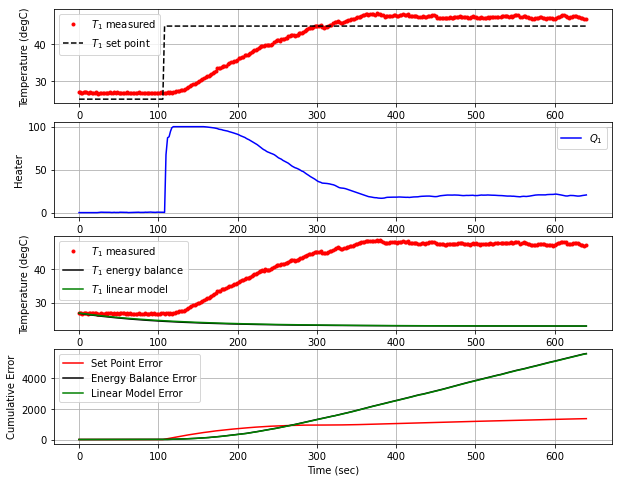

T1 NIH BOS  [47.83 47.39 47.22 47.42 47.48 47.64 47.72 47.75 47.58 47.36 47.18 47.16
 46.92 46.97 47.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 643.4  45.00  46.89   0.00  20.90


<Figure size 432x288 with 0 Axes>

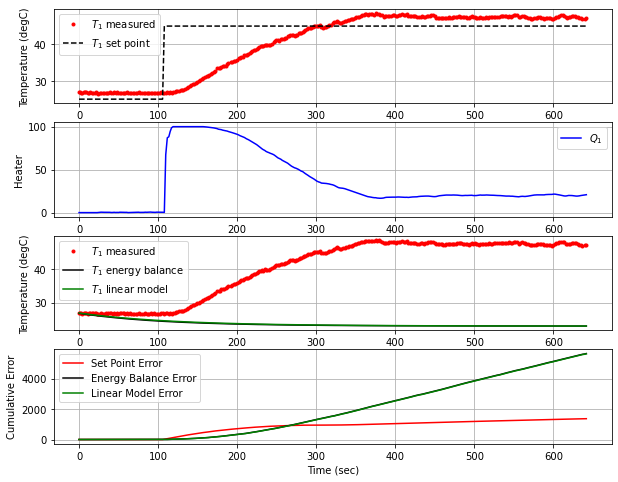

T1 NIH BOS  [47.39 47.22 47.42 47.48 47.64 47.72 47.75 47.58 47.36 47.18 47.16 46.92
 46.97 47.12 46.89]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 645.3  45.00  47.00   0.00  21.20


<Figure size 432x288 with 0 Axes>

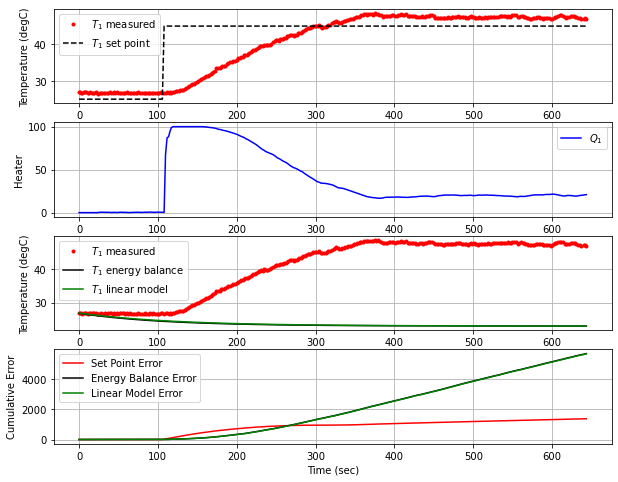

T1 NIH BOS  [47.22 47.42 47.48 47.64 47.72 47.75 47.58 47.36 47.18 47.16 46.92 46.97
 47.12 46.89 47.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 647.0  45.00  47.29   0.00  21.31


<Figure size 432x288 with 0 Axes>

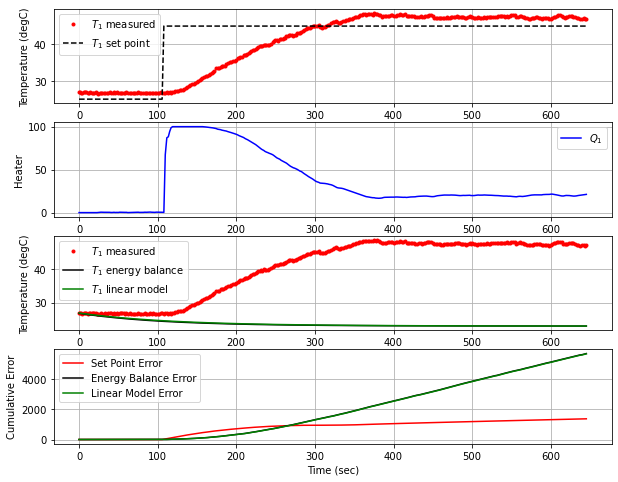

T1 NIH BOS  [47.42 47.48 47.64 47.72 47.75 47.58 47.36 47.18 47.16 46.92 46.97 47.12
 46.89 47.   47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 648.7  45.00  47.17   0.00  21.11


<Figure size 432x288 with 0 Axes>

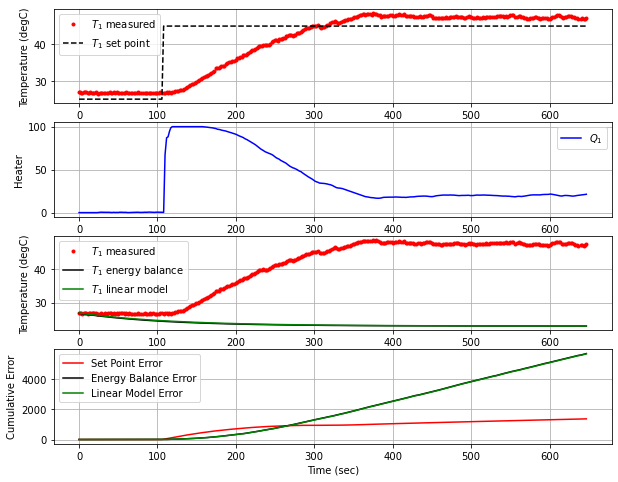

T1 NIH BOS  [47.48 47.64 47.72 47.75 47.58 47.36 47.18 47.16 46.92 46.97 47.12 46.89
 47.   47.29 47.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 650.7  45.00  47.26   0.00  21.12


<Figure size 432x288 with 0 Axes>

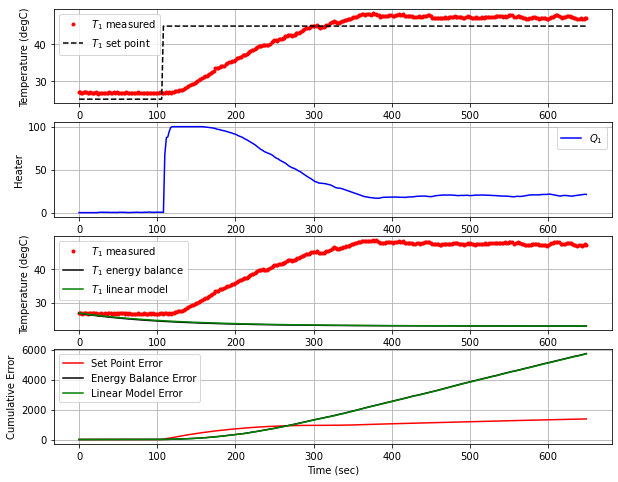

T1 NIH BOS  [47.64 47.72 47.75 47.58 47.36 47.18 47.16 46.92 46.97 47.12 46.89 47.
 47.29 47.17 47.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 652.6  45.00  47.08   0.00  21.07


<Figure size 432x288 with 0 Axes>

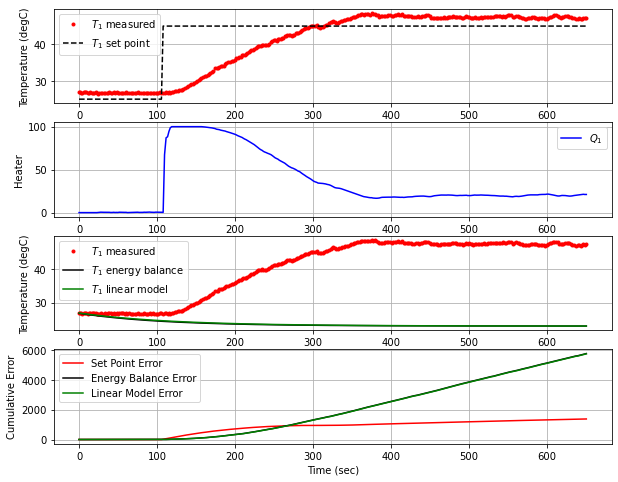

T1 NIH BOS  [47.72 47.75 47.58 47.36 47.18 47.16 46.92 46.97 47.12 46.89 47.   47.29
 47.17 47.26 47.08]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 61ms/step
 654.6  45.00  47.13   0.00  21.24


<Figure size 432x288 with 0 Axes>

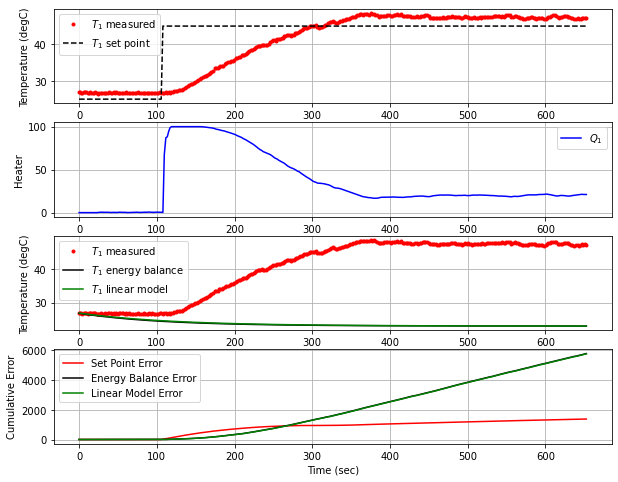

T1 NIH BOS  [47.75 47.58 47.36 47.18 47.16 46.92 46.97 47.12 46.89 47.   47.29 47.17
 47.26 47.08 47.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 656.7  45.00  47.29   0.00  21.33


<Figure size 432x288 with 0 Axes>

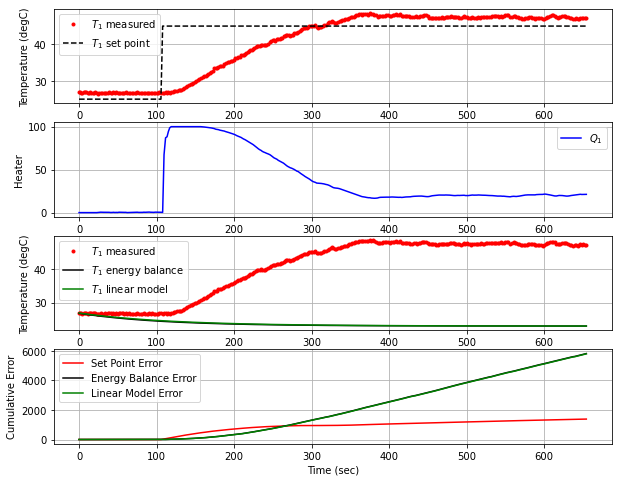

T1 NIH BOS  [47.58 47.36 47.18 47.16 46.92 46.97 47.12 46.89 47.   47.29 47.17 47.26
 47.08 47.13 47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 658.4  45.00  47.37   0.00  21.23


<Figure size 432x288 with 0 Axes>

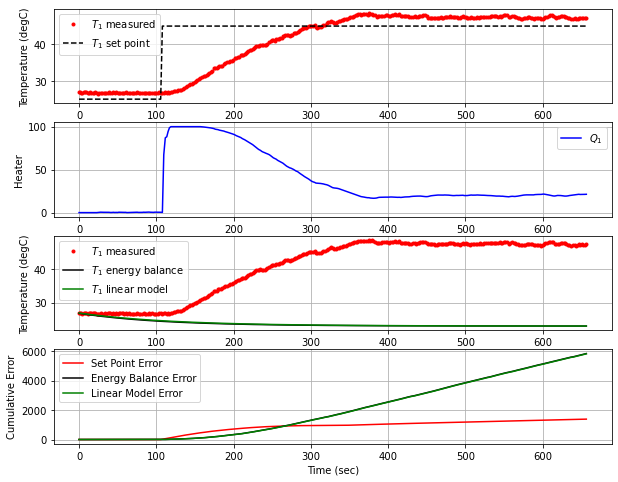

T1 NIH BOS  [47.36 47.18 47.16 46.92 46.97 47.12 46.89 47.   47.29 47.17 47.26 47.08
 47.13 47.29 47.37]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 660.1  45.00  47.27   0.00  21.08


<Figure size 432x288 with 0 Axes>

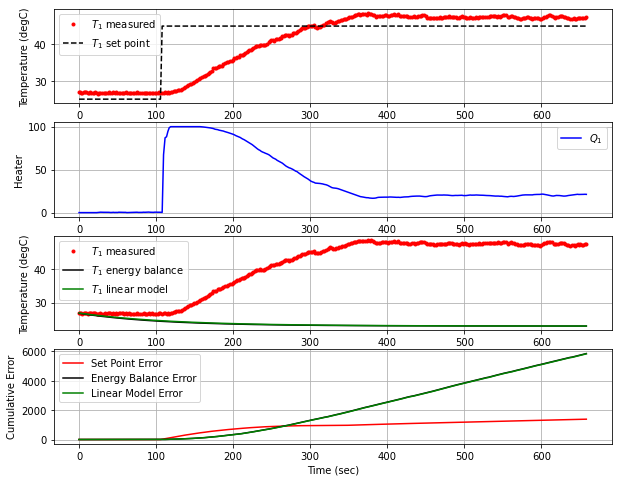

T1 NIH BOS  [47.18 47.16 46.92 46.97 47.12 46.89 47.   47.29 47.17 47.26 47.08 47.13
 47.29 47.37 47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 661.9  45.00  47.38   0.00  21.07


<Figure size 432x288 with 0 Axes>

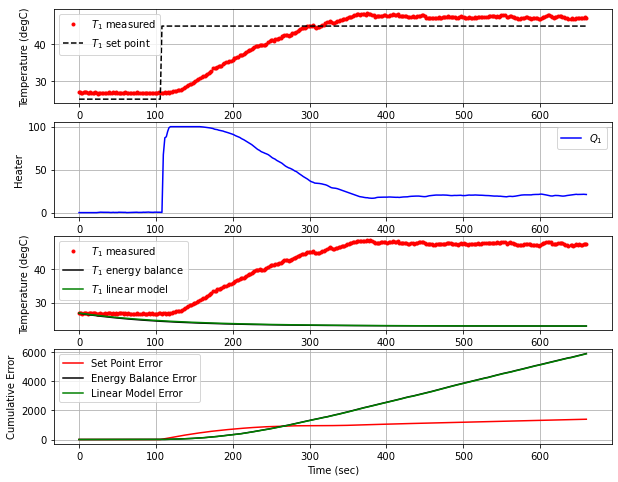

T1 NIH BOS  [47.16 46.92 46.97 47.12 46.89 47.   47.29 47.17 47.26 47.08 47.13 47.29
 47.37 47.27 47.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 663.8  45.00  47.27   0.00  20.94


<Figure size 432x288 with 0 Axes>

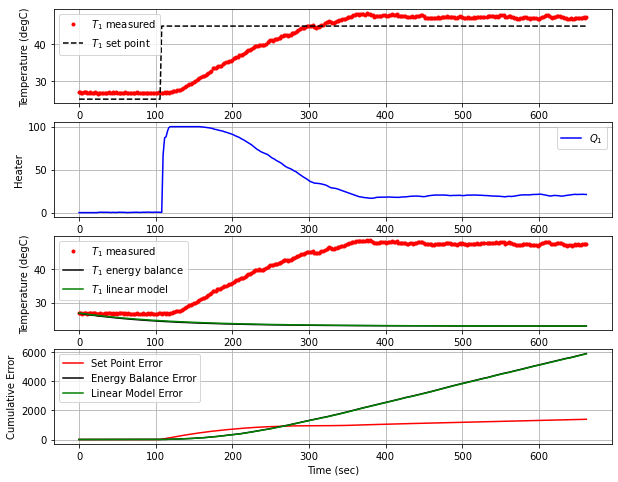

T1 NIH BOS  [46.92 46.97 47.12 46.89 47.   47.29 47.17 47.26 47.08 47.13 47.29 47.37
 47.27 47.38 47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 34ms/step
 665.4  45.00  47.46   0.00  20.95


<Figure size 432x288 with 0 Axes>

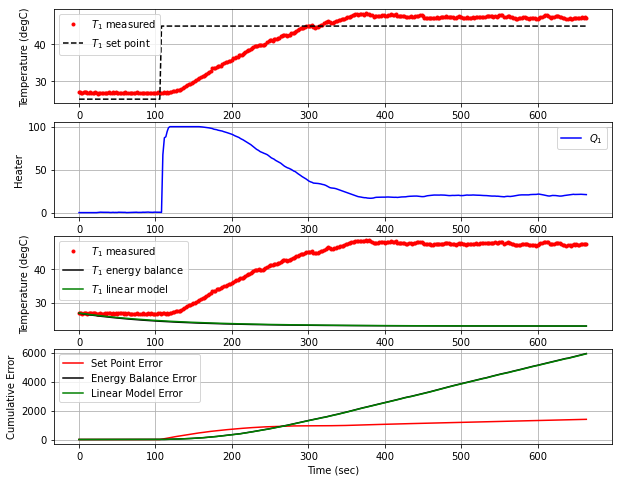

T1 NIH BOS  [46.97 47.12 46.89 47.   47.29 47.17 47.26 47.08 47.13 47.29 47.37 47.27
 47.38 47.27 47.46]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 667.1  45.00  47.58   0.00  20.73


<Figure size 432x288 with 0 Axes>

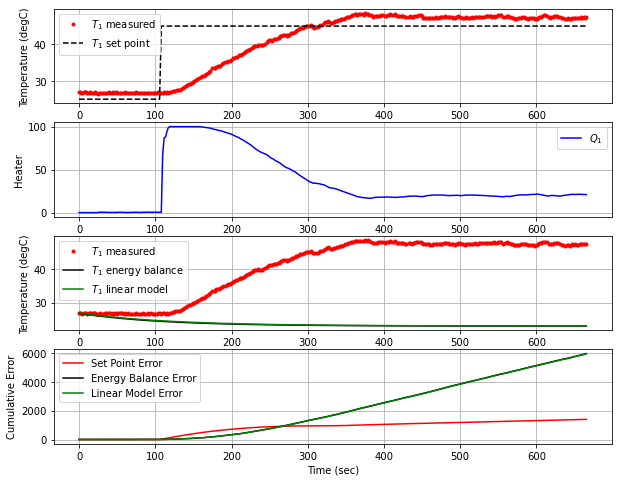

T1 NIH BOS  [47.12 46.89 47.   47.29 47.17 47.26 47.08 47.13 47.29 47.37 47.27 47.38
 47.27 47.46 47.58]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 668.9  45.00  47.80   0.00  20.45


<Figure size 432x288 with 0 Axes>

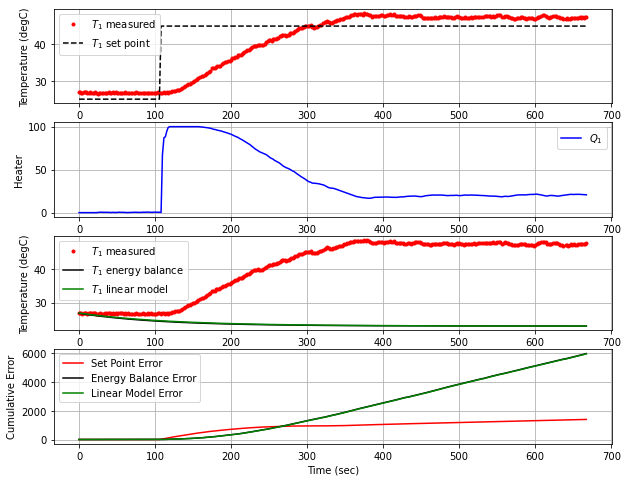

T1 NIH BOS  [46.89 47.   47.29 47.17 47.26 47.08 47.13 47.29 47.37 47.27 47.38 47.27
 47.46 47.58 47.8 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 57ms/step
 671.2  45.00  48.09   0.00  20.05


<Figure size 432x288 with 0 Axes>

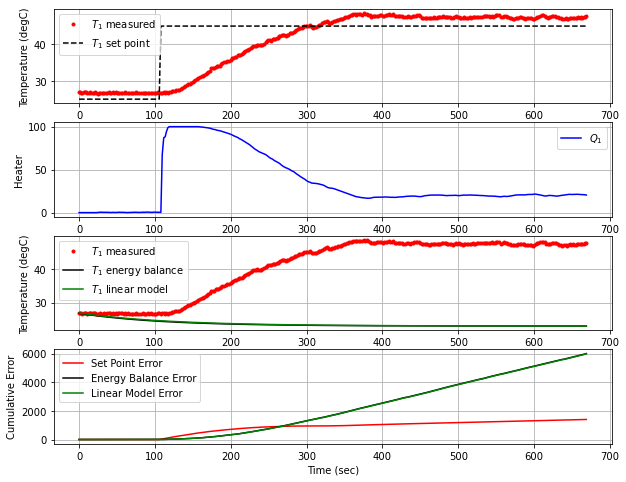

T1 NIH BOS  [47.   47.29 47.17 47.26 47.08 47.13 47.29 47.37 47.27 47.38 47.27 47.46
 47.58 47.8  48.09]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 53ms/step
 673.5  45.00  47.80   0.00  19.47


<Figure size 432x288 with 0 Axes>

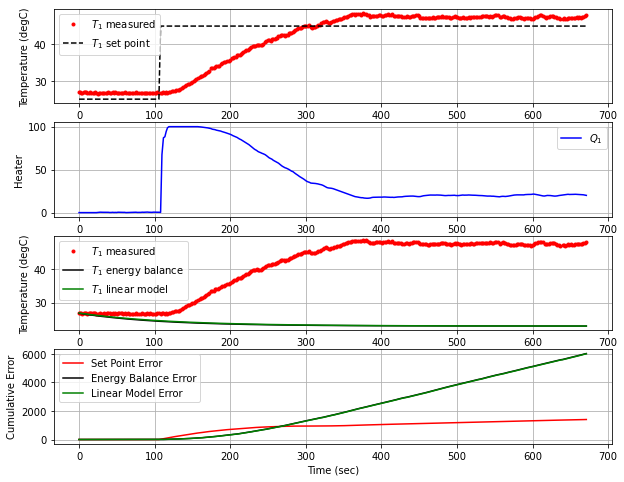

T1 NIH BOS  [47.29 47.17 47.26 47.08 47.13 47.29 47.37 47.27 47.38 47.27 47.46 47.58
 47.8  48.09 47.8 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 675.7  45.00  47.75   0.00  19.33


<Figure size 432x288 with 0 Axes>

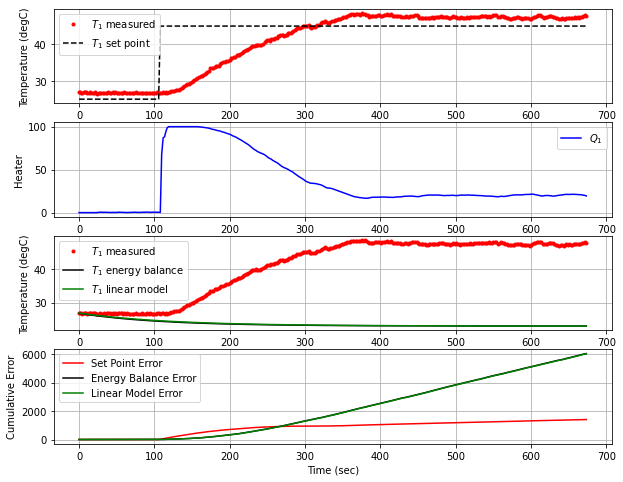

T1 NIH BOS  [47.17 47.26 47.08 47.13 47.29 47.37 47.27 47.38 47.27 47.46 47.58 47.8
 48.09 47.8  47.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 677.7  45.00  47.73   0.00  19.30


<Figure size 432x288 with 0 Axes>

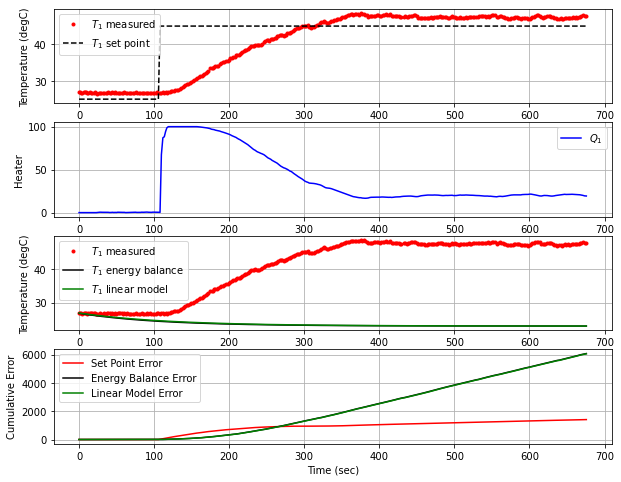

T1 NIH BOS  [47.26 47.08 47.13 47.29 47.37 47.27 47.38 47.27 47.46 47.58 47.8  48.09
 47.8  47.75 47.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 679.5  45.00  47.91   0.00  19.25


<Figure size 432x288 with 0 Axes>

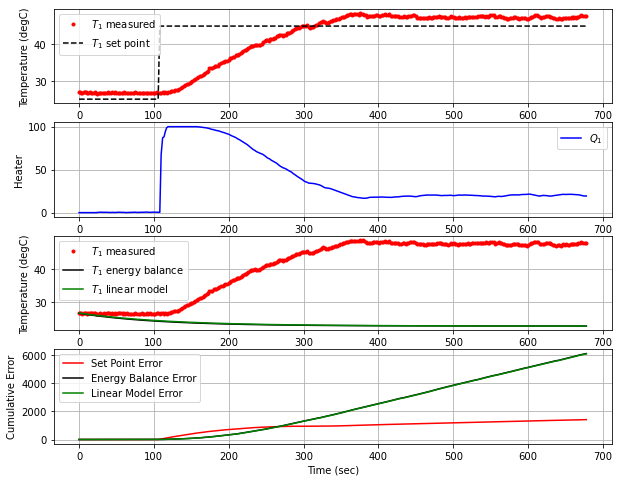

T1 NIH BOS  [47.08 47.13 47.29 47.37 47.27 47.38 47.27 47.46 47.58 47.8  48.09 47.8
 47.75 47.73 47.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 681.3  45.00  47.88   0.00  19.01


<Figure size 432x288 with 0 Axes>

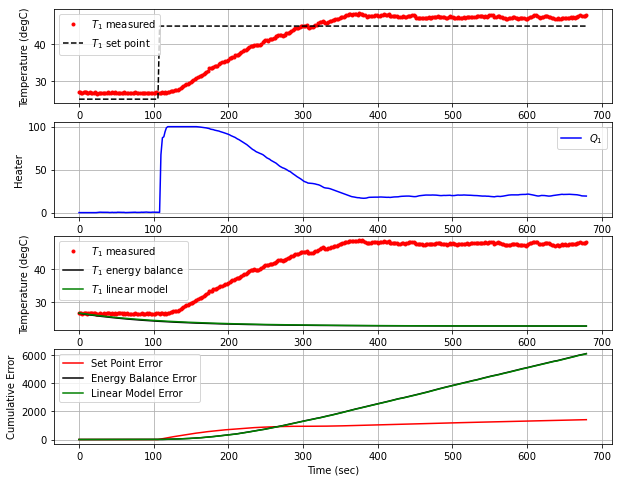

T1 NIH BOS  [47.13 47.29 47.37 47.27 47.38 47.27 47.46 47.58 47.8  48.09 47.8  47.75
 47.73 47.91 47.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 683.1  45.00  48.07   0.00  18.83


<Figure size 432x288 with 0 Axes>

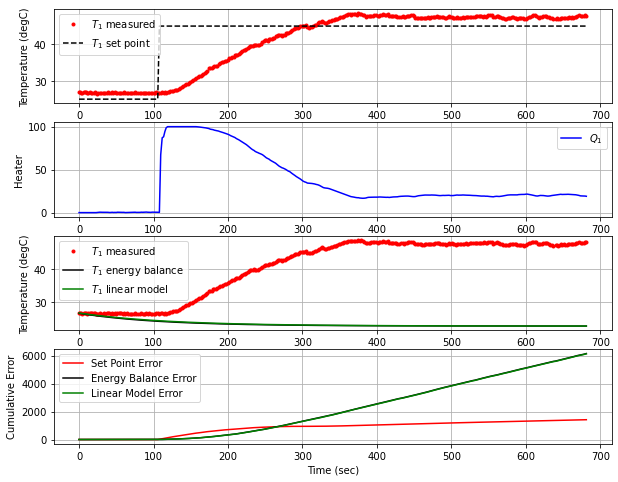

T1 NIH BOS  [47.29 47.37 47.27 47.38 47.27 47.46 47.58 47.8  48.09 47.8  47.75 47.73
 47.91 47.88 48.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 684.8  45.00  48.27   0.00  18.51


<Figure size 432x288 with 0 Axes>

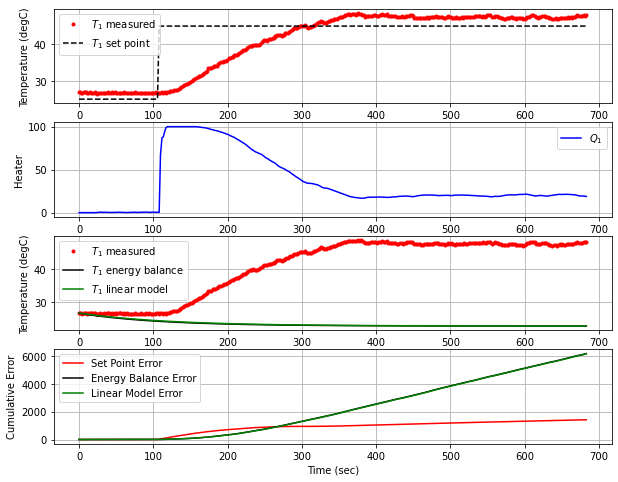

T1 NIH BOS  [47.37 47.27 47.38 47.27 47.46 47.58 47.8  48.09 47.8  47.75 47.73 47.91
 47.88 48.07 48.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 686.7  45.00  48.00   0.00  18.10


<Figure size 432x288 with 0 Axes>

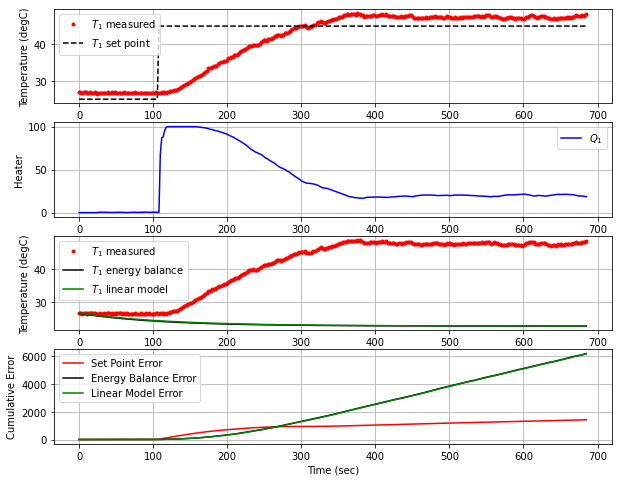

T1 NIH BOS  [47.27 47.38 47.27 47.46 47.58 47.8  48.09 47.8  47.75 47.73 47.91 47.88
 48.07 48.27 48.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 688.8  45.00  47.92   0.00  18.06


<Figure size 432x288 with 0 Axes>

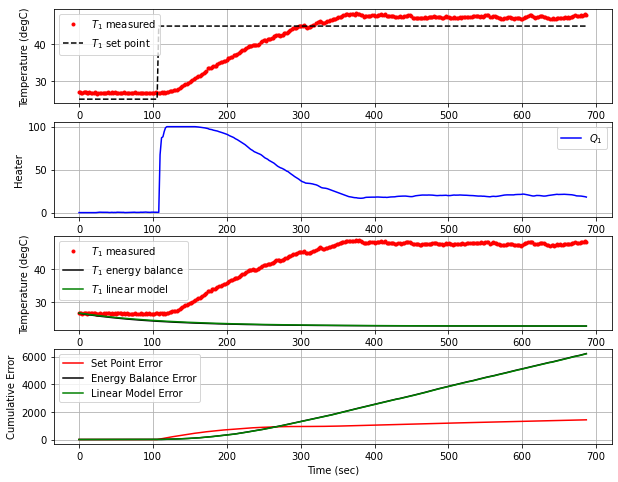

T1 NIH BOS  [47.38 47.27 47.46 47.58 47.8  48.09 47.8  47.75 47.73 47.91 47.88 48.07
 48.27 48.   47.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 690.5  45.00  47.71   0.00  18.10


<Figure size 432x288 with 0 Axes>

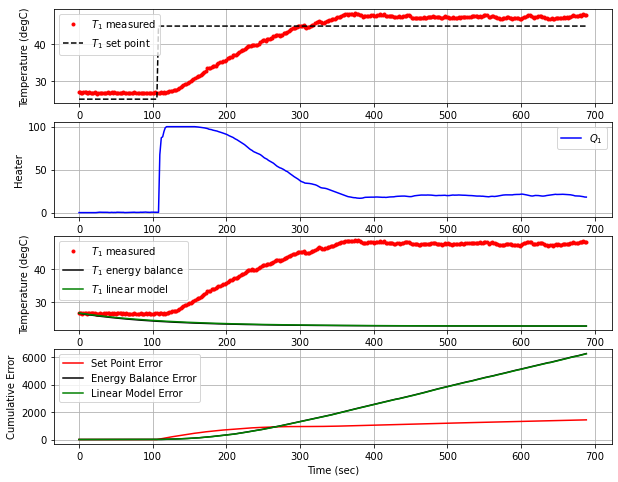

T1 NIH BOS  [47.27 47.46 47.58 47.8  48.09 47.8  47.75 47.73 47.91 47.88 48.07 48.27
 48.   47.92 47.71]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 692.3  45.00  47.96   0.00  18.30


<Figure size 432x288 with 0 Axes>

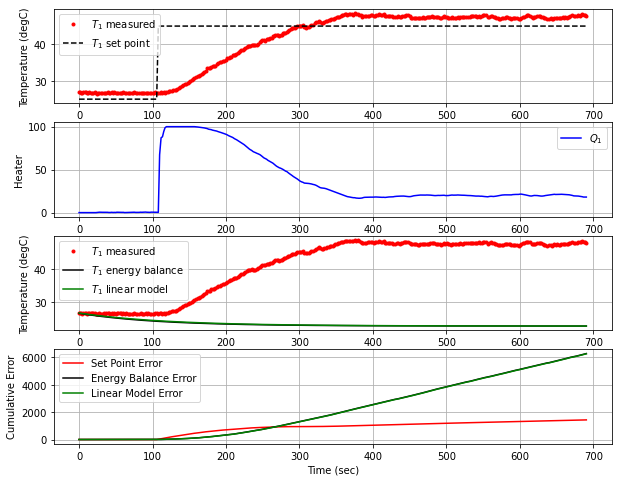

T1 NIH BOS  [47.46 47.58 47.8  48.09 47.8  47.75 47.73 47.91 47.88 48.07 48.27 48.
 47.92 47.71 47.96]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 694.0  45.00  48.13   0.00  18.16


<Figure size 432x288 with 0 Axes>

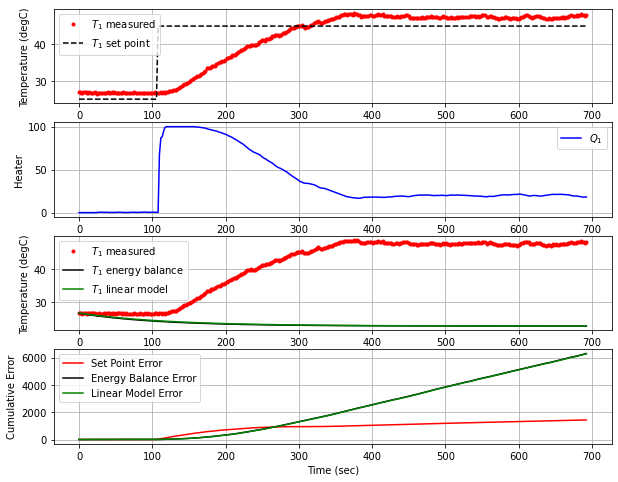

T1 NIH BOS  [47.58 47.8  48.09 47.8  47.75 47.73 47.91 47.88 48.07 48.27 48.   47.92
 47.71 47.96 48.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 695.8  45.00  48.31   0.00  17.89


<Figure size 432x288 with 0 Axes>

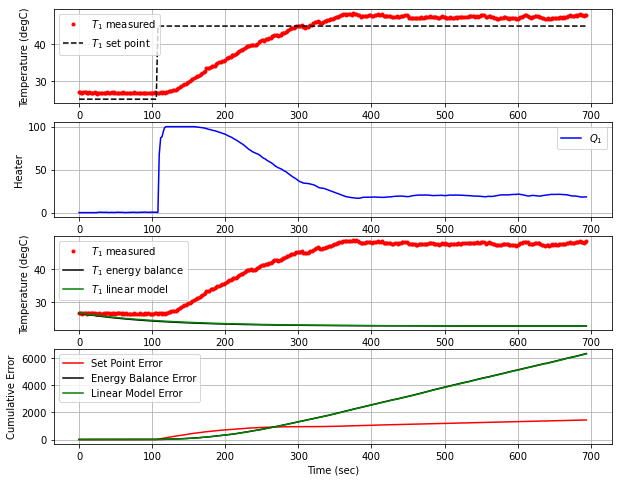

T1 NIH BOS  [47.8  48.09 47.8  47.75 47.73 47.91 47.88 48.07 48.27 48.   47.92 47.71
 47.96 48.13 48.31]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 697.5  45.00  48.19   0.00  17.53


<Figure size 432x288 with 0 Axes>

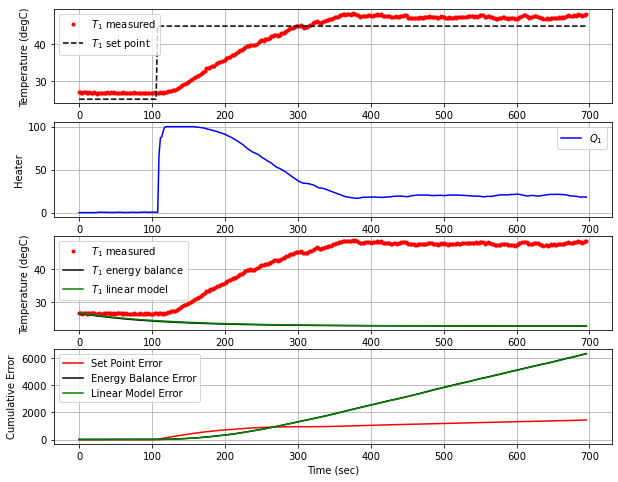

T1 NIH BOS  [48.09 47.8  47.75 47.73 47.91 47.88 48.07 48.27 48.   47.92 47.71 47.96
 48.13 48.31 48.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 699.3  45.00  48.46   0.00  17.42


<Figure size 432x288 with 0 Axes>

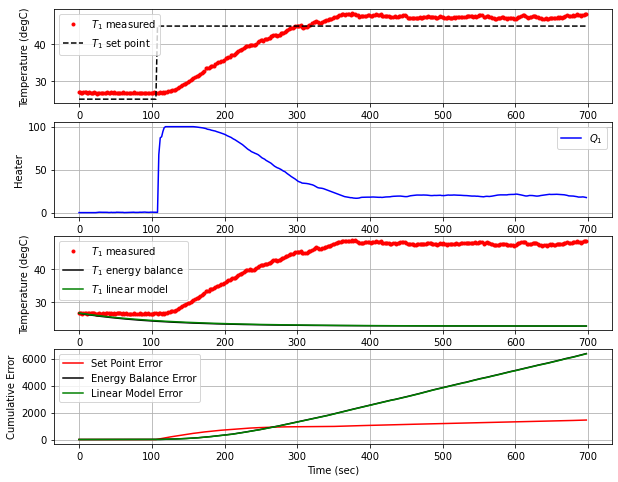

T1 NIH BOS  [47.8  47.75 47.73 47.91 47.88 48.07 48.27 48.   47.92 47.71 47.96 48.13
 48.31 48.19 48.46]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 701.3  45.00  48.52   0.00  17.14


<Figure size 432x288 with 0 Axes>

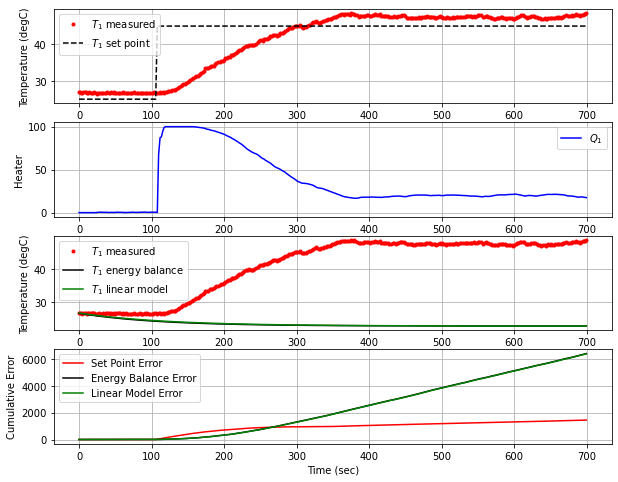

T1 NIH BOS  [47.75 47.73 47.91 47.88 48.07 48.27 48.   47.92 47.71 47.96 48.13 48.31
 48.19 48.46 48.52]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 703.3  45.00  48.23   0.00  16.84


<Figure size 432x288 with 0 Axes>

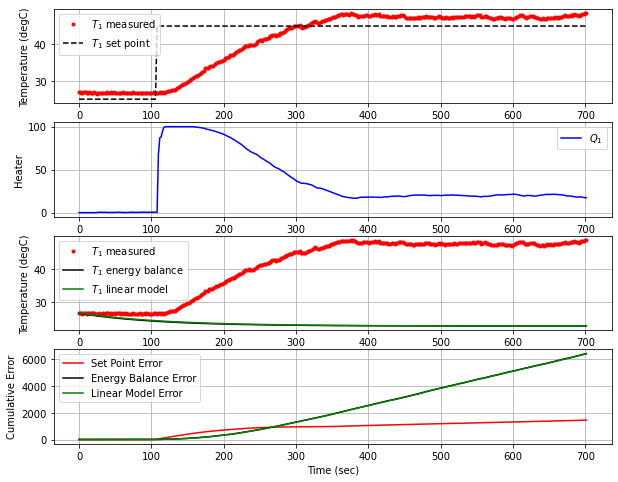

T1 NIH BOS  [47.73 47.91 47.88 48.07 48.27 48.   47.92 47.71 47.96 48.13 48.31 48.19
 48.46 48.52 48.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 705.0  45.00  48.39   0.00  16.89


<Figure size 432x288 with 0 Axes>

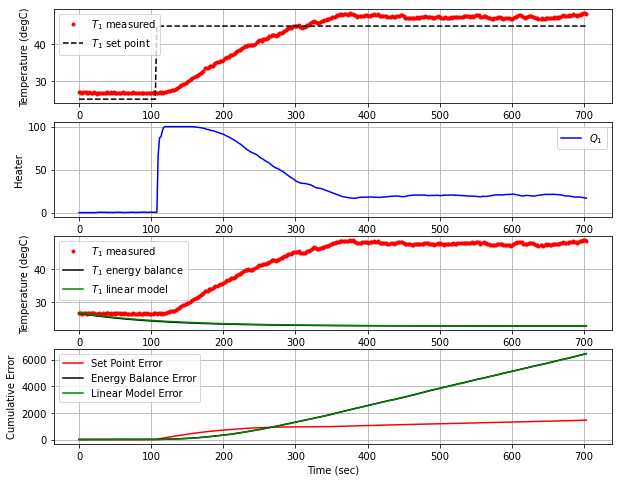

T1 NIH BOS  [47.91 47.88 48.07 48.27 48.   47.92 47.71 47.96 48.13 48.31 48.19 48.46
 48.52 48.23 48.39]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 706.8  45.00  48.27   0.00  16.78


<Figure size 432x288 with 0 Axes>

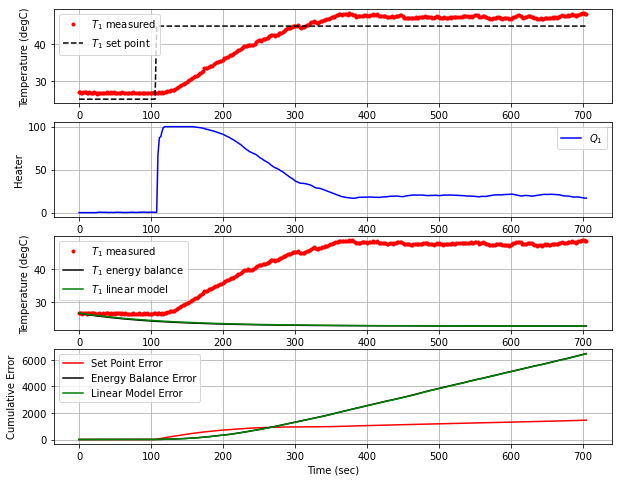

T1 NIH BOS  [47.88 48.07 48.27 48.   47.92 47.71 47.96 48.13 48.31 48.19 48.46 48.52
 48.23 48.39 48.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 708.6  45.00  48.44   0.00  16.78


<Figure size 432x288 with 0 Axes>

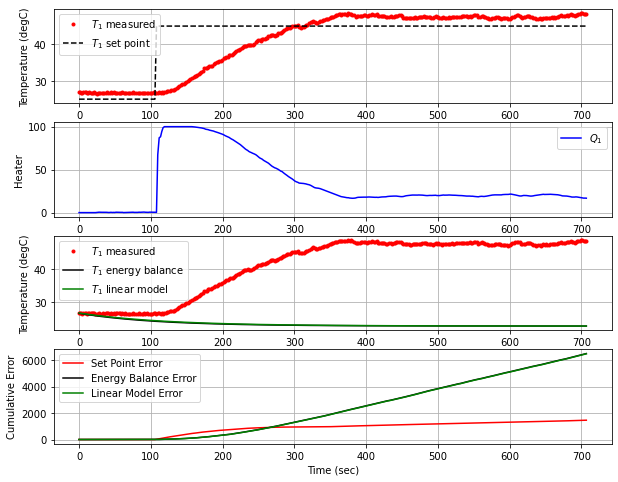

T1 NIH BOS  [48.07 48.27 48.   47.92 47.71 47.96 48.13 48.31 48.19 48.46 48.52 48.23
 48.39 48.27 48.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 710.4  45.00  48.42   0.00  16.61


<Figure size 432x288 with 0 Axes>

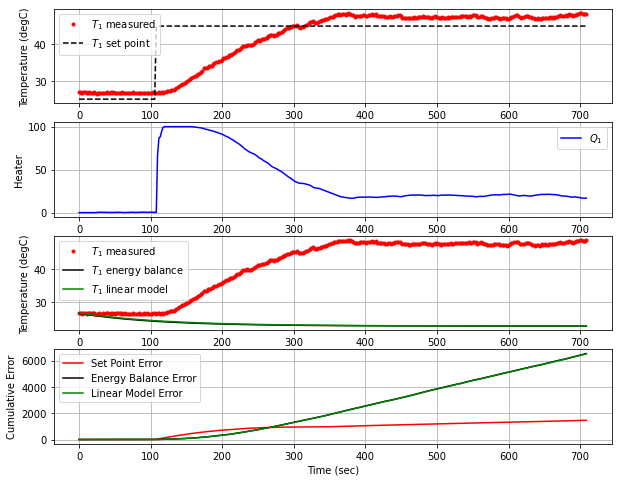

T1 NIH BOS  [48.27 48.   47.92 47.71 47.96 48.13 48.31 48.19 48.46 48.52 48.23 48.39
 48.27 48.44 48.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 712.4  45.00  48.08   0.00  16.50


<Figure size 432x288 with 0 Axes>

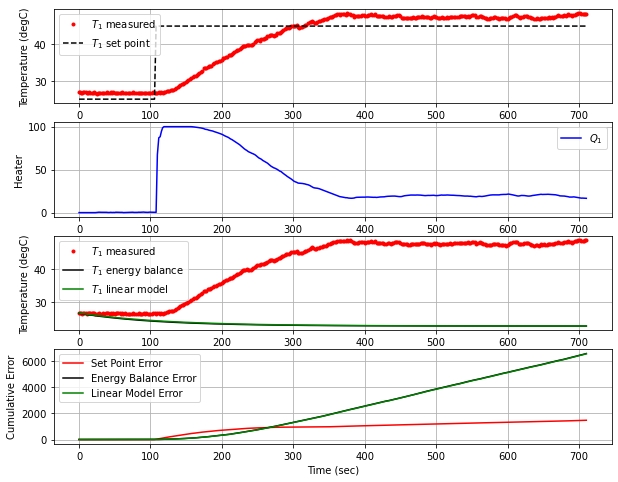

T1 NIH BOS  [48.   47.92 47.71 47.96 48.13 48.31 48.19 48.46 48.52 48.23 48.39 48.27
 48.44 48.42 48.08]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 714.1  45.00  48.05   0.00  16.75


<Figure size 432x288 with 0 Axes>

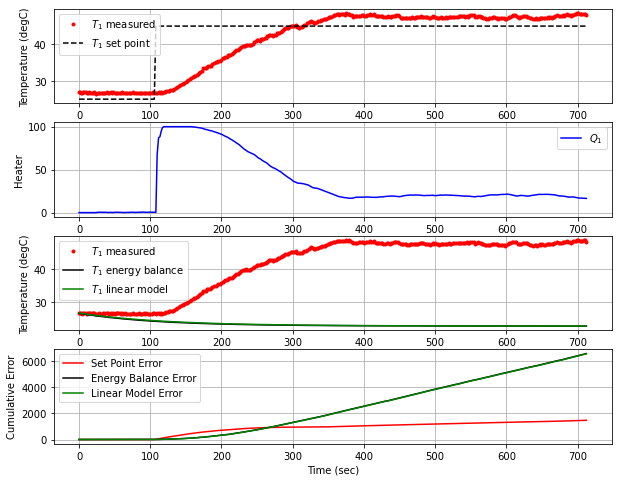

T1 NIH BOS  [47.92 47.71 47.96 48.13 48.31 48.19 48.46 48.52 48.23 48.39 48.27 48.44
 48.42 48.08 48.05]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 715.8  45.00  47.99   0.00  16.94


<Figure size 432x288 with 0 Axes>

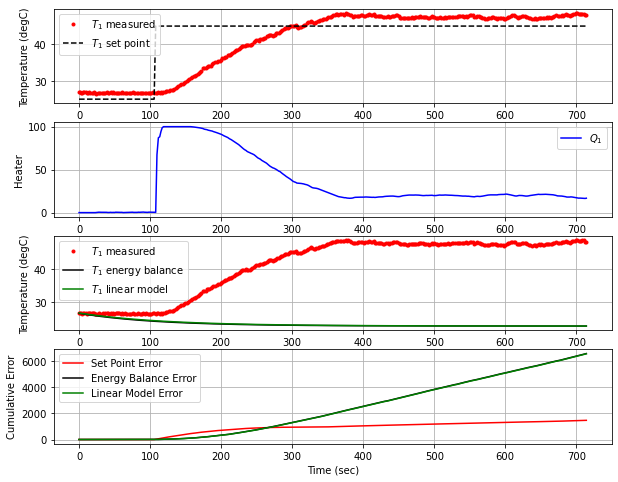

T1 NIH BOS  [47.71 47.96 48.13 48.31 48.19 48.46 48.52 48.23 48.39 48.27 48.44 48.42
 48.08 48.05 47.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 717.5  45.00  47.96   0.00  17.10


<Figure size 432x288 with 0 Axes>

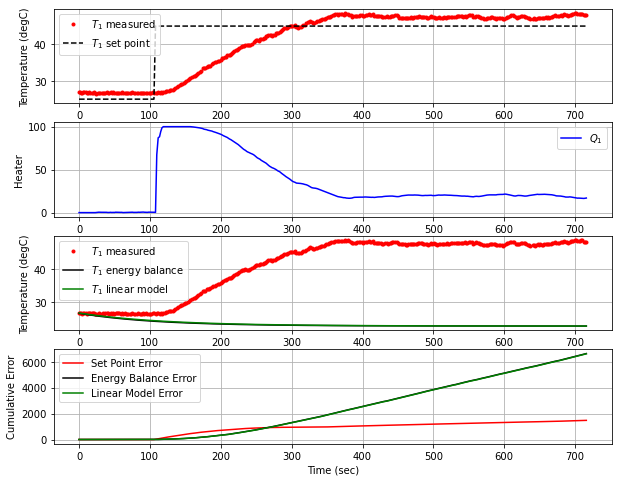

T1 NIH BOS  [47.96 48.13 48.31 48.19 48.46 48.52 48.23 48.39 48.27 48.44 48.42 48.08
 48.05 47.99 47.96]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 719.6  45.00  47.99   0.00  17.20


<Figure size 432x288 with 0 Axes>

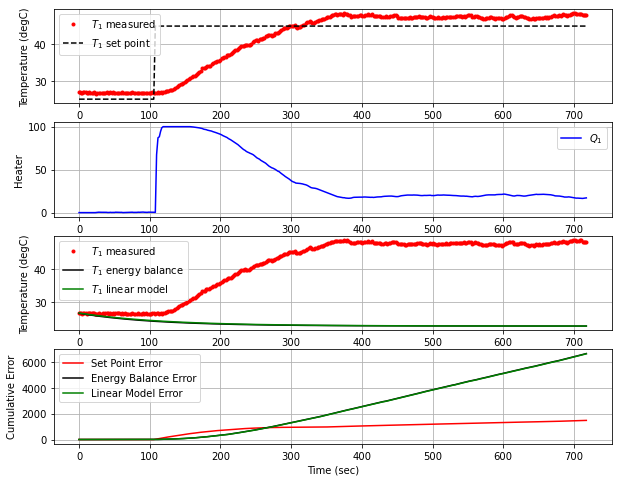

T1 NIH BOS  [48.13 48.31 48.19 48.46 48.52 48.23 48.39 48.27 48.44 48.42 48.08 48.05
 47.99 47.96 47.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 721.3  45.00  47.98   0.00  17.25


<Figure size 432x288 with 0 Axes>

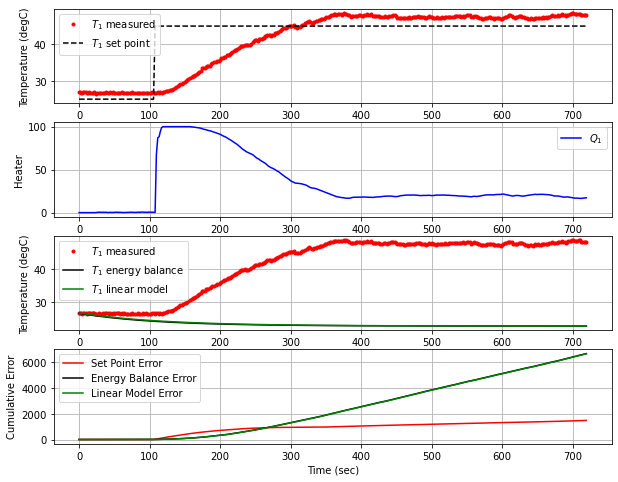

T1 NIH BOS  [48.31 48.19 48.46 48.52 48.23 48.39 48.27 48.44 48.42 48.08 48.05 47.99
 47.96 47.99 47.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 723.3  45.00  47.98   0.00  17.32


<Figure size 432x288 with 0 Axes>

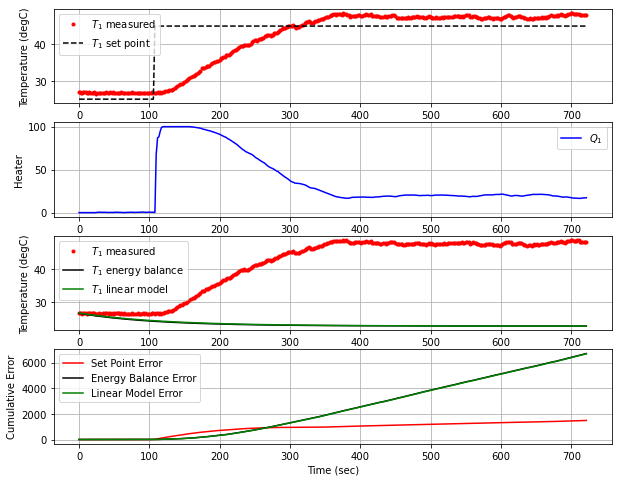

T1 NIH BOS  [48.19 48.46 48.52 48.23 48.39 48.27 48.44 48.42 48.08 48.05 47.99 47.96
 47.99 47.98 47.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 725.1  45.00  48.16   0.00  17.39


<Figure size 432x288 with 0 Axes>

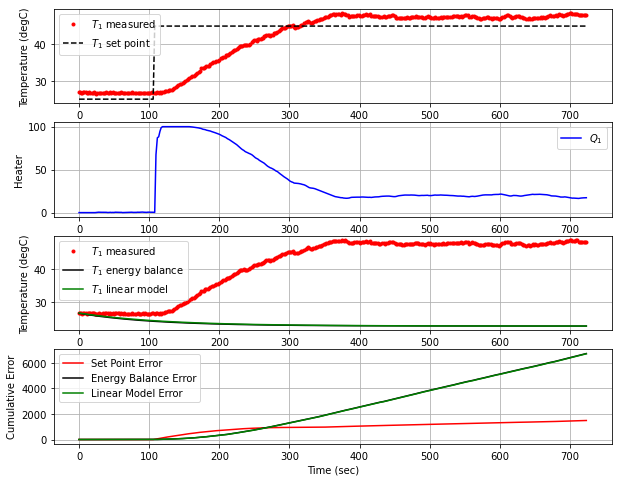

T1 NIH BOS  [48.46 48.52 48.23 48.39 48.27 48.44 48.42 48.08 48.05 47.99 47.96 47.99
 47.98 47.98 48.16]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 727.0  45.00  48.00   0.00  17.28


<Figure size 432x288 with 0 Axes>

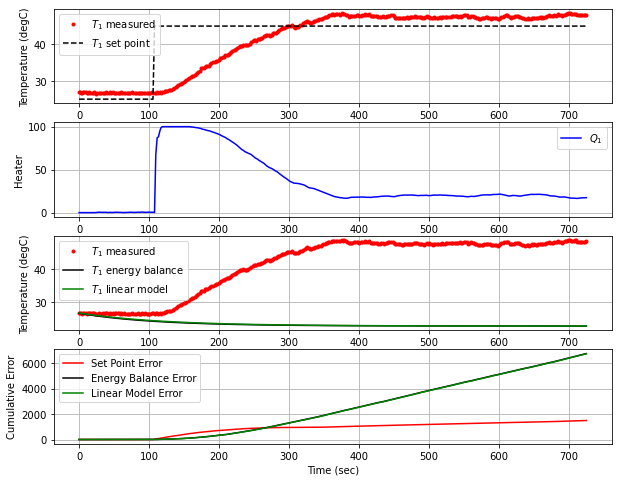

T1 NIH BOS  [48.52 48.23 48.39 48.27 48.44 48.42 48.08 48.05 47.99 47.96 47.99 47.98
 47.98 48.16 48.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 728.9  45.00  47.90   0.00  17.37


<Figure size 432x288 with 0 Axes>

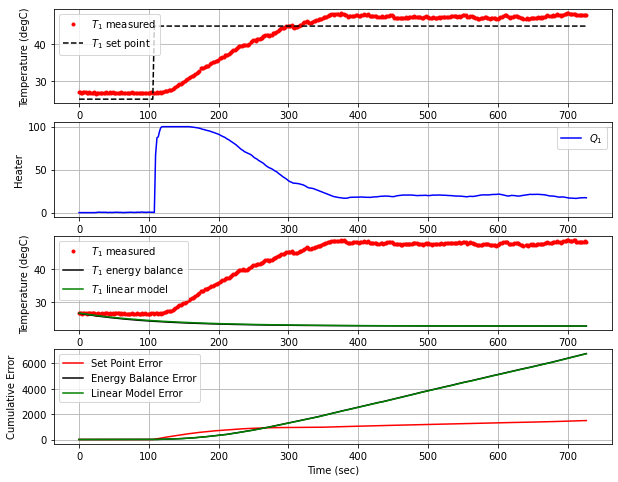

T1 NIH BOS  [48.23 48.39 48.27 48.44 48.42 48.08 48.05 47.99 47.96 47.99 47.98 47.98
 48.16 48.   47.9 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 730.6  45.00  47.73   0.00  17.57


<Figure size 432x288 with 0 Axes>

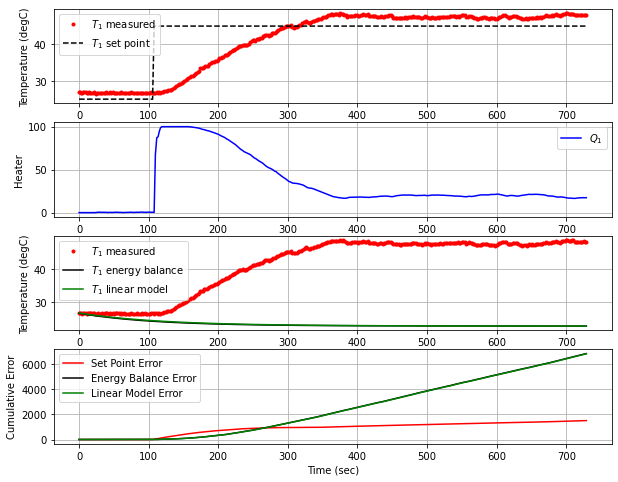

T1 NIH BOS  [48.39 48.27 48.44 48.42 48.08 48.05 47.99 47.96 47.99 47.98 47.98 48.16
 48.   47.9  47.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 732.4  45.00  47.70   0.00  17.85


<Figure size 432x288 with 0 Axes>

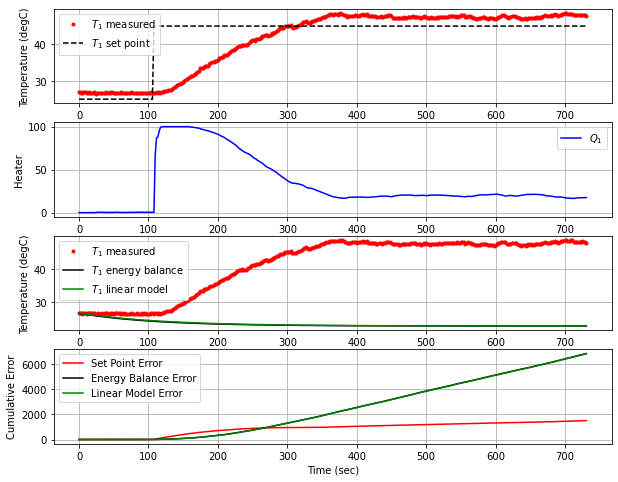

T1 NIH BOS  [48.27 48.44 48.42 48.08 48.05 47.99 47.96 47.99 47.98 47.98 48.16 48.
 47.9  47.73 47.7 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 734.1  45.00  47.63   0.00  18.09


<Figure size 432x288 with 0 Axes>

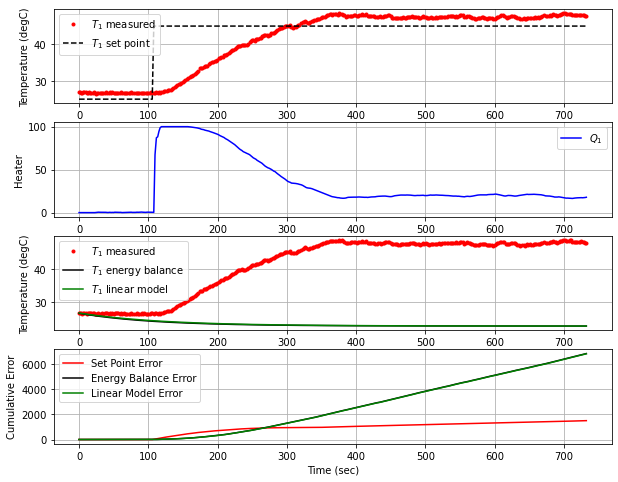

T1 NIH BOS  [48.44 48.42 48.08 48.05 47.99 47.96 47.99 47.98 47.98 48.16 48.   47.9
 47.73 47.7  47.63]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 736.4  45.00  47.69   0.00  18.31


<Figure size 432x288 with 0 Axes>

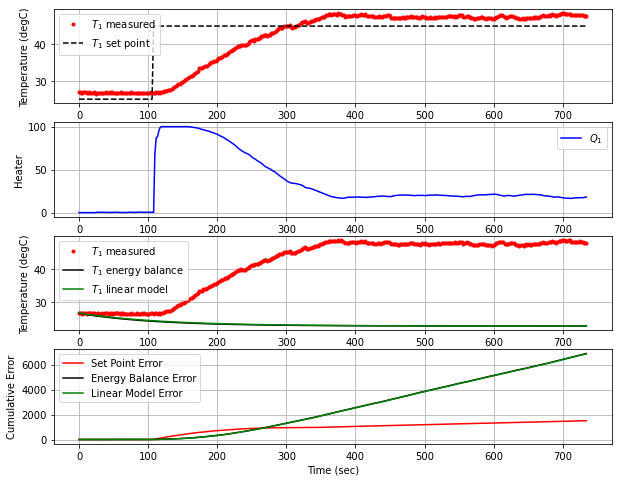

T1 NIH BOS  [48.42 48.08 48.05 47.99 47.96 47.99 47.98 47.98 48.16 48.   47.9  47.73
 47.7  47.63 47.69]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 738.1  45.00  47.76   0.00  18.43


<Figure size 432x288 with 0 Axes>

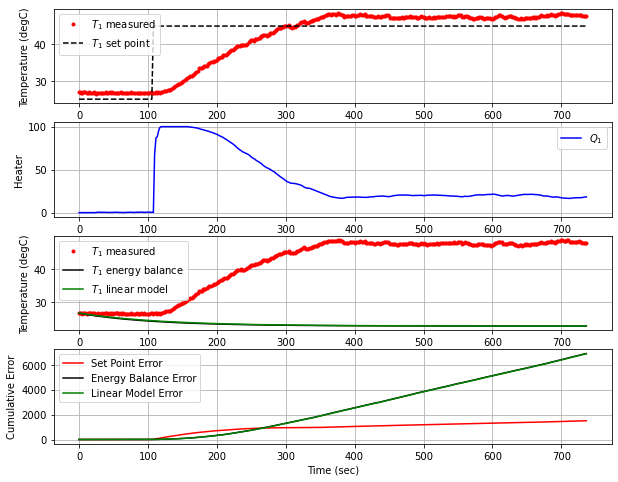

T1 NIH BOS  [48.08 48.05 47.99 47.96 47.99 47.98 47.98 48.16 48.   47.9  47.73 47.7
 47.63 47.69 47.76]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 739.9  45.00  47.88   0.00  18.47


<Figure size 432x288 with 0 Axes>

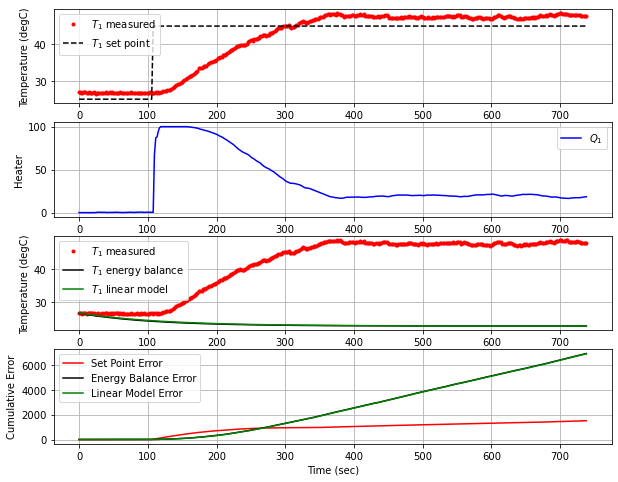

T1 NIH BOS  [48.05 47.99 47.96 47.99 47.98 47.98 48.16 48.   47.9  47.73 47.7  47.63
 47.69 47.76 47.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 741.6  45.00  47.73   0.00  18.38


<Figure size 432x288 with 0 Axes>

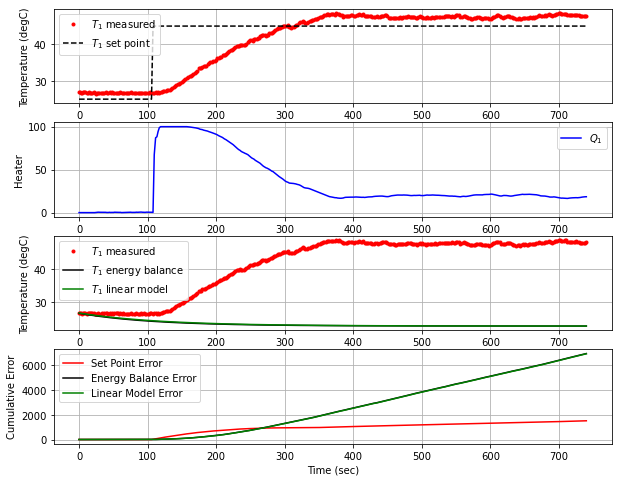

T1 NIH BOS  [47.99 47.96 47.99 47.98 47.98 48.16 48.   47.9  47.73 47.7  47.63 47.69
 47.76 47.88 47.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 743.4  45.00  47.48   0.00  18.47


<Figure size 432x288 with 0 Axes>

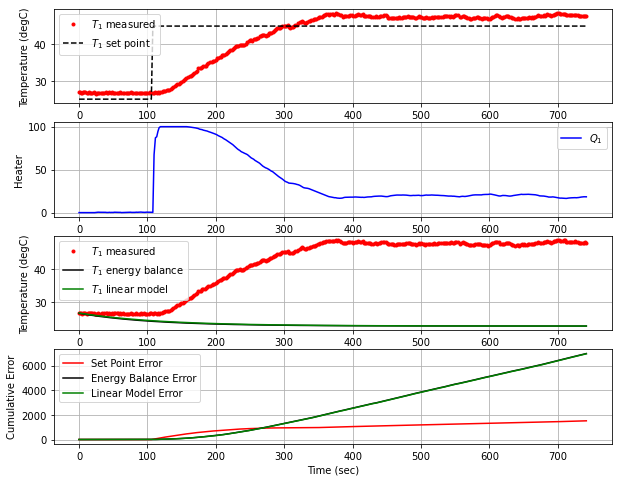

T1 NIH BOS  [47.96 47.99 47.98 47.98 48.16 48.   47.9  47.73 47.7  47.63 47.69 47.76
 47.88 47.73 47.48]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 745.1  45.00  47.33   0.00  18.79


<Figure size 432x288 with 0 Axes>

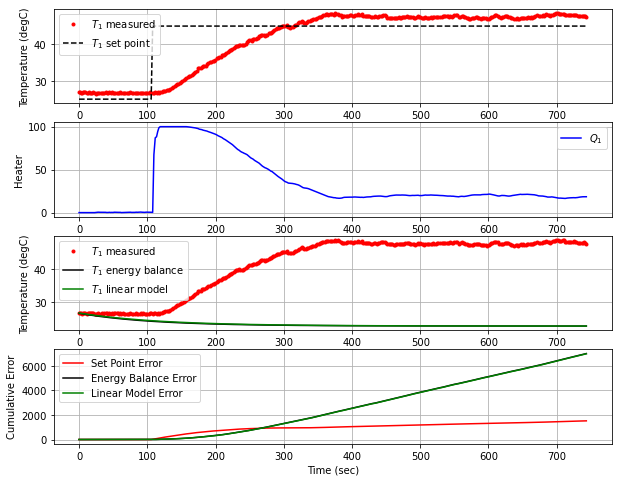

T1 NIH BOS  [47.99 47.98 47.98 48.16 48.   47.9  47.73 47.7  47.63 47.69 47.76 47.88
 47.73 47.48 47.33]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 746.8  45.00  47.56   0.00  19.16


<Figure size 432x288 with 0 Axes>

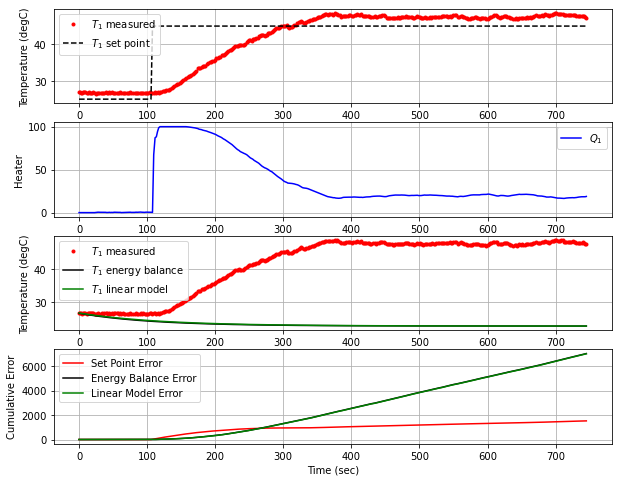

T1 NIH BOS  [47.98 47.98 48.16 48.   47.9  47.73 47.7  47.63 47.69 47.76 47.88 47.73
 47.48 47.33 47.56]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 748.6  45.00  47.30   0.00  19.20


<Figure size 432x288 with 0 Axes>

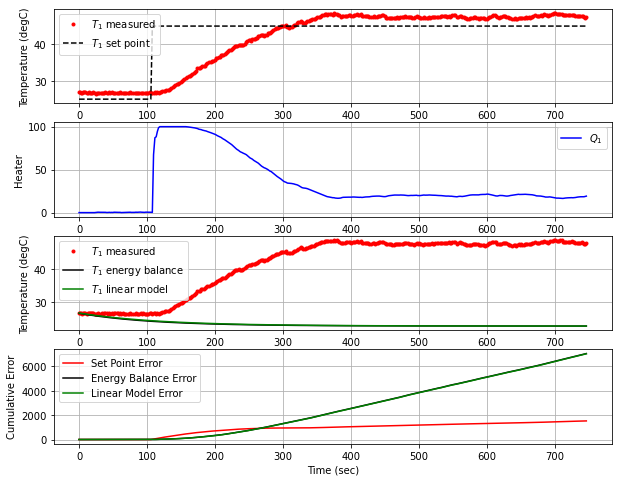

T1 NIH BOS  [47.98 48.16 48.   47.9  47.73 47.7  47.63 47.69 47.76 47.88 47.73 47.48
 47.33 47.56 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 750.5  45.00  47.02   0.00  19.47


<Figure size 432x288 with 0 Axes>

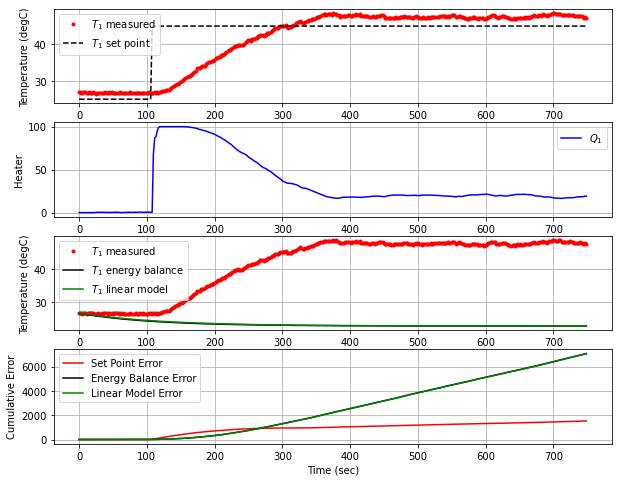

T1 NIH BOS  [48.16 48.   47.9  47.73 47.7  47.63 47.69 47.76 47.88 47.73 47.48 47.33
 47.56 47.3  47.02]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 752.4  45.00  47.01   0.00  19.96


<Figure size 432x288 with 0 Axes>

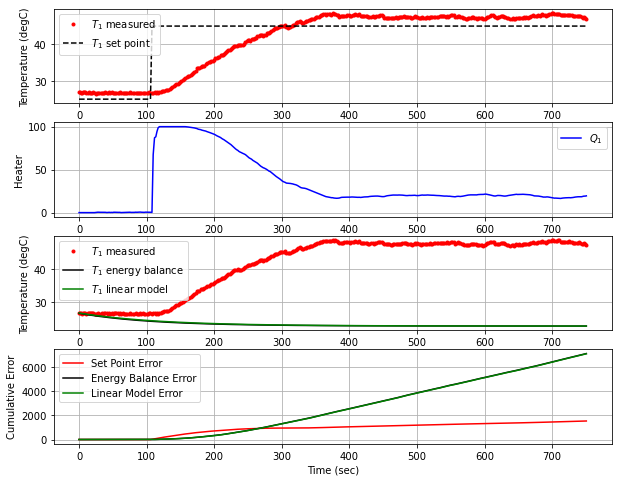

T1 NIH BOS  [48.   47.9  47.73 47.7  47.63 47.69 47.76 47.88 47.73 47.48 47.33 47.56
 47.3  47.02 47.01]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 754.1  45.00  46.98   0.00  20.34


<Figure size 432x288 with 0 Axes>

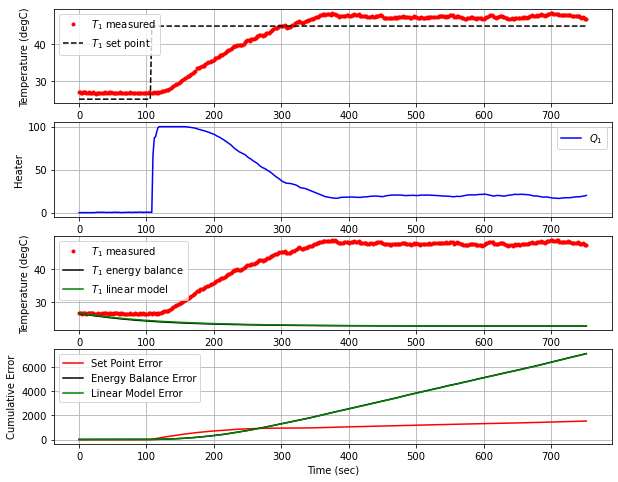

T1 NIH BOS  [47.9  47.73 47.7  47.63 47.69 47.76 47.88 47.73 47.48 47.33 47.56 47.3
 47.02 47.01 46.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 755.9  45.00  46.93   0.00  20.64


<Figure size 432x288 with 0 Axes>

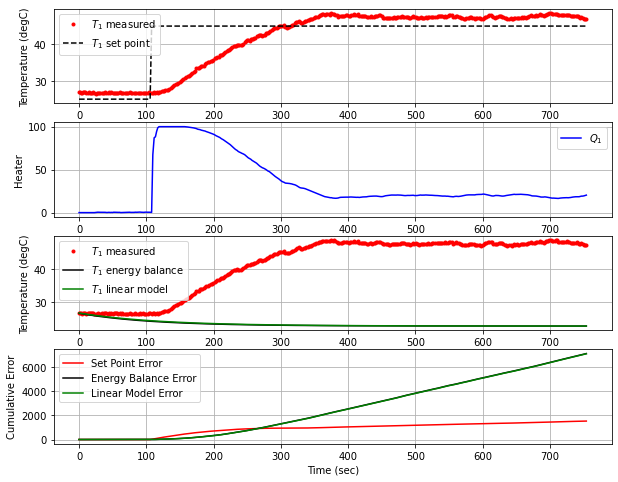

T1 NIH BOS  [47.73 47.7  47.63 47.69 47.76 47.88 47.73 47.48 47.33 47.56 47.3  47.02
 47.01 46.98 46.93]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 757.6  45.00  46.77   0.00  20.92


<Figure size 432x288 with 0 Axes>

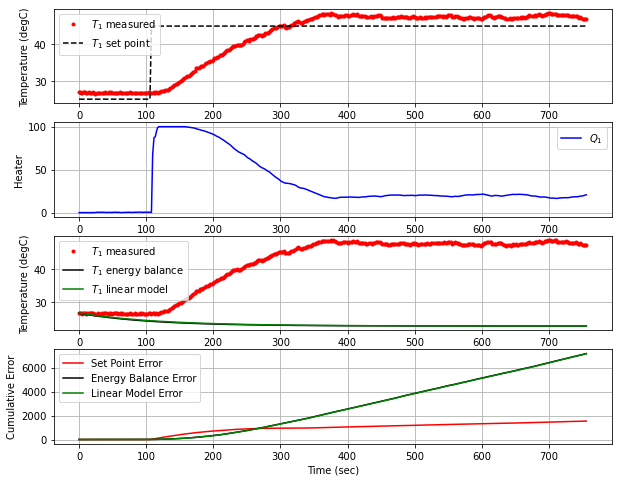

T1 NIH BOS  [47.7  47.63 47.69 47.76 47.88 47.73 47.48 47.33 47.56 47.3  47.02 47.01
 46.98 46.93 46.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 759.6  45.00  46.71   0.00  21.30


<Figure size 432x288 with 0 Axes>

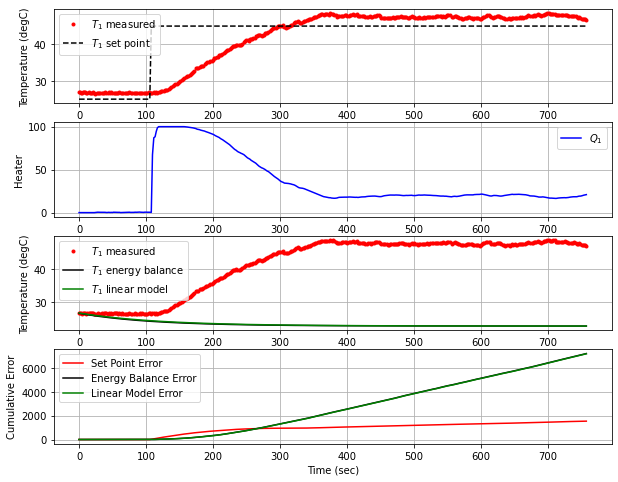

T1 NIH BOS  [47.63 47.69 47.76 47.88 47.73 47.48 47.33 47.56 47.3  47.02 47.01 46.98
 46.93 46.77 46.71]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 761.2  45.00  46.76   0.00  21.66


<Figure size 432x288 with 0 Axes>

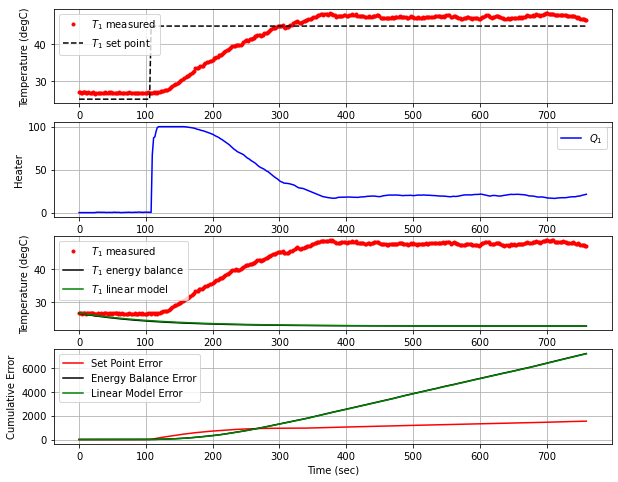

T1 NIH BOS  [47.69 47.76 47.88 47.73 47.48 47.33 47.56 47.3  47.02 47.01 46.98 46.93
 46.77 46.71 46.76]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 763.0  45.00  46.79   0.00  21.88


<Figure size 432x288 with 0 Axes>

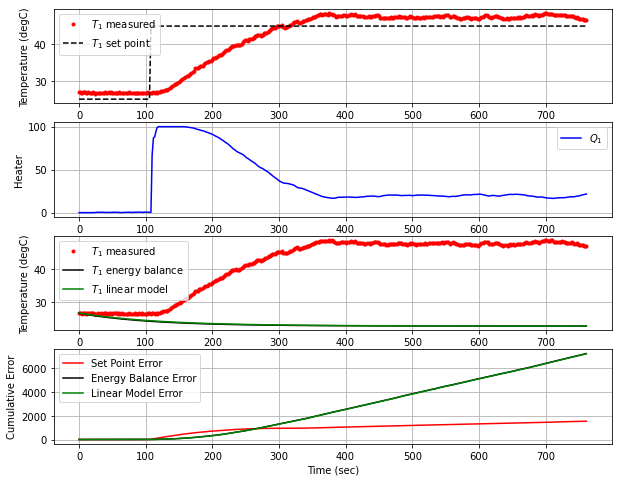

T1 NIH BOS  [47.76 47.88 47.73 47.48 47.33 47.56 47.3  47.02 47.01 46.98 46.93 46.77
 46.71 46.76 46.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 764.7  45.00  46.74   0.00  22.05


<Figure size 432x288 with 0 Axes>

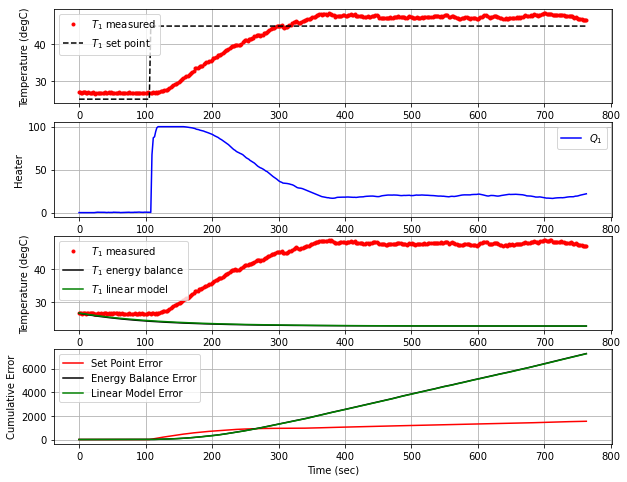

T1 NIH BOS  [47.88 47.73 47.48 47.33 47.56 47.3  47.02 47.01 46.98 46.93 46.77 46.71
 46.76 46.79 46.74]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 766.4  45.00  46.65   0.00  22.27


<Figure size 432x288 with 0 Axes>

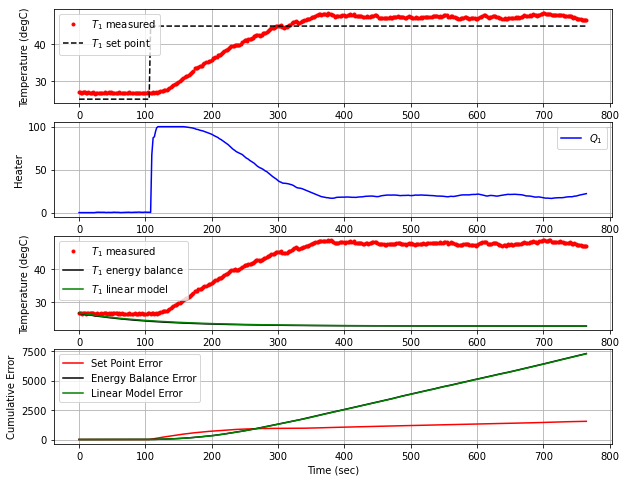

T1 NIH BOS  [47.73 47.48 47.33 47.56 47.3  47.02 47.01 46.98 46.93 46.77 46.71 46.76
 46.79 46.74 46.65]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 768.4  45.00  47.14   0.00  22.56


<Figure size 432x288 with 0 Axes>

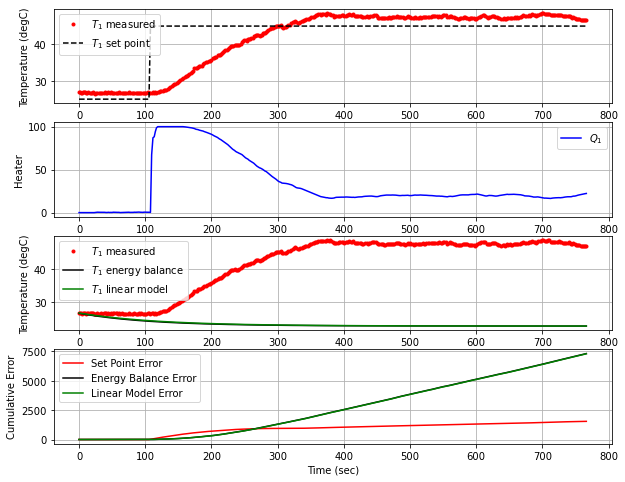

T1 NIH BOS  [47.48 47.33 47.56 47.3  47.02 47.01 46.98 46.93 46.77 46.71 46.76 46.79
 46.74 46.65 47.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 770.4  45.00  47.03   0.00  22.31


<Figure size 432x288 with 0 Axes>

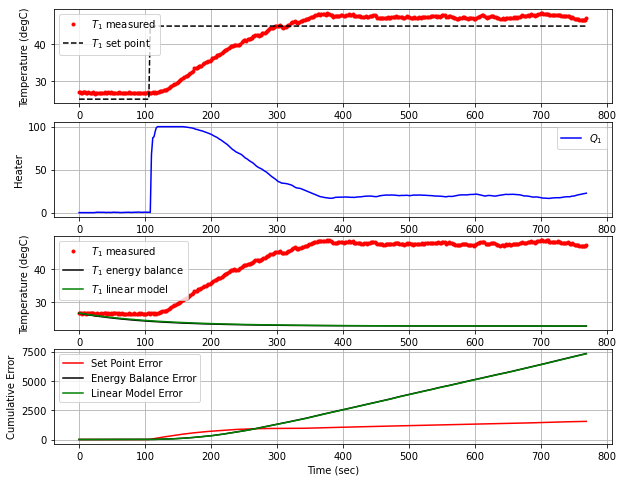

T1 NIH BOS  [47.33 47.56 47.3  47.02 47.01 46.98 46.93 46.77 46.71 46.76 46.79 46.74
 46.65 47.14 47.03]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 772.2  45.00  47.28   0.00  22.24


<Figure size 432x288 with 0 Axes>

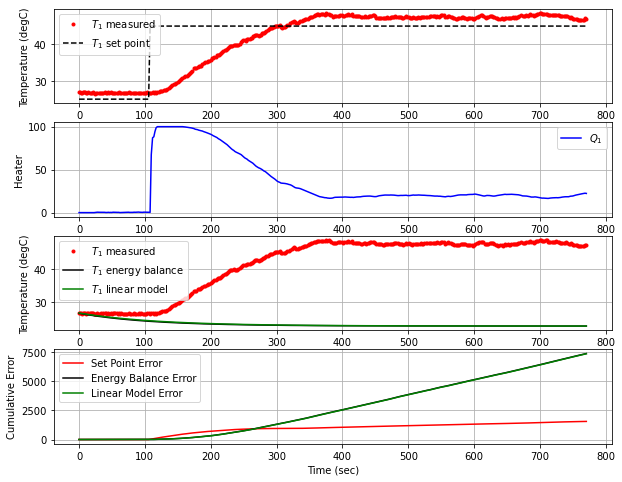

T1 NIH BOS  [47.56 47.3  47.02 47.01 46.98 46.93 46.77 46.71 46.76 46.79 46.74 46.65
 47.14 47.03 47.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 773.9  45.00  47.50   0.00  21.98


<Figure size 432x288 with 0 Axes>

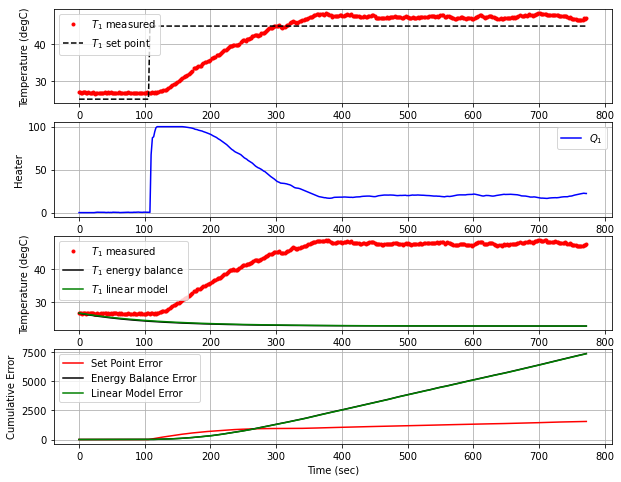

T1 NIH BOS  [47.3  47.02 47.01 46.98 46.93 46.77 46.71 46.76 46.79 46.74 46.65 47.14
 47.03 47.28 47.5 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 775.7  45.00  47.54   0.00  21.60


<Figure size 432x288 with 0 Axes>

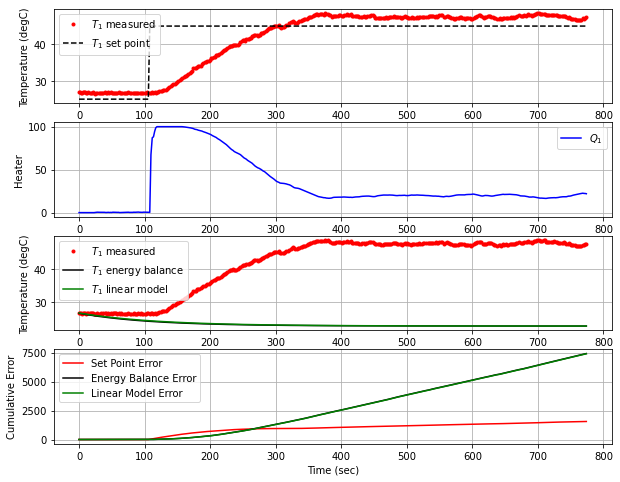

T1 NIH BOS  [47.02 47.01 46.98 46.93 46.77 46.71 46.76 46.79 46.74 46.65 47.14 47.03
 47.28 47.5  47.54]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 777.4  45.00  47.92   0.00  21.29


<Figure size 432x288 with 0 Axes>

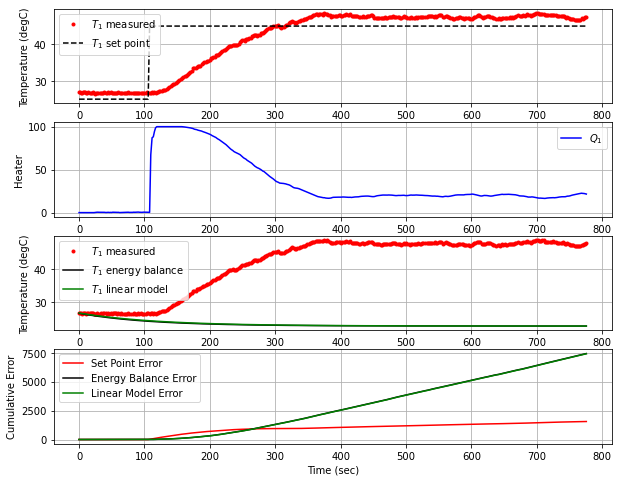

T1 NIH BOS  [47.01 46.98 46.93 46.77 46.71 46.76 46.79 46.74 46.65 47.14 47.03 47.28
 47.5  47.54 47.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 779.2  45.00  47.62   0.00  20.67


<Figure size 432x288 with 0 Axes>

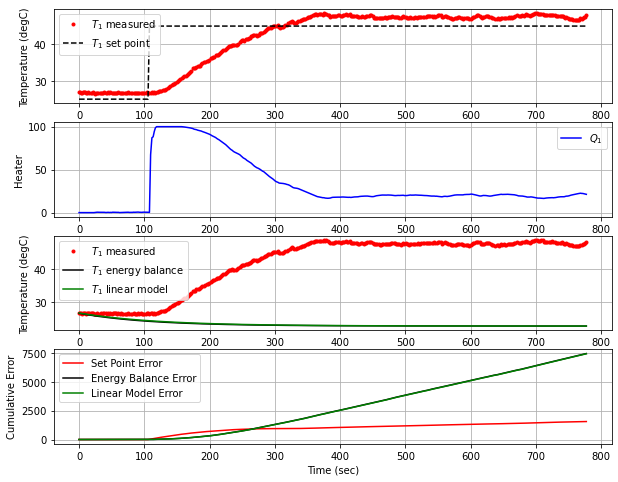

T1 NIH BOS  [46.98 46.93 46.77 46.71 46.76 46.79 46.74 46.65 47.14 47.03 47.28 47.5
 47.54 47.92 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 781.0  45.00  47.42   0.00  20.49


<Figure size 432x288 with 0 Axes>

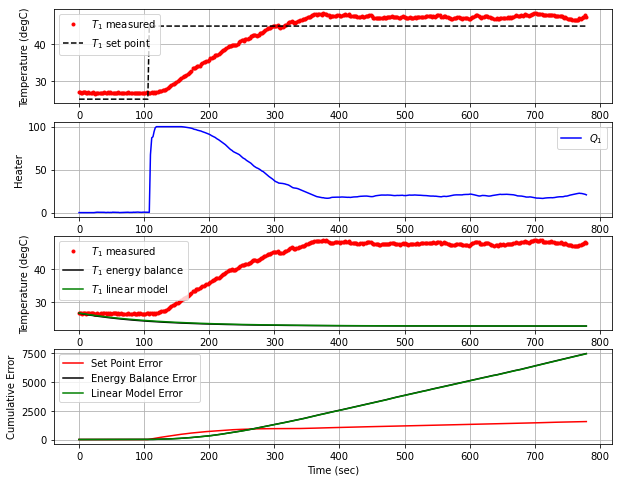

T1 NIH BOS  [46.93 46.77 46.71 46.76 46.79 46.74 46.65 47.14 47.03 47.28 47.5  47.54
 47.92 47.62 47.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 783.1  45.00  47.58   0.00  20.55


<Figure size 432x288 with 0 Axes>

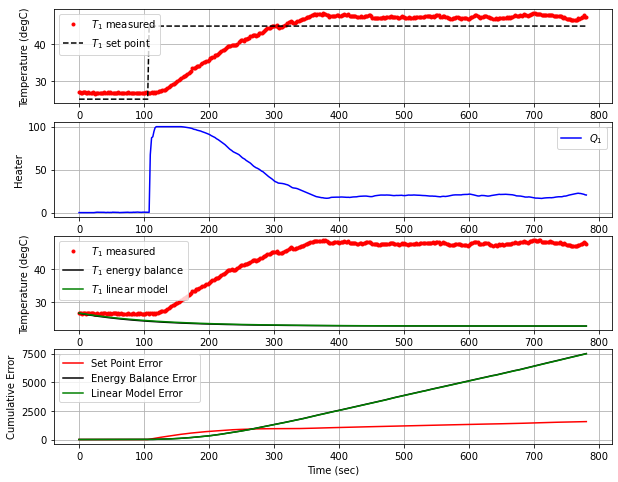

T1 NIH BOS  [46.77 46.71 46.76 46.79 46.74 46.65 47.14 47.03 47.28 47.5  47.54 47.92
 47.62 47.42 47.58]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 785.0  45.00  47.62   0.00  20.38


<Figure size 432x288 with 0 Axes>

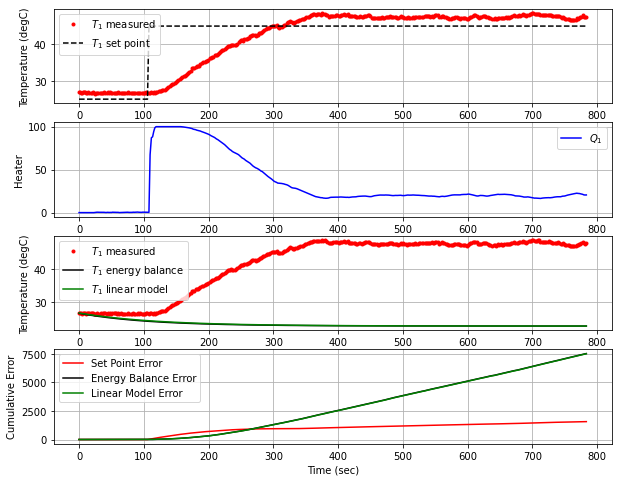

T1 NIH BOS  [46.71 46.76 46.79 46.74 46.65 47.14 47.03 47.28 47.5  47.54 47.92 47.62
 47.42 47.58 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 786.8  45.00  47.78   0.00  20.15


<Figure size 432x288 with 0 Axes>

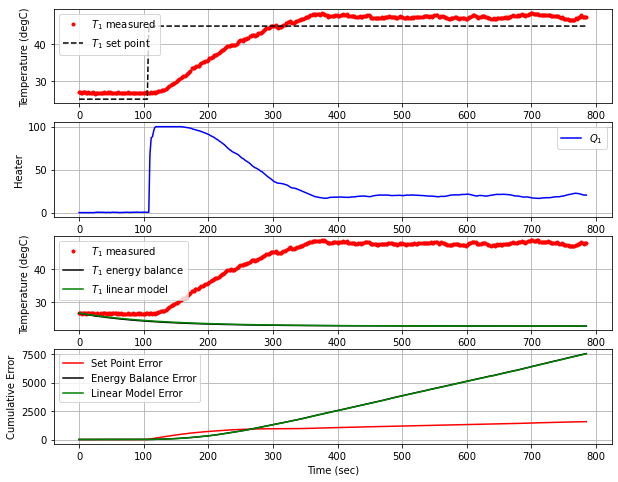

T1 NIH BOS  [46.76 46.79 46.74 46.65 47.14 47.03 47.28 47.5  47.54 47.92 47.62 47.42
 47.58 47.62 47.78]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 788.5  45.00  47.44   0.00  19.80


<Figure size 432x288 with 0 Axes>

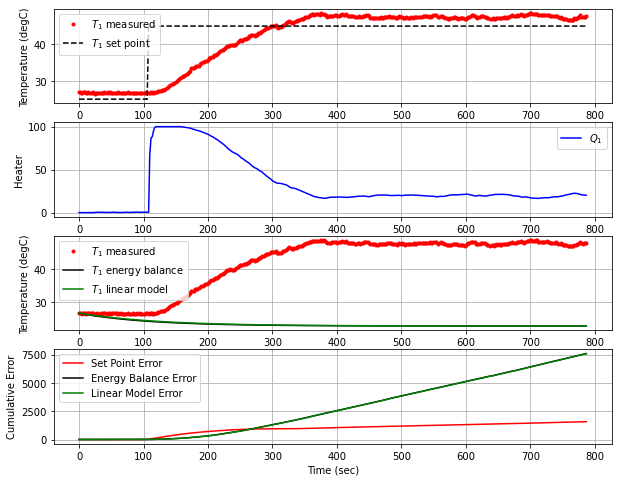

T1 NIH BOS  [46.79 46.74 46.65 47.14 47.03 47.28 47.5  47.54 47.92 47.62 47.42 47.58
 47.62 47.78 47.44]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 790.5  45.00  47.43   0.00  19.86


<Figure size 432x288 with 0 Axes>

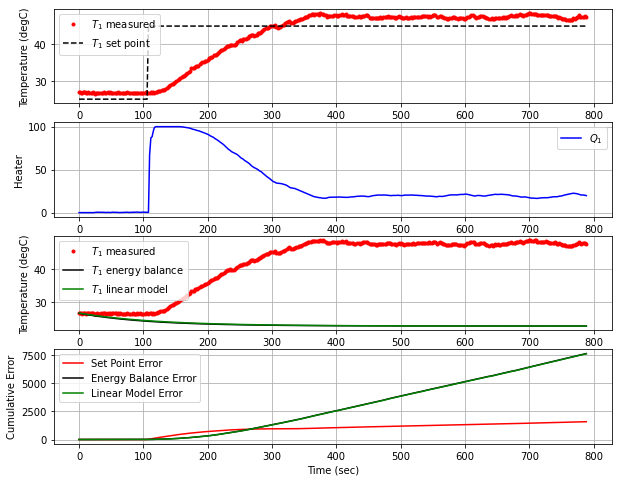

T1 NIH BOS  [46.74 46.65 47.14 47.03 47.28 47.5  47.54 47.92 47.62 47.42 47.58 47.62
 47.78 47.44 47.43]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
 792.7  45.00  47.22   0.00  19.91


<Figure size 432x288 with 0 Axes>

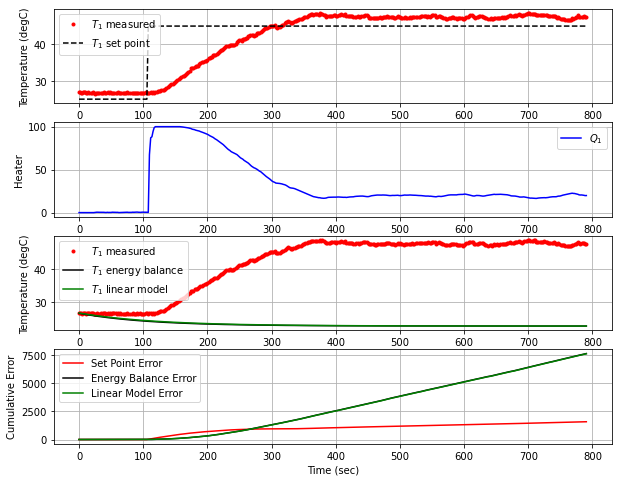

T1 NIH BOS  [46.65 47.14 47.03 47.28 47.5  47.54 47.92 47.62 47.42 47.58 47.62 47.78
 47.44 47.43 47.22]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
 794.8  45.00  47.41   0.00  20.10


<Figure size 432x288 with 0 Axes>

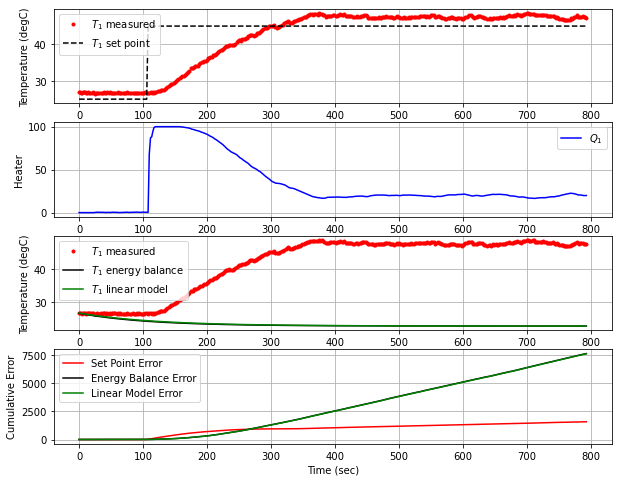

T1 NIH BOS  [47.14 47.03 47.28 47.5  47.54 47.92 47.62 47.42 47.58 47.62 47.78 47.44
 47.43 47.22 47.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 796.6  45.00  47.45   0.00  20.02


<Figure size 432x288 with 0 Axes>

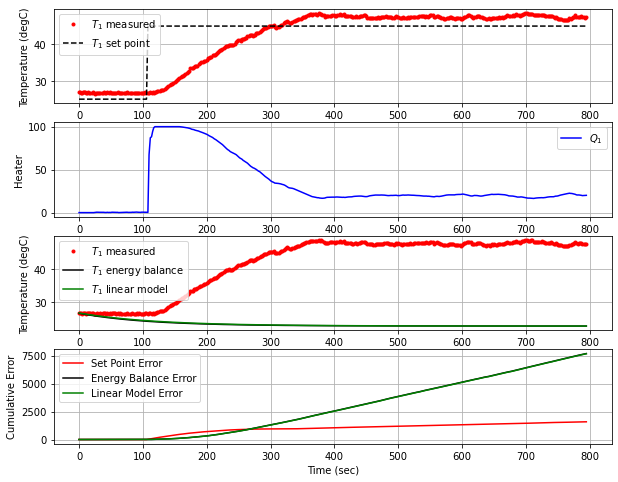

T1 NIH BOS  [47.03 47.28 47.5  47.54 47.92 47.62 47.42 47.58 47.62 47.78 47.44 47.43
 47.22 47.41 47.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 798.5  45.00  47.55   0.00  19.94


<Figure size 432x288 with 0 Axes>

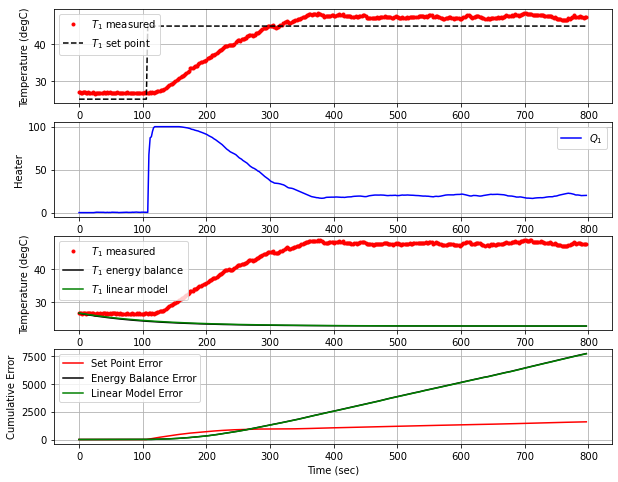

T1 NIH BOS  [47.28 47.5  47.54 47.92 47.62 47.42 47.58 47.62 47.78 47.44 47.43 47.22
 47.41 47.45 47.55]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 800.4  45.00  47.66   0.00  19.79


<Figure size 432x288 with 0 Axes>

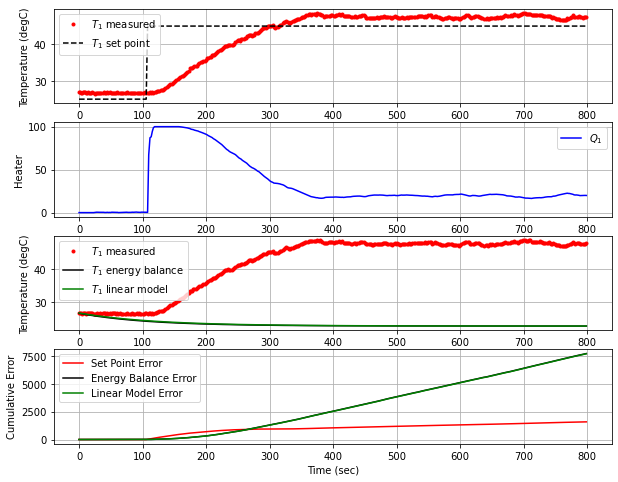

T1 NIH BOS  [47.5  47.54 47.92 47.62 47.42 47.58 47.62 47.78 47.44 47.43 47.22 47.41
 47.45 47.55 47.66]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 802.3  45.00  47.59   0.00  19.61


<Figure size 432x288 with 0 Axes>

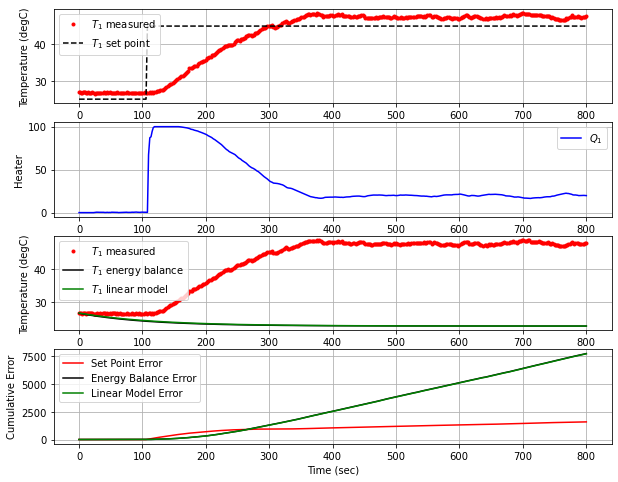

T1 NIH BOS  [47.54 47.92 47.62 47.42 47.58 47.62 47.78 47.44 47.43 47.22 47.41 47.45
 47.55 47.66 47.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 804.0  45.00  47.23   0.00  19.57


<Figure size 432x288 with 0 Axes>

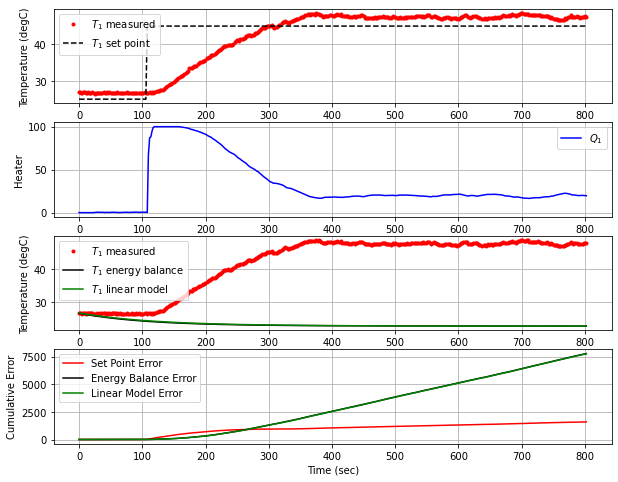

T1 NIH BOS  [47.92 47.62 47.42 47.58 47.62 47.78 47.44 47.43 47.22 47.41 47.45 47.55
 47.66 47.59 47.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 805.8  45.00  47.07   0.00  19.90


<Figure size 432x288 with 0 Axes>

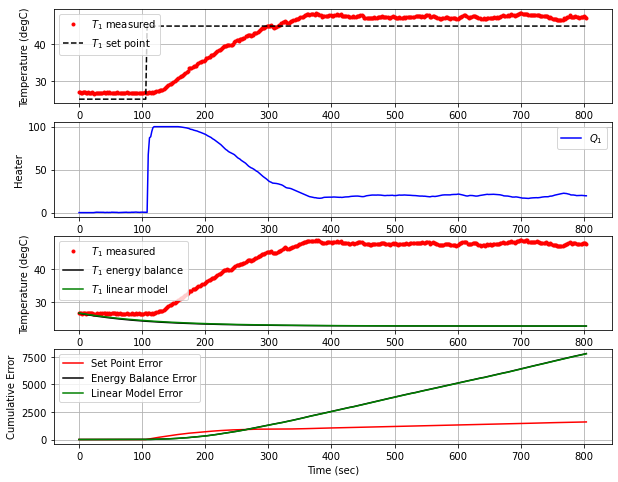

T1 NIH BOS  [47.62 47.42 47.58 47.62 47.78 47.44 47.43 47.22 47.41 47.45 47.55 47.66
 47.59 47.23 47.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 807.8  45.00  47.28   0.00  20.33


<Figure size 432x288 with 0 Axes>

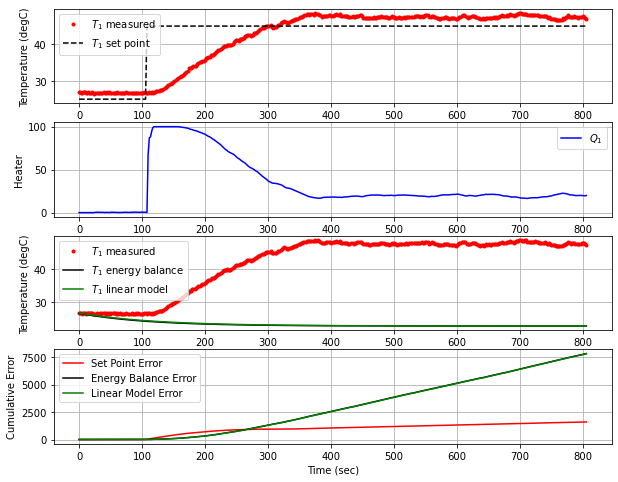

T1 NIH BOS  [47.42 47.58 47.62 47.78 47.44 47.43 47.22 47.41 47.45 47.55 47.66 47.59
 47.23 47.07 47.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 809.6  45.00  47.43   0.00  20.38


<Figure size 432x288 with 0 Axes>

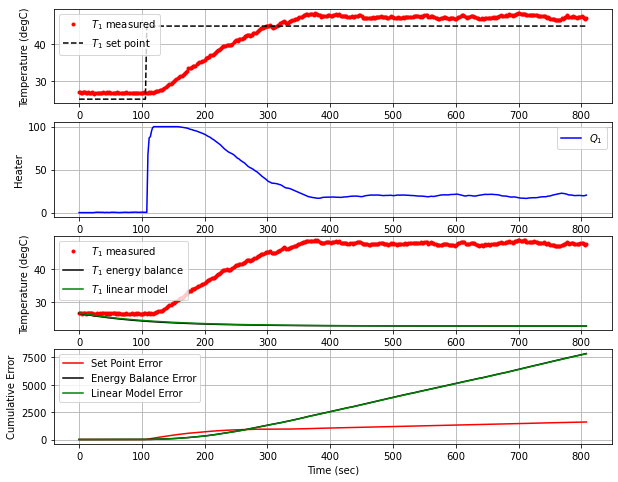

T1 NIH BOS  [47.58 47.62 47.78 47.44 47.43 47.22 47.41 47.45 47.55 47.66 47.59 47.23
 47.07 47.28 47.43]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 811.3  45.00  47.41   0.00  20.24


<Figure size 432x288 with 0 Axes>

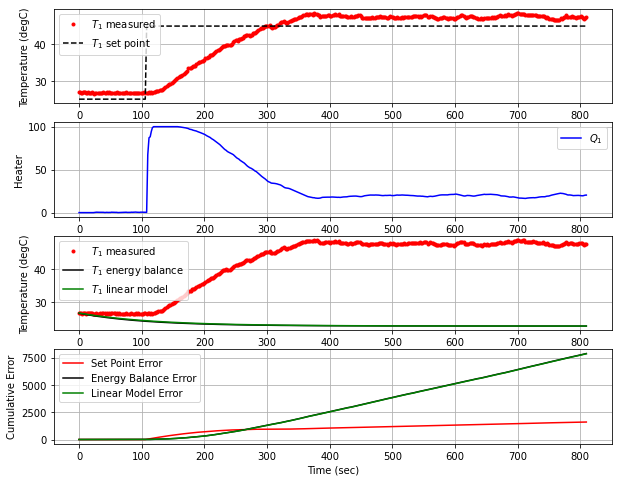

T1 NIH BOS  [47.62 47.78 47.44 47.43 47.22 47.41 47.45 47.55 47.66 47.59 47.23 47.07
 47.28 47.43 47.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 813.1  45.00  47.43   0.00  20.20


<Figure size 432x288 with 0 Axes>

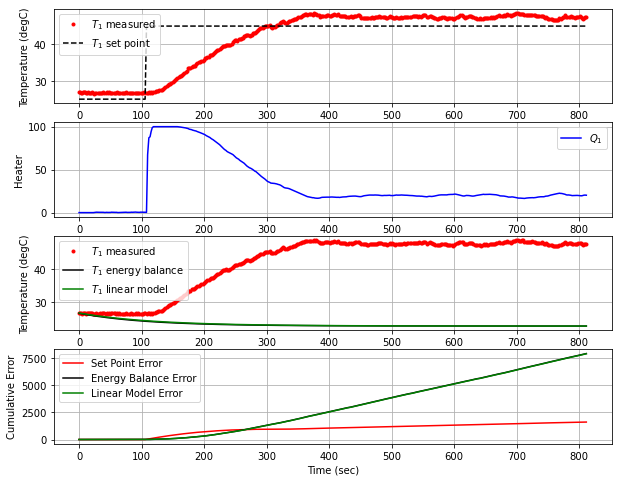

T1 NIH BOS  [47.78 47.44 47.43 47.22 47.41 47.45 47.55 47.66 47.59 47.23 47.07 47.28
 47.43 47.41 47.43]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 815.0  45.00  47.26   0.00  20.18


<Figure size 432x288 with 0 Axes>

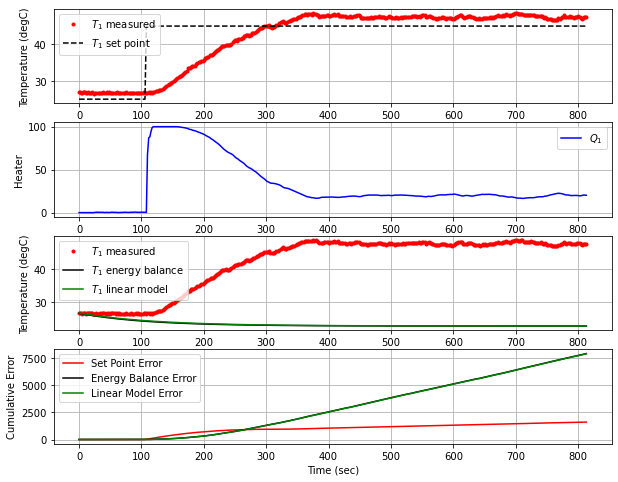

T1 NIH BOS  [47.44 47.43 47.22 47.41 47.45 47.55 47.66 47.59 47.23 47.07 47.28 47.43
 47.41 47.43 47.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 816.9  45.00  47.27   0.00  20.36


<Figure size 432x288 with 0 Axes>

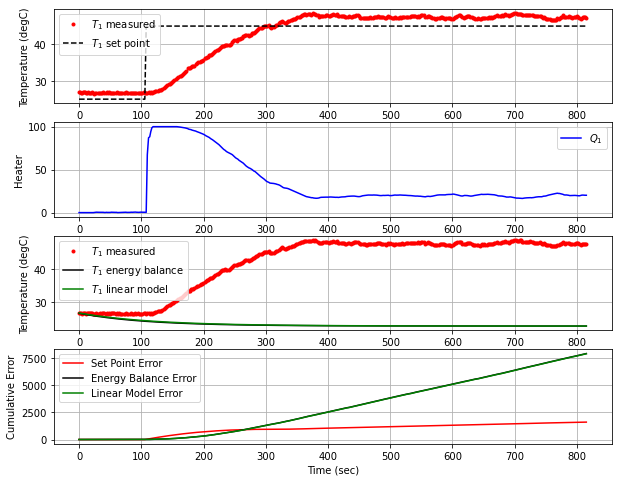

T1 NIH BOS  [47.43 47.22 47.41 47.45 47.55 47.66 47.59 47.23 47.07 47.28 47.43 47.41
 47.43 47.26 47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 818.9  45.00  47.23   0.00  20.46


<Figure size 432x288 with 0 Axes>

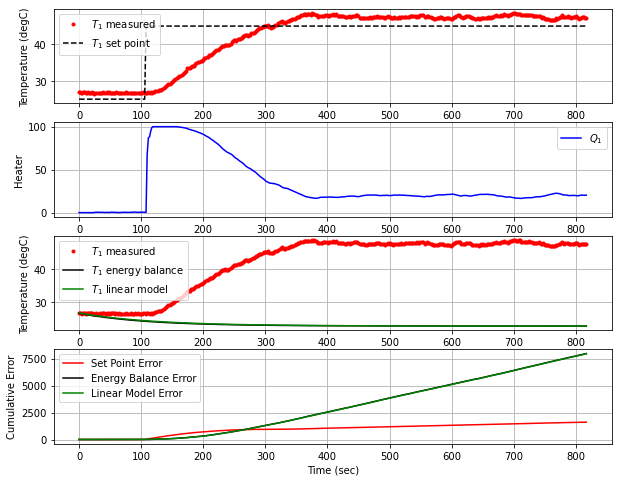

T1 NIH BOS  [47.22 47.41 47.45 47.55 47.66 47.59 47.23 47.07 47.28 47.43 47.41 47.43
 47.26 47.27 47.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 820.7  45.00  47.45   0.00  20.56


<Figure size 432x288 with 0 Axes>

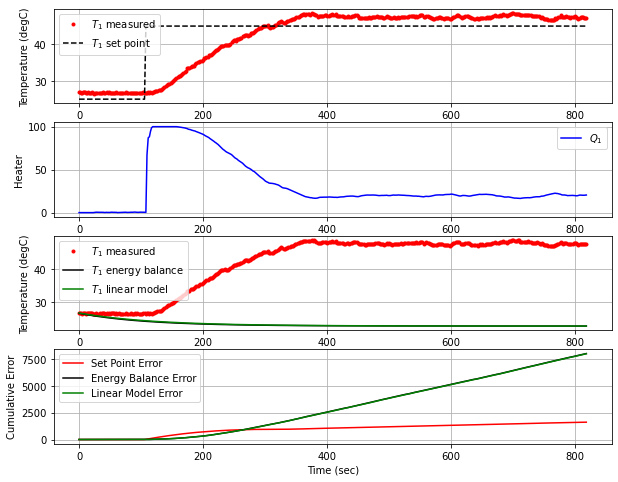

T1 NIH BOS  [47.41 47.45 47.55 47.66 47.59 47.23 47.07 47.28 47.43 47.41 47.43 47.26
 47.27 47.23 47.45]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 822.3  45.00  47.47   0.00  20.40


<Figure size 432x288 with 0 Axes>

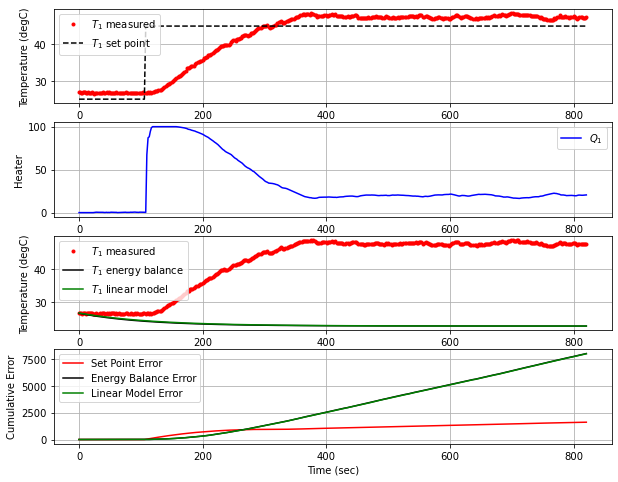

T1 NIH BOS  [47.45 47.55 47.66 47.59 47.23 47.07 47.28 47.43 47.41 47.43 47.26 47.27
 47.23 47.45 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 824.0  45.00  47.62   0.00  20.28


<Figure size 432x288 with 0 Axes>

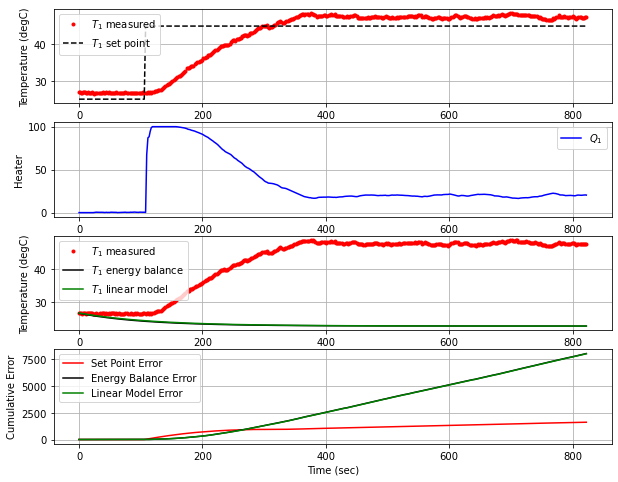

T1 NIH BOS  [47.55 47.66 47.59 47.23 47.07 47.28 47.43 47.41 47.43 47.26 47.27 47.23
 47.45 47.47 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 825.6  45.00  47.60   0.00  20.07


<Figure size 432x288 with 0 Axes>

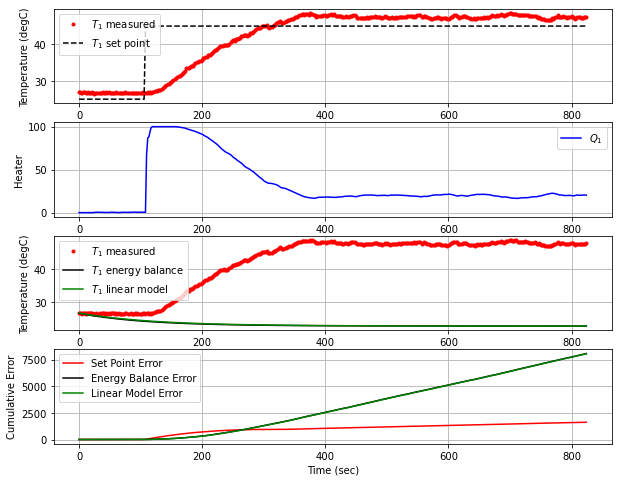

T1 NIH BOS  [47.66 47.59 47.23 47.07 47.28 47.43 47.41 47.43 47.26 47.27 47.23 47.45
 47.47 47.62 47.6 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 827.3  45.00  47.83   0.00  19.96


<Figure size 432x288 with 0 Axes>

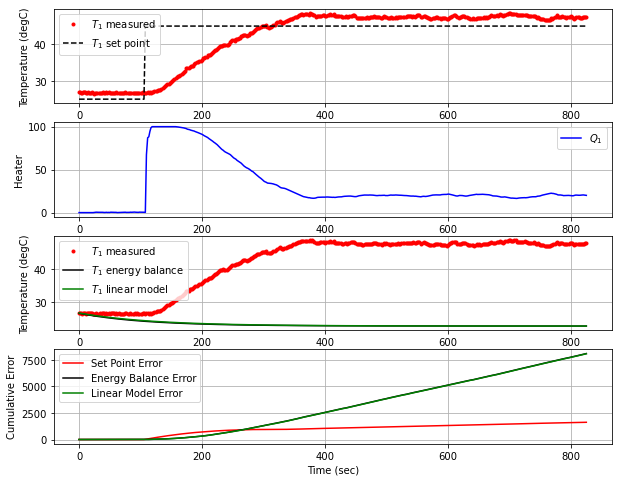

T1 NIH BOS  [47.59 47.23 47.07 47.28 47.43 47.41 47.43 47.26 47.27 47.23 47.45 47.47
 47.62 47.6  47.83]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 829.0  45.00  47.82   0.00  19.68


<Figure size 432x288 with 0 Axes>

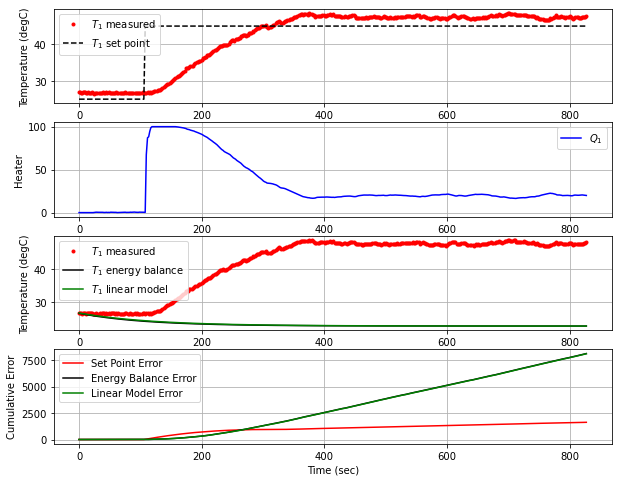

T1 NIH BOS  [47.23 47.07 47.28 47.43 47.41 47.43 47.26 47.27 47.23 47.45 47.47 47.62
 47.6  47.83 47.82]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 831.0  45.00  47.89   0.00  19.47


<Figure size 432x288 with 0 Axes>

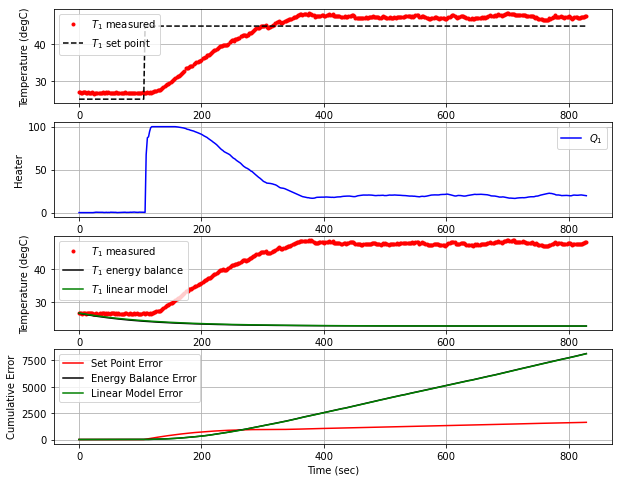

T1 NIH BOS  [47.07 47.28 47.43 47.41 47.43 47.26 47.27 47.23 47.45 47.47 47.62 47.6
 47.83 47.82 47.89]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 832.8  45.00  47.98   0.00  19.24


<Figure size 432x288 with 0 Axes>

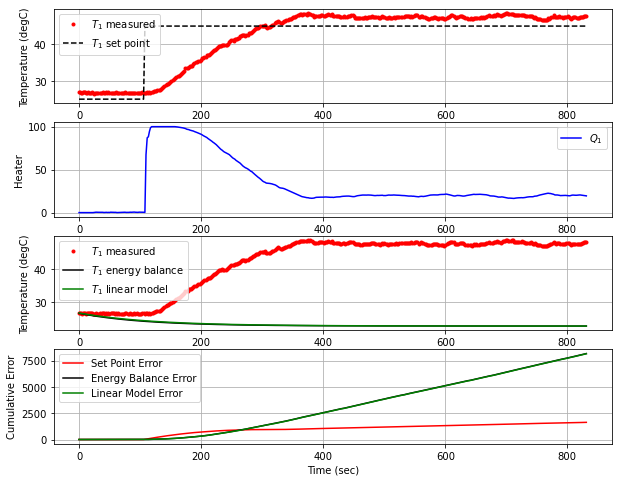

T1 NIH BOS  [47.28 47.43 47.41 47.43 47.26 47.27 47.23 47.45 47.47 47.62 47.6  47.83
 47.82 47.89 47.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 834.4  45.00  48.13   0.00  18.95


<Figure size 432x288 with 0 Axes>

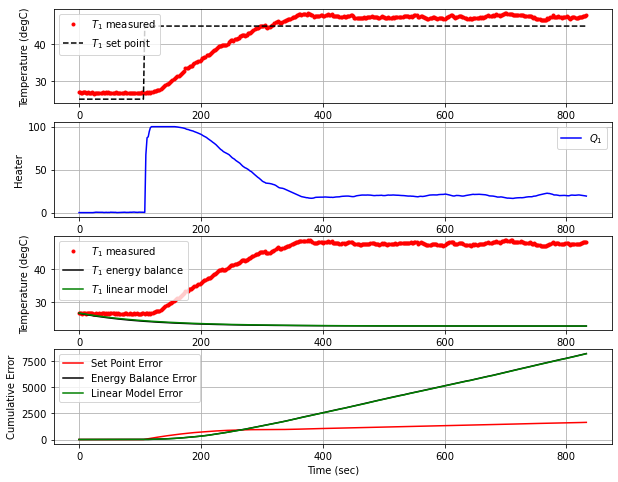

T1 NIH BOS  [47.43 47.41 47.43 47.26 47.27 47.23 47.45 47.47 47.62 47.6  47.83 47.82
 47.89 47.98 48.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 836.1  45.00  48.20   0.00  18.60


<Figure size 432x288 with 0 Axes>

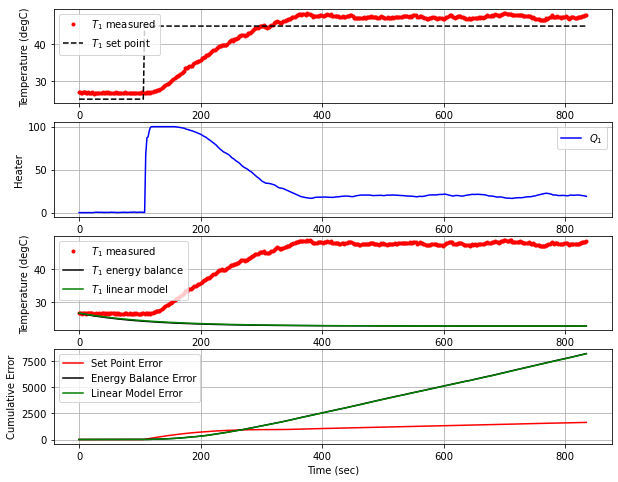

T1 NIH BOS  [47.41 47.43 47.26 47.27 47.23 47.45 47.47 47.62 47.6  47.83 47.82 47.89
 47.98 48.13 48.2 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 52ms/step
 837.9  45.00  48.59   0.00  18.28


<Figure size 432x288 with 0 Axes>

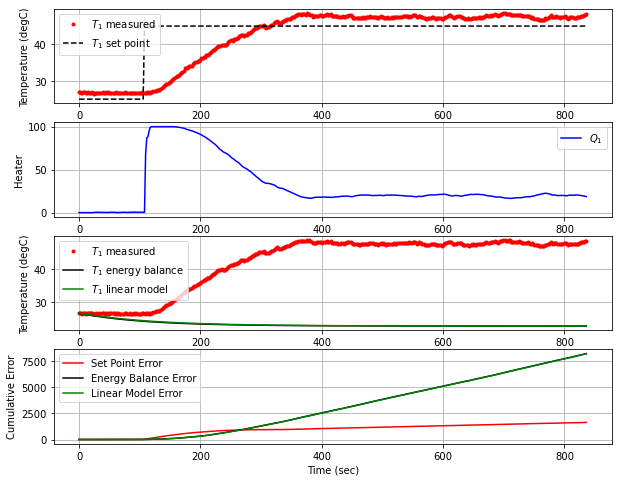

T1 NIH BOS  [47.43 47.26 47.27 47.23 47.45 47.47 47.62 47.6  47.83 47.82 47.89 47.98
 48.13 48.2  48.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 839.7  45.00  48.57   0.00  17.68


<Figure size 432x288 with 0 Axes>

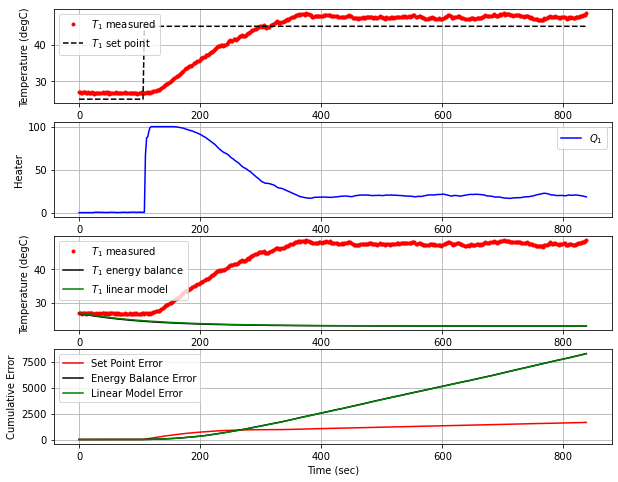

T1 NIH BOS  [47.26 47.27 47.23 47.45 47.47 47.62 47.6  47.83 47.82 47.89 47.98 48.13
 48.2  48.59 48.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 841.4  45.00  48.38   0.00  17.25


<Figure size 432x288 with 0 Axes>

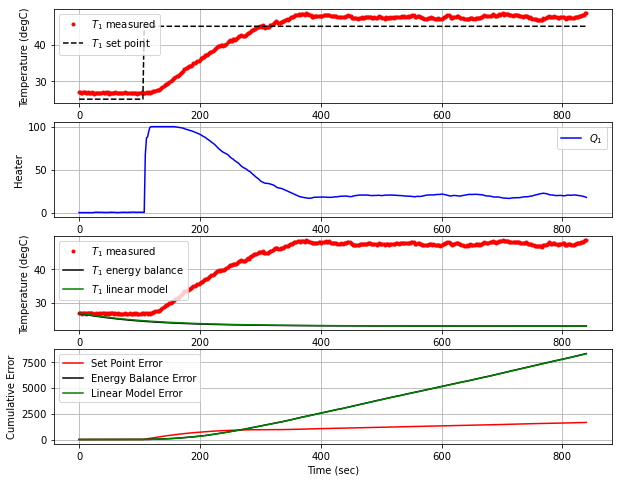

T1 NIH BOS  [47.27 47.23 47.45 47.47 47.62 47.6  47.83 47.82 47.89 47.98 48.13 48.2
 48.59 48.57 48.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 843.6  45.00  48.26   0.00  17.11


<Figure size 432x288 with 0 Axes>

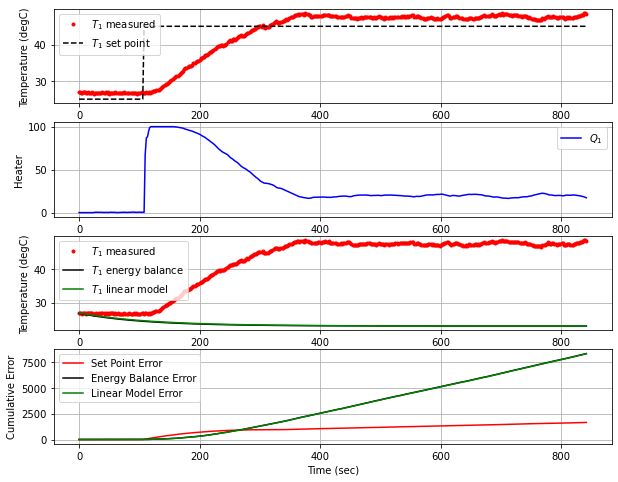

T1 NIH BOS  [47.23 47.45 47.47 47.62 47.6  47.83 47.82 47.89 47.98 48.13 48.2  48.59
 48.57 48.38 48.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 845.5  45.00  47.88   0.00  17.10


<Figure size 432x288 with 0 Axes>

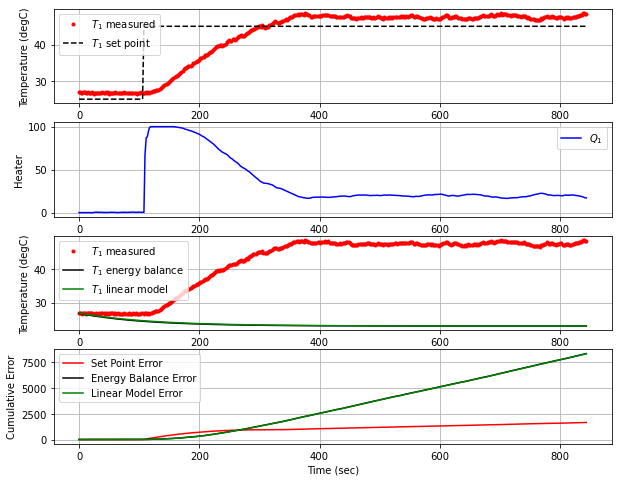

T1 NIH BOS  [47.45 47.47 47.62 47.6  47.83 47.82 47.89 47.98 48.13 48.2  48.59 48.57
 48.38 48.26 47.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 54ms/step
 847.4  45.00  47.85   0.00  17.39


<Figure size 432x288 with 0 Axes>

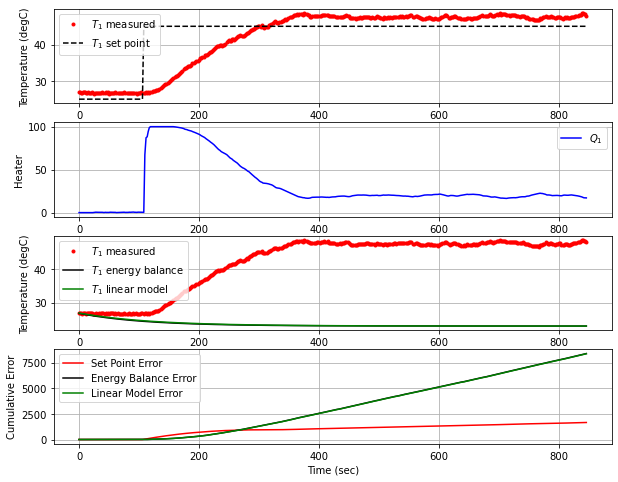

T1 NIH BOS  [47.47 47.62 47.6  47.83 47.82 47.89 47.98 48.13 48.2  48.59 48.57 48.38
 48.26 47.88 47.85]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 849.2  45.00  47.72   0.00  17.60


<Figure size 432x288 with 0 Axes>

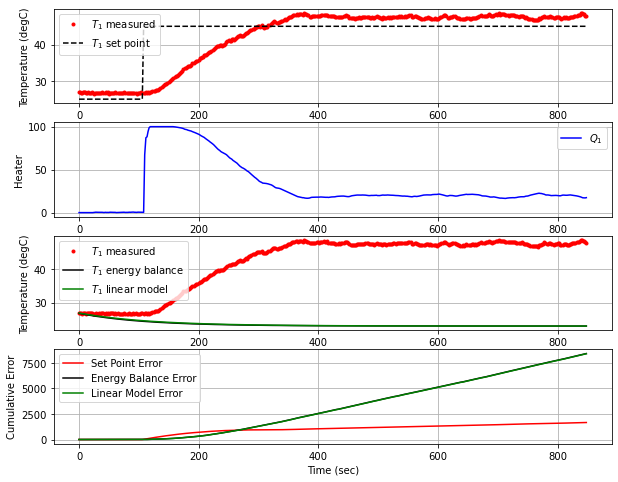

T1 NIH BOS  [47.62 47.6  47.83 47.82 47.89 47.98 48.13 48.2  48.59 48.57 48.38 48.26
 47.88 47.85 47.72]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 851.0  45.00  47.41   0.00  17.82


<Figure size 432x288 with 0 Axes>

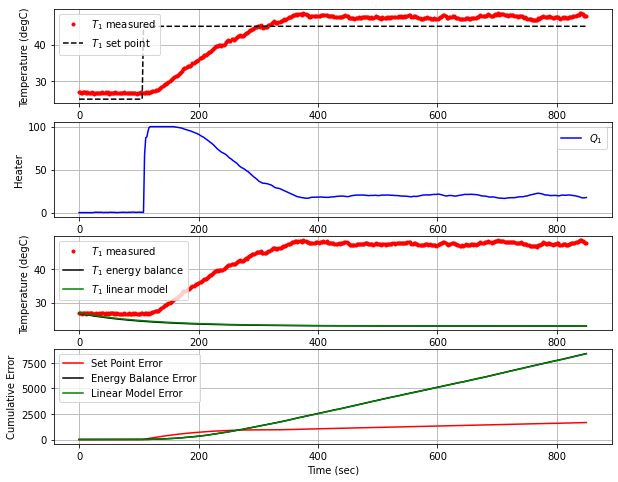

T1 NIH BOS  [47.6  47.83 47.82 47.89 47.98 48.13 48.2  48.59 48.57 48.38 48.26 47.88
 47.85 47.72 47.41]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 852.6  45.00  47.28   0.00  18.24


<Figure size 432x288 with 0 Axes>

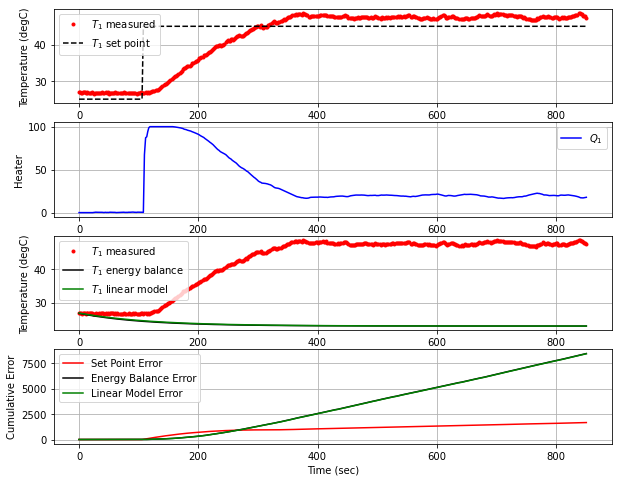

T1 NIH BOS  [47.83 47.82 47.89 47.98 48.13 48.2  48.59 48.57 48.38 48.26 47.88 47.85
 47.72 47.41 47.28]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 854.6  45.00  47.67   0.00  18.67


<Figure size 432x288 with 0 Axes>

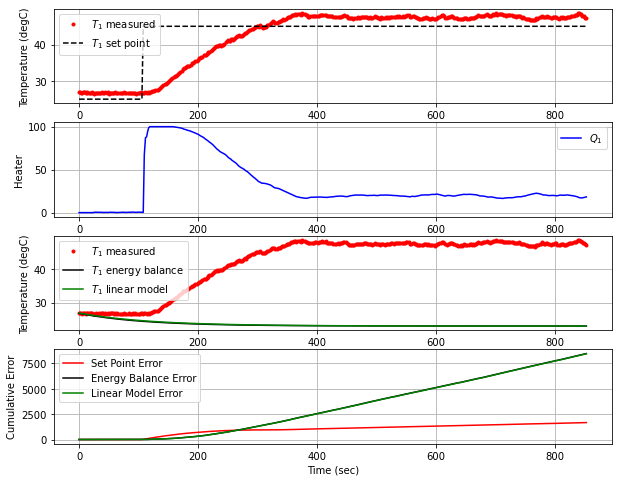

T1 NIH BOS  [47.82 47.89 47.98 48.13 48.2  48.59 48.57 48.38 48.26 47.88 47.85 47.72
 47.41 47.28 47.67]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 34ms/step
 856.3  45.00  47.55   0.00  18.61


<Figure size 432x288 with 0 Axes>

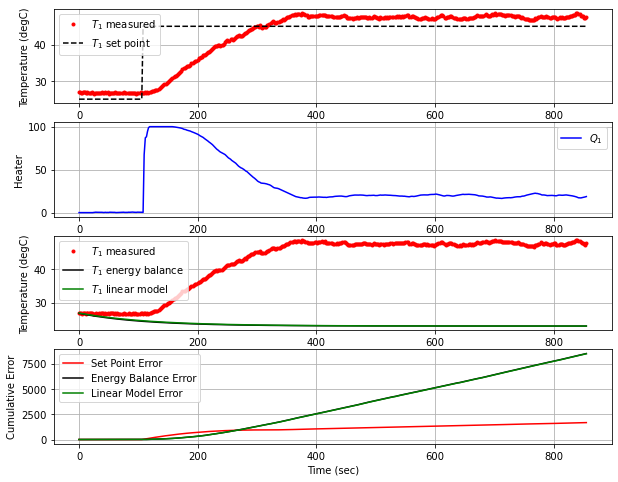

T1 NIH BOS  [47.89 47.98 48.13 48.2  48.59 48.57 48.38 48.26 47.88 47.85 47.72 47.41
 47.28 47.67 47.55]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 858.2  45.00  47.57   0.00  18.68


<Figure size 432x288 with 0 Axes>

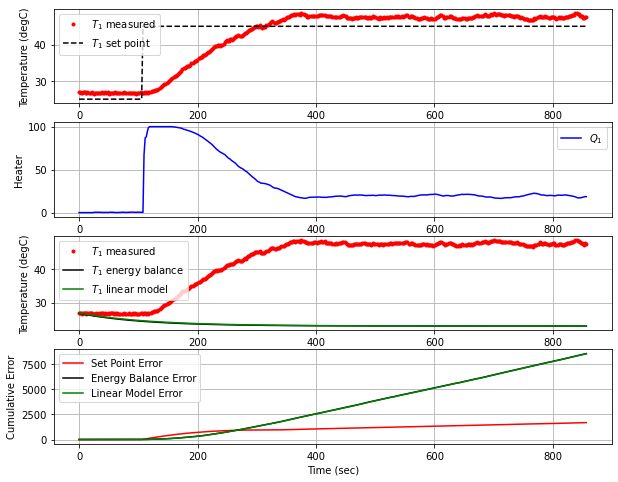

T1 NIH BOS  [47.98 48.13 48.2  48.59 48.57 48.38 48.26 47.88 47.85 47.72 47.41 47.28
 47.67 47.55 47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 859.8  45.00  47.29   0.00  18.78


<Figure size 432x288 with 0 Axes>

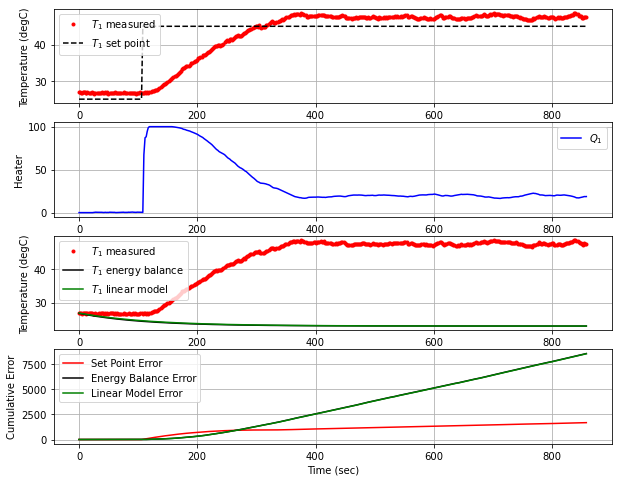

T1 NIH BOS  [48.13 48.2  48.59 48.57 48.38 48.26 47.88 47.85 47.72 47.41 47.28 47.67
 47.55 47.57 47.29]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 861.5  45.00  47.24   0.00  19.14


<Figure size 432x288 with 0 Axes>

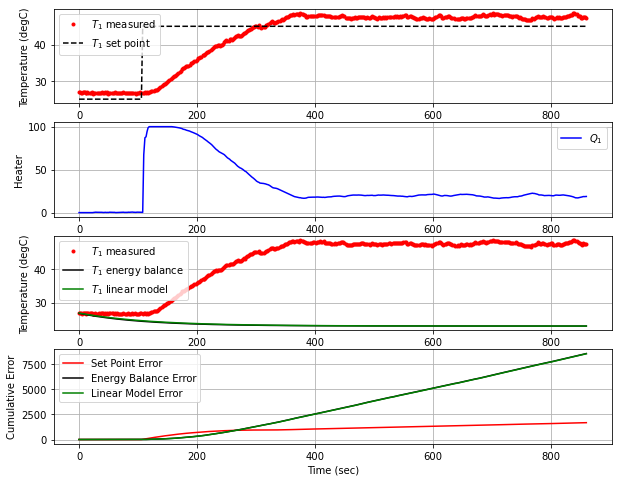

T1 NIH BOS  [48.2  48.59 48.57 48.38 48.26 47.88 47.85 47.72 47.41 47.28 47.67 47.55
 47.57 47.29 47.24]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 863.4  45.00  47.32   0.00  19.49


<Figure size 432x288 with 0 Axes>

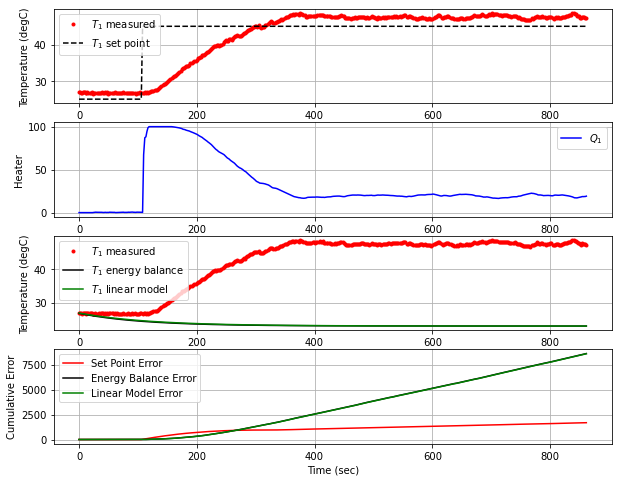

T1 NIH BOS  [48.59 48.57 48.38 48.26 47.88 47.85 47.72 47.41 47.28 47.67 47.55 47.57
 47.29 47.24 47.32]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 865.1  45.00  47.25   0.00  19.67


<Figure size 432x288 with 0 Axes>

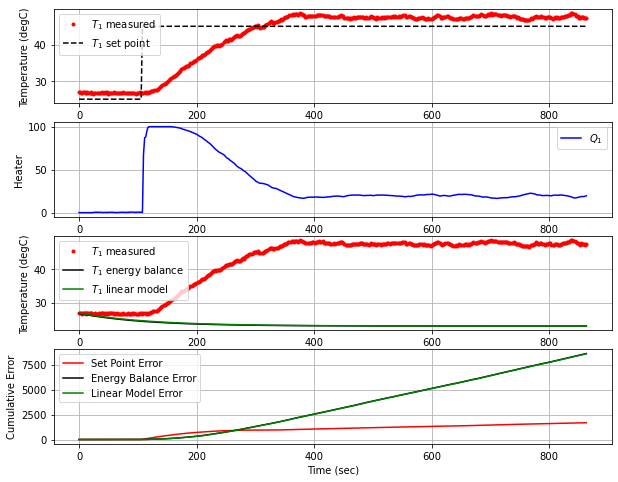

T1 NIH BOS  [48.57 48.38 48.26 47.88 47.85 47.72 47.41 47.28 47.67 47.55 47.57 47.29
 47.24 47.32 47.25]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 866.8  45.00  47.47   0.00  19.91


<Figure size 432x288 with 0 Axes>

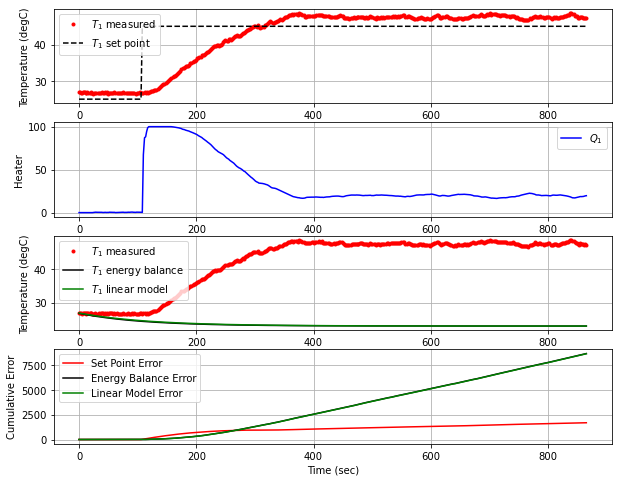

T1 NIH BOS  [48.38 48.26 47.88 47.85 47.72 47.41 47.28 47.67 47.55 47.57 47.29 47.24
 47.32 47.25 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 868.8  45.00  47.10   0.00  19.91


<Figure size 432x288 with 0 Axes>

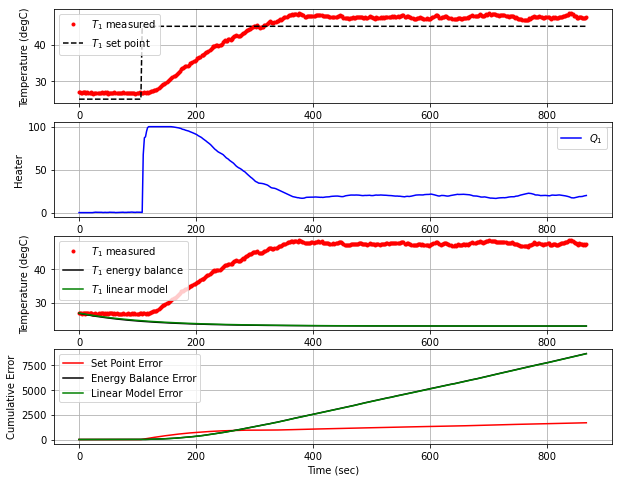

T1 NIH BOS  [48.26 47.88 47.85 47.72 47.41 47.28 47.67 47.55 47.57 47.29 47.24 47.32
 47.25 47.47 47.1 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 870.6  45.00  47.21   0.00  20.29


<Figure size 432x288 with 0 Axes>

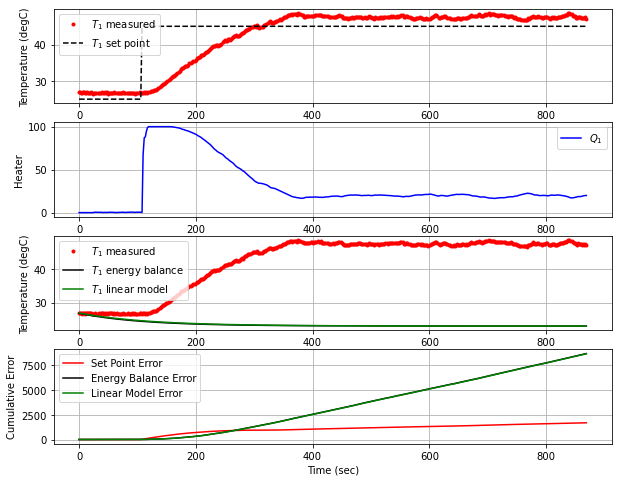

T1 NIH BOS  [47.88 47.85 47.72 47.41 47.28 47.67 47.55 47.57 47.29 47.24 47.32 47.25
 47.47 47.1  47.21]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 872.2  45.00  47.04   0.00  20.49


<Figure size 432x288 with 0 Axes>

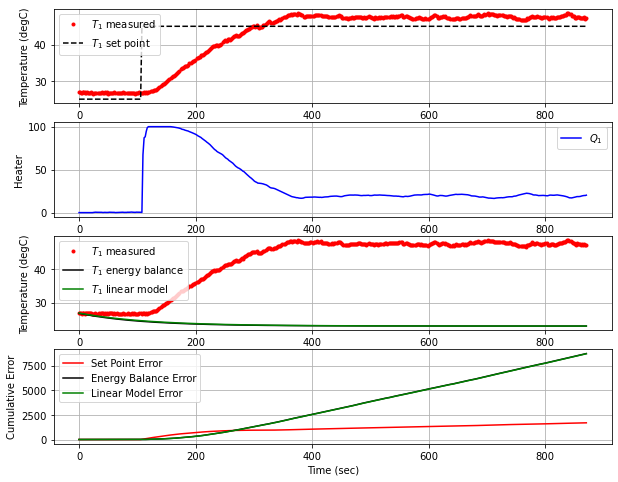

T1 NIH BOS  [47.85 47.72 47.41 47.28 47.67 47.55 47.57 47.29 47.24 47.32 47.25 47.47
 47.1  47.21 47.04]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 874.0  45.00  47.12   0.00  20.77


<Figure size 432x288 with 0 Axes>

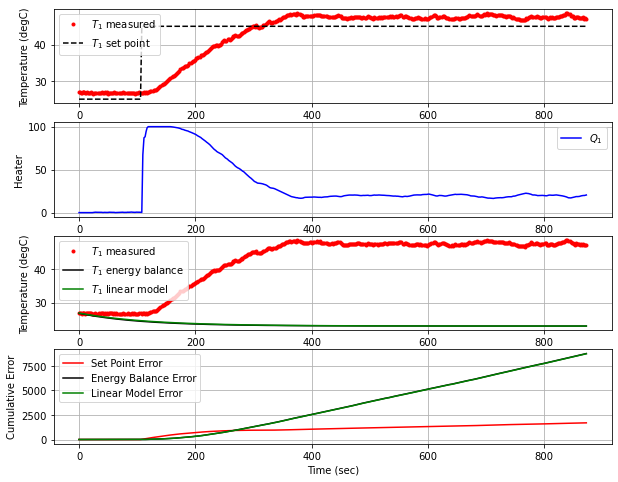

T1 NIH BOS  [47.72 47.41 47.28 47.67 47.55 47.57 47.29 47.24 47.32 47.25 47.47 47.1
 47.21 47.04 47.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 875.7  45.00  46.97   0.00  20.90


<Figure size 432x288 with 0 Axes>

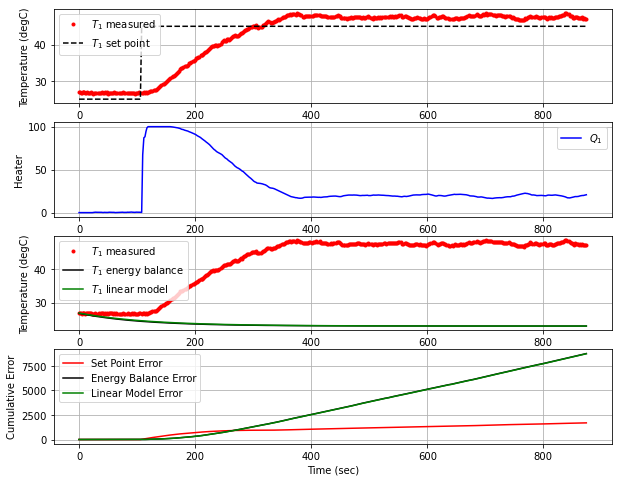

T1 NIH BOS  [47.41 47.28 47.67 47.55 47.57 47.29 47.24 47.32 47.25 47.47 47.1  47.21
 47.04 47.12 46.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
 877.3  45.00  46.74   0.00  21.15


<Figure size 432x288 with 0 Axes>

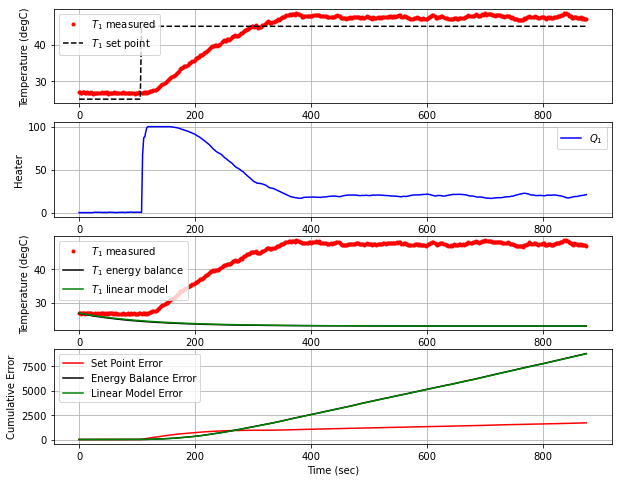

T1 NIH BOS  [47.28 47.67 47.55 47.57 47.29 47.24 47.32 47.25 47.47 47.1  47.21 47.04
 47.12 46.97 46.74]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
 879.1  45.00  46.79   0.00  21.54


<Figure size 432x288 with 0 Axes>

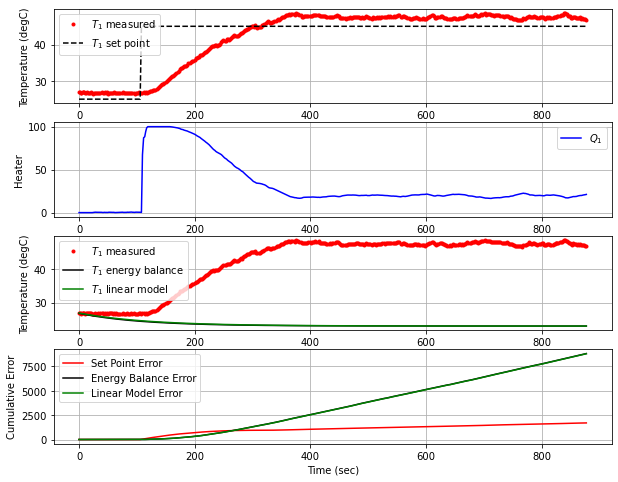

T1 NIH BOS  [47.67 47.55 47.57 47.29 47.24 47.32 47.25 47.47 47.1  47.21 47.04 47.12
 46.97 46.74 46.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 880.8  45.00  46.62   0.00  21.77


<Figure size 432x288 with 0 Axes>

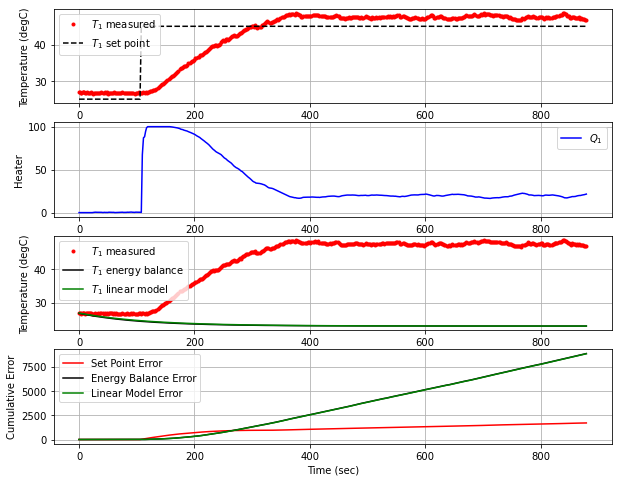

T1 NIH BOS  [47.55 47.57 47.29 47.24 47.32 47.25 47.47 47.1  47.21 47.04 47.12 46.97
 46.74 46.79 46.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 882.7  45.00  46.93   0.00  22.14


<Figure size 432x288 with 0 Axes>

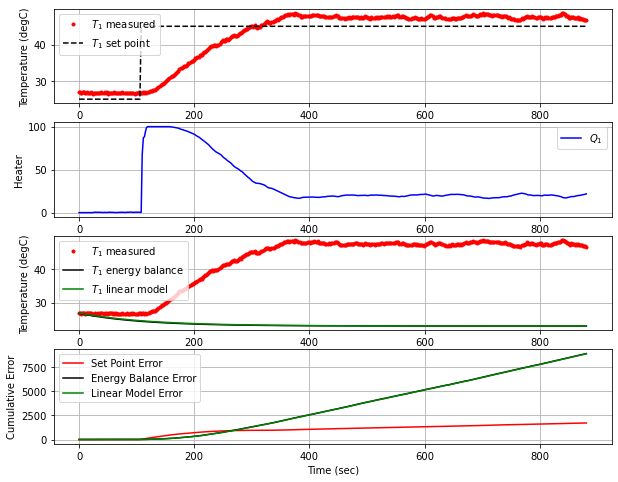

T1 NIH BOS  [47.57 47.29 47.24 47.32 47.25 47.47 47.1  47.21 47.04 47.12 46.97 46.74
 46.79 46.62 46.93]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 884.4  45.00  47.14   0.00  22.12


<Figure size 432x288 with 0 Axes>

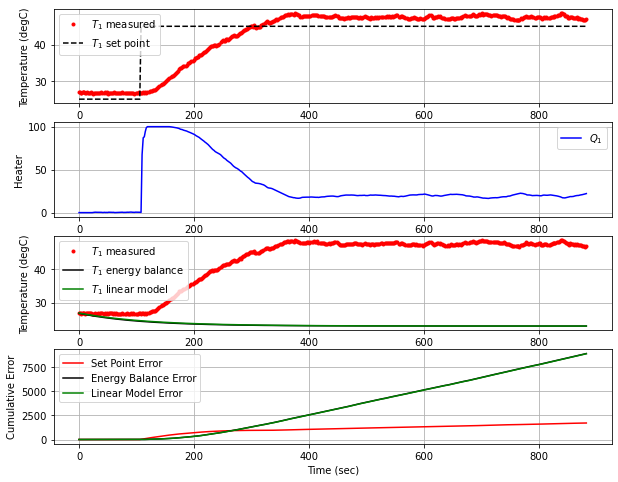

T1 NIH BOS  [47.29 47.24 47.32 47.25 47.47 47.1  47.21 47.04 47.12 46.97 46.74 46.79
 46.62 46.93 47.14]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 886.1  45.00  47.35   0.00  21.93


<Figure size 432x288 with 0 Axes>

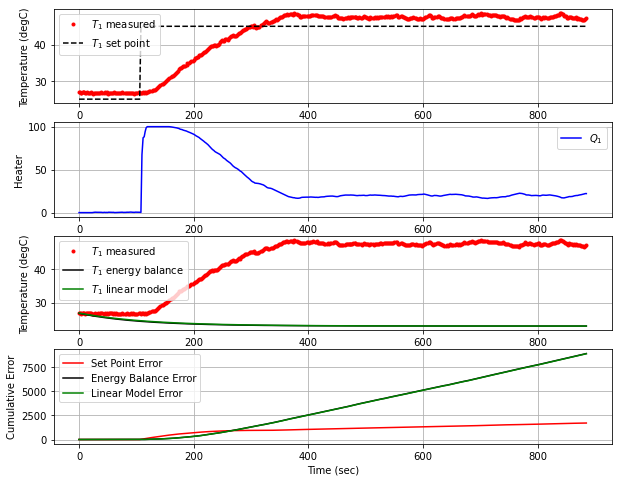

T1 NIH BOS  [47.24 47.32 47.25 47.47 47.1  47.21 47.04 47.12 46.97 46.74 46.79 46.62
 46.93 47.14 47.35]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 887.8  45.00  47.47   0.00  21.61


<Figure size 432x288 with 0 Axes>

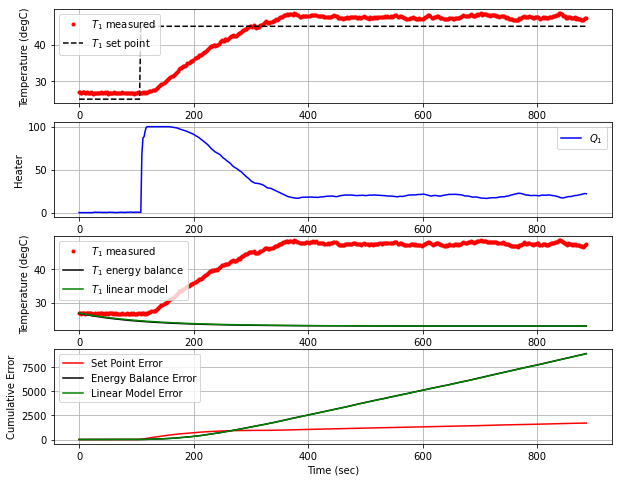

T1 NIH BOS  [47.32 47.25 47.47 47.1  47.21 47.04 47.12 46.97 46.74 46.79 46.62 46.93
 47.14 47.35 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 889.7  45.00  47.34   0.00  21.29


<Figure size 432x288 with 0 Axes>

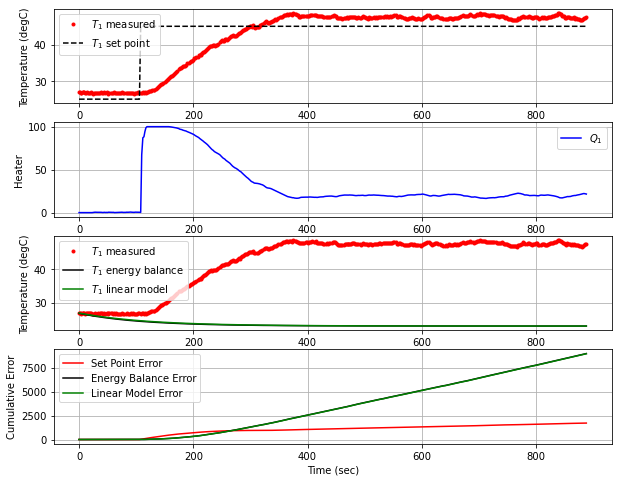

T1 NIH BOS  [47.25 47.47 47.1  47.21 47.04 47.12 46.97 46.74 46.79 46.62 46.93 47.14
 47.35 47.47 47.34]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 891.5  45.00  47.35   0.00  21.21


<Figure size 432x288 with 0 Axes>

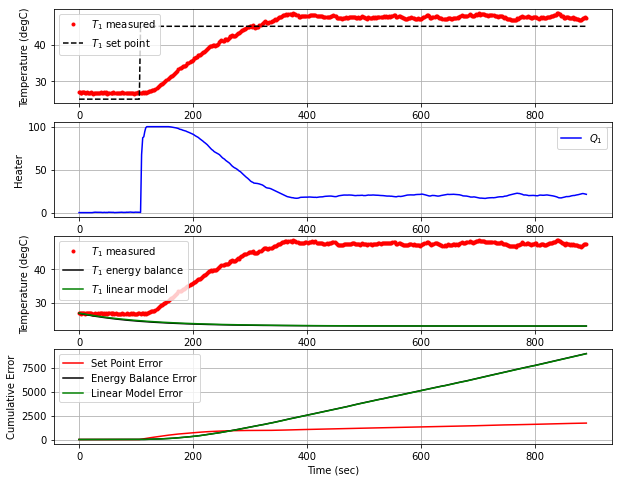

T1 NIH BOS  [47.47 47.1  47.21 47.04 47.12 46.97 46.74 46.79 46.62 46.93 47.14 47.35
 47.47 47.34 47.35]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 893.3  45.00  47.31   0.00  21.14


<Figure size 432x288 with 0 Axes>

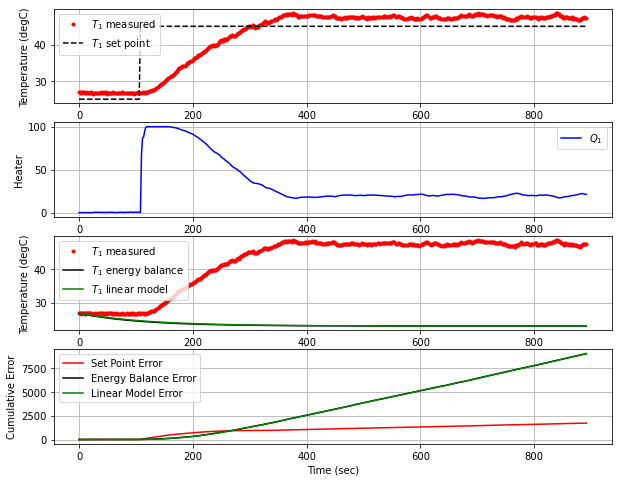

T1 NIH BOS  [47.1  47.21 47.04 47.12 46.97 46.74 46.79 46.62 46.93 47.14 47.35 47.47
 47.34 47.35 47.31]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 895.6  45.00  47.42   0.00  21.13


<Figure size 432x288 with 0 Axes>

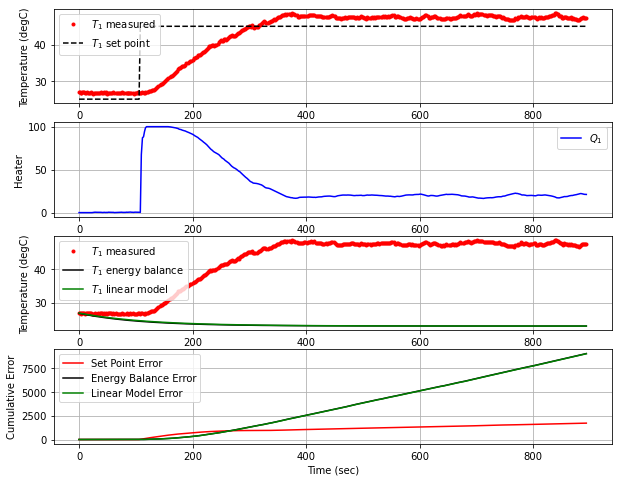

T1 NIH BOS  [47.21 47.04 47.12 46.97 46.74 46.79 46.62 46.93 47.14 47.35 47.47 47.34
 47.35 47.31 47.42]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 897.3  45.00  47.51   0.00  20.95


<Figure size 432x288 with 0 Axes>

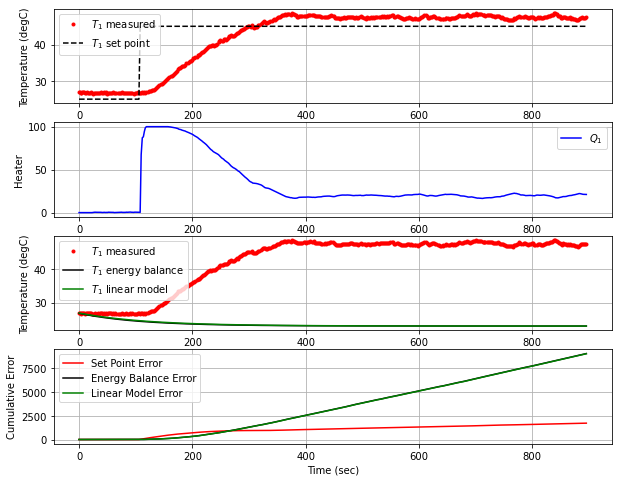

T1 NIH BOS  [47.04 47.12 46.97 46.74 46.79 46.62 46.93 47.14 47.35 47.47 47.34 47.35
 47.31 47.42 47.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 898.9  45.00  47.57   0.00  20.73


<Figure size 432x288 with 0 Axes>

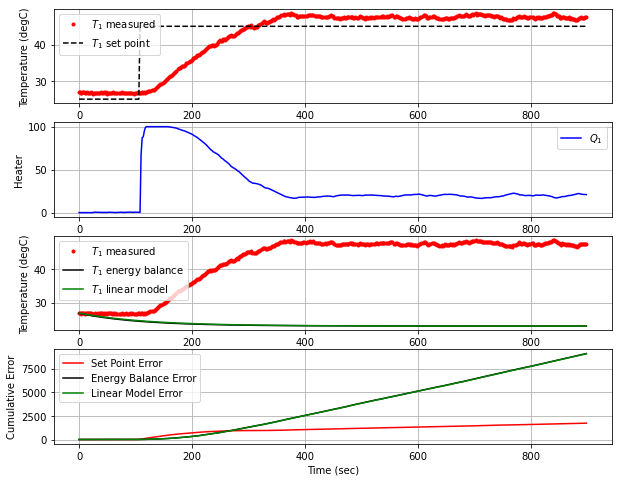

T1 NIH BOS  [47.12 46.97 46.74 46.79 46.62 46.93 47.14 47.35 47.47 47.34 47.35 47.31
 47.42 47.51 47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 900.6  45.00  47.64   0.00  20.50


<Figure size 432x288 with 0 Axes>

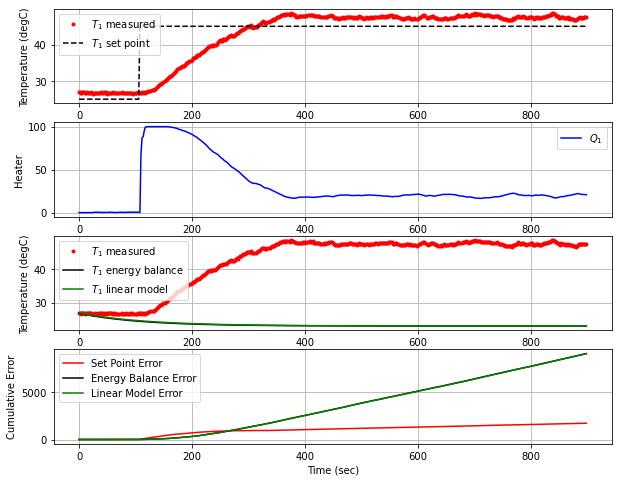

T1 NIH BOS  [46.97 46.74 46.79 46.62 46.93 47.14 47.35 47.47 47.34 47.35 47.31 47.42
 47.51 47.57 47.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 902.4  45.00  47.88   0.00  20.26


<Figure size 432x288 with 0 Axes>

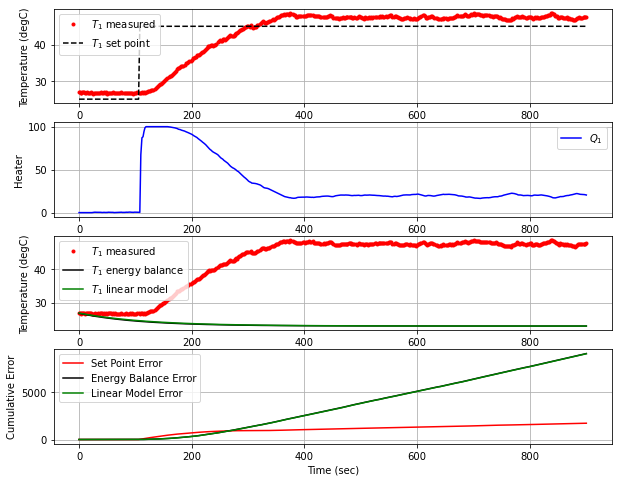

T1 NIH BOS  [46.74 46.79 46.62 46.93 47.14 47.35 47.47 47.34 47.35 47.31 47.42 47.51
 47.57 47.64 47.88]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 904.1  45.00  47.98   0.00  19.84


<Figure size 432x288 with 0 Axes>

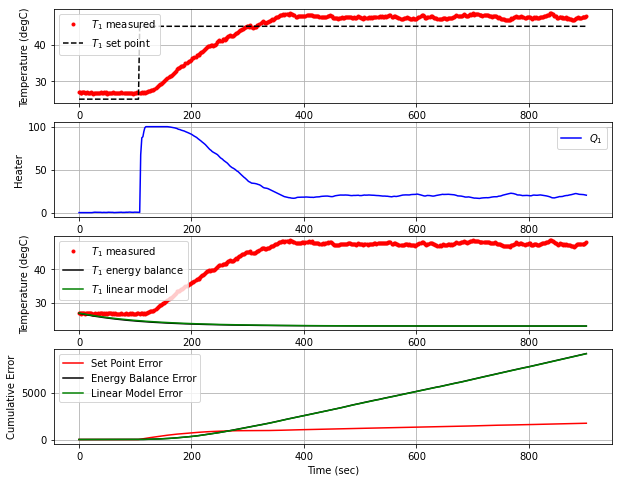

T1 NIH BOS  [46.79 46.62 46.93 47.14 47.35 47.47 47.34 47.35 47.31 47.42 47.51 47.57
 47.64 47.88 47.98]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 50ms/step
 906.0  45.00  47.91   0.00  19.41


<Figure size 432x288 with 0 Axes>

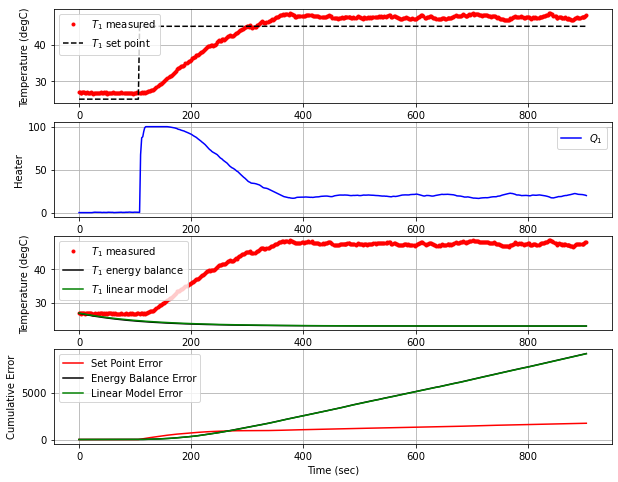

T1 NIH BOS  [46.62 46.93 47.14 47.35 47.47 47.34 47.35 47.31 47.42 47.51 47.57 47.64
 47.88 47.98 47.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 908.0  45.00  48.15   0.00  19.16


<Figure size 432x288 with 0 Axes>

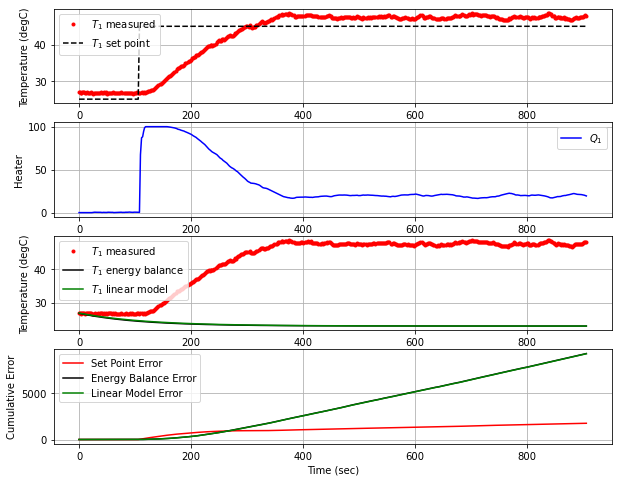

T1 NIH BOS  [46.93 47.14 47.35 47.47 47.34 47.35 47.31 47.42 47.51 47.57 47.64 47.88
 47.98 47.91 48.15]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 909.6  45.00  47.91   0.00  18.72


<Figure size 432x288 with 0 Axes>

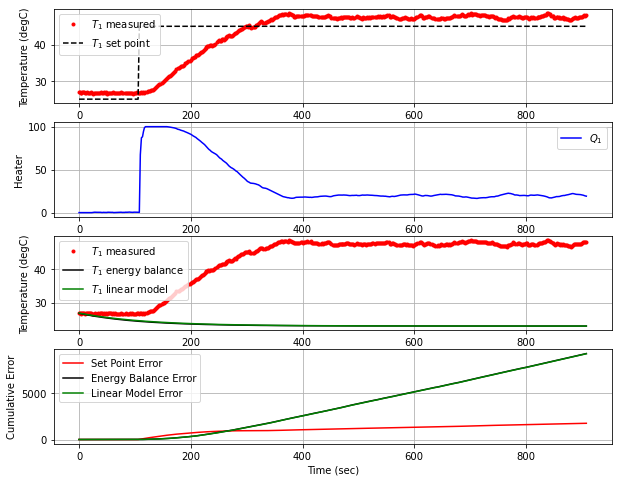

T1 NIH BOS  [47.14 47.35 47.47 47.34 47.35 47.31 47.42 47.51 47.57 47.64 47.88 47.98
 47.91 48.15 47.91]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 46ms/step
 912.0  45.00  47.79   0.00  18.61


<Figure size 432x288 with 0 Axes>

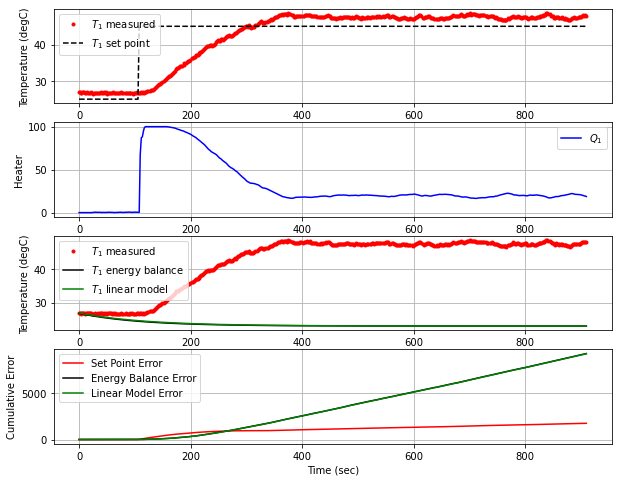

T1 NIH BOS  [47.35 47.47 47.34 47.35 47.31 47.42 47.51 47.57 47.64 47.88 47.98 47.91
 48.15 47.91 47.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 914.0  45.00  47.58   0.00  18.66


<Figure size 432x288 with 0 Axes>

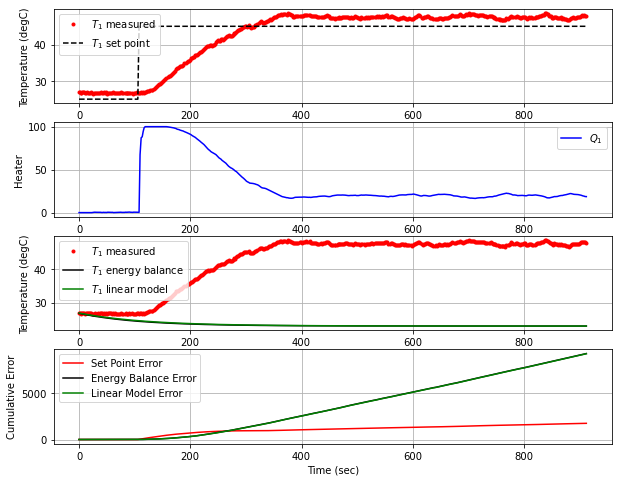

T1 NIH BOS  [47.47 47.34 47.35 47.31 47.42 47.51 47.57 47.64 47.88 47.98 47.91 48.15
 47.91 47.79 47.58]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 915.8  45.00  47.30   0.00  18.86


<Figure size 432x288 with 0 Axes>

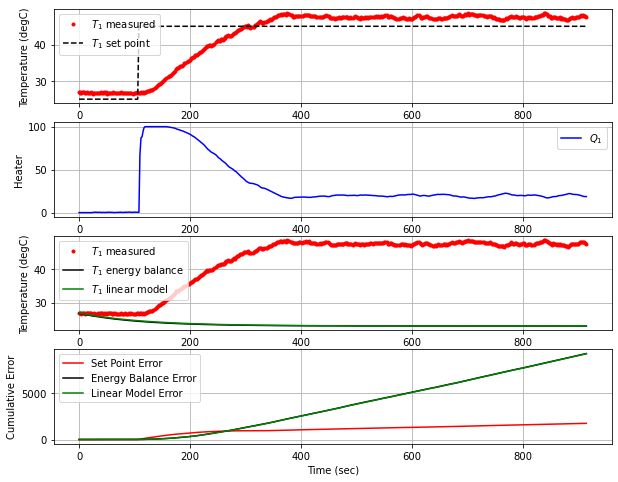

T1 NIH BOS  [47.34 47.35 47.31 47.42 47.51 47.57 47.64 47.88 47.98 47.91 48.15 47.91
 47.79 47.58 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 917.6  45.00  46.95   0.00  19.25


<Figure size 432x288 with 0 Axes>

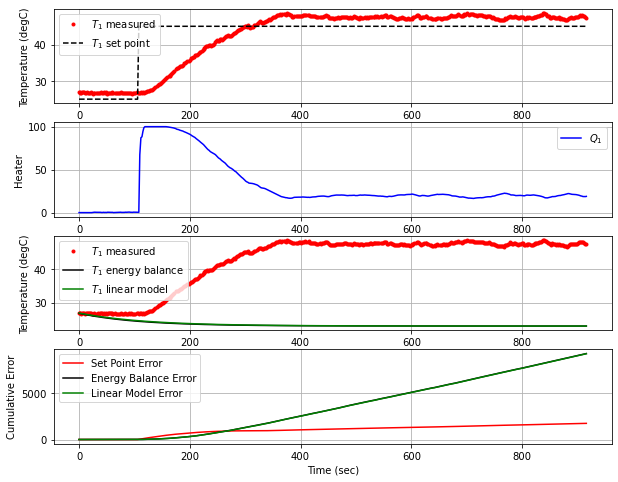

T1 NIH BOS  [47.35 47.31 47.42 47.51 47.57 47.64 47.88 47.98 47.91 48.15 47.91 47.79
 47.58 47.3  46.95]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 919.2  45.00  46.81   0.00  19.82


<Figure size 432x288 with 0 Axes>

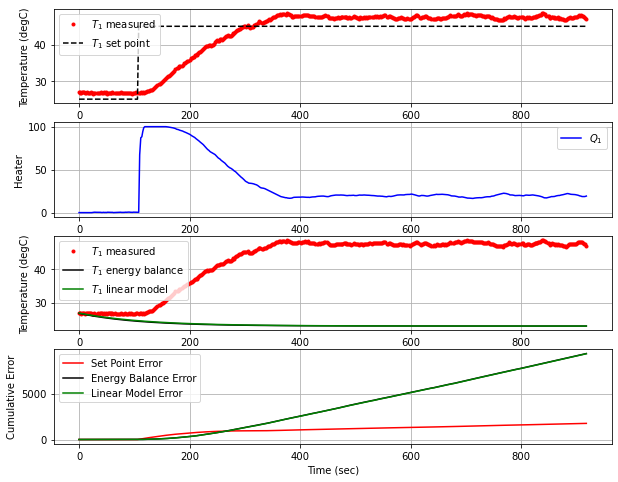

T1 NIH BOS  [47.31 47.42 47.51 47.57 47.64 47.88 47.98 47.91 48.15 47.91 47.79 47.58
 47.3  46.95 46.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 921.0  45.00  46.71   0.00  20.34


<Figure size 432x288 with 0 Axes>

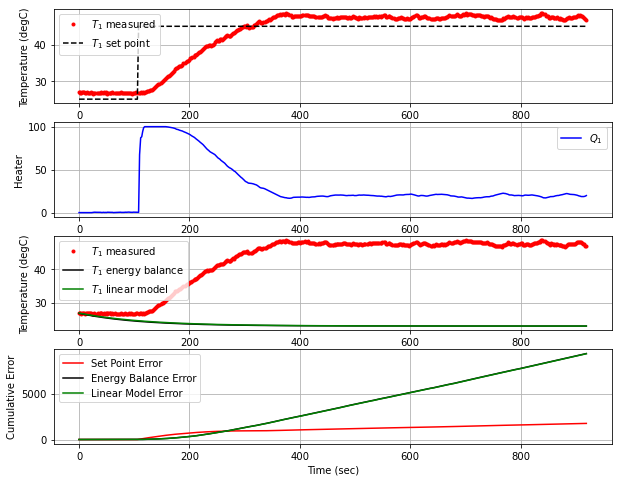

T1 NIH BOS  [47.42 47.51 47.57 47.64 47.88 47.98 47.91 48.15 47.91 47.79 47.58 47.3
 46.95 46.81 46.71]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 922.7  45.00  46.97   0.00  20.79


<Figure size 432x288 with 0 Axes>

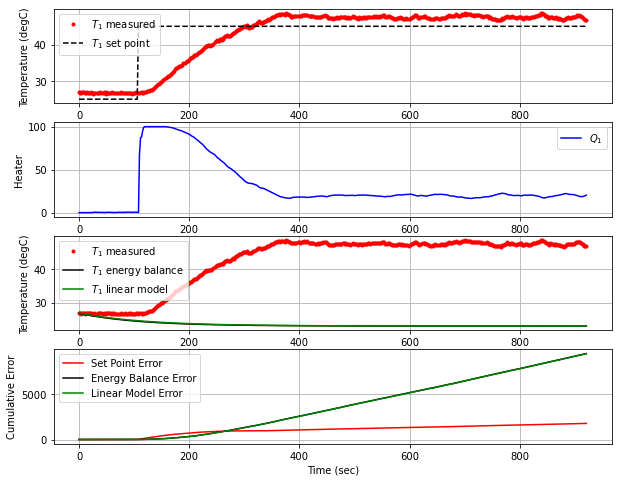

T1 NIH BOS  [47.51 47.57 47.64 47.88 47.98 47.91 48.15 47.91 47.79 47.58 47.3  46.95
 46.81 46.71 46.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 924.3  45.00  46.94   0.00  20.89


<Figure size 432x288 with 0 Axes>

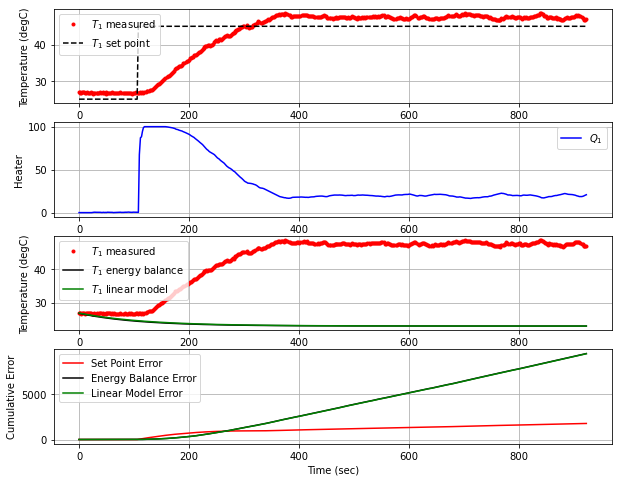

T1 NIH BOS  [47.57 47.64 47.88 47.98 47.91 48.15 47.91 47.79 47.58 47.3  46.95 46.81
 46.71 46.97 46.94]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 85ms/step
 926.0  45.00  46.81   0.00  21.02


<Figure size 432x288 with 0 Axes>

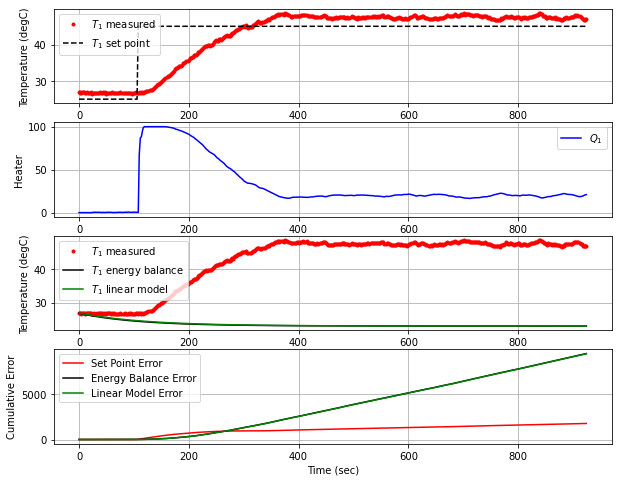

T1 NIH BOS  [47.64 47.88 47.98 47.91 48.15 47.91 47.79 47.58 47.3  46.95 46.81 46.71
 46.97 46.94 46.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 927.9  45.00  46.77   0.00  21.32


<Figure size 432x288 with 0 Axes>

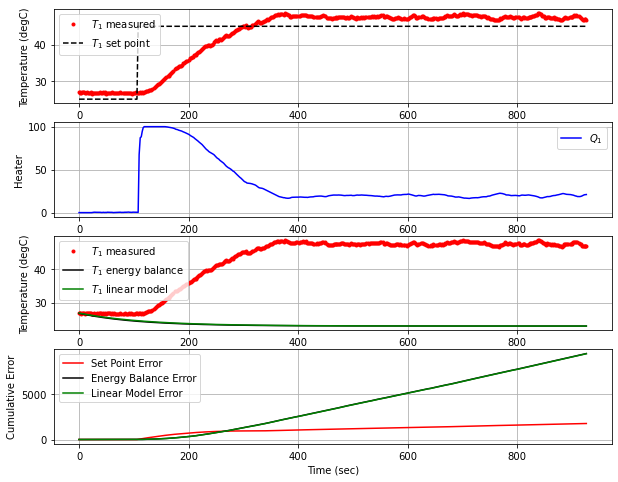

T1 NIH BOS  [47.88 47.98 47.91 48.15 47.91 47.79 47.58 47.3  46.95 46.81 46.71 46.97
 46.94 46.81 46.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 61ms/step
 929.7  45.00  46.86   0.00  21.62


<Figure size 432x288 with 0 Axes>

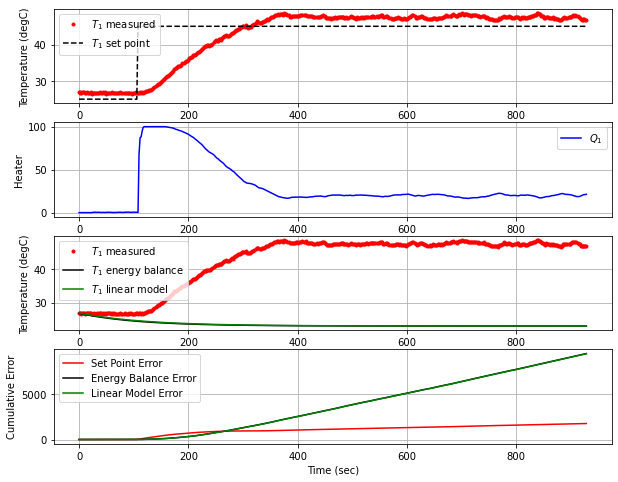

T1 NIH BOS  [47.98 47.91 48.15 47.91 47.79 47.58 47.3  46.95 46.81 46.71 46.97 46.94
 46.81 46.77 46.86]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 931.4  45.00  46.70   0.00  21.79


<Figure size 432x288 with 0 Axes>

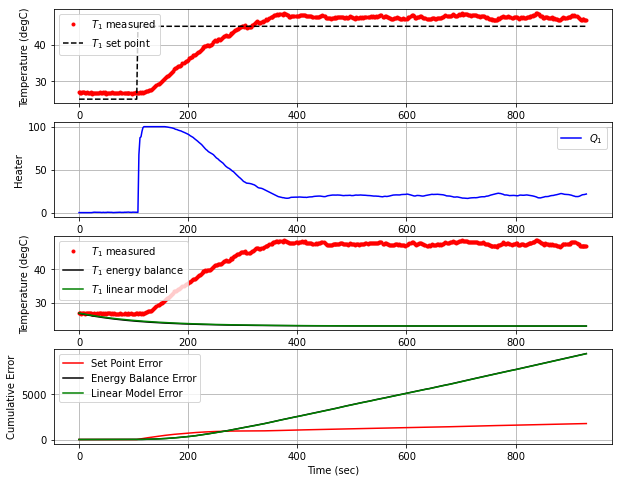

T1 NIH BOS  [47.91 48.15 47.91 47.79 47.58 47.3  46.95 46.81 46.71 46.97 46.94 46.81
 46.77 46.86 46.7 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 933.3  45.00  46.92   0.00  22.11


<Figure size 432x288 with 0 Axes>

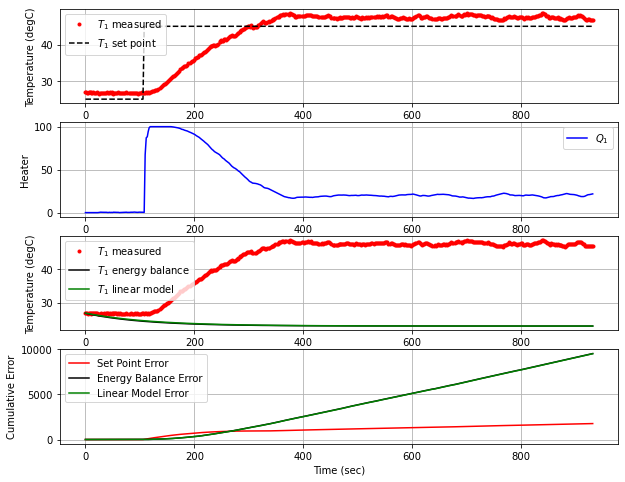

T1 NIH BOS  [48.15 47.91 47.79 47.58 47.3  46.95 46.81 46.71 46.97 46.94 46.81 46.77
 46.86 46.7  46.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 935.3  45.00  47.36   0.00  22.16


<Figure size 432x288 with 0 Axes>

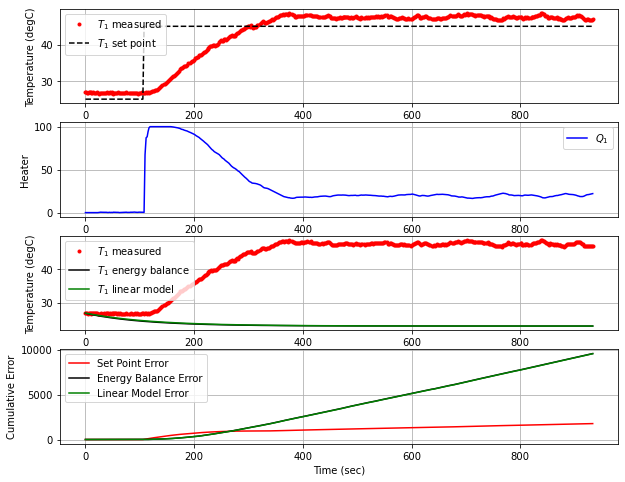

T1 NIH BOS  [47.91 47.79 47.58 47.3  46.95 46.81 46.71 46.97 46.94 46.81 46.77 46.86
 46.7  46.92 47.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 936.9  45.00  47.38   0.00  21.82


<Figure size 432x288 with 0 Axes>

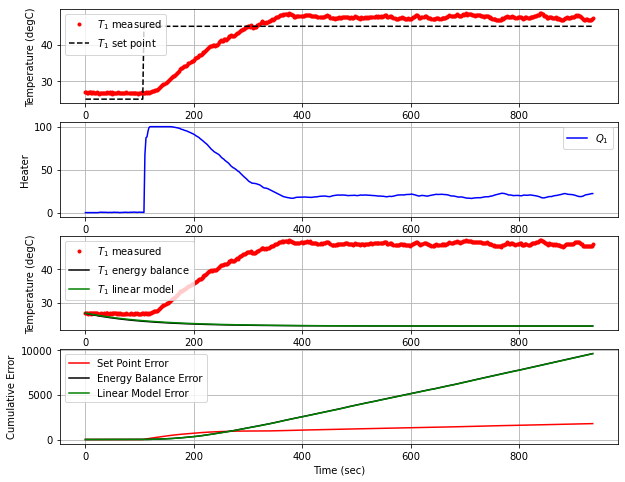

T1 NIH BOS  [47.79 47.58 47.3  46.95 46.81 46.71 46.97 46.94 46.81 46.77 46.86 46.7
 46.92 47.36 47.38]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 938.6  45.00  47.36   0.00  21.58


<Figure size 432x288 with 0 Axes>

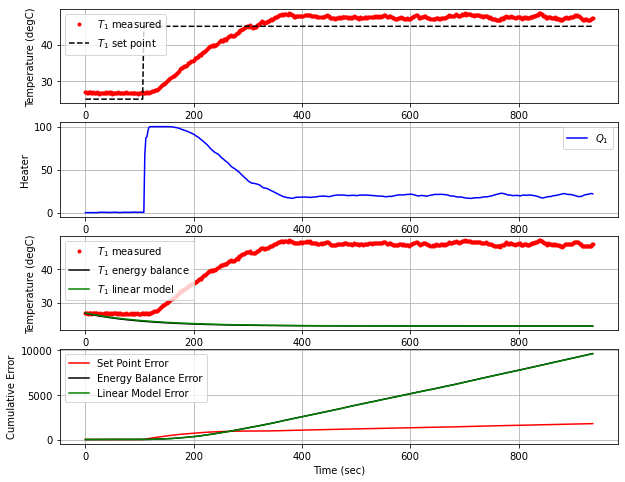

T1 NIH BOS  [47.58 47.3  46.95 46.81 46.71 46.97 46.94 46.81 46.77 46.86 46.7  46.92
 47.36 47.38 47.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 940.2  45.00  47.51   0.00  21.46


<Figure size 432x288 with 0 Axes>

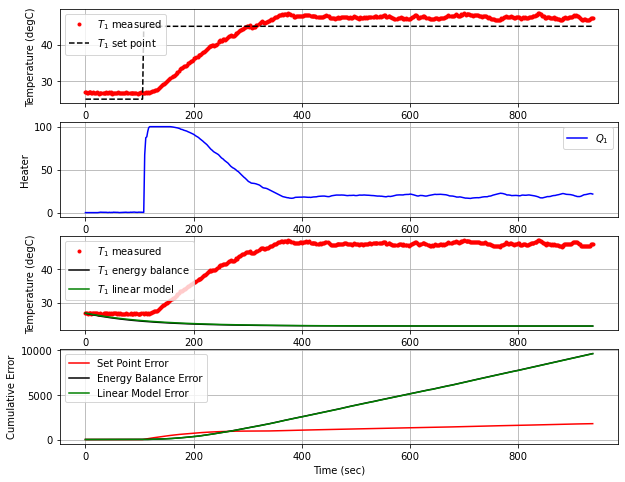

T1 NIH BOS  [47.3  46.95 46.81 46.71 46.97 46.94 46.81 46.77 46.86 46.7  46.92 47.36
 47.38 47.36 47.51]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 941.9  45.00  47.77   0.00  21.23


<Figure size 432x288 with 0 Axes>

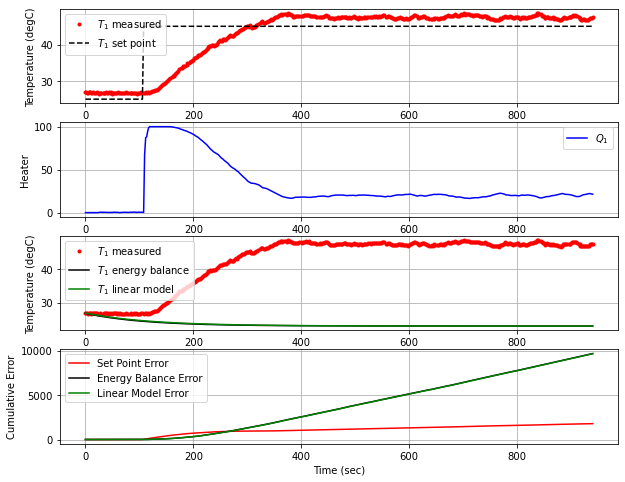

T1 NIH BOS  [46.95 46.81 46.71 46.97 46.94 46.81 46.77 46.86 46.7  46.92 47.36 47.38
 47.36 47.51 47.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 943.8  45.00  47.49   0.00  20.77


<Figure size 432x288 with 0 Axes>

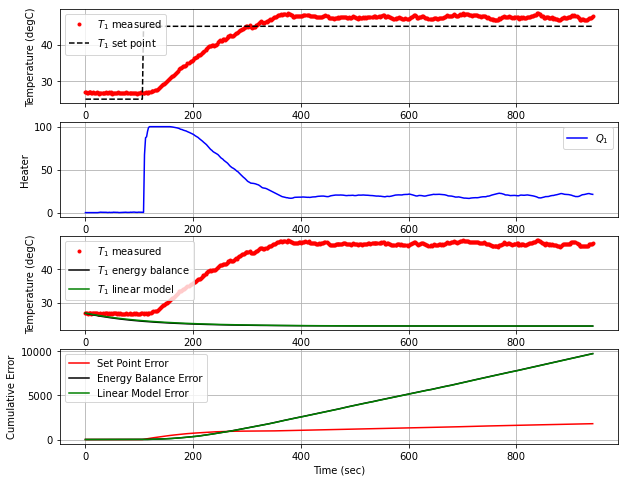

T1 NIH BOS  [46.81 46.71 46.97 46.94 46.81 46.77 46.86 46.7  46.92 47.36 47.38 47.36
 47.51 47.77 47.49]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 945.5  45.00  47.70   0.00  20.66


<Figure size 432x288 with 0 Axes>

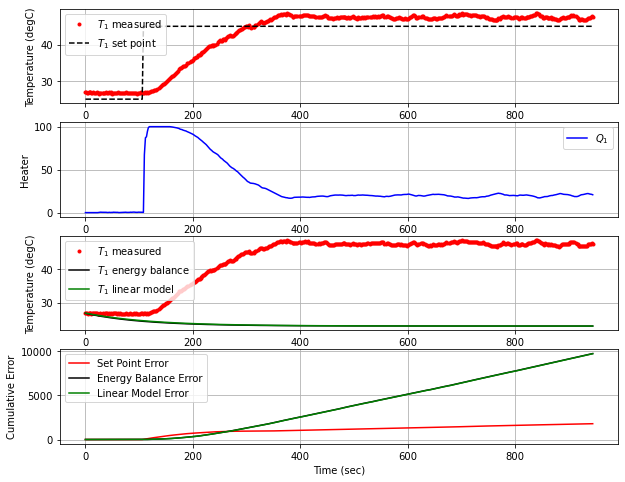

T1 NIH BOS  [46.71 46.97 46.94 46.81 46.77 46.86 46.7  46.92 47.36 47.38 47.36 47.51
 47.77 47.49 47.7 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 947.3  45.00  47.57   0.00  20.36


<Figure size 432x288 with 0 Axes>

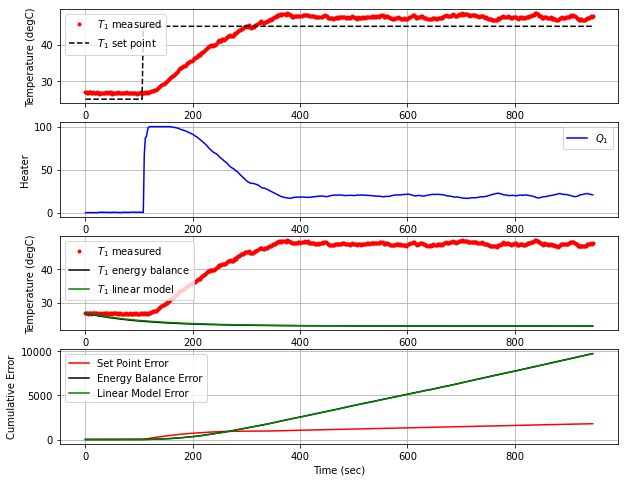

T1 NIH BOS  [46.97 46.94 46.81 46.77 46.86 46.7  46.92 47.36 47.38 47.36 47.51 47.77
 47.49 47.7  47.57]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 948.9  45.00  47.75   0.00  20.21


<Figure size 432x288 with 0 Axes>

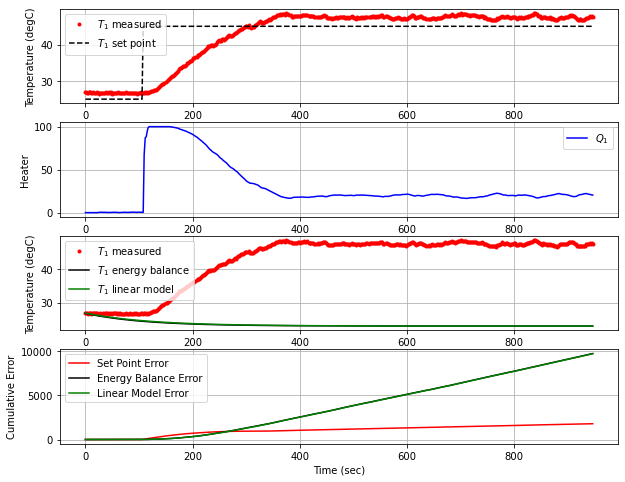

T1 NIH BOS  [46.94 46.81 46.77 46.86 46.7  46.92 47.36 47.38 47.36 47.51 47.77 47.49
 47.7  47.57 47.75]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 950.5  45.00  47.76   0.00  19.93


<Figure size 432x288 with 0 Axes>

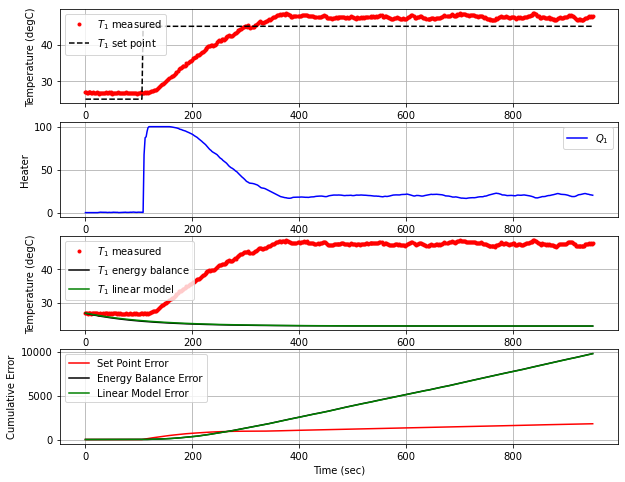

T1 NIH BOS  [46.81 46.77 46.86 46.7  46.92 47.36 47.38 47.36 47.51 47.77 47.49 47.7
 47.57 47.75 47.76]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 952.1  45.00  47.64   0.00  19.69


<Figure size 432x288 with 0 Axes>

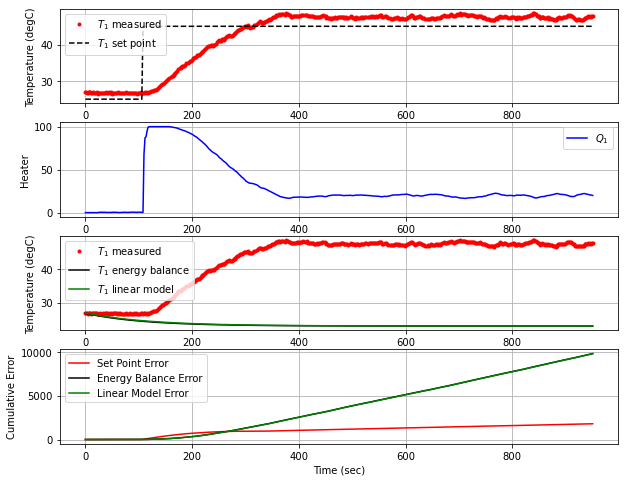

T1 NIH BOS  [46.77 46.86 46.7  46.92 47.36 47.38 47.36 47.51 47.77 47.49 47.7  47.57
 47.75 47.76 47.64]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 953.8  45.00  47.30   0.00  19.60


<Figure size 432x288 with 0 Axes>

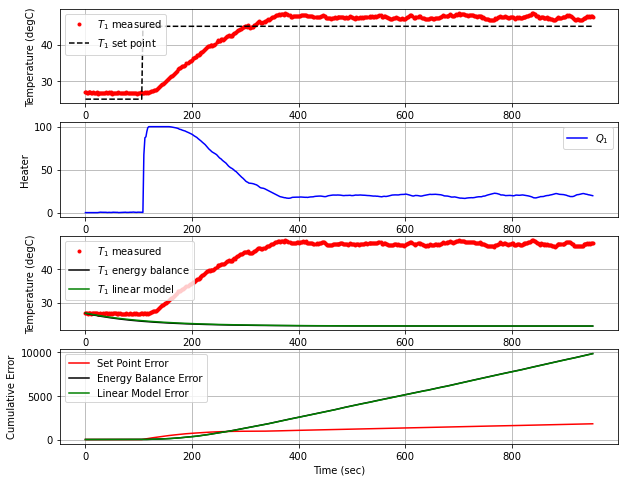

T1 NIH BOS  [46.86 46.7  46.92 47.36 47.38 47.36 47.51 47.77 47.49 47.7  47.57 47.75
 47.76 47.64 47.3 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
 955.4  45.00  47.27   0.00  19.84


<Figure size 432x288 with 0 Axes>

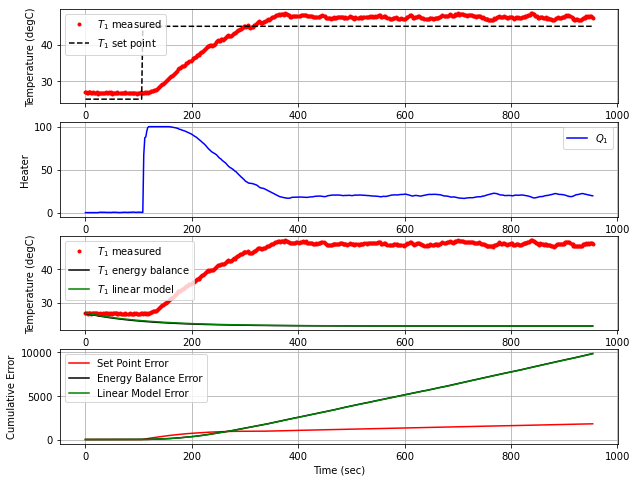

T1 NIH BOS  [46.7  46.92 47.36 47.38 47.36 47.51 47.77 47.49 47.7  47.57 47.75 47.76
 47.64 47.3  47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 957.1  45.00  47.46   0.00  20.02


<Figure size 432x288 with 0 Axes>

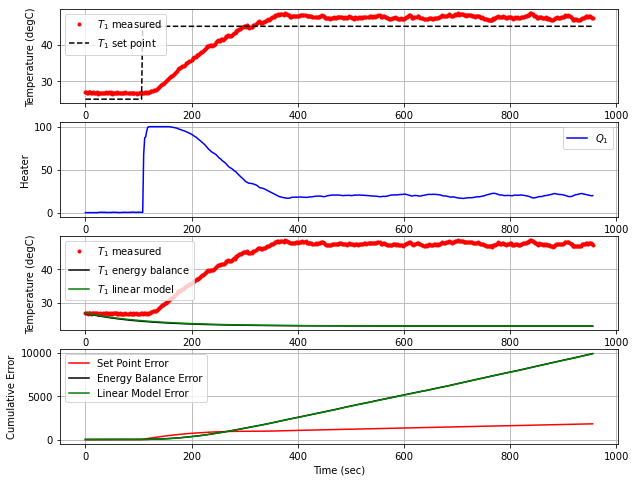

T1 NIH BOS  [46.92 47.36 47.38 47.36 47.51 47.77 47.49 47.7  47.57 47.75 47.76 47.64
 47.3  47.27 47.46]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 48ms/step
 958.9  45.00  47.77   0.00  19.90


<Figure size 432x288 with 0 Axes>

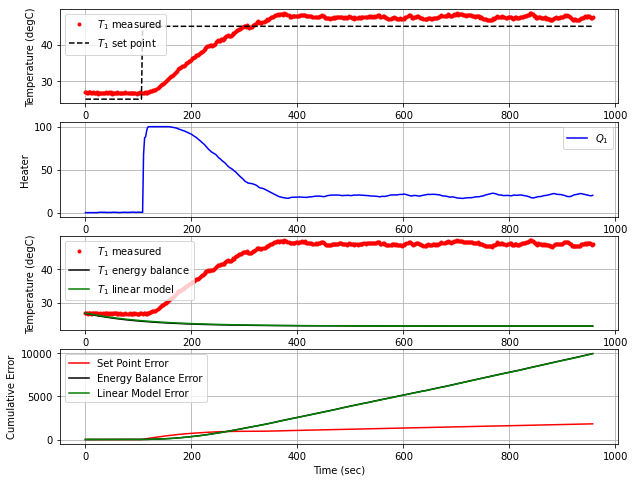

T1 NIH BOS  [47.36 47.38 47.36 47.51 47.77 47.49 47.7  47.57 47.75 47.76 47.64 47.3
 47.27 47.46 47.77]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 960.9  45.00  47.37   0.00  19.52


<Figure size 432x288 with 0 Axes>

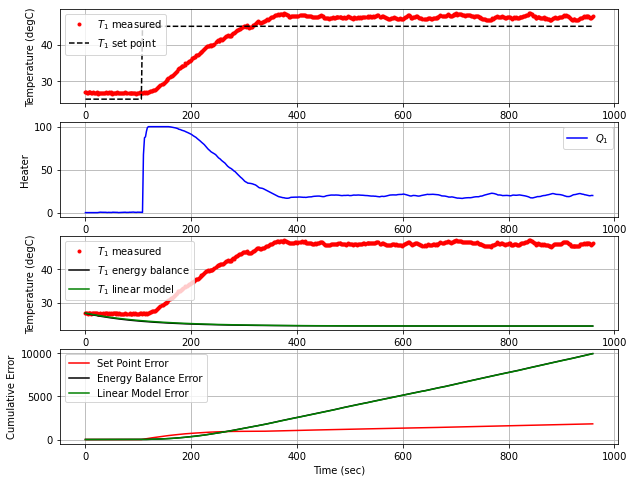

T1 NIH BOS  [47.38 47.36 47.51 47.77 47.49 47.7  47.57 47.75 47.76 47.64 47.3  47.27
 47.46 47.77 47.37]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 962.7  45.00  47.00   0.00  19.67


<Figure size 432x288 with 0 Axes>

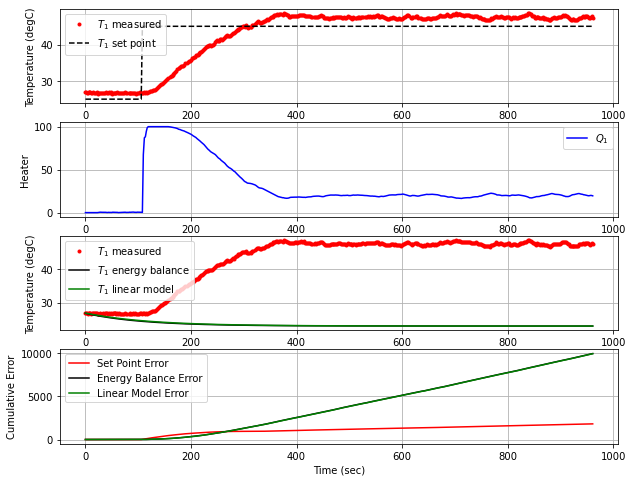

T1 NIH BOS  [47.36 47.51 47.77 47.49 47.7  47.57 47.75 47.76 47.64 47.3  47.27 47.46
 47.77 47.37 47.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 964.4  45.00  47.12   0.00  20.18


<Figure size 432x288 with 0 Axes>

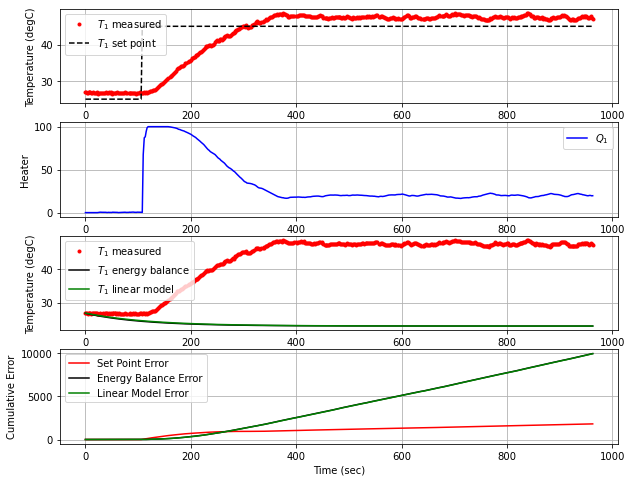

T1 NIH BOS  [47.51 47.77 47.49 47.7  47.57 47.75 47.76 47.64 47.3  47.27 47.46 47.77
 47.37 47.   47.12]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 966.1  45.00  47.13   0.00  20.40


<Figure size 432x288 with 0 Axes>

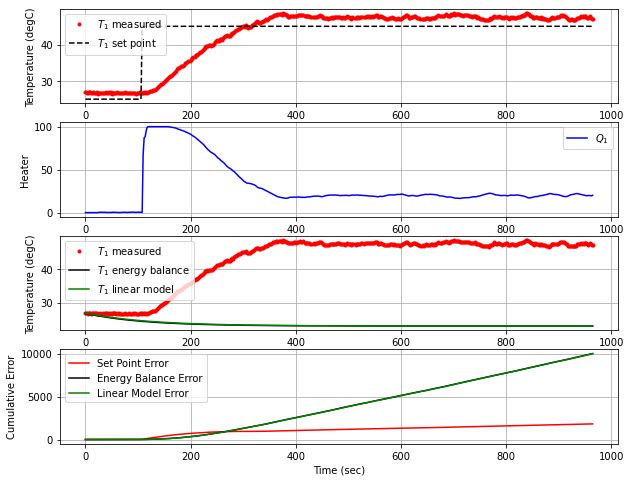

T1 NIH BOS  [47.77 47.49 47.7  47.57 47.75 47.76 47.64 47.3  47.27 47.46 47.77 47.37
 47.   47.12 47.13]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 967.9  45.00  47.11   0.00  20.53


<Figure size 432x288 with 0 Axes>

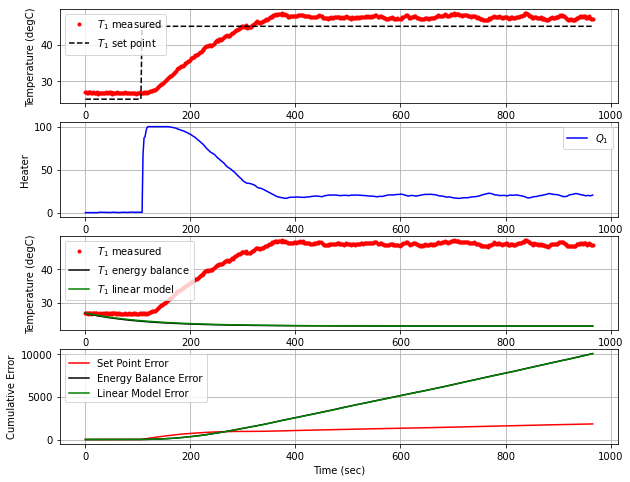

T1 NIH BOS  [47.49 47.7  47.57 47.75 47.76 47.64 47.3  47.27 47.46 47.77 47.37 47.
 47.12 47.13 47.11]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 969.6  45.00  47.11   0.00  20.68


<Figure size 432x288 with 0 Axes>

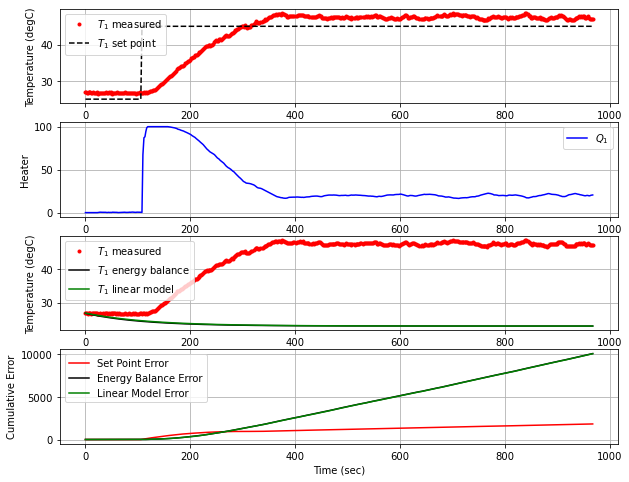

T1 NIH BOS  [47.7  47.57 47.75 47.76 47.64 47.3  47.27 47.46 47.77 47.37 47.   47.12
 47.13 47.11 47.11]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 971.5  45.00  47.26   0.00  20.80


<Figure size 432x288 with 0 Axes>

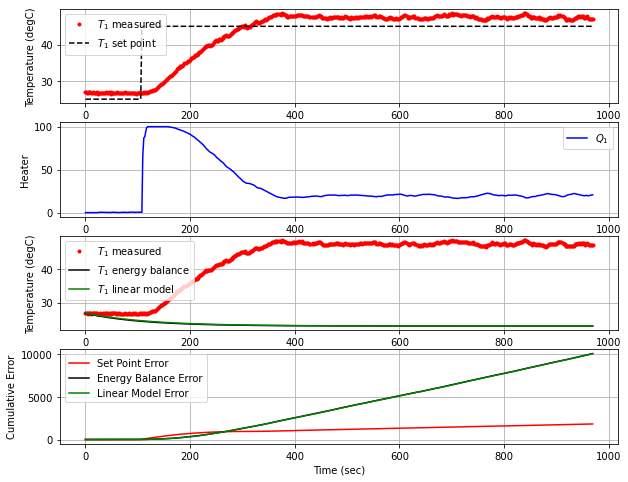

T1 NIH BOS  [47.57 47.75 47.76 47.64 47.3  47.27 47.46 47.77 47.37 47.   47.12 47.13
 47.11 47.11 47.26]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 973.6  45.00  47.65   0.00  20.77


<Figure size 432x288 with 0 Axes>

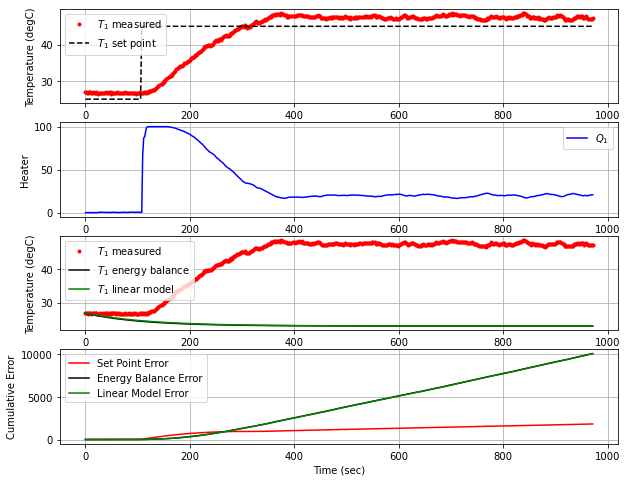

T1 NIH BOS  [47.75 47.76 47.64 47.3  47.27 47.46 47.77 47.37 47.   47.12 47.13 47.11
 47.11 47.26 47.65]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 47ms/step
 976.1  45.00  47.79   0.00  20.39


<Figure size 432x288 with 0 Axes>

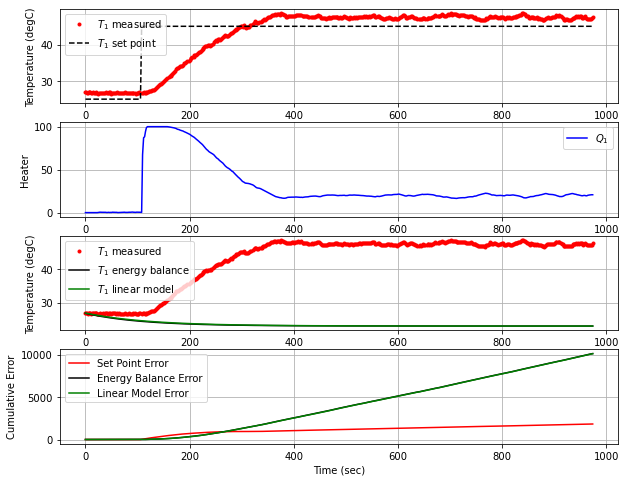

T1 NIH BOS  [47.76 47.64 47.3  47.27 47.46 47.77 47.37 47.   47.12 47.13 47.11 47.11
 47.26 47.65 47.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 41ms/step
 978.2  45.00  47.94   0.00  20.02


<Figure size 432x288 with 0 Axes>

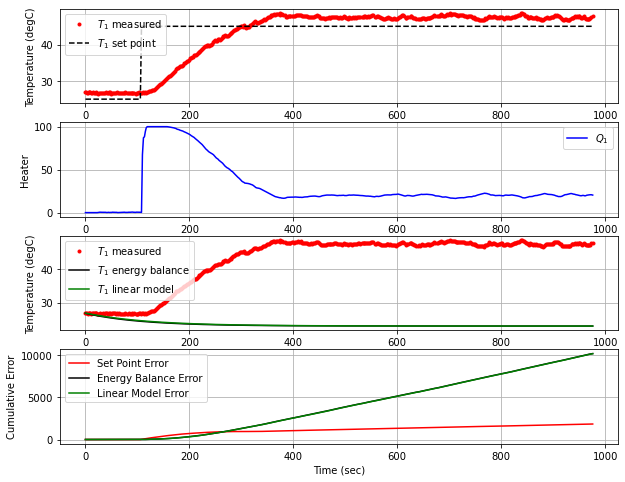

T1 NIH BOS  [47.64 47.3  47.27 47.46 47.77 47.37 47.   47.12 47.13 47.11 47.11 47.26
 47.65 47.79 47.94]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 979.9  45.00  48.11   0.00  19.66


<Figure size 432x288 with 0 Axes>

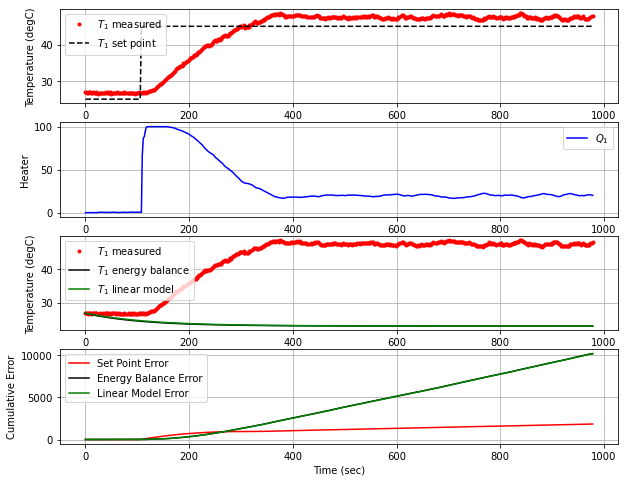

T1 NIH BOS  [47.3  47.27 47.46 47.77 47.37 47.   47.12 47.13 47.11 47.11 47.26 47.65
 47.79 47.94 48.11]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 981.6  45.00  47.86   0.00  19.24


<Figure size 432x288 with 0 Axes>

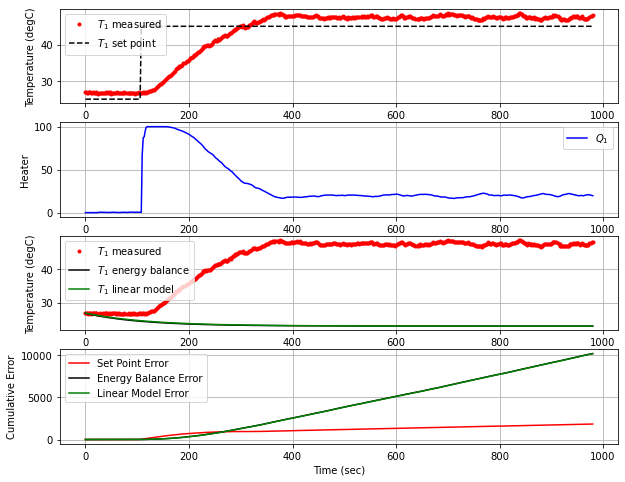

T1 NIH BOS  [47.27 47.46 47.77 47.37 47.   47.12 47.13 47.11 47.11 47.26 47.65 47.79
 47.94 48.11 47.86]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 983.4  45.00  47.76   0.00  19.14


<Figure size 432x288 with 0 Axes>

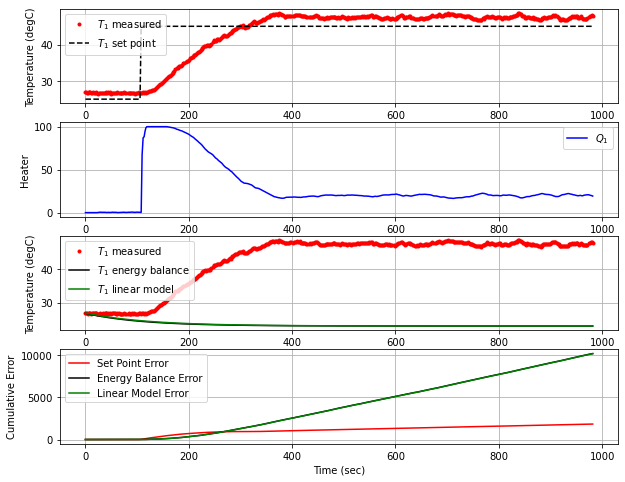

T1 NIH BOS  [47.46 47.77 47.37 47.   47.12 47.13 47.11 47.11 47.26 47.65 47.79 47.94
 48.11 47.86 47.76]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 42ms/step
 985.4  45.00  47.97   0.00  19.15


<Figure size 432x288 with 0 Axes>

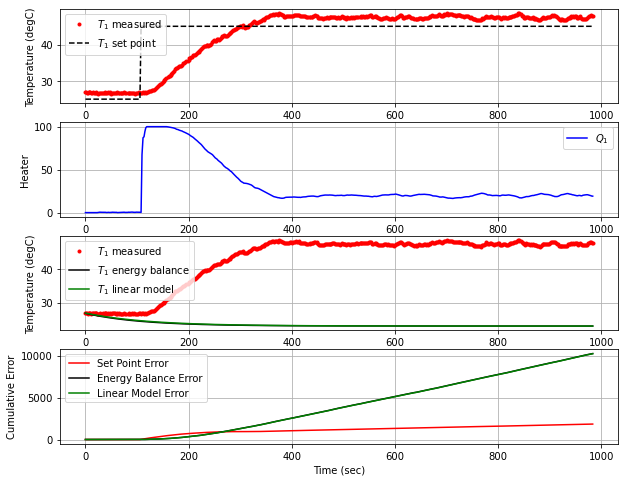

T1 NIH BOS  [47.77 47.37 47.   47.12 47.13 47.11 47.11 47.26 47.65 47.79 47.94 48.11
 47.86 47.76 47.97]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 987.4  45.00  48.07   0.00  18.92


<Figure size 432x288 with 0 Axes>

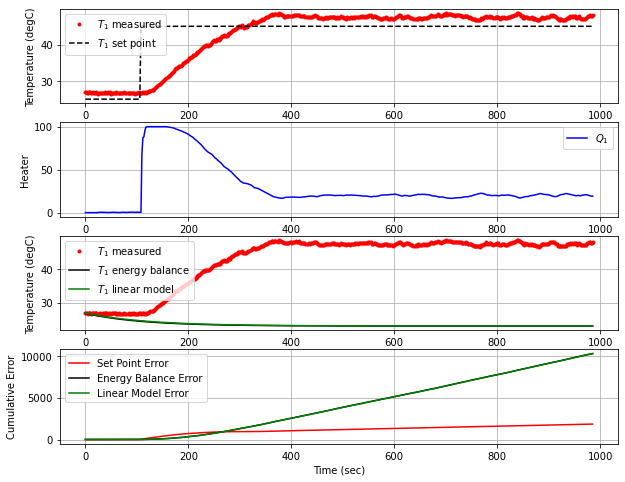

T1 NIH BOS  [47.37 47.   47.12 47.13 47.11 47.11 47.26 47.65 47.79 47.94 48.11 47.86
 47.76 47.97 48.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 989.1  45.00  47.87   0.00  18.66


<Figure size 432x288 with 0 Axes>

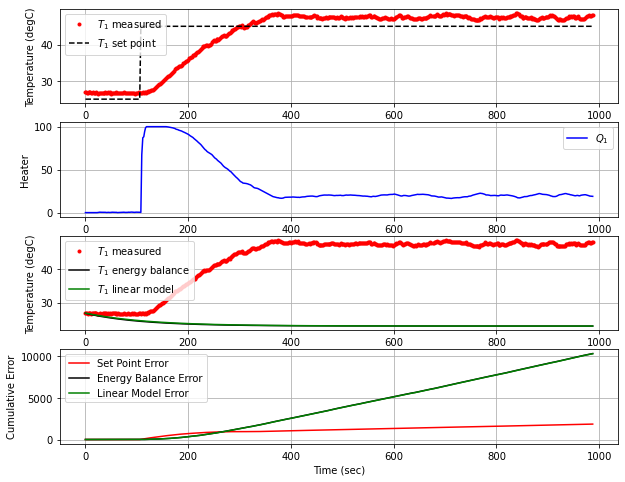

T1 NIH BOS  [47.   47.12 47.13 47.11 47.11 47.26 47.65 47.79 47.94 48.11 47.86 47.76
 47.97 48.07 47.87]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
 990.8  45.00  47.70   0.00  18.61


<Figure size 432x288 with 0 Axes>

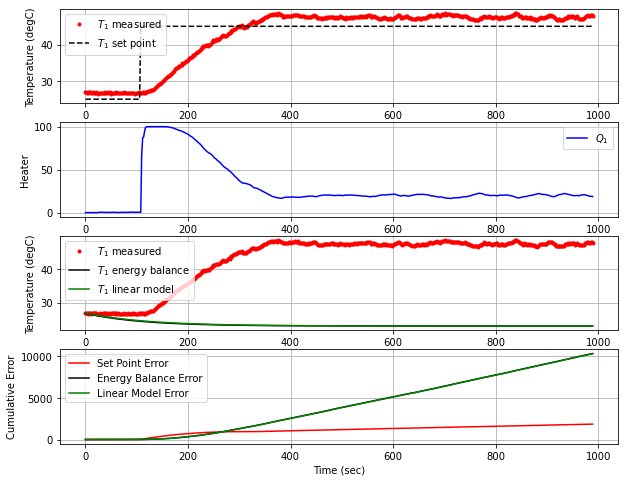

T1 NIH BOS  [47.12 47.13 47.11 47.11 47.26 47.65 47.79 47.94 48.11 47.86 47.76 47.97
 48.07 47.87 47.7 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 992.6  45.00  47.66   0.00  18.71


<Figure size 432x288 with 0 Axes>

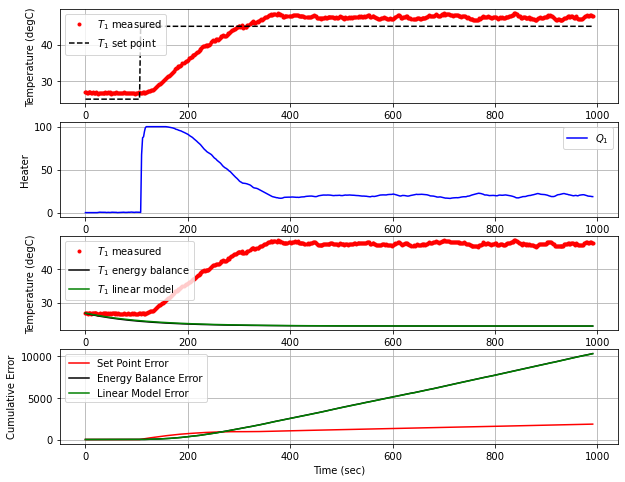

T1 NIH BOS  [47.13 47.11 47.11 47.26 47.65 47.79 47.94 48.11 47.86 47.76 47.97 48.07
 47.87 47.7  47.66]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
 994.4  45.00  47.62   0.00  18.79


<Figure size 432x288 with 0 Axes>

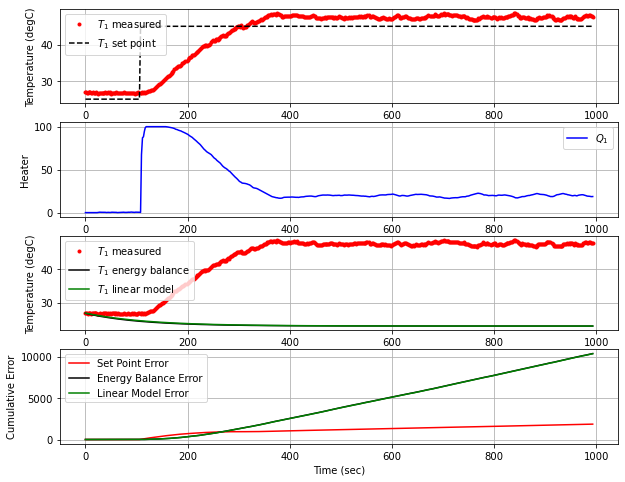

T1 NIH BOS  [47.11 47.11 47.26 47.65 47.79 47.94 48.11 47.86 47.76 47.97 48.07 47.87
 47.7  47.66 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 996.0  45.00  47.39   0.00  18.85


<Figure size 432x288 with 0 Axes>

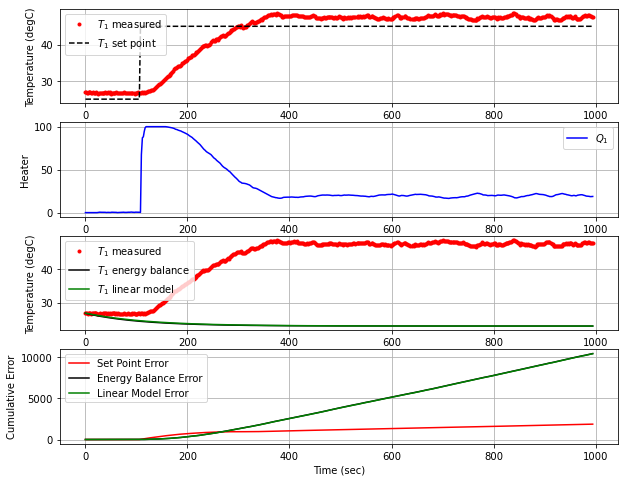

T1 NIH BOS  [47.11 47.26 47.65 47.79 47.94 48.11 47.86 47.76 47.97 48.07 47.87 47.7
 47.66 47.62 47.39]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
 997.9  45.00  47.00   0.00  19.09


<Figure size 432x288 with 0 Axes>

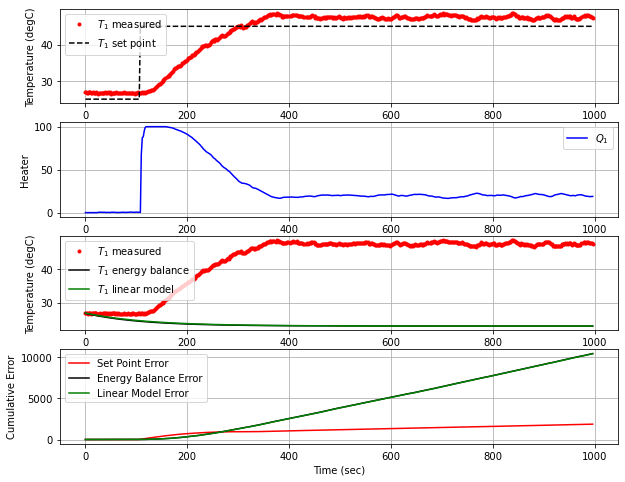

T1 NIH BOS  [47.26 47.65 47.79 47.94 48.11 47.86 47.76 47.97 48.07 47.87 47.7  47.66
 47.62 47.39 47.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
 999.5  45.00  47.17   0.00  19.62


<Figure size 432x288 with 0 Axes>

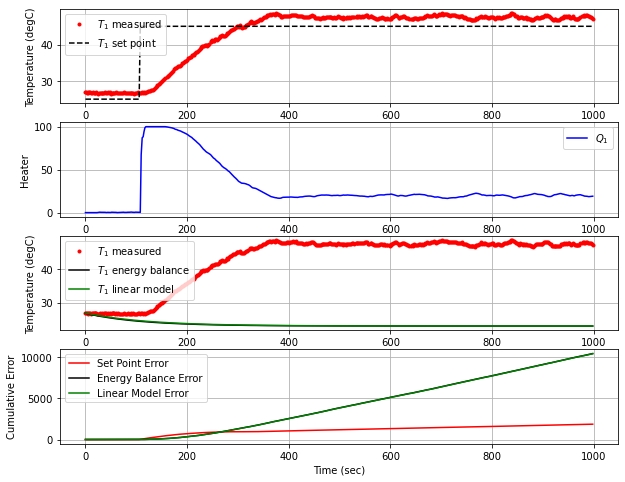

T1 NIH BOS  [47.65 47.79 47.94 48.11 47.86 47.76 47.97 48.07 47.87 47.7  47.66 47.62
 47.39 47.   47.17]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 34ms/step
1001.2  45.00  47.16   0.00  19.83


<Figure size 432x288 with 0 Axes>

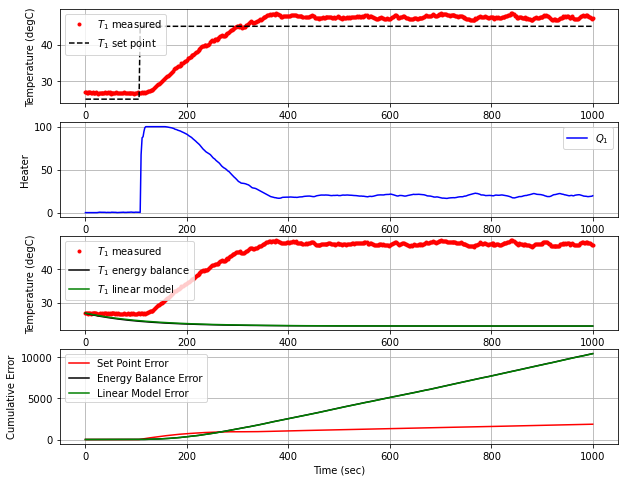

T1 NIH BOS  [47.79 47.94 48.11 47.86 47.76 47.97 48.07 47.87 47.7  47.66 47.62 47.39
 47.   47.17 47.16]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1002.9  45.00  47.36   0.00  20.01


<Figure size 432x288 with 0 Axes>

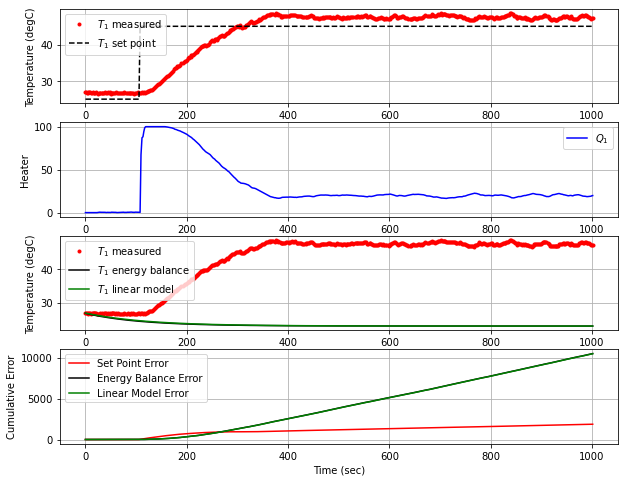

T1 NIH BOS  [47.94 48.11 47.86 47.76 47.97 48.07 47.87 47.7  47.66 47.62 47.39 47.
 47.17 47.16 47.36]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1004.5  45.00  47.47   0.00  19.98


<Figure size 432x288 with 0 Axes>

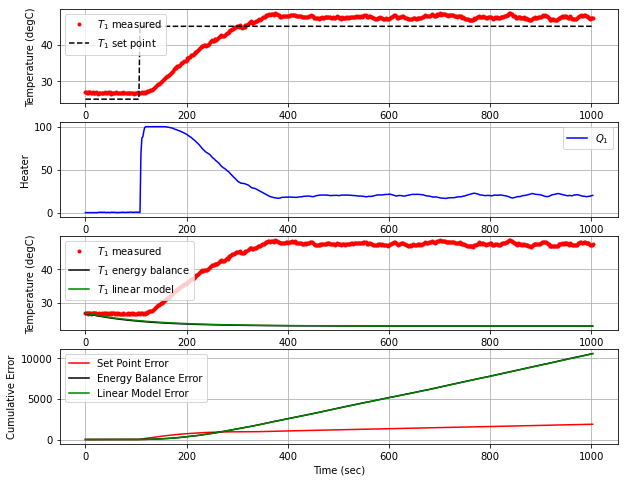

T1 NIH BOS  [48.11 47.86 47.76 47.97 48.07 47.87 47.7  47.66 47.62 47.39 47.   47.17
 47.16 47.36 47.47]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 40ms/step
1006.2  45.00  47.67   0.00  19.91


<Figure size 432x288 with 0 Axes>

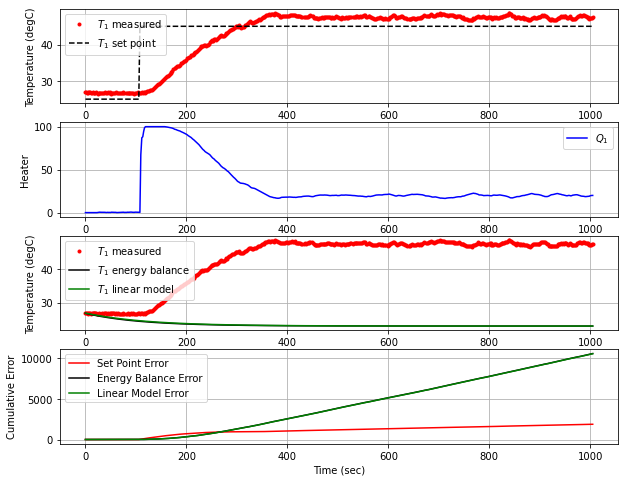

T1 NIH BOS  [47.86 47.76 47.97 48.07 47.87 47.7  47.66 47.62 47.39 47.   47.17 47.16
 47.36 47.47 47.67]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1008.1  45.00  47.94   0.00  19.73


<Figure size 432x288 with 0 Axes>

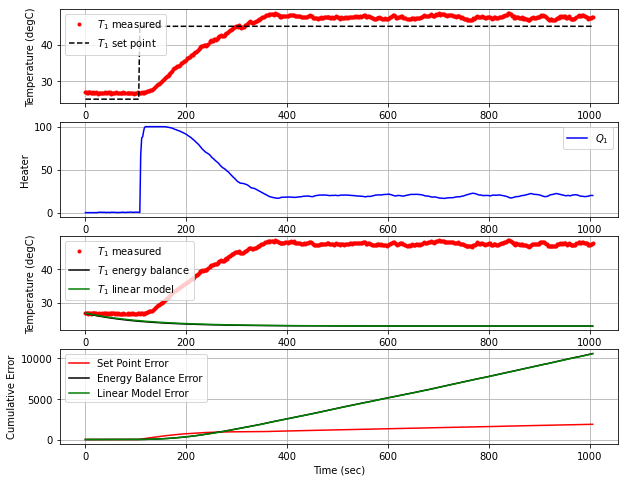

T1 NIH BOS  [47.76 47.97 48.07 47.87 47.7  47.66 47.62 47.39 47.   47.17 47.16 47.36
 47.47 47.67 47.94]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
1010.0  45.00  47.96   0.00  19.35


<Figure size 432x288 with 0 Axes>

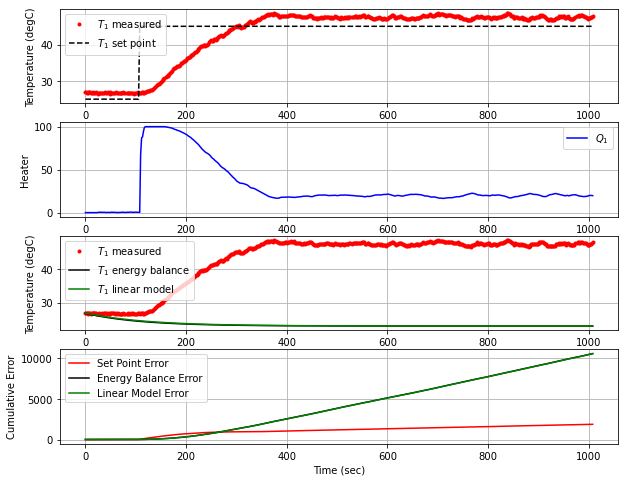

T1 NIH BOS  [47.97 48.07 47.87 47.7  47.66 47.62 47.39 47.   47.17 47.16 47.36 47.47
 47.67 47.94 47.96]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1011.7  45.00  47.99   0.00  19.08


<Figure size 432x288 with 0 Axes>

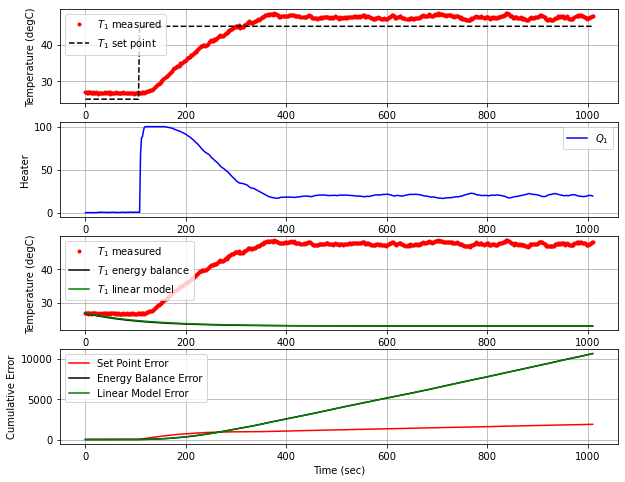

T1 NIH BOS  [48.07 47.87 47.7  47.66 47.62 47.39 47.   47.17 47.16 47.36 47.47 47.67
 47.94 47.96 47.99]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1013.3  45.00  47.62   0.00  18.90


<Figure size 432x288 with 0 Axes>

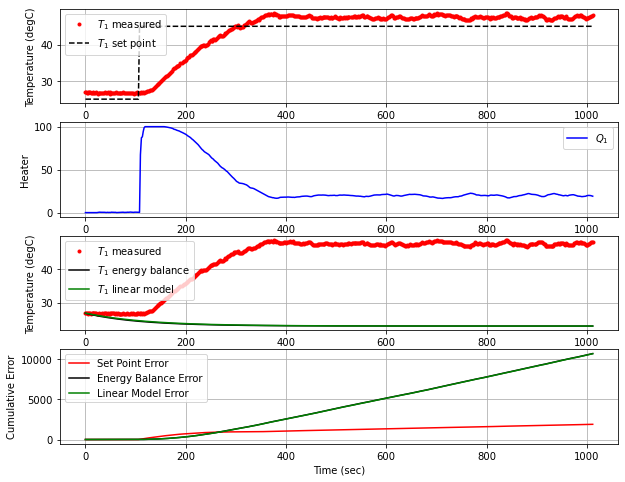

T1 NIH BOS  [47.87 47.7  47.66 47.62 47.39 47.   47.17 47.16 47.36 47.47 47.67 47.94
 47.96 47.99 47.62]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1015.1  45.00  47.59   0.00  19.12


<Figure size 432x288 with 0 Axes>

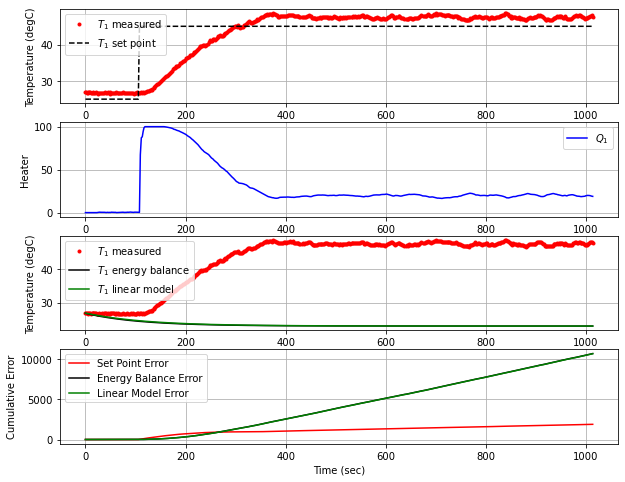

T1 NIH BOS  [47.7  47.66 47.62 47.39 47.   47.17 47.16 47.36 47.47 47.67 47.94 47.96
 47.99 47.62 47.59]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
1016.7  45.00  47.10   0.00  19.29


<Figure size 432x288 with 0 Axes>

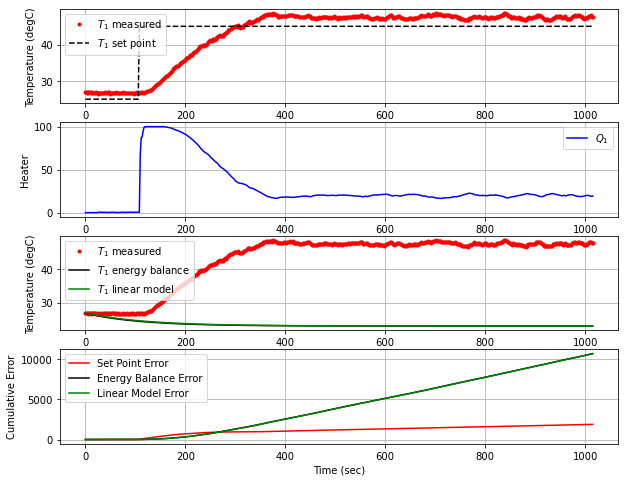

T1 NIH BOS  [47.66 47.62 47.39 47.   47.17 47.16 47.36 47.47 47.67 47.94 47.96 47.99
 47.62 47.59 47.1 ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1018.4  45.00  47.19   0.00  19.82


<Figure size 432x288 with 0 Axes>

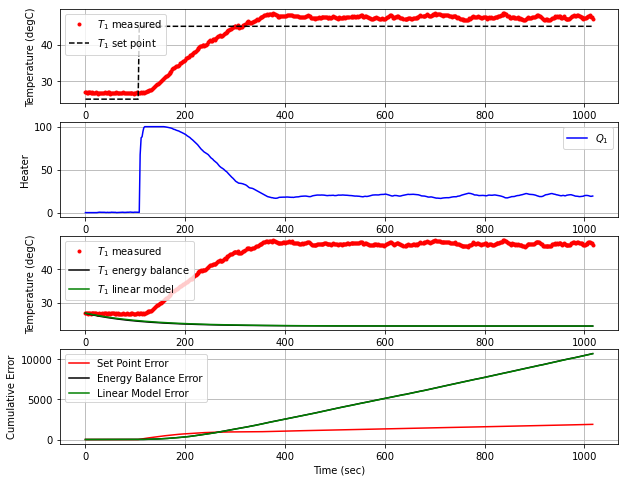

T1 NIH BOS  [47.62 47.39 47.   47.17 47.16 47.36 47.47 47.67 47.94 47.96 47.99 47.62
 47.59 47.1  47.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1020.1  45.00  47.07   0.00  20.09


<Figure size 432x288 with 0 Axes>

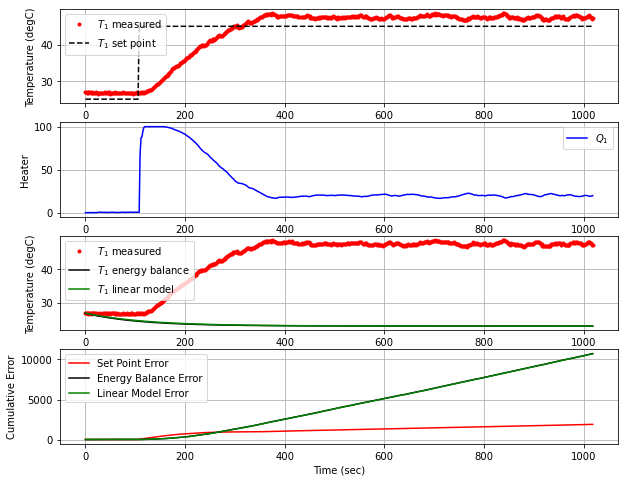

T1 NIH BOS  [47.39 47.   47.17 47.16 47.36 47.47 47.67 47.94 47.96 47.99 47.62 47.59
 47.1  47.19 47.07]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 38ms/step
1022.0  45.00  46.93   0.00  20.35


<Figure size 432x288 with 0 Axes>

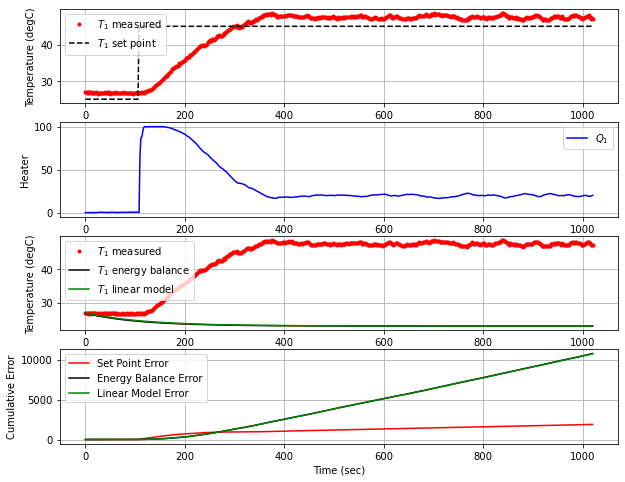

T1 NIH BOS  [47.   47.17 47.16 47.36 47.47 47.67 47.94 47.96 47.99 47.62 47.59 47.1
 47.19 47.07 46.93]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1023.9  45.00  47.23   0.00  20.68


<Figure size 432x288 with 0 Axes>

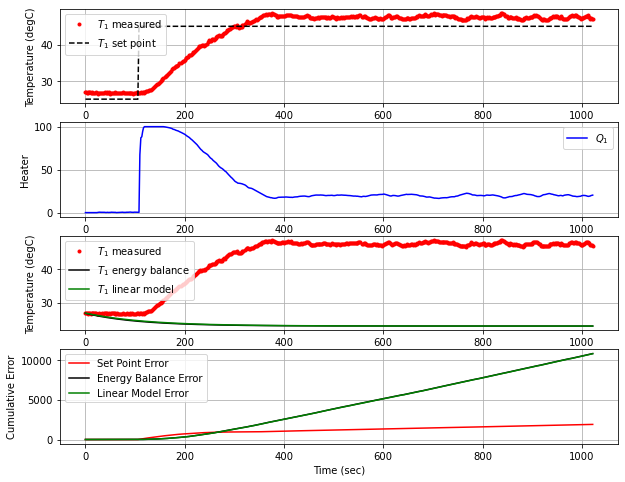

T1 NIH BOS  [47.17 47.16 47.36 47.47 47.67 47.94 47.96 47.99 47.62 47.59 47.1  47.19
 47.07 46.93 47.23]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
1025.6  45.00  47.19   0.00  20.60


<Figure size 432x288 with 0 Axes>

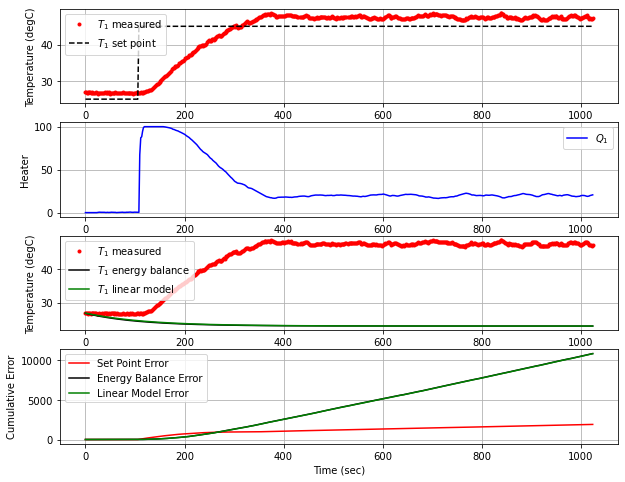

T1 NIH BOS  [47.16 47.36 47.47 47.67 47.94 47.96 47.99 47.62 47.59 47.1  47.19 47.07
 46.93 47.23 47.19]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
1027.3  45.00  47.15   0.00  20.60


<Figure size 432x288 with 0 Axes>

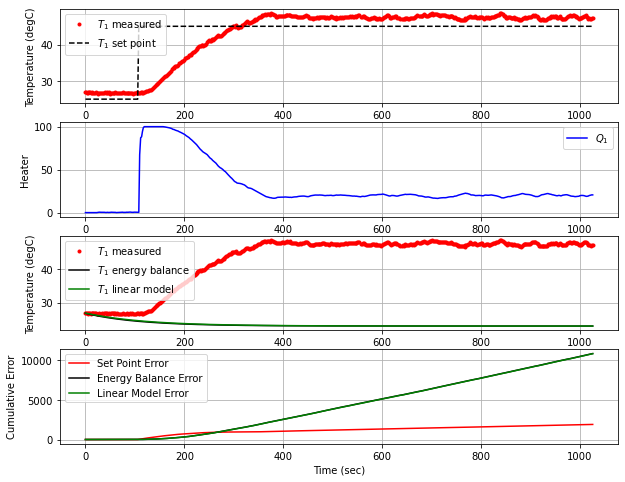

T1 NIH BOS  [47.36 47.47 47.67 47.94 47.96 47.99 47.62 47.59 47.1  47.19 47.07 46.93
 47.23 47.19 47.15]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1029.0  45.00  47.27   0.00  20.68


<Figure size 432x288 with 0 Axes>

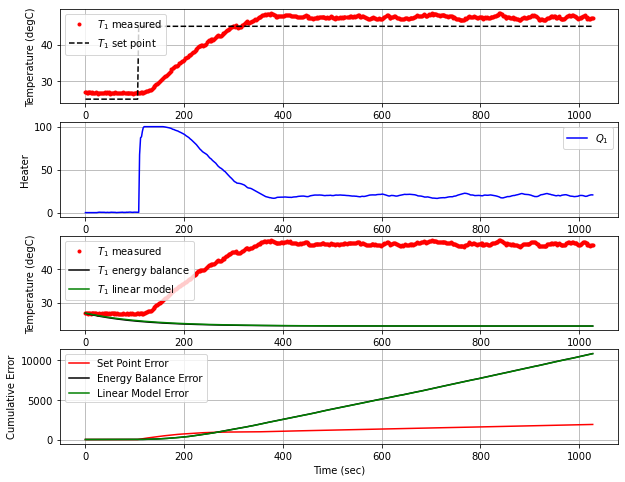

T1 NIH BOS  [47.47 47.67 47.94 47.96 47.99 47.62 47.59 47.1  47.19 47.07 46.93 47.23
 47.19 47.15 47.27]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
1030.9  45.00  47.03   0.00  20.66


<Figure size 432x288 with 0 Axes>

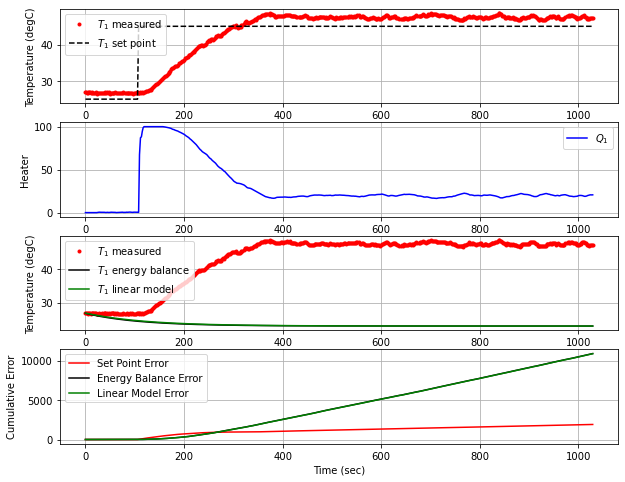

T1 NIH BOS  [47.67 47.94 47.96 47.99 47.62 47.59 47.1  47.19 47.07 46.93 47.23 47.19
 47.15 47.27 47.03]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 43ms/step
1033.1  45.00  46.94   0.00  20.89


<Figure size 432x288 with 0 Axes>

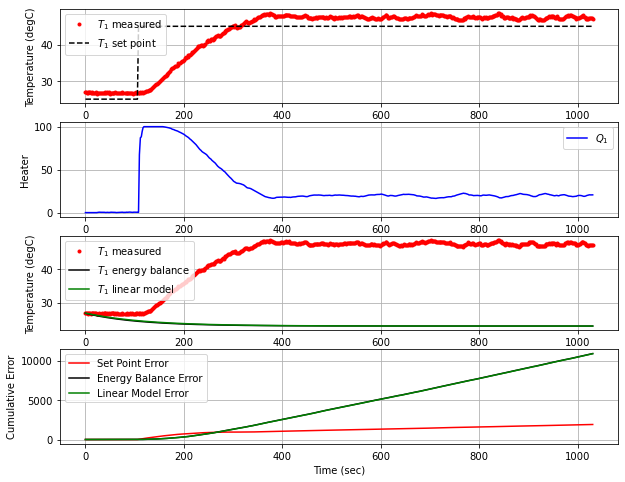

T1 NIH BOS  [47.94 47.96 47.99 47.62 47.59 47.1  47.19 47.07 46.93 47.23 47.19 47.15
 47.27 47.03 46.94]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 44ms/step
1035.2  45.00  46.83   0.00  21.19


<Figure size 432x288 with 0 Axes>

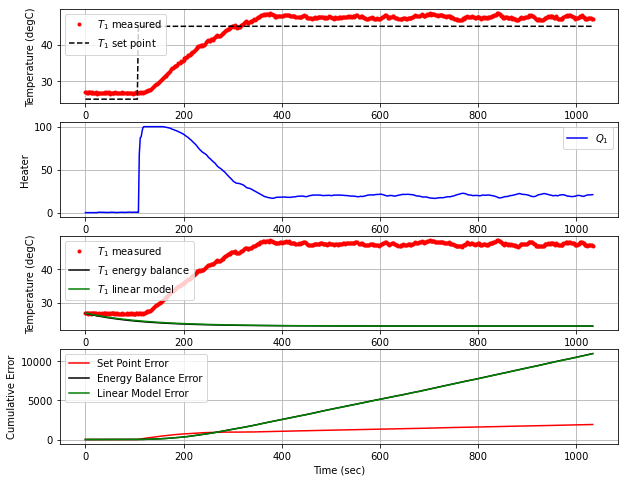

T1 NIH BOS  [47.96 47.99 47.62 47.59 47.1  47.19 47.07 46.93 47.23 47.19 47.15 47.27
 47.03 46.94 46.83]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 64ms/step
1037.0  45.00  46.81   0.00  21.53


<Figure size 432x288 with 0 Axes>

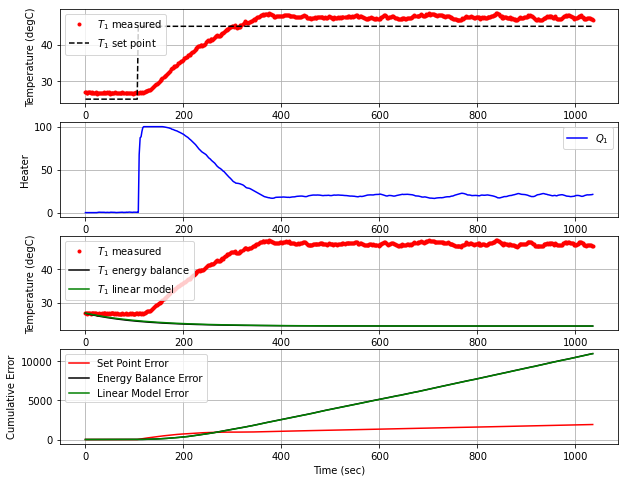

T1 NIH BOS  [47.99 47.62 47.59 47.1  47.19 47.07 46.93 47.23 47.19 47.15 47.27 47.03
 46.94 46.83 46.81]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 45ms/step
1038.9  45.00  47.00   0.00  21.81


<Figure size 432x288 with 0 Axes>

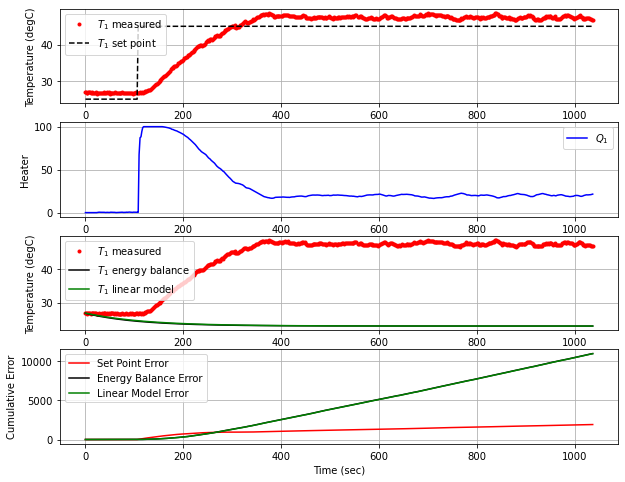

T1 NIH BOS  [47.62 47.59 47.1  47.19 47.07 46.93 47.23 47.19 47.15 47.27 47.03 46.94
 46.83 46.81 47.  ]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1040.7  45.00  46.95   0.00  21.84


<Figure size 432x288 with 0 Axes>

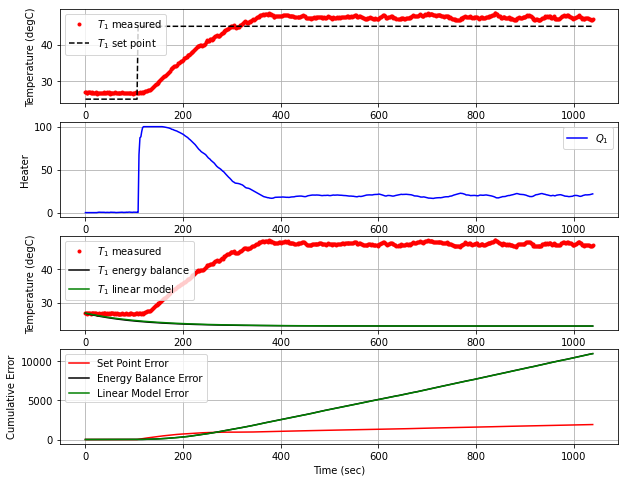

T1 NIH BOS  [47.59 47.1  47.19 47.07 46.93 47.23 47.19 47.15 47.27 47.03 46.94 46.83
 46.81 47.   46.95]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 35ms/step
1042.4  45.00  47.05   0.00  21.92


<Figure size 432x288 with 0 Axes>

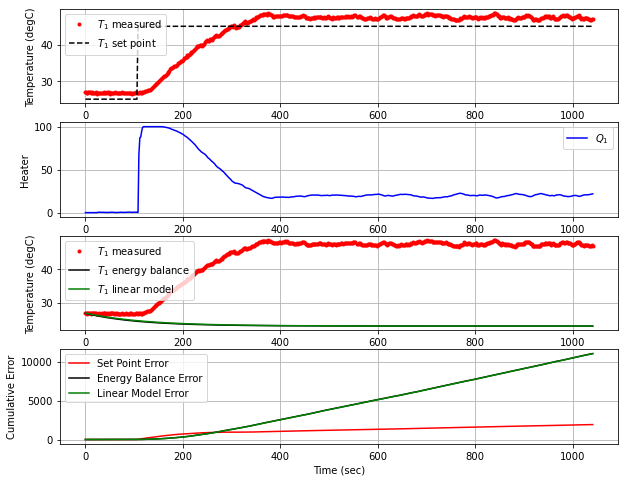

T1 NIH BOS  [47.1  47.19 47.07 46.93 47.23 47.19 47.15 47.27 47.03 46.94 46.83 46.81
 47.   46.95 47.05]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
1044.1  45.00  46.96   0.00  21.91


<Figure size 432x288 with 0 Axes>

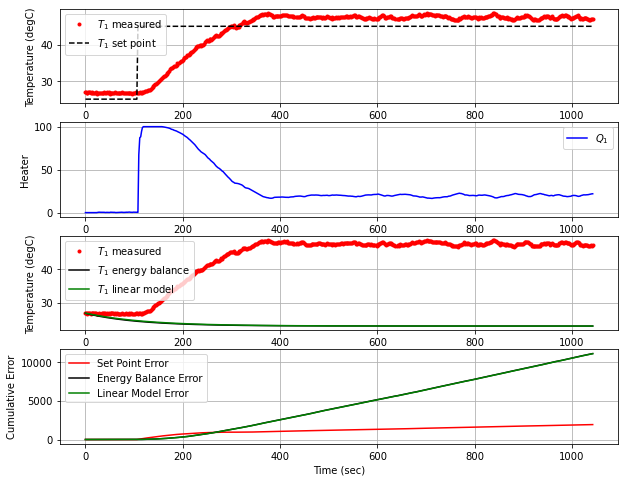

T1 NIH BOS  [47.19 47.07 46.93 47.23 47.19 47.15 47.27 47.03 46.94 46.83 46.81 47.
 46.95 47.05 46.96]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1045.8  45.00  46.79   0.00  21.97


<Figure size 432x288 with 0 Axes>

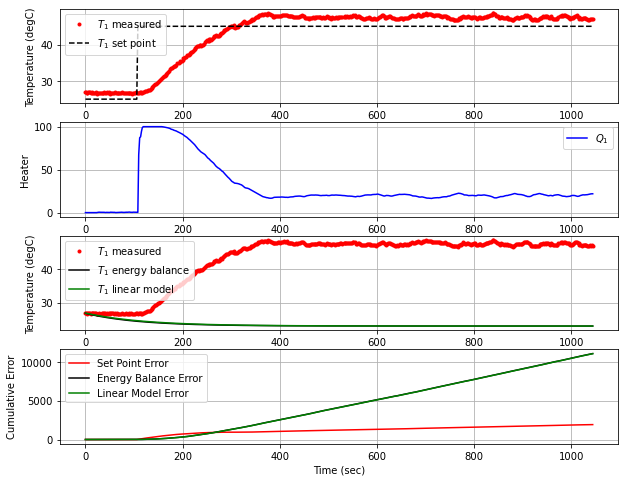

T1 NIH BOS  [47.07 46.93 47.23 47.19 47.15 47.27 47.03 46.94 46.83 46.81 47.   46.95
 47.05 46.96 46.79]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1047.7  45.00  46.73   0.00  22.19


<Figure size 432x288 with 0 Axes>

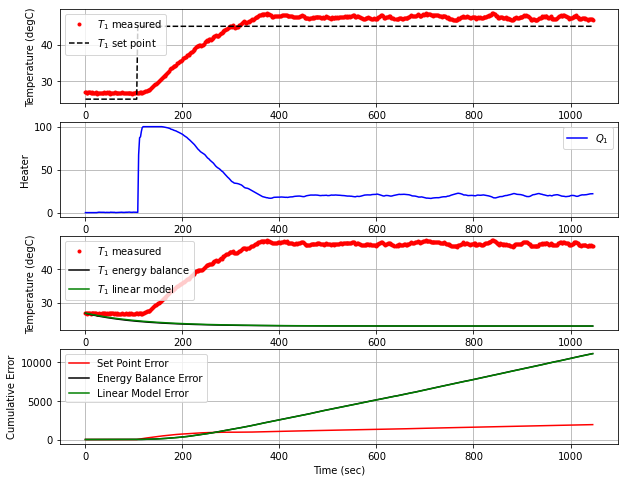

T1 NIH BOS  [46.93 47.23 47.19 47.15 47.27 47.03 46.94 46.83 46.81 47.   46.95 47.05
 46.96 46.79 46.73]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 37ms/step
1049.5  45.00  46.92   0.00  22.41


<Figure size 432x288 with 0 Axes>

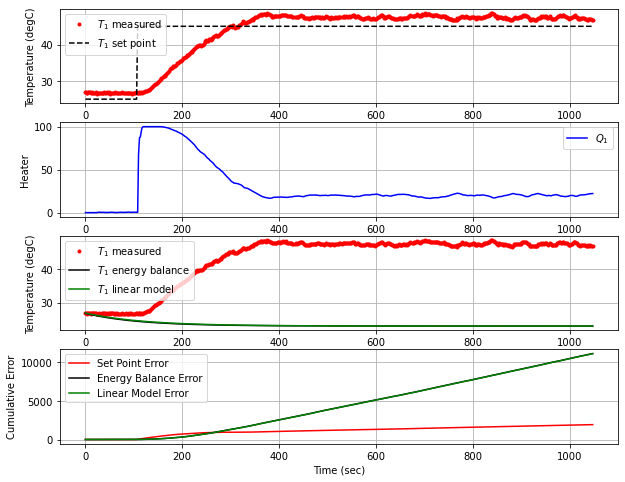

T1 NIH BOS  [47.23 47.19 47.15 47.27 47.03 46.94 46.83 46.81 47.   46.95 47.05 46.96
 46.79 46.73 46.92]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 36ms/step
1051.4  45.00  47.01   0.00  22.35


<Figure size 432x288 with 0 Axes>

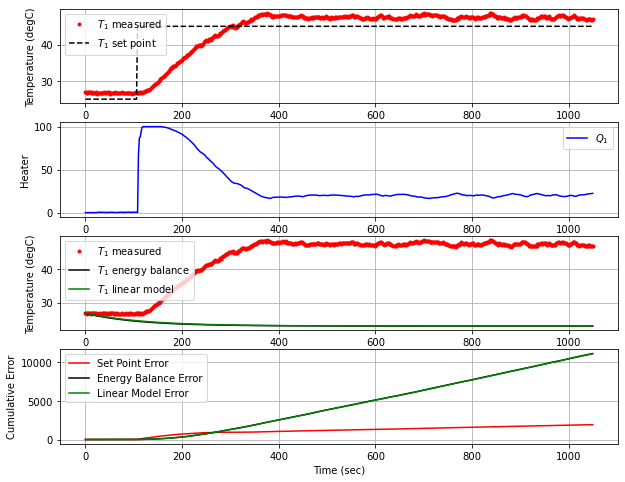

T1 NIH BOS  [47.19 47.15 47.27 47.03 46.94 46.83 46.81 47.   46.95 47.05 46.96 46.79
 46.73 46.92 47.01]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 39ms/step
1053.4  45.00  47.02   0.00  22.24


<Figure size 432x288 with 0 Axes>

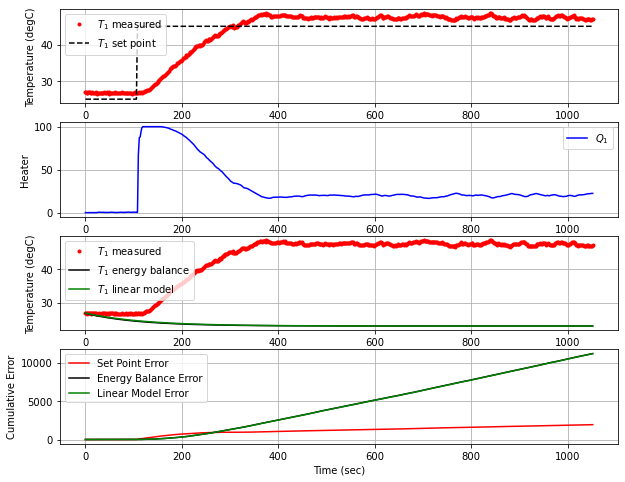

T1 NIH BOS  [47.15 47.27 47.03 46.94 46.83 46.81 47.   46.95 47.05 46.96 46.79 46.73
 46.92 47.01 47.02]
Tsp1 NIH BOS  [45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45. 45.]
1/1 [==============================] - 0s 47ms/step
1055.6  45.00  47.26   0.00  22.18


<Figure size 432x288 with 0 Axes>

Shutting down
Arduino disconnected successfully
Arduino disconnected successfully


True

<Figure size 432x288 with 0 Axes>

In [29]:
######################################################
# Do not adjust anything below this point            #
######################################################

# Connect to Arduino
a = itclab.iTCLab()
#a.encode('utf-8').strip()#modification error
# Turn LED on
print('LED On')
a.LED(100)

# Run time in minutes
run_time = 15.0

# Number of cycles
loops = int(60.0*run_time)
tm = np.zeros(loops)

# Temperature
# set point (degC)
Tsp1 = np.ones(loops) * 25.0 
Tsp1[60:] = 45.0
Tsp1[360:] = 45.0
Tsp1[660:] = 45.0
T1 = np.ones(loops) * a.T1 # measured T (degC)
error_sp = np.zeros(loops)

Tsp2 = np.ones(loops) * 23.0 # set point (degC)
T2 = np.ones(loops) * a.T2 # measured T (degC)

# Predictions
Tp = np.ones(loops) * a.T1
error_eb = np.zeros(loops)
Tpl = np.ones(loops) * a.T1
error_fopdt = np.zeros(loops)

# impulse tests (0 - 100%)
Q1 = np.ones(loops) * 0.0
Q2 = np.ones(loops) * 0.0
Qlstm = np.ones(loops) * 0.0

# T1_m = np.zeros(shape=(15,1))
# Tsp1_m = np.zeros(shape=(15,1))

print('Running Main Loop. Ctrl-C to end.')
print('  Time     SP     PV     Q1   =  P   +  I  +   D')
print(('{:6.1f} {:6.2f} {:6.2f} ' + \
       '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
           tm[0],Tsp1[0],T1[0], \
           Q1[0],0.0,0.0,0.0))

# Create plot
plt.figure(figsize=(10,7))
plt.ion()
plt.show()

# Main Loop
start_time = time.time()
prev_time = start_time
# Integral error
ierr = 0.0
try:
    for i in range(1,loops):
        # Sleep time
        sleep_max = 1.0
        sleep = sleep_max - (time.time() - prev_time)
        if sleep>=0.01:
            time.sleep(sleep-0.01)
        else:
            time.sleep(0.01)

        # Record time and change in time
        t = time.time()
        dt = t - prev_time
        prev_time = t
        tm[i] = t - start_time

        # Read temperatures in Kelvin 
        T1[i] = a.T1
        T2[i] = a.T2

        # Simulate one time step with Energy Balance
        Tnext = odeint(heat,Tp[i-1]+273.15,[0,dt],args=(Q1[i-1],))
        Tp[i] = Tnext[1]-273.15

        # Simulate one time step with linear FOPDT model
        z = np.exp(-dt/tauP)
        Tpl[i] = (Tpl[i-1]-Tss) * z \
                 + (Q1[max(0,i-int(thetaP)-1)]-Qss)*(1-z)*Kp \
                 + Tss

        # Calculate PID Output (Choose one of them)
        # 1. Manually Choosen
#         [Q1[i],P,ierr,D] = pid(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 2. Based on Deep Learning Result
#         [Q1[i],P,ierr,D] = pid_dl(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 3. Based on LSTM Prediction
        if i>= window:
            # Load data for model
            T1_m = T1[i-window:i]
            Tsp1_m = Tsp1[i-window:i]
            print('T1 NIH BOS ',T1[i-window:i])
            print('Tsp1 NIH BOS ',Tsp1[i-window:i])
            # Predict LSTM
            Qlstm[i] = lstm(T1_m, Tsp1_m)
            
        # Start setpoint error accumulation after 1 minute (60 seconds)
        if i>=60:
            error_eb[i] = error_eb[i-1] + abs(Tp[i]-T1[i])
            error_fopdt[i] = error_fopdt[i-1] + abs(Tpl[i]-T1[i])
            error_sp[i] = error_sp[i-1] + abs(Tsp1[i]-T1[i])

        # Write output (0-100)
        a.Q1(Qlstm[i])
        a.Q2(0.0)

        # Print line of data
        print(('{:6.1f} {:6.2f} {:6.2f} ' + \
              '{:6.2f} {:6.2f}').format( \
                  tm[i],Tsp1[i],T1[i], \
                  Q1[i],Qlstm[i]))

        # Plot
        plt.clf()
        plt.figure(figsize=(10,8))
        ax=plt.subplot(4,1,1)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tsp1[0:i],'k--',label=r'$T_1$ set point')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,2)
        ax.grid()
        plt.plot(tm[0:i],Qlstm[0:i],'b-',label=r'$Q_1$')
        plt.ylabel('Heater')
        plt.legend(loc='best')
        ax=plt.subplot(4,1,3)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tp[0:i],'k-',label=r'$T_1$ energy balance')
        plt.plot(tm[0:i],Tpl[0:i],'g-',label=r'$T_1$ linear model')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,4)
        ax.grid()
        plt.plot(tm[0:i],error_sp[0:i],'r-',label='Set Point Error')
        plt.plot(tm[0:i],error_eb[0:i],'k-',label='Energy Balance Error')
        plt.plot(tm[0:i],error_fopdt[0:i],'g-',label='Linear Model Error')
        plt.ylabel('Cumulative Error')
        plt.legend(loc='best')
        plt.xlabel('Time (sec)')
        plt.draw()
        plt.pause(0.05)

    # Turn off heaters
    a.Q1(0)
    a.Q2(0)
    # Save figure
    plt.savefig('test_PID_dl.png')

# Allow user to end loop with Ctrl-C           
except KeyboardInterrupt:
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')

# Make sure serial connection still closes when there's an error
except:           
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Error: Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')
    raise

a.close()

In [27]:
a.close()

Arduino disconnected successfully


True